# Analysis data with all vectorAnalysis data with disk IO

In [10]:
# Import the libraries
import tensorflow as tf
physical_devices = tf.config.list_physical_devices('GPU')
#tf.config.experimental.set_memory_growth(physical_devices[0], enable=True)
from tensorflow import keras
import numpy as np
import matplotlib.pyplot as plt  # for 畫圖用
import pandas as pd# load and evaluate a saved model
from numpy import loadtxt
from tensorflow.keras.models import load_model,save_model
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Activation,Flatten, LSTM, TimeDistributed, RepeatVector,GRU, Input, ConvLSTM2D, Bidirectional,BatchNormalization
from tensorflow.keras import Input
#from tensorflow.keras.layers.normalization import BatchNormalization
from tensorflow.keras import regularizers
from tensorflow.keras.optimizers import Adam,RMSprop,Nadam

from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.metrics import mean_squared_error
import math,glob
import json
from IPython.core.pylabtools import figsize

figsize(15, 7) 

### Utils

In [11]:
def read_data(path,o_dtname="Datetime",c_dtname = 'datetime',names=None,skiprows=None):
    df = pd.read_csv(path, sep=',', 
                     parse_dates={c_dtname:[o_dtname]}, 
                     infer_datetime_format=True, 
                     low_memory=False, 
                     na_values=['nan','?'], 
                     index_col=c_dtname,
                     names=names,
                    skiprows=skiprows)

    #df = df.reindex(index=df.index[:,:-1])
    print(df.isnull().sum())
    # filling nan with mean in any columns
    #for j in range(df.shape[1]):        
        #df.iloc[:,j]=df.iloc[:,j].fillna(df.iloc[:,j].mean())
        
    #df.iloc[:,4:] = df.iloc[:,4:]*100
    #another sanity check to make sure that there are not more any nan
    #print(df.isnull().sum())
    #print(df.head())
    return df
#draw_trend
def draw_trend(df,groups,bound=200):
    #figsize(15,10) 
    
    anomly_df = df.copy()
    anomly_df[anomly_df>0] = np.nan
    
    i=1
    Values = df.values
    Anomaly = anomly_df.values
    cols = groups
    
    for group in groups:
        plt.subplot(len(cols), 1, i)
        plt.plot(df.iloc[:].index,Values[:bound, group],linewidth=3)
        plt.plot(df.iloc[:].index,Anomaly[:bound, group],color='red',linewidth=8)
        plt.title(df.columns[group], loc='right')
        plt.grid()
        plt.xticks(rotation=45)
        #plt.xticks(range(0,4020,20))
        i += 1
    plt.show()
    print('\n')

def draw_trend_resample(df,groups,resample_freq,bound=200):
    #figsize(15,10) 
    i=1
    Values = df.resample(resample_freq).mean().values
    cols = groups
    for group in groups:
        plt.subplot(len(cols), 1, i)
        plt.plot(Values[:bound, group],linewidth=3)
        #plt.xticks(range(0,bound+10,10))
        plt.title(df.columns[group]+' resample-{}'.format(resample_freq), y=0.80, loc='right')
        i += 1
    plt.tight_layout()
    plt.show()
    
    print('\n')
#draw_corr
def show_corr(df,group,method):
    plt.matshow(df.iloc[:,group].corr(method=method),vmax=1,vmin=-1,cmap='PRGn')
    plt.title('{}_original'.format(method), size=15)
    plt.xticks(range(len(group)),labels=map(str,group))
    plt.yticks(range(len(group)),labels=map(str,group))
    plt.colorbar()
    plt.show()
    
def show_corr_resample(df,group,resample_freq):
    plt.matshow(df.resample(resample_freq).mean().iloc[:,group].corr(method='spearman'),vmax=1,vmin=-1,cmap='PRGn')
    plt.title('Spearman_resample-{}'.format(resample_freq), size=15)
    plt.xticks(range(len(group)),labels=map(str,group))
    plt.yticks(range(len(group)),labels=map(str,group))
    plt.colorbar()
    plt.show()
    

In [12]:
from scipy import stats
def gen_dataset(data,x_window_size,y_window_size):
    X_train = []   #預測點的前 60 天的資料
    y_train = []   #預測點
    for i in range(x_window_size, data.shape[0]-y_window_size,y_window_size):
        X_train.append(data.iloc[i-x_window_size:i, :-1].values)
        
        if np.sum(data.iloc[i-x_window_size:i, -1].values) >= 1:
            y_train.append(1)
        else:
            y_train.append(0)

    X_train, y_train = np.array(X_train), np.array(y_train)  # 轉成numpy array的格式，以利輸入 RNN
    
    #X_train = np.reshape(X_train, (X_train.shape[0], x_window_size,data.shape[1] ))

    """if y_window_size == 1:
        y_train = np.reshape(y_train,(y_train.shape[0], y_train.shape[2]))
    else:
        y_train = np.reshape(y_train,(y_train.shape[0],y_window_size,y_train.shape[2]))"""
        
    print("Gen data info:")
    print("X_data_shape:{}".format(X_train.shape))
    print("y_data_shape:{}".format(y_train.shape))
    print("\n")
          
    return X_train,y_train

def data_scaling(data,X_win_size,y_win_size,mode='robust'):
    
    assert mode == 'robust' or mode == 'minmax','Wrong mode name'
    print("Mode:{}\n".format(mode))
    
    #Record training data index
    data_index = data.shape[0]
   
    # Feature Scaling
    from sklearn.preprocessing import MinMaxScaler,RobustScaler
    if mode =='robust':
         #RobustScaler
        scaler = RobustScaler()
        data[list(data.columns)[:4]] = scaler.fit_transform(data[list(data.columns)[:4]])     
    elif mode == 'minmax':        
        #MinMaxScaler
        scaler = MinMaxScaler()
        data.iloc[:,[0,1,2,3]] = scaler.fit_transform(data.iloc[:,[0,1,2,3]])     
    
    
    #generate dataset
    data_X,data_y = gen_dataset(data,X_win_size,y_win_size)
    
    return data_X,data_y,scaler,data,scaler.get_params()


In [30]:
MES_path = "./Dataset/MES_data_0126"

history_path_list = glob.glob(MES_path+"/*history.csv")
processmemcpu_path_list = glob.glob(MES_path+"/*processmemcpu.csv")

# History Data

machinename    0
processname    0
value          0
dtype: int64
./Dataset/MES_data_0126\atkh_history.csv
Index(['machinename', 'processname', 'value'], dtype='object')

Machinename ['twkhh01zabxpl2v' 'TWKHH01CMWAPW1V' 'TWKHH01CMWAPW2V' 'TWKHH01CMWAPW3V'
 'TWKHH01CMWAPW4V' 'TWKHH01CMWAPW5V' 'TWKHH01CMWAPW6V' 'TWKHH01CMWAPW7V'
 'TWKHH01CMWAPW8V' 'TWKHH01CMCAPW1V' 'TWKHH01CMCAPW2V' 'TWKHH01CMCAPW3V'
 'TWKHH01CMCIPW1V' 'TWKHH01CMMWPW2V' 'TWKHH01CMPOPW1V' 'TWKHH01CMPOPW2V'
 'TWKHH01CMPOPW3V' 'TWKHH01CMPOPW4V' 'TWKHH01CMPOPW5V' 'TWKHH01CMPOPW6V'
 'TWKHH01CMPOPW7V' 'TWKHH01CMPOPW8V' 'TWKHH01CMPRPW1V' 'TWKHH01CMPRPW2V'
 'Usphx01erp001v' 'USPHX01OPLER01v']

Processname ['base_line_for_TWGKHHPSK1CLSQ2.response' 'base_line_for_atkhpcm.response'
 'base_line_for_atkhqcm7.response' 'base_line_for_atkhtcm7.response'
 'Free disk space on / (percentage)'
 'Free disk space on /apps (percentage)'
 'Free disk space on /boot (percentage)'
 'Free disk space on /home (percentage)'
 'Free disk space on /opt (

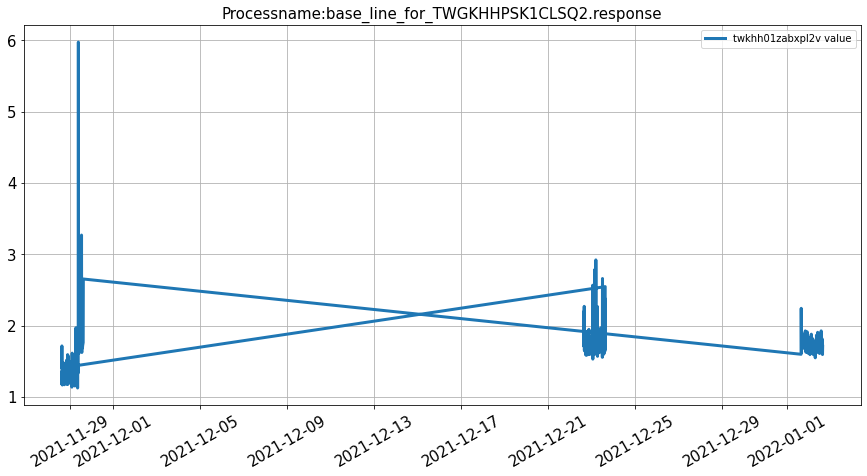

(423,)


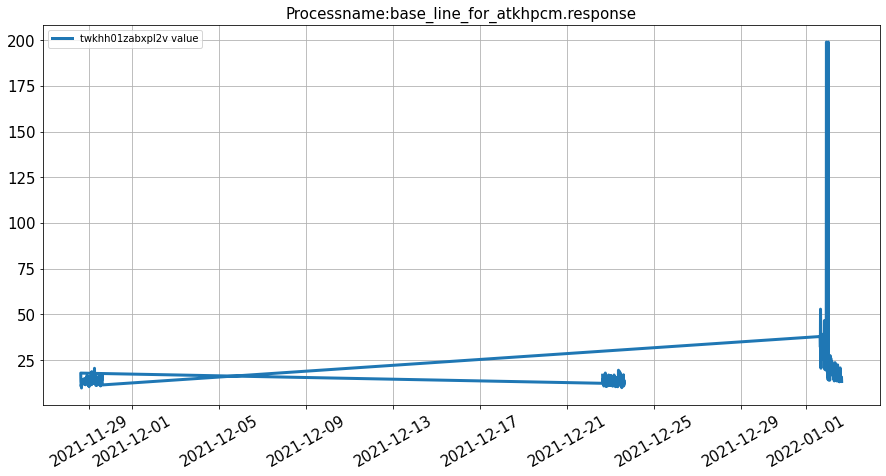

(423,)


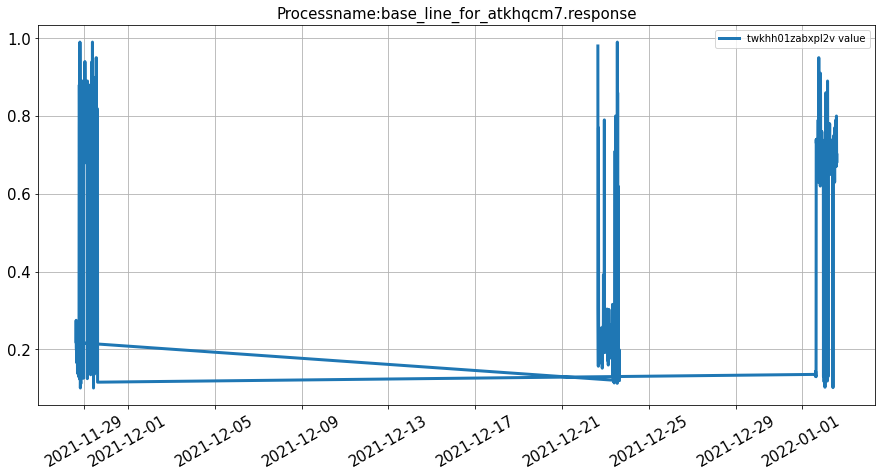

(423,)


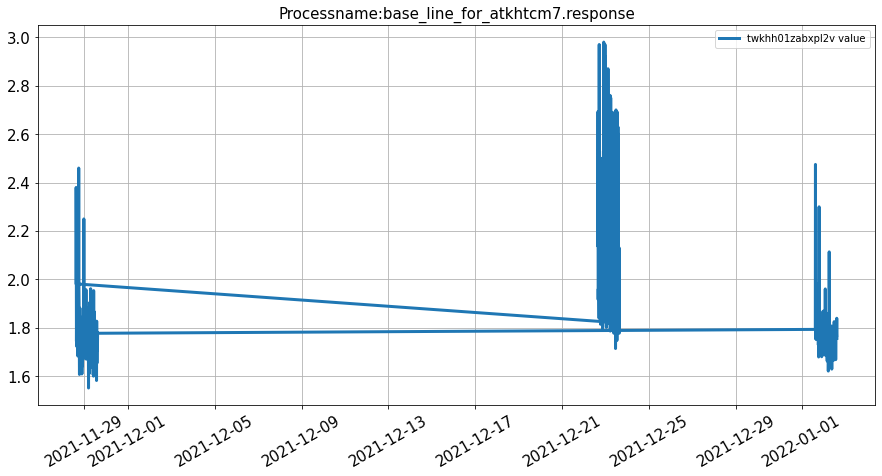

(4239,)


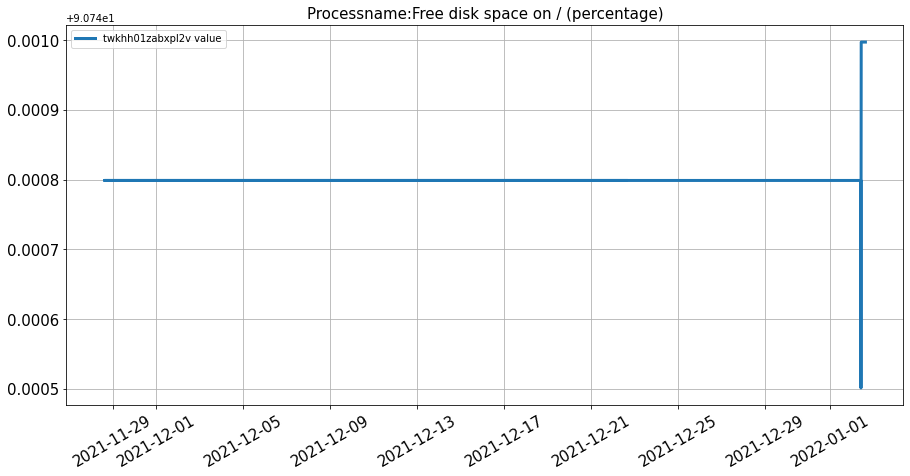

(4241,)


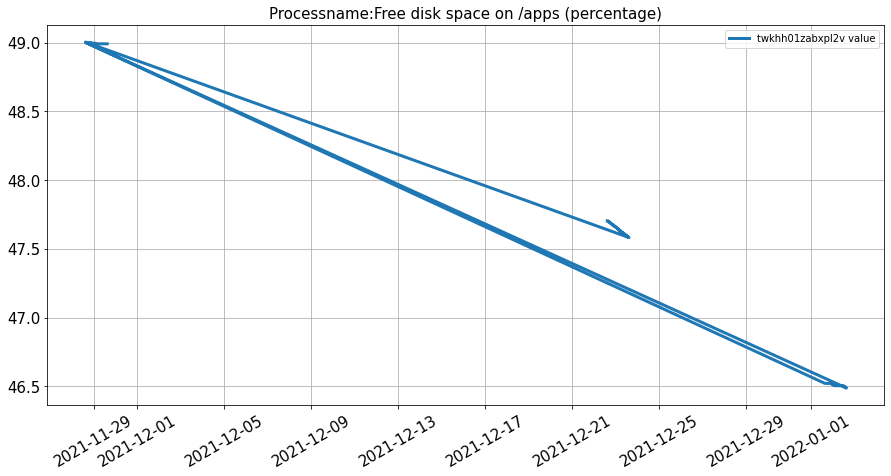

(3087,)


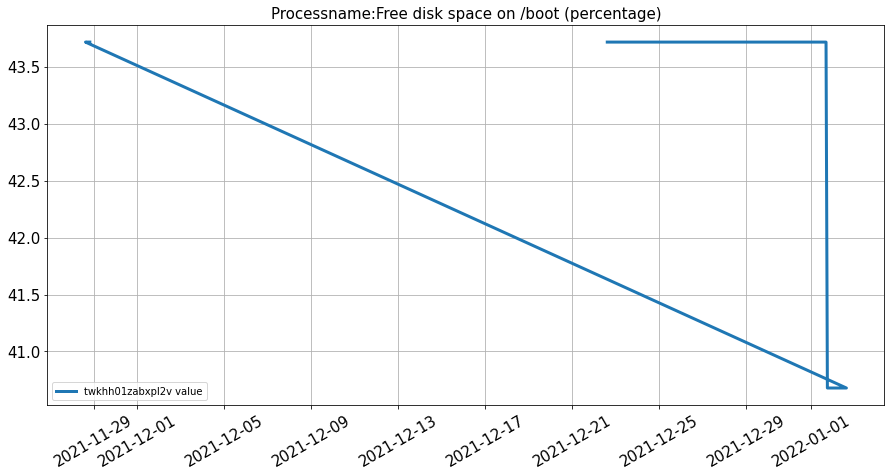

(2800,)


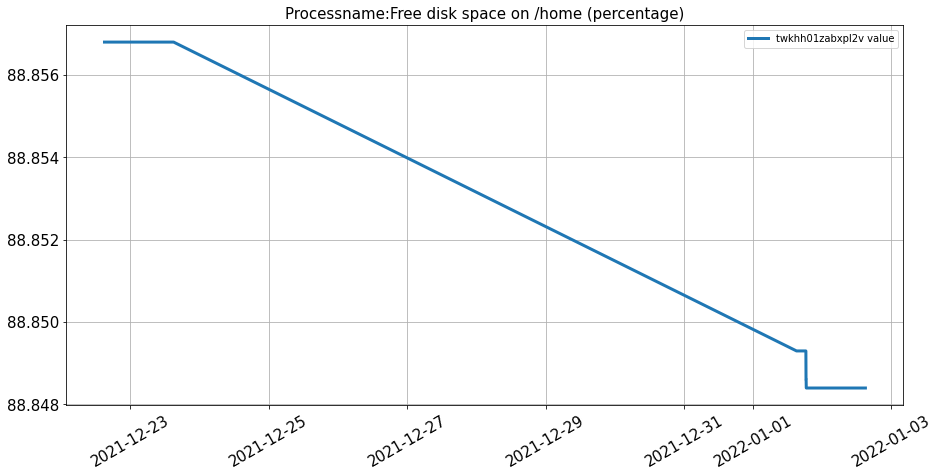

(2800,)


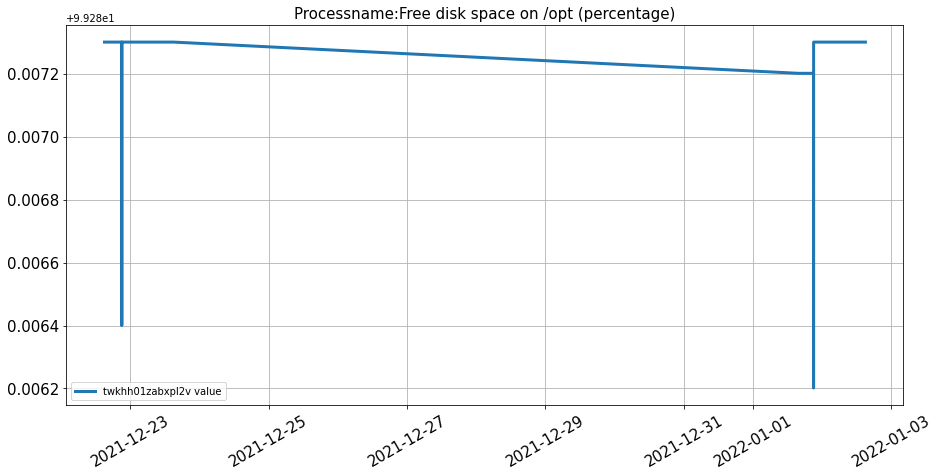

(2800,)


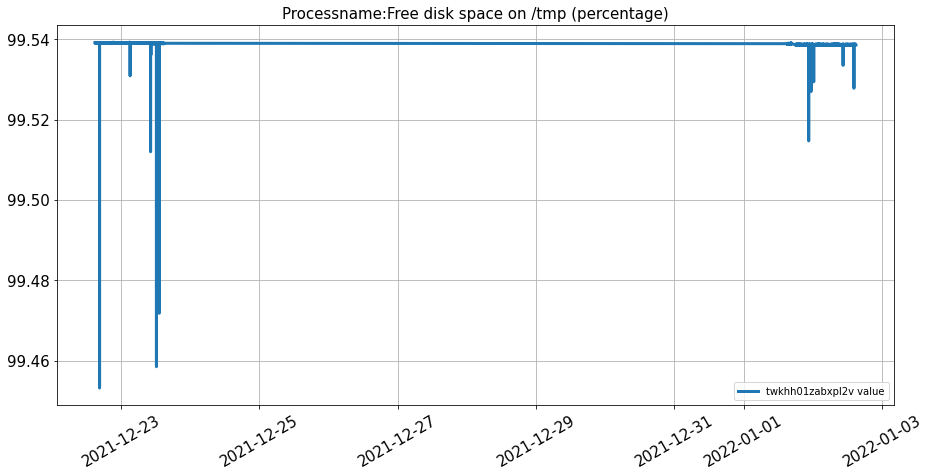

(2799,)


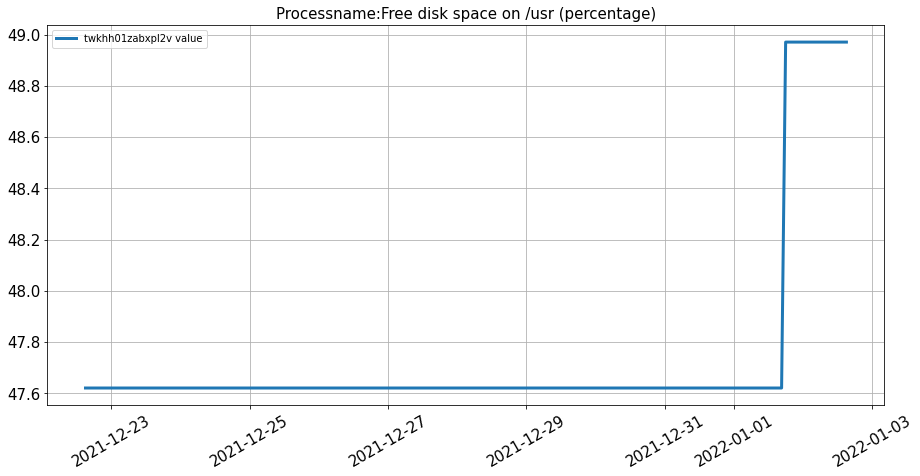

(2800,)


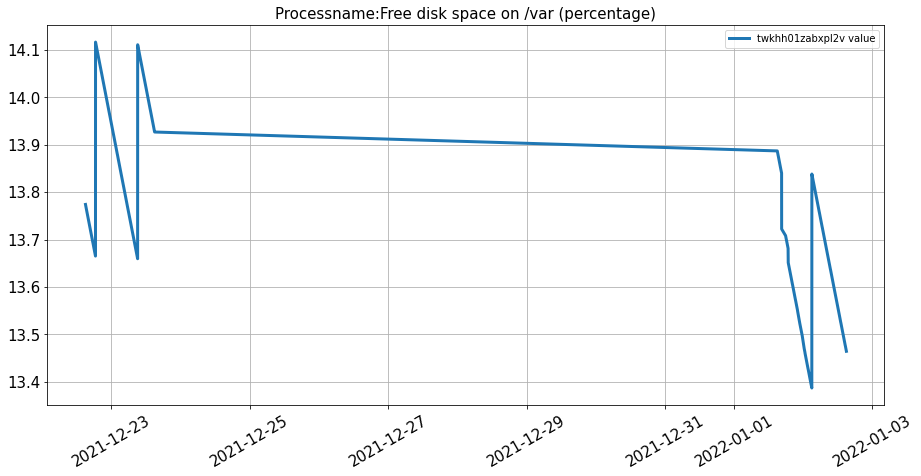

(2800,)


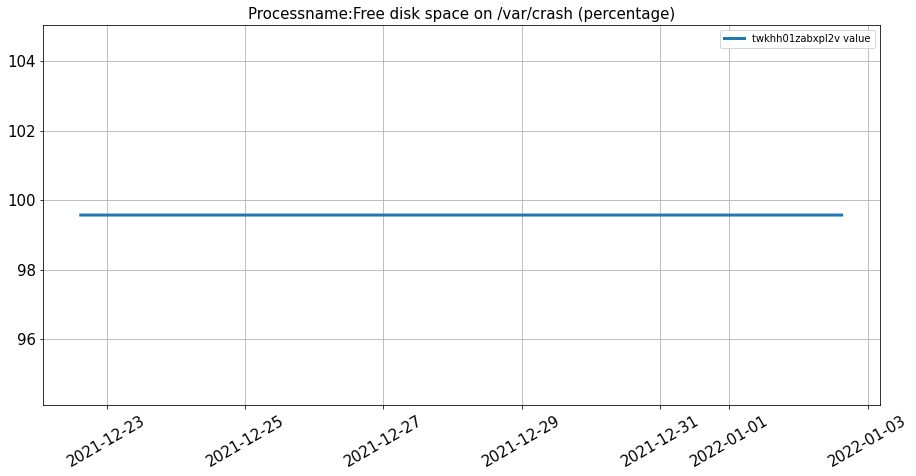

(2800,)


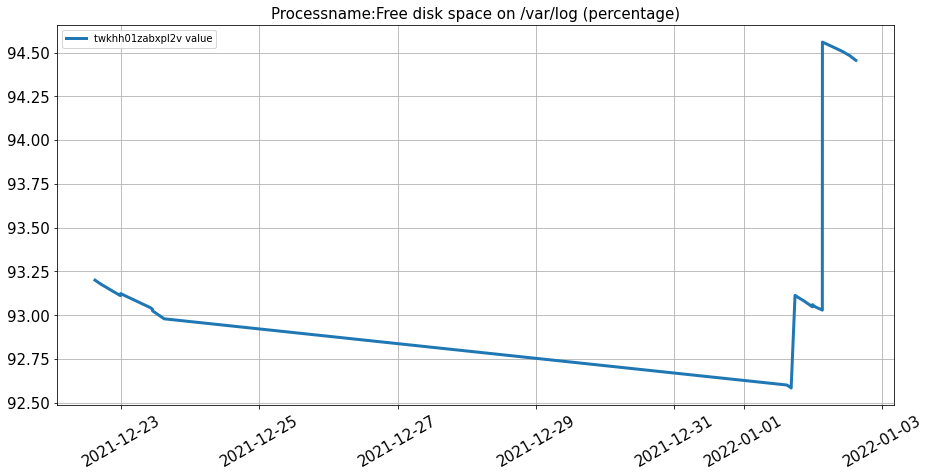

(960,)
(960,)
(960,)
(960,)
(960,)
(959,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(1440,)


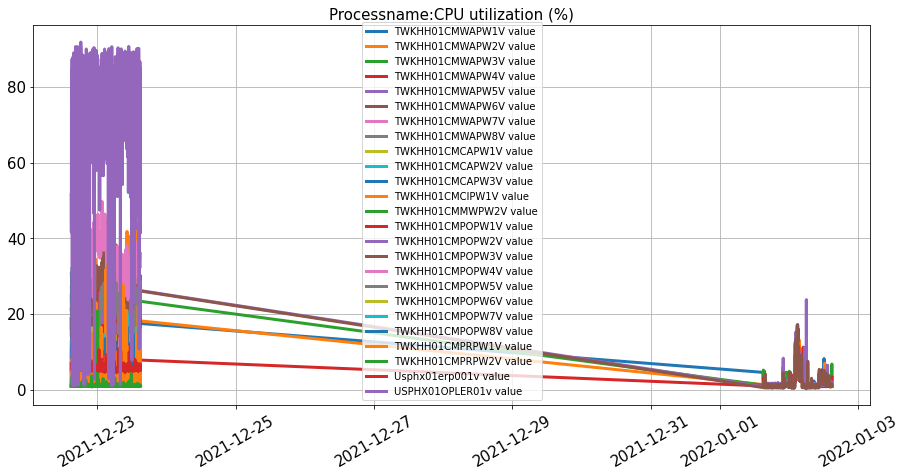

(960,)
(960,)
(960,)
(960,)
(960,)
(959,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(1440,)
(1440,)


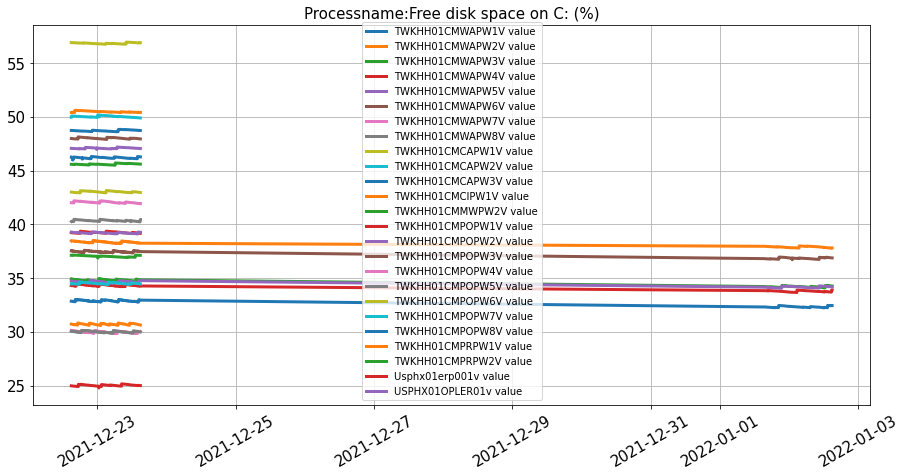

(960,)
(960,)
(960,)
(960,)
(960,)
(959,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(1440,)
(1440,)


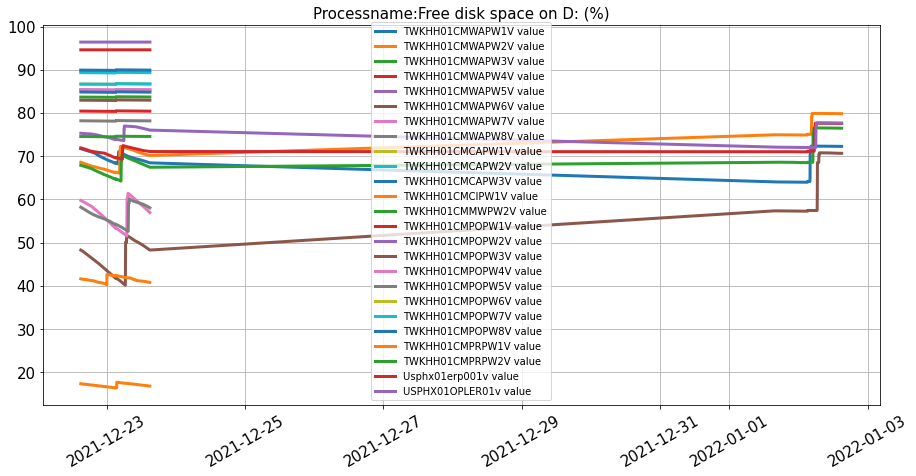

(960,)
(960,)
(960,)
(960,)
(960,)
(905,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(480,)
(1440,)


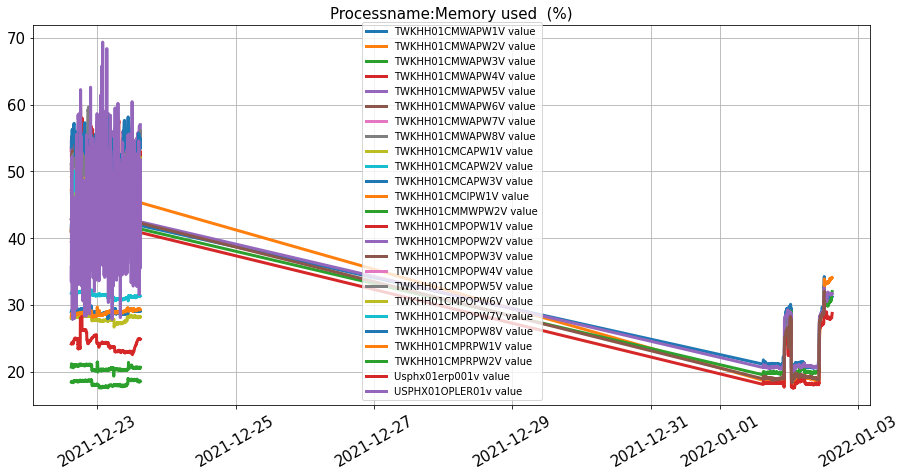

(480,)
(1440,)


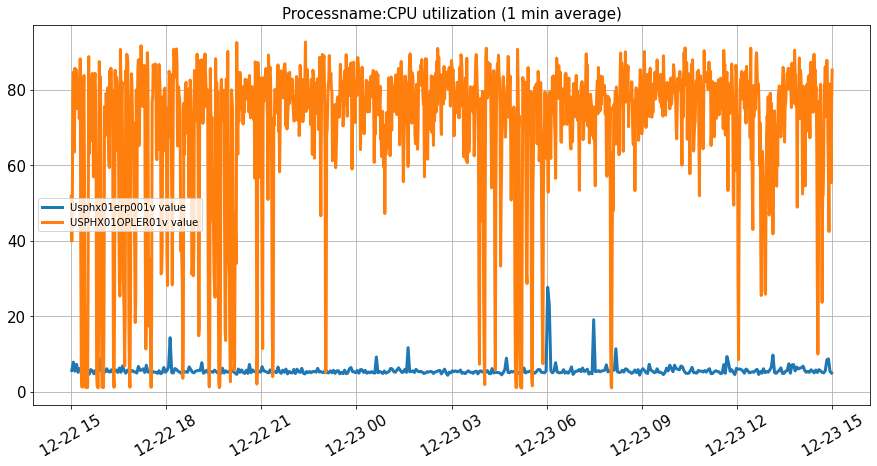

,machinename,processname,value
dt,,,
2021-12-22 15:05:00,twkhh01zabxpl2v,base_line_for_TWGKHHPSK1CLSQ2.response,1.719000
2021-12-22 15:15:00,twkhh01zabxpl2v,base_line_for_TWGKHHPSK1CLSQ2.response,2.196000
2021-12-22 15:25:00,twkhh01zabxpl2v,base_line_for_TWGKHHPSK1CLSQ2.response,1.833000
2021-12-22 15:35:00,twkhh01zabxpl2v,base_line_for_TWGKHHPSK1CLSQ2.response,1.837000
2021-12-22 15:45:00,twkhh01zabxpl2v,base_line_for_TWGKHHPSK1CLSQ2.response,2.270000
...,...,...,...
2021-11-28 19:43:57,twkhh01zabxpl2v,Free disk space on /boot (percentage),43.718601
2021-11-28 19:44:57,twkhh01zabxpl2v,Free disk space on /boot (percentage),43.718601
2021-11-28 19:45:57,twkhh01zabxpl2v,Free disk space on /boot (percentage),43.718601


In [87]:
for pth in history_path_list[2:3]:
    df = read_data(pth,o_dtname="recordtime",c_dtname = 'dt')
    print(pth)
    print(df.columns)
    print()
    print("Machinename",df["machinename"].unique())
    print()
    print("Processname",df["processname"].unique())
    df_list = []
    for i,processname in enumerate(df["processname"].unique()):
        
        tmp_df = df[df["processname"]==processname]
        df_list.append(tmp_df)
        for machinename in tmp_df["machinename"].unique():
            print(tmp_df[tmp_df["machinename"]==machinename]["value"].shape)
            plt.plot(tmp_df[tmp_df["machinename"]==machinename]["value"],label="{} value".format(machinename),linewidth=3)
            #plt.title("Machinename:{}\nProcessname:{}".format(machinename,processname))
        plt.legend()
        plt.title("Processname:{}".format(processname),fontsize=15)
        plt.xticks(rotation=30,fontsize=15)
        plt.yticks(fontsize=15)
        plt.grid()
        
        figsize(15, 7) 
        plt.savefig("./Dataset/MES_data_0126/plot/History_Data-fig_{}.jpg".format(i))
        plt.show()
        
        
    #concat_df = pd.concat(df_list,axis=1)

df

# Processmemcpu Data

In [76]:
processmemcpu_path_list

['./Dataset/MES_data_0126\\atbk_processmemcpu.csv',
 './Dataset/MES_data_0126\\athh_processmemcpu.csv',
 './Dataset/MES_data_0126\\atkh_processmemcpu.csv',
 './Dataset/MES_data_0126\\atkl_processmemcpu.csv',
 './Dataset/MES_data_0126\\attj_processmemcpu.csv']

machinename     0
process         0
mem_usage_mb    0
cpu_usage       0
dtype: int64
./Dataset/MES_data_0126\atkh_processmemcpu.csv
Index(['machinename', 'process', 'mem_usage_mb', 'cpu_usage'], dtype='object')

Machinename ['TWKHH01CMMWPW1V' 'TWKHH01CMMWPW2V' 'TWKHH01CMCAPW1V' 'TWKHH01CMCAPW2V'
 'TWKHH01CMCAPW3V' 'TWKHH01CMCIPW1V' 'TWKHH01CMCIPW2V' 'TWKHH01CMPOPW1V'
 'TWKHH01CMPOPW2V' 'TWKHH01CMPOPW3V' 'TWKHH01CMPOPW4V' 'TWKHH01CMPOPW5V'
 'TWKHH01CMPOPW6V' 'TWKHH01CMPOPW7V' 'TWKHH01CMPOPW8V' 'TWKHH01CMPRPW1V'
 'TWKHH01CMPRPW2V' 'TWKHH01CMWAPW1V' 'TWKHH01CMWAPW2V' 'TWKHH01CMWAPW3V'
 'TWKHH01CMWAPW4V' 'TWKHH01CMWAPW5V' 'TWKHH01CMWAPW6V' 'TWKHH01CMWAPW7V'
 'TWKHH01CMWAPW8V']

process ['agentwrap' 'Automate Schedule Agent Process'
 'Automate Schedule Agent Server' 'CamstarRemotePurgingJob' 'ccSvcHst'
 'ccSvcHst#1' 'ccSvcHst#2' 'conhost' 'conhost#1' 'conhost#2' 'conhost#3'
 'conhost#4' 'conhost#5' 'conhost#6' 'conhost#7' 'conhost#8' 'csrss'
 'csrss#1' 'csrss#2' 'dllhost' 'dllhost#1' 'dwm' 

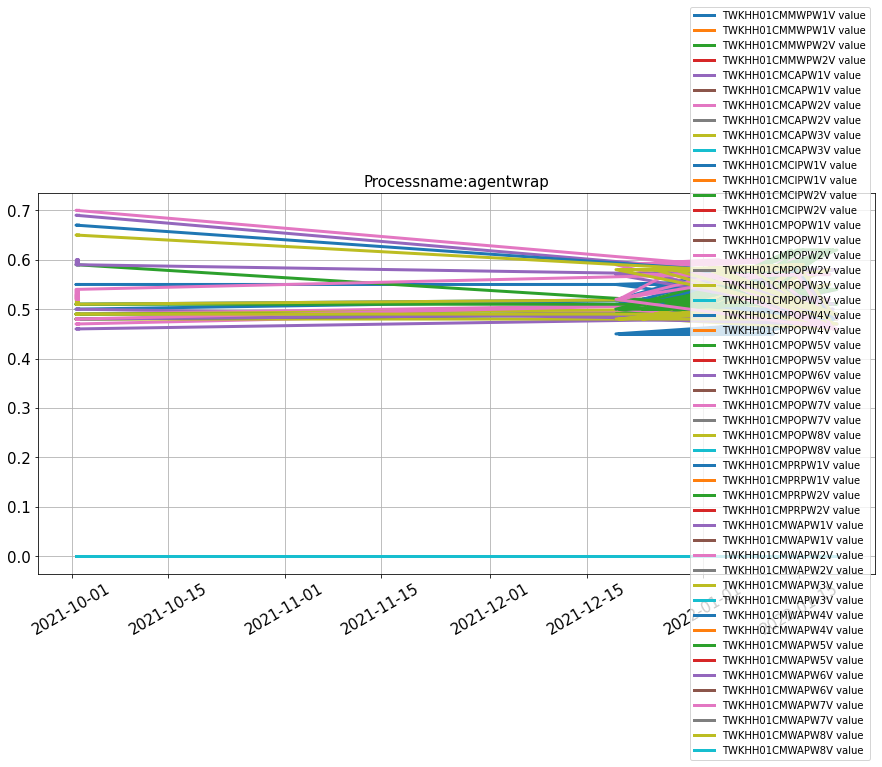

(22,)
(22,)


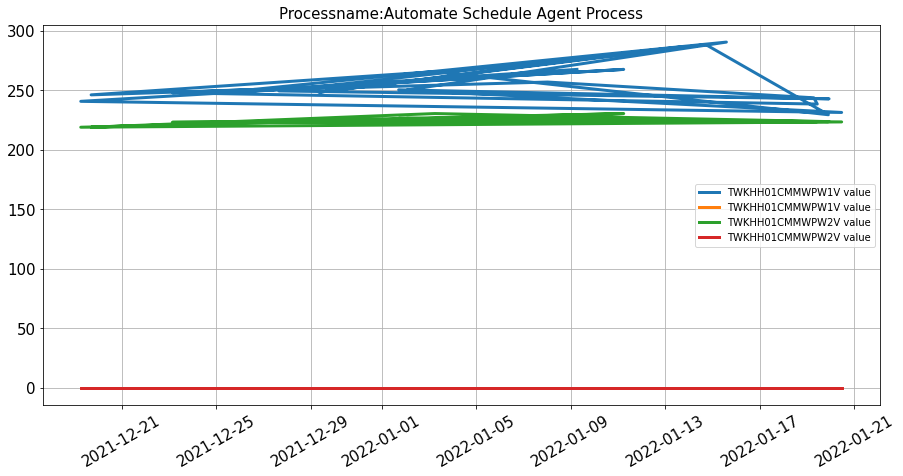

(22,)
(22,)


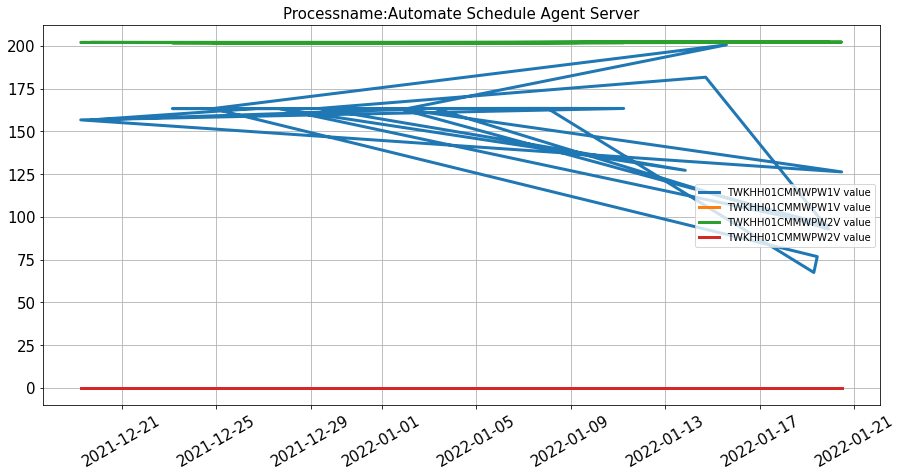

(3,)


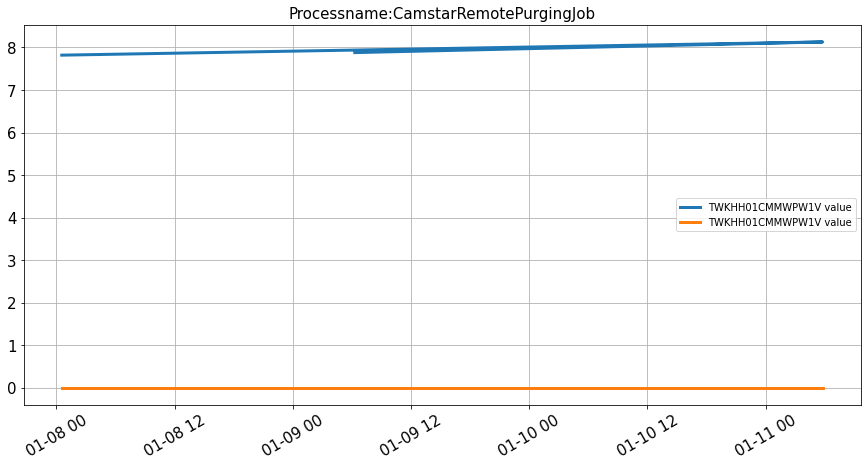

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


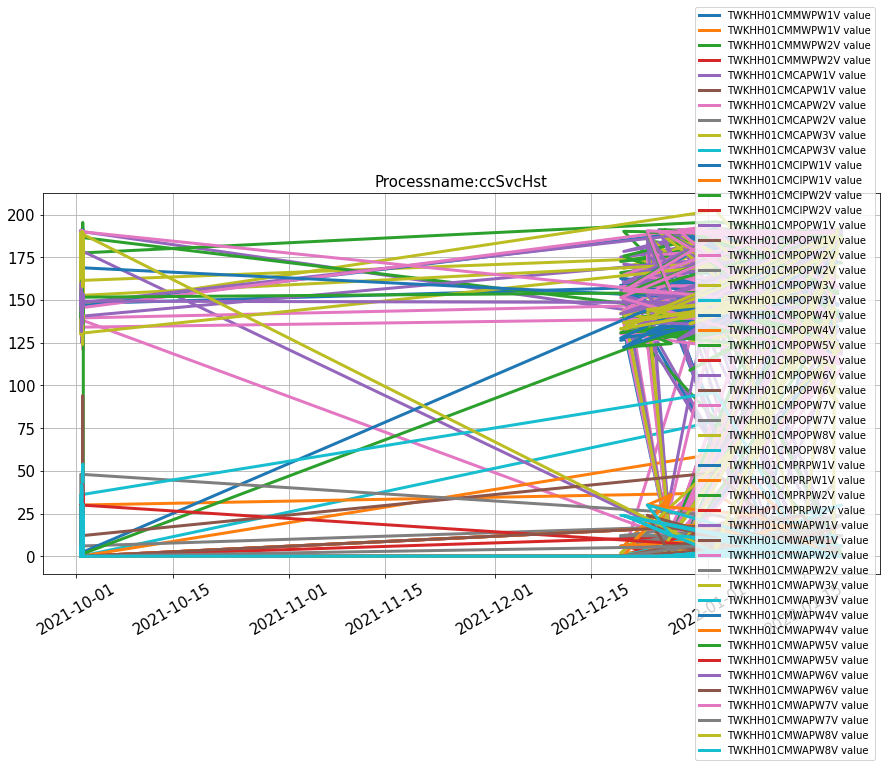

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


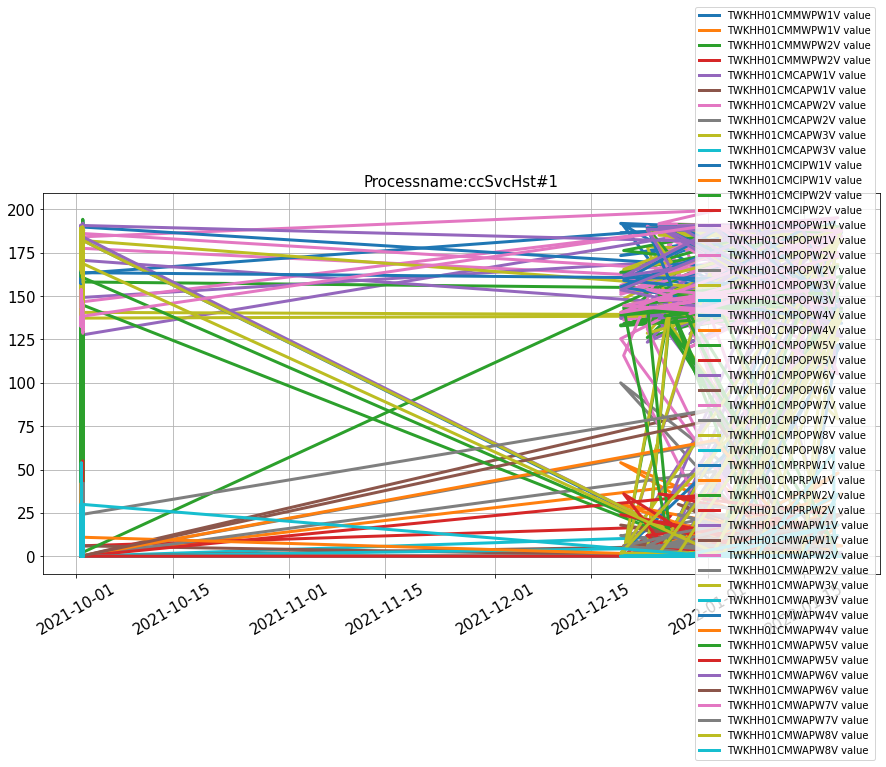

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(33,)
(32,)


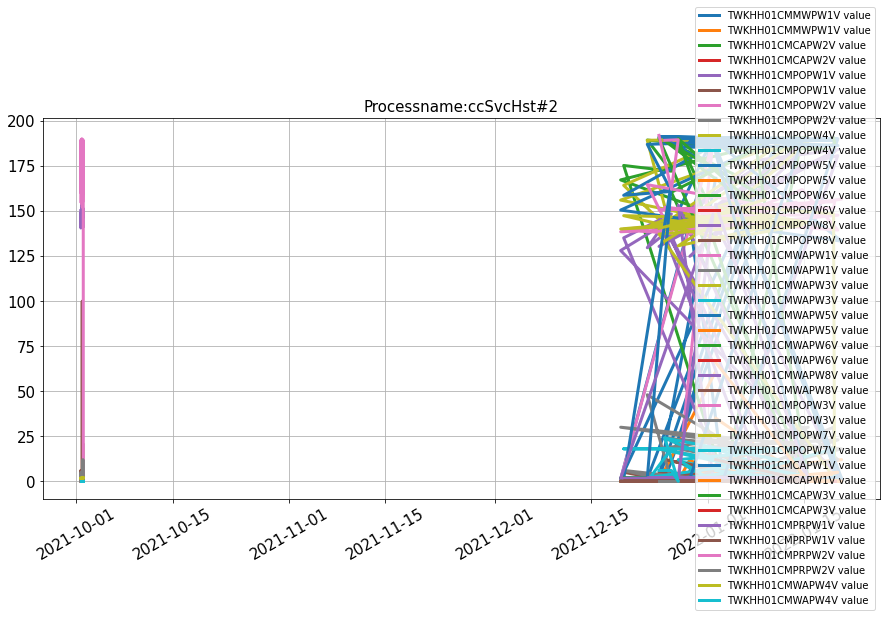

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


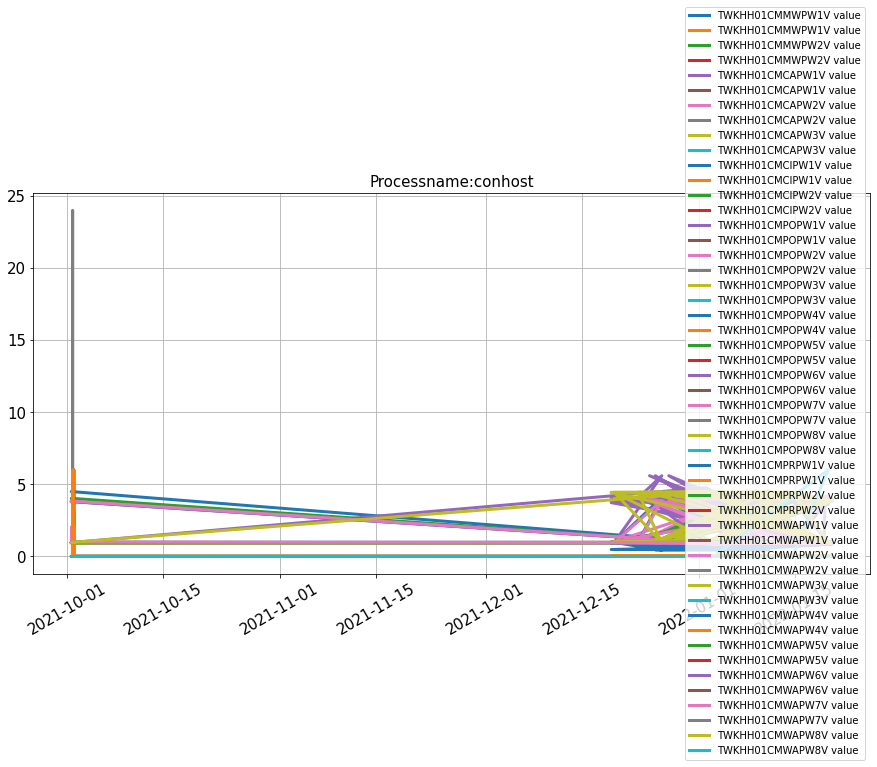

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(53,)
(53,)
(45,)
(53,)
(53,)
(55,)
(55,)
(17,)
(11,)
(3,)


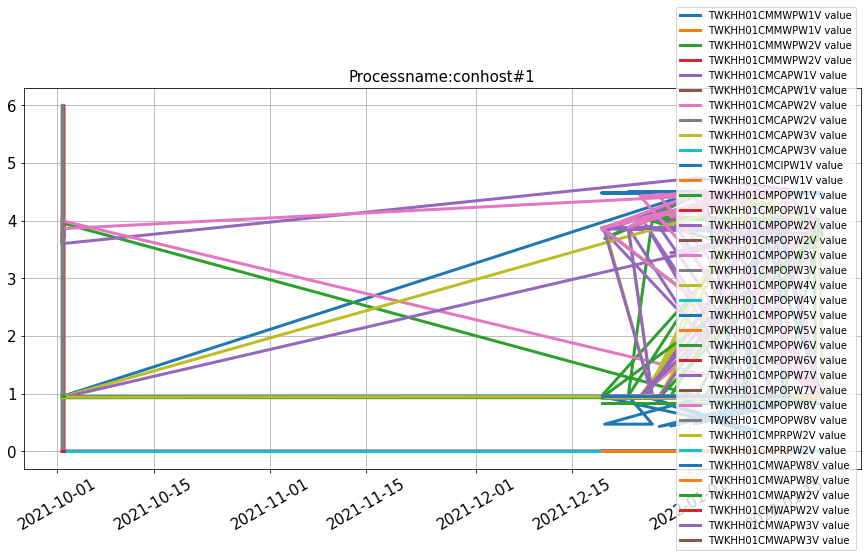

(21,)
(15,)
(4,)
(1,)
(1,)
(1,)
(1,)


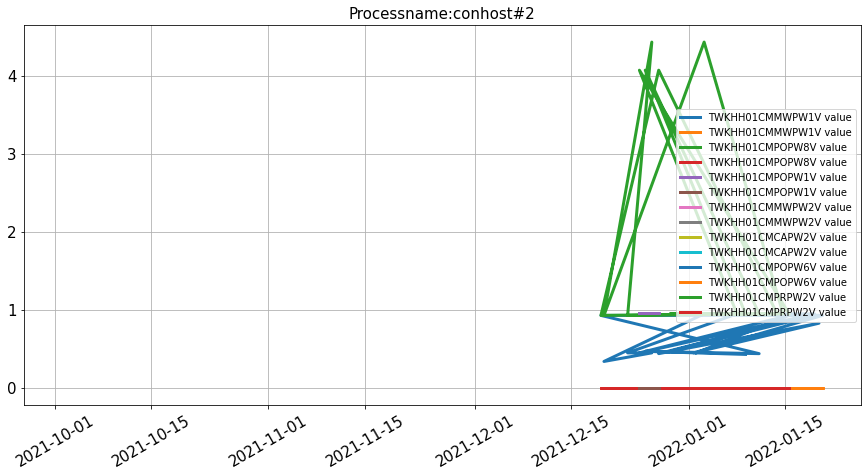

(19,)


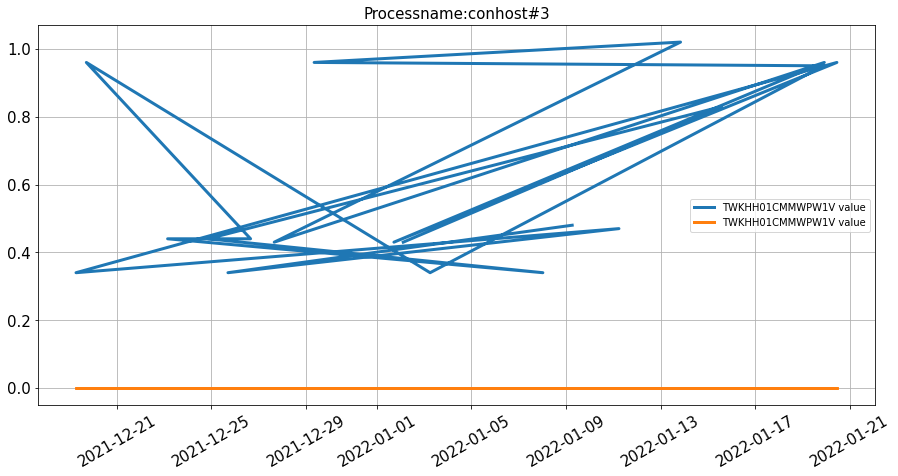

(16,)


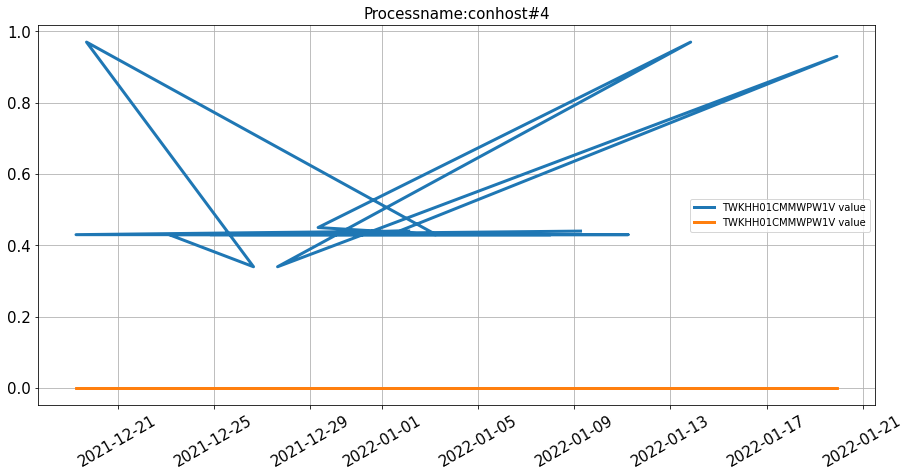

(14,)


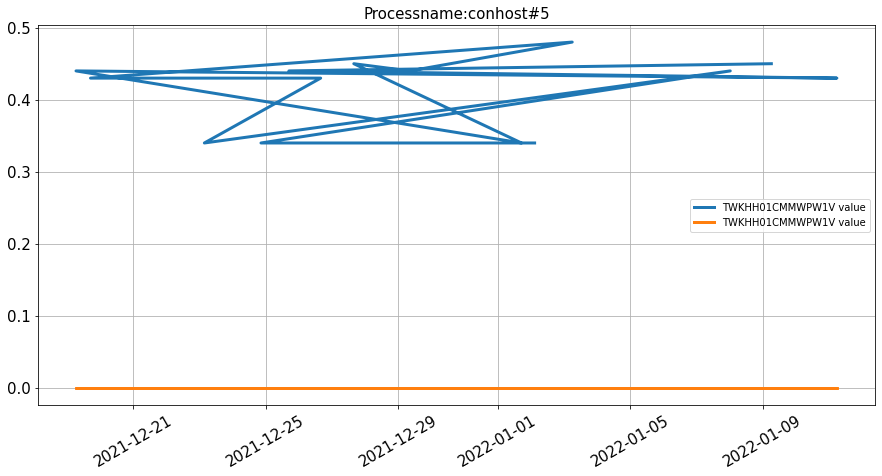

(14,)


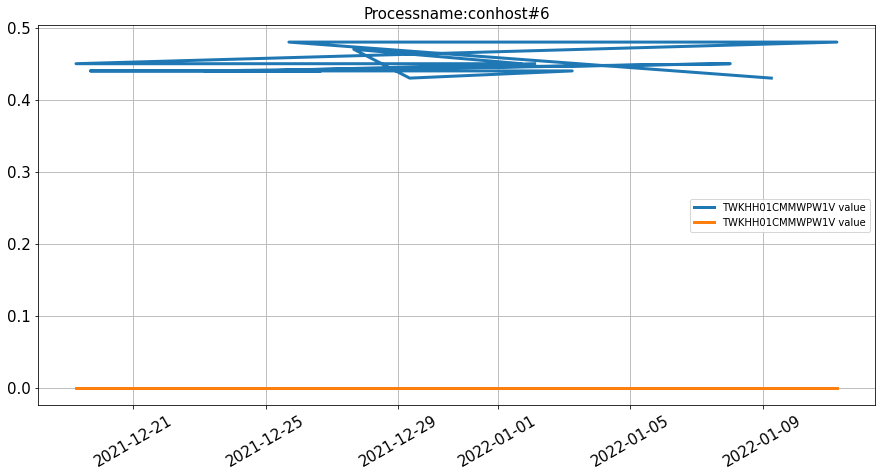

(14,)


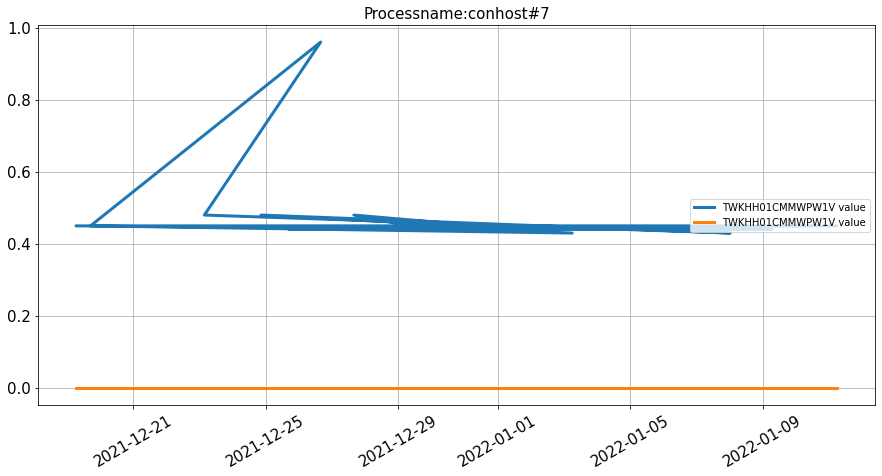

(14,)


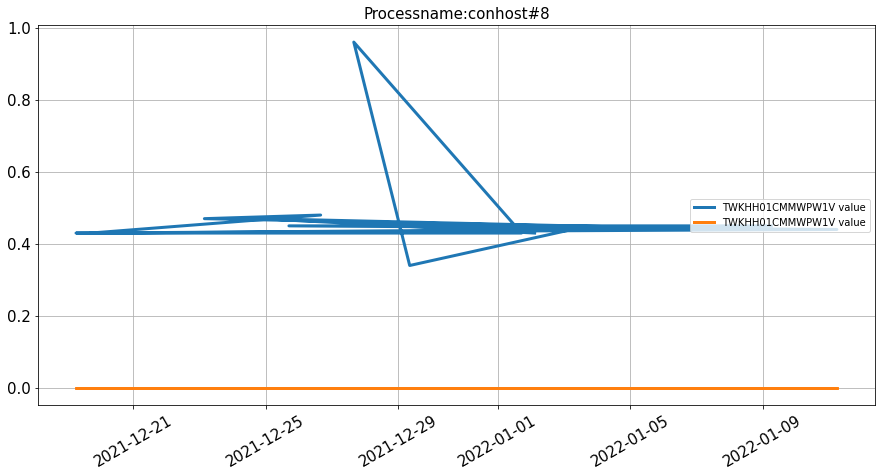

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


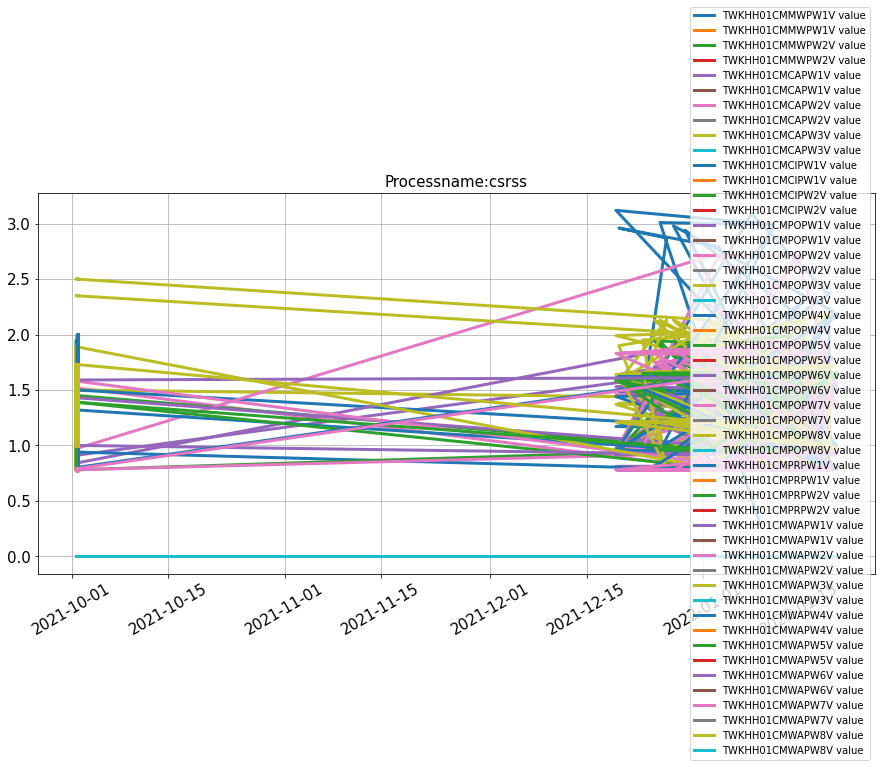

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


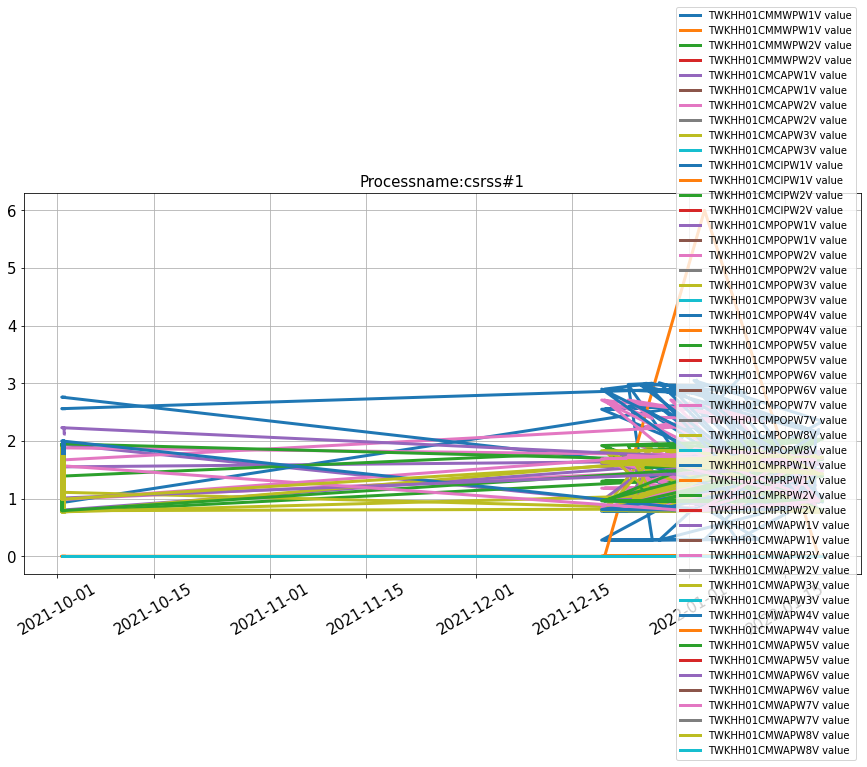

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(33,)
(32,)


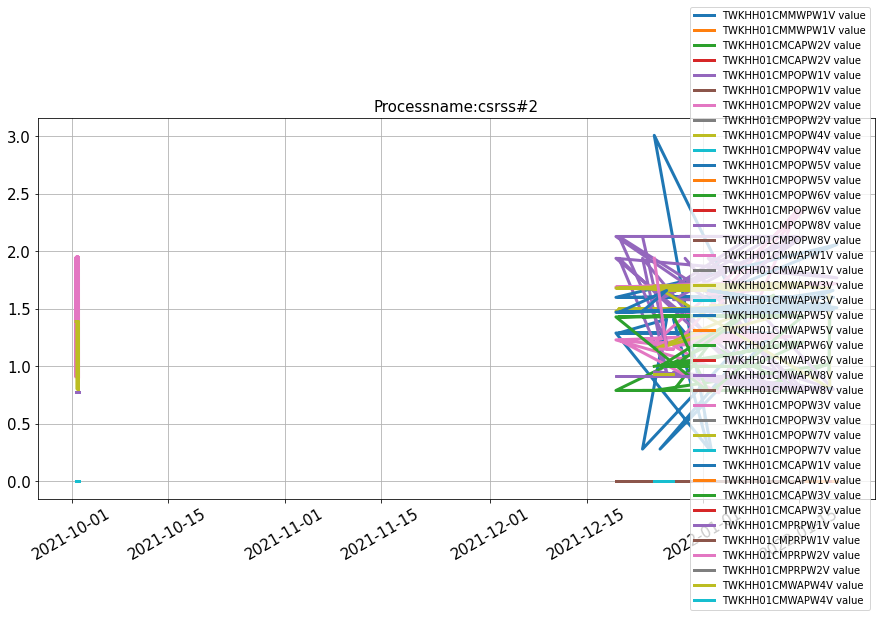

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


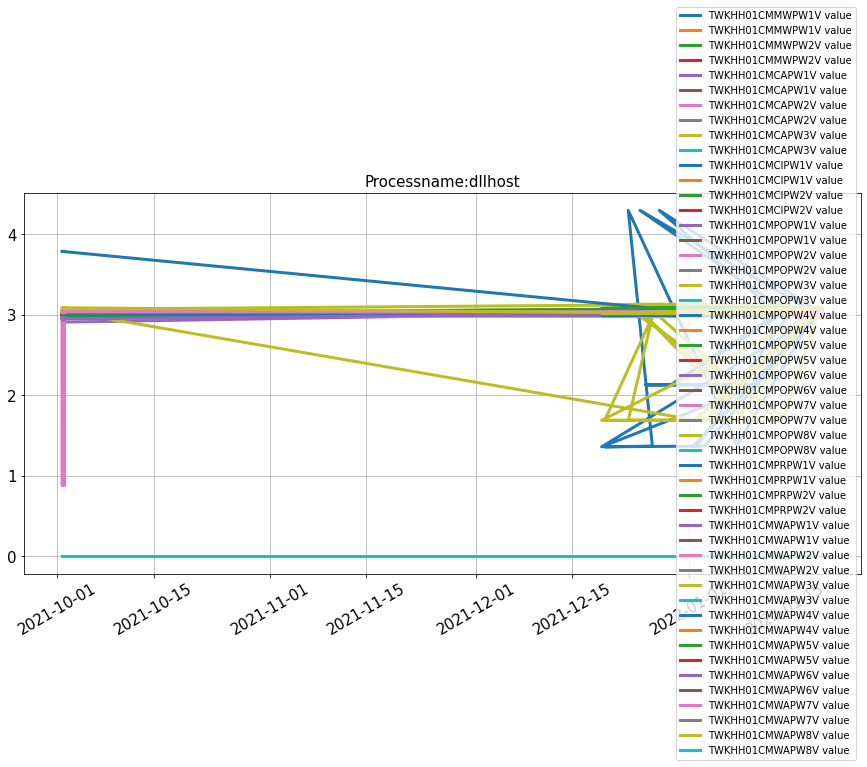

(14,)
(17,)
(1,)
(1,)
(1,)
(6,)


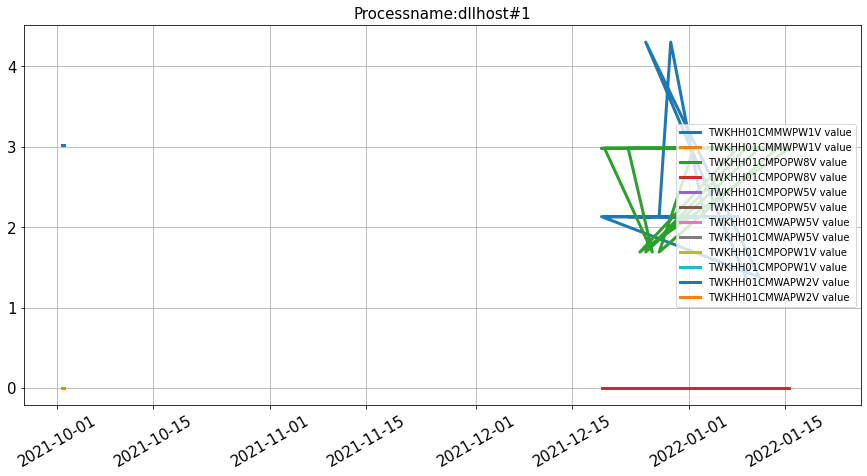

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


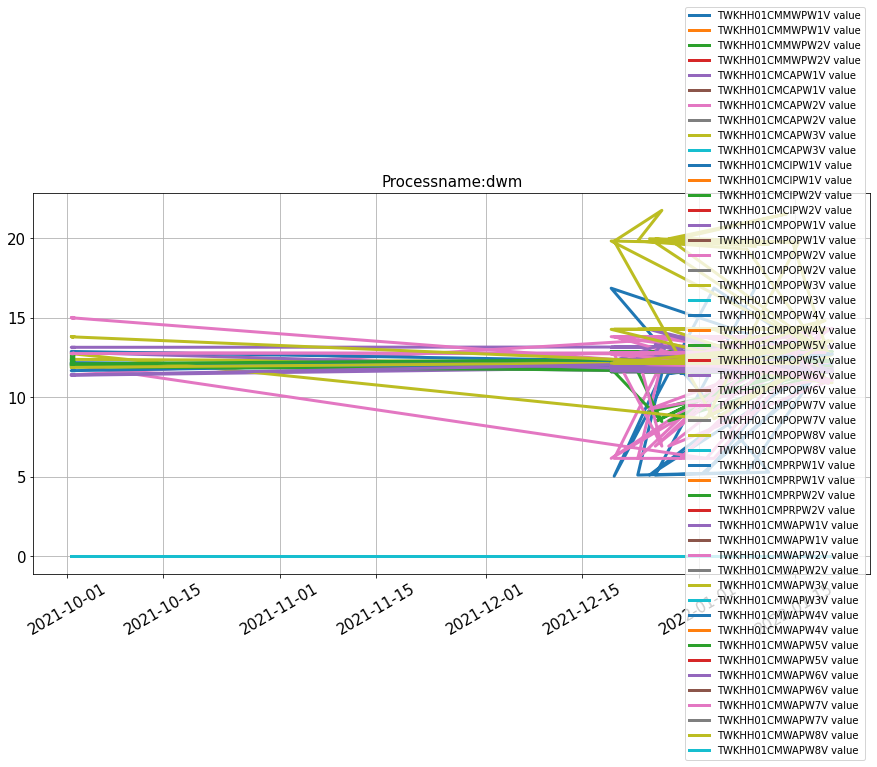

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(33,)
(32,)


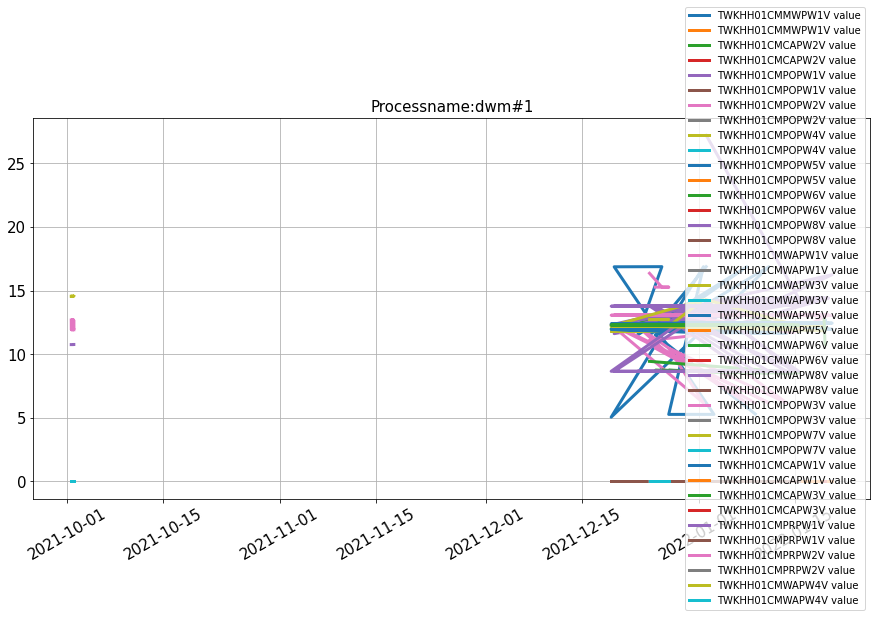

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(33,)
(32,)


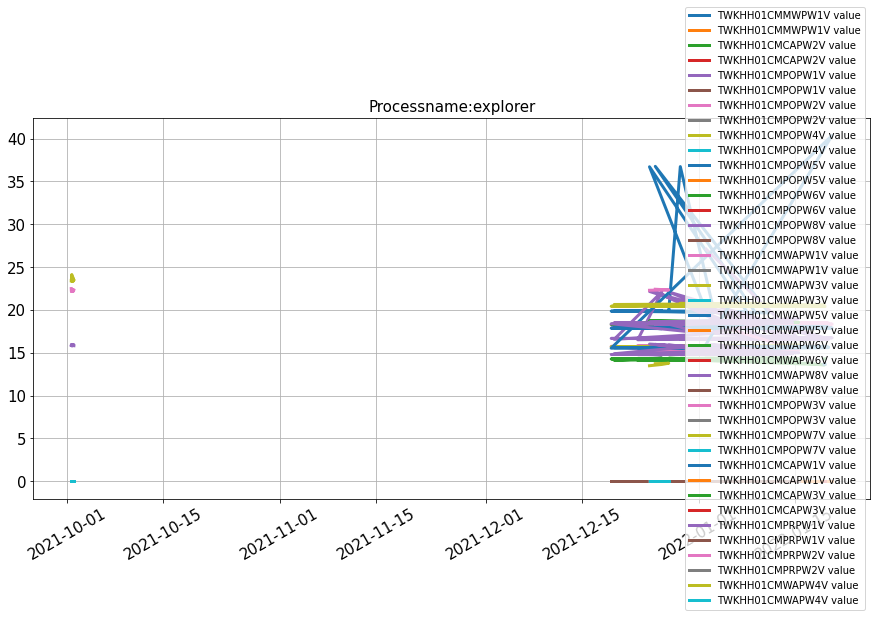

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(33,)
(32,)


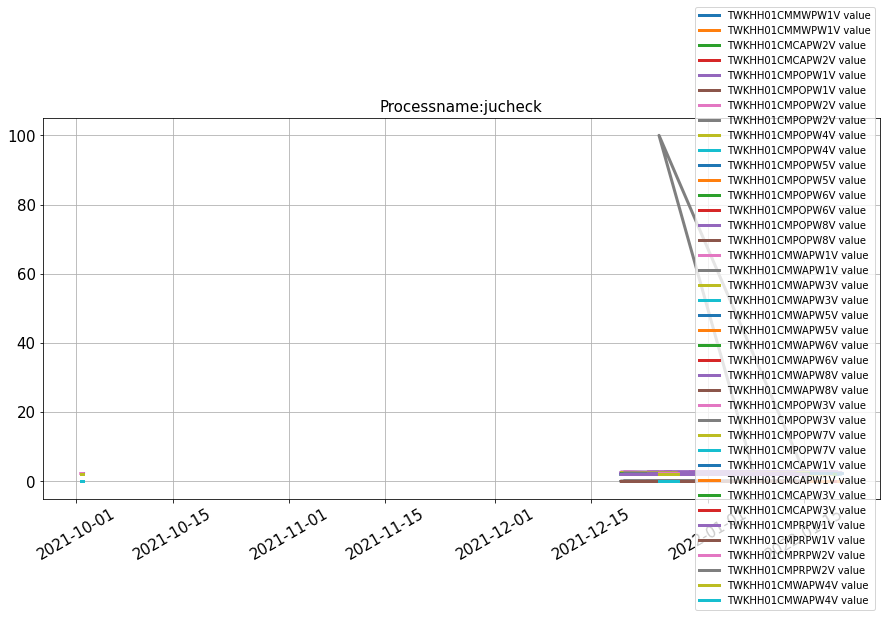

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(33,)
(32,)


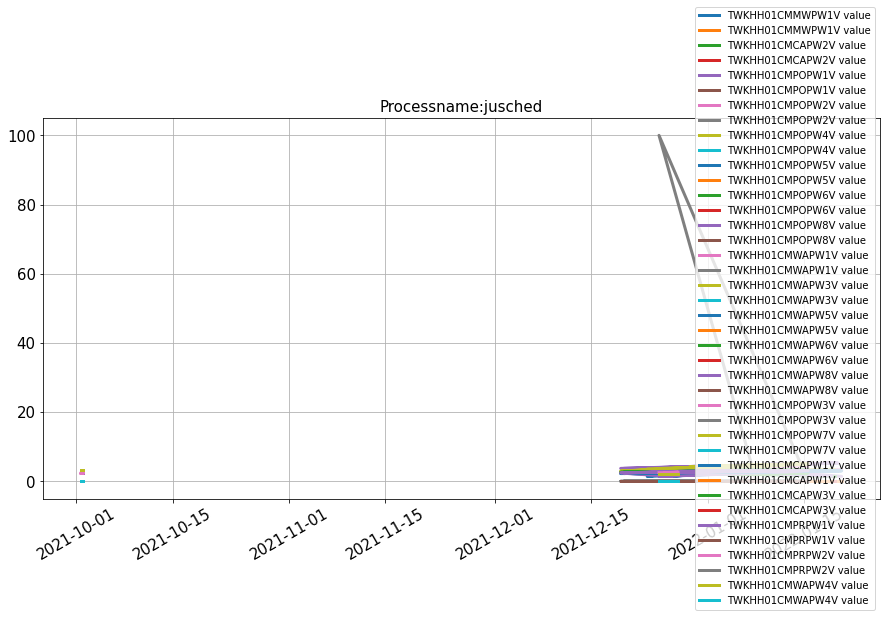

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(38,)


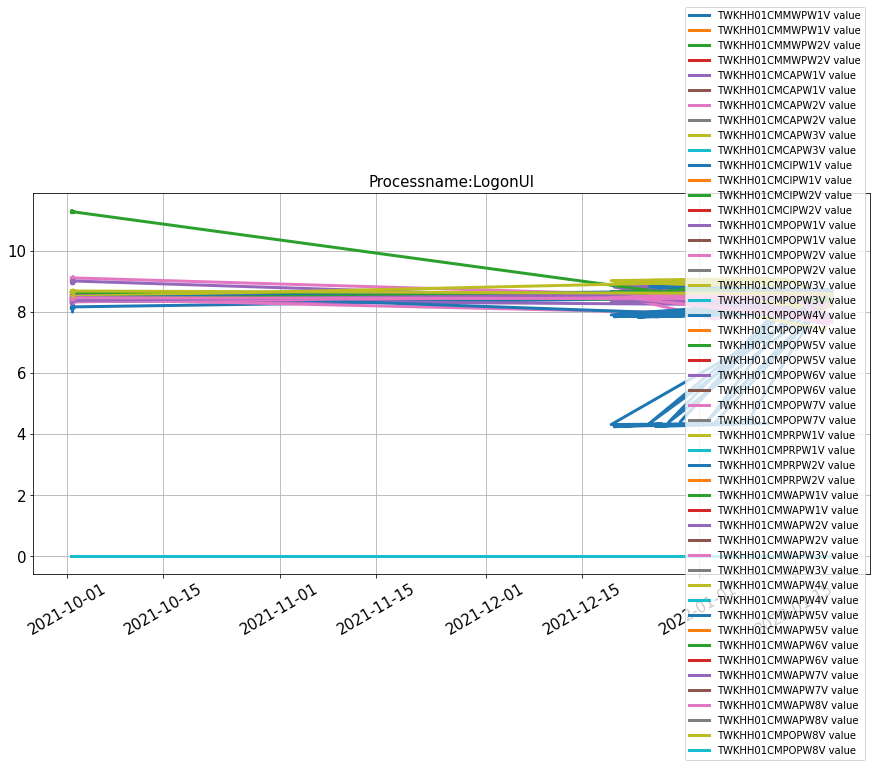

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


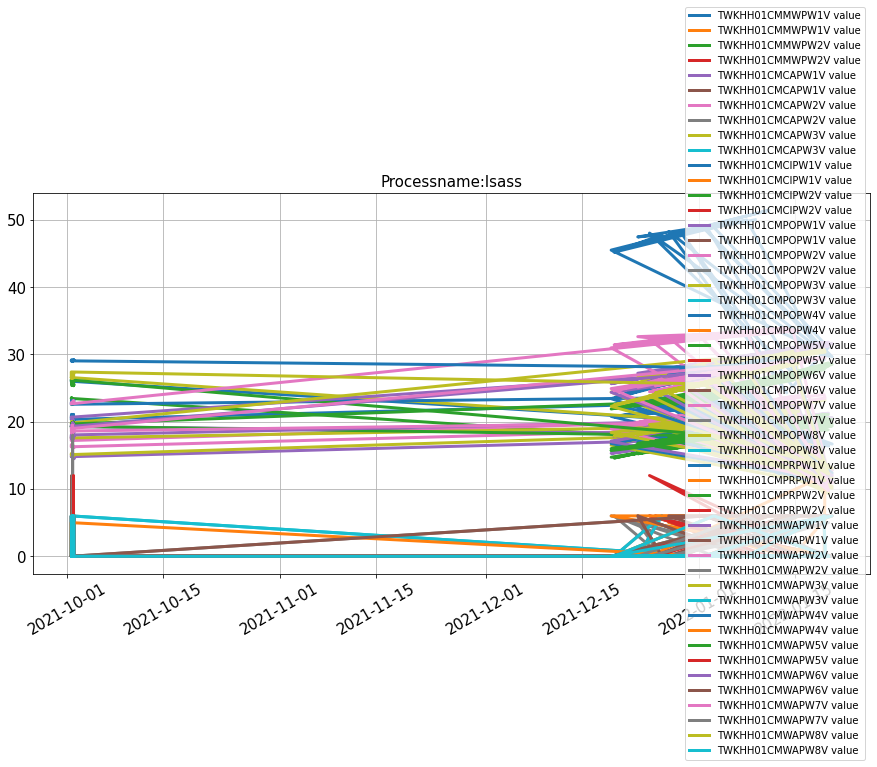

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


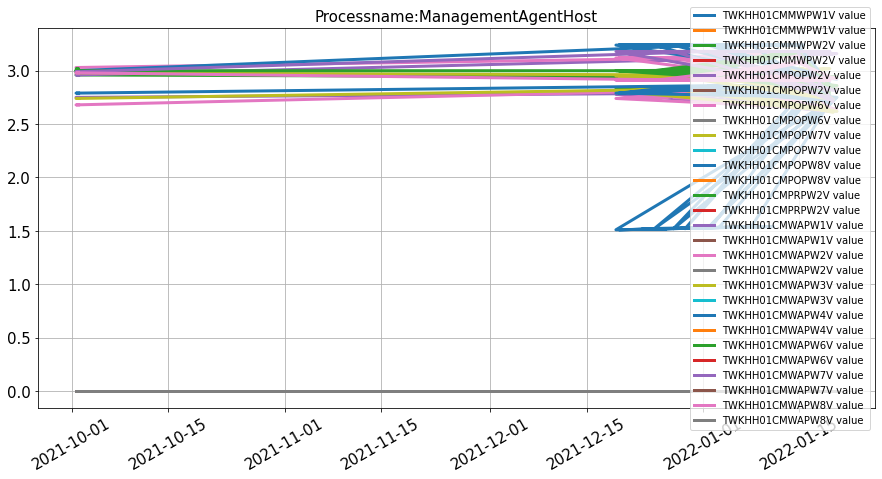

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


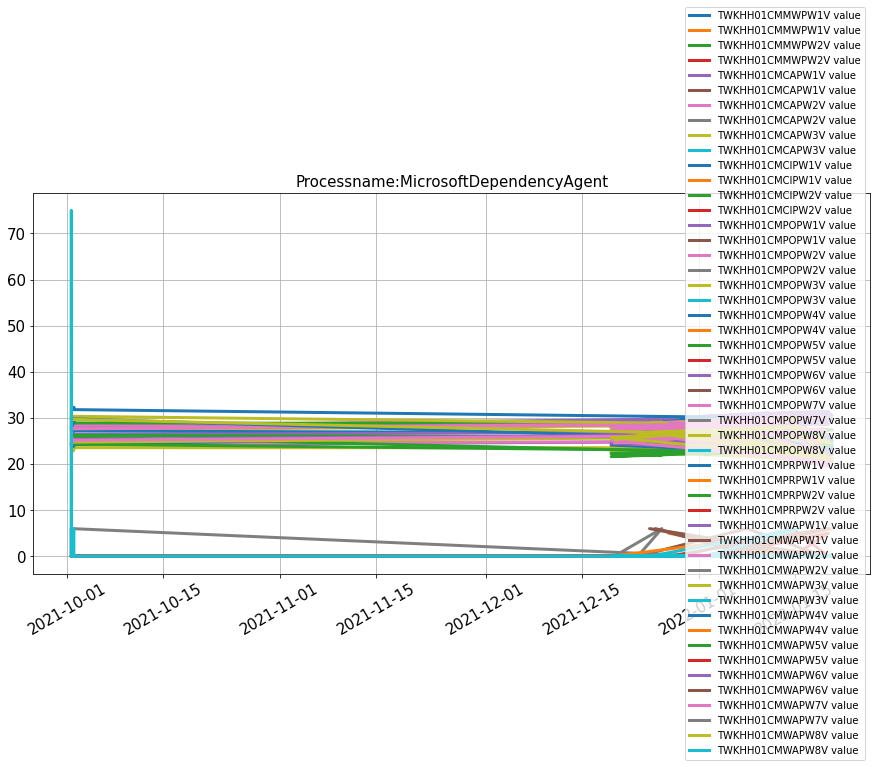

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(33,)


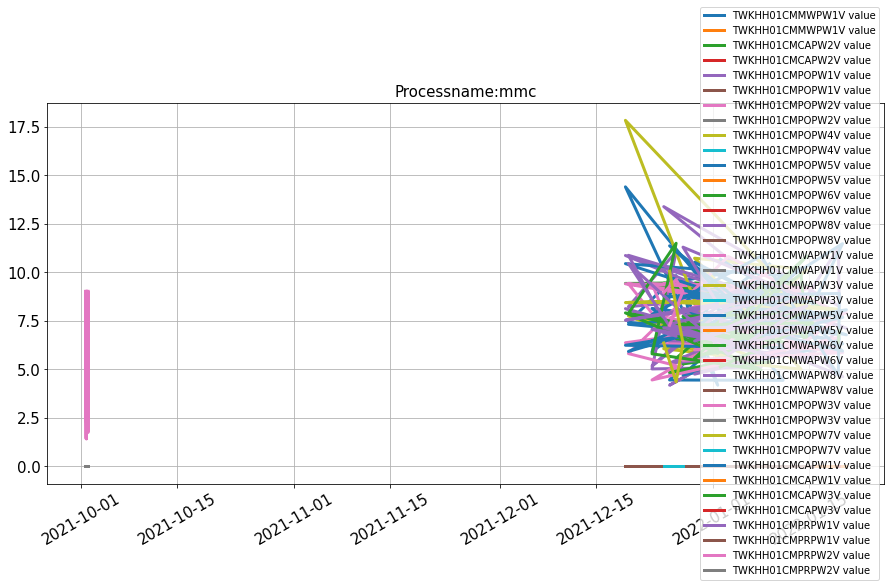

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


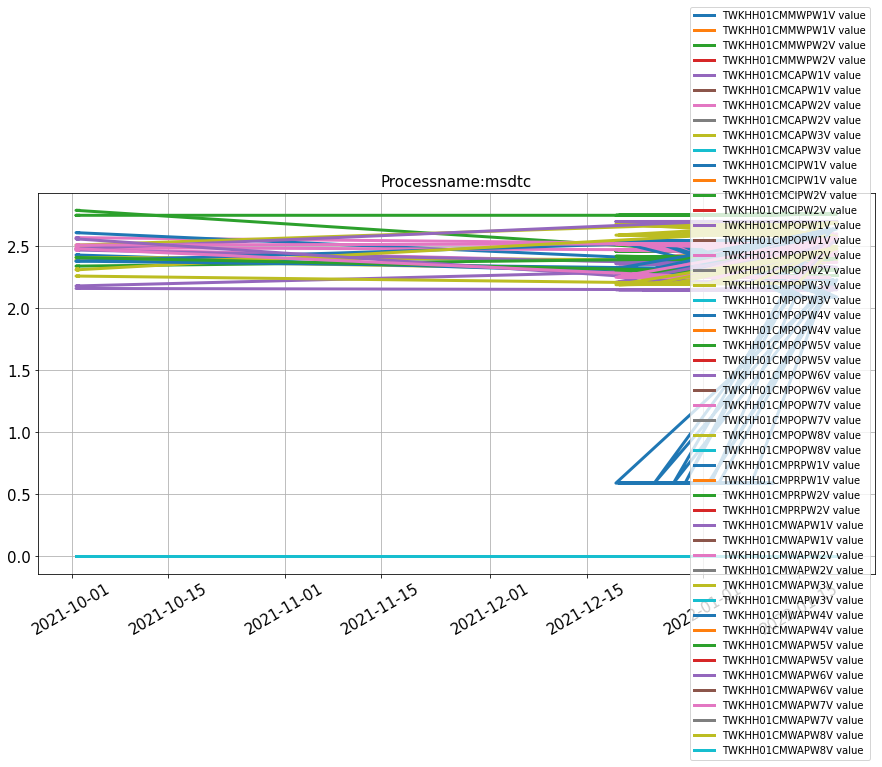

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(32,)
(32,)


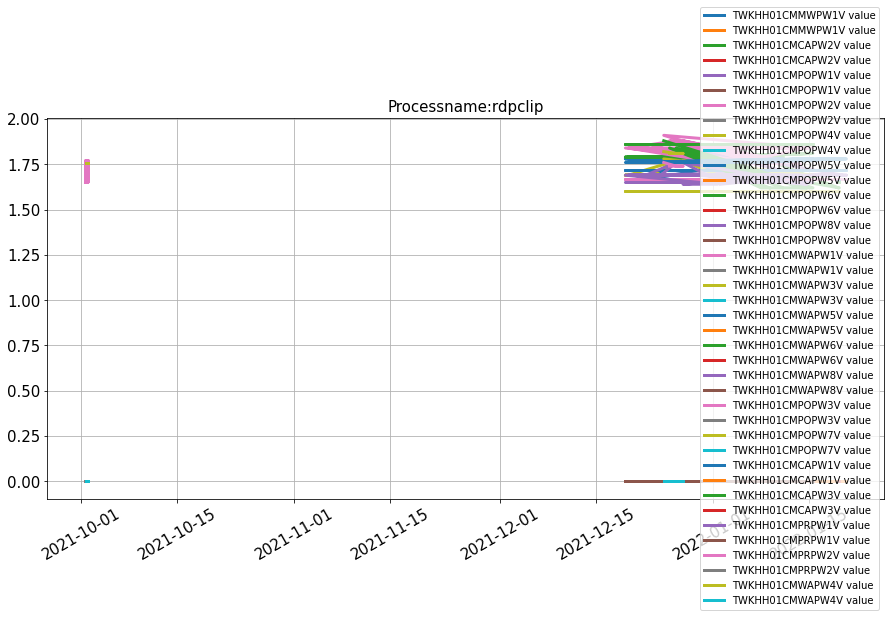

(21,)


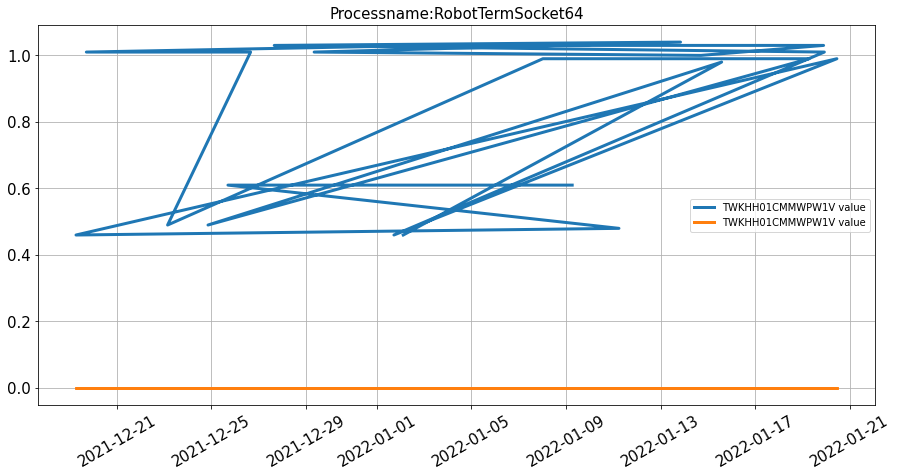

(19,)


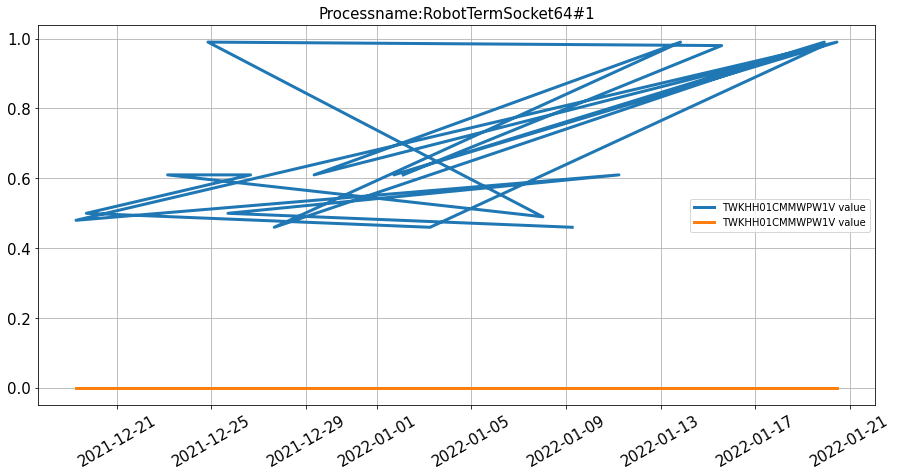

(16,)


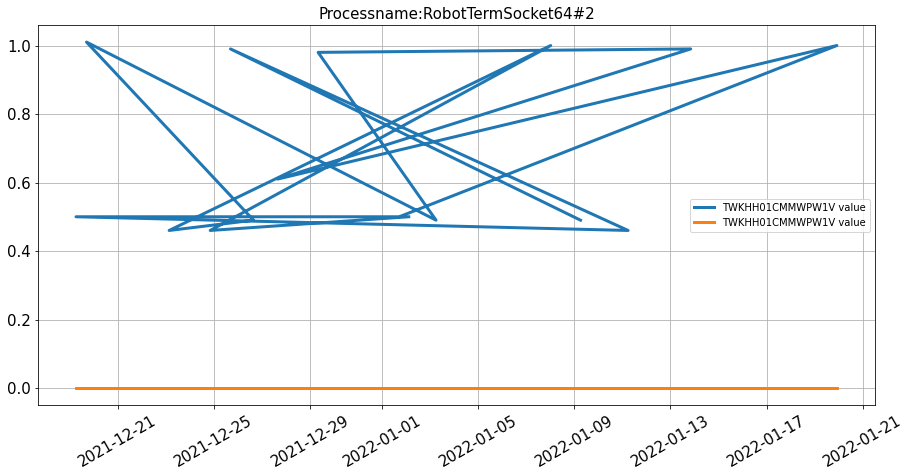

(14,)


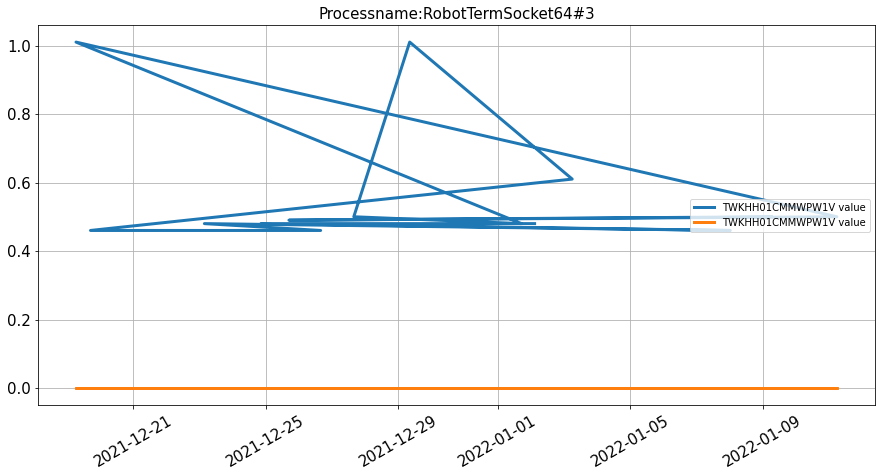

(14,)


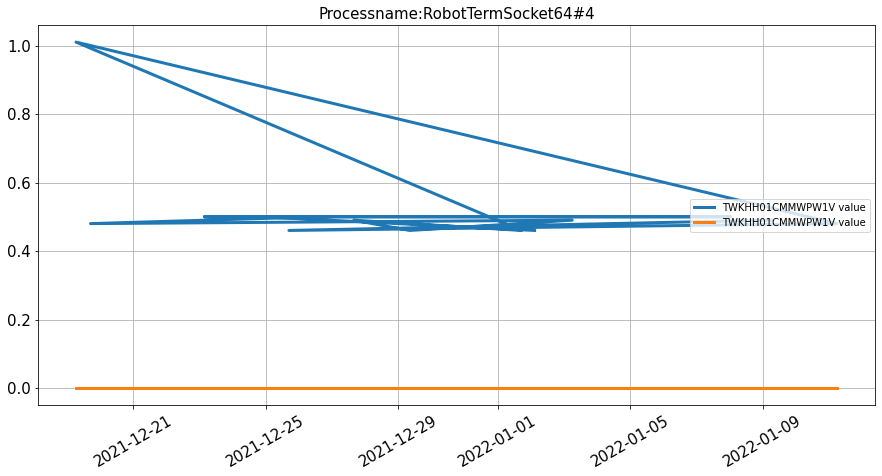

(14,)


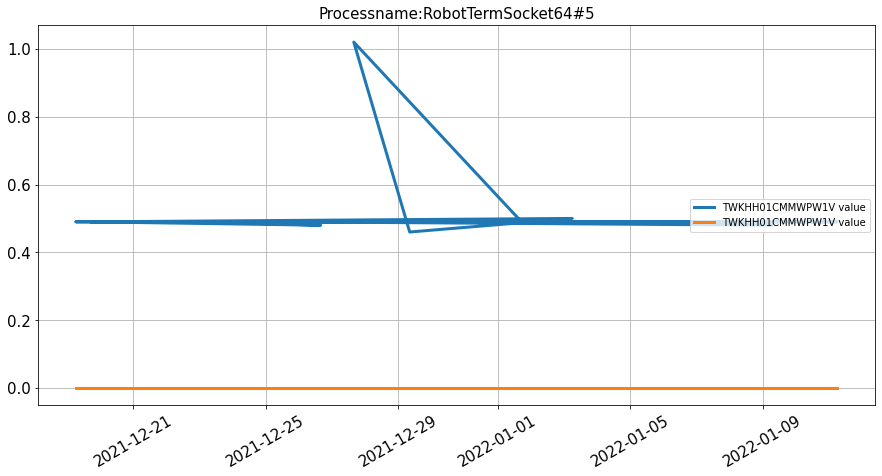

(14,)


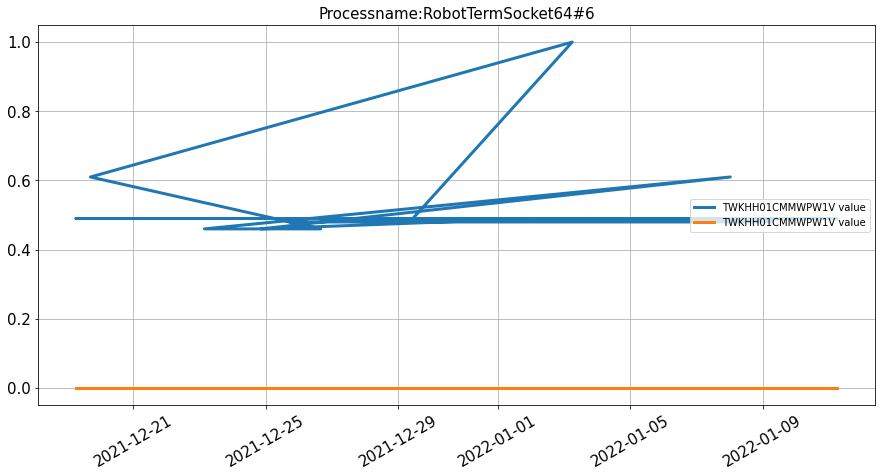

(22,)
(22,)
(55,)
(55,)
(51,)
(55,)
(55,)
(55,)
(55,)
(53,)
(55,)
(55,)
(55,)
(53,)
(55,)
(55,)
(54,)
(54,)
(54,)
(52,)
(54,)
(54,)
(54,)
(52,)
(54,)


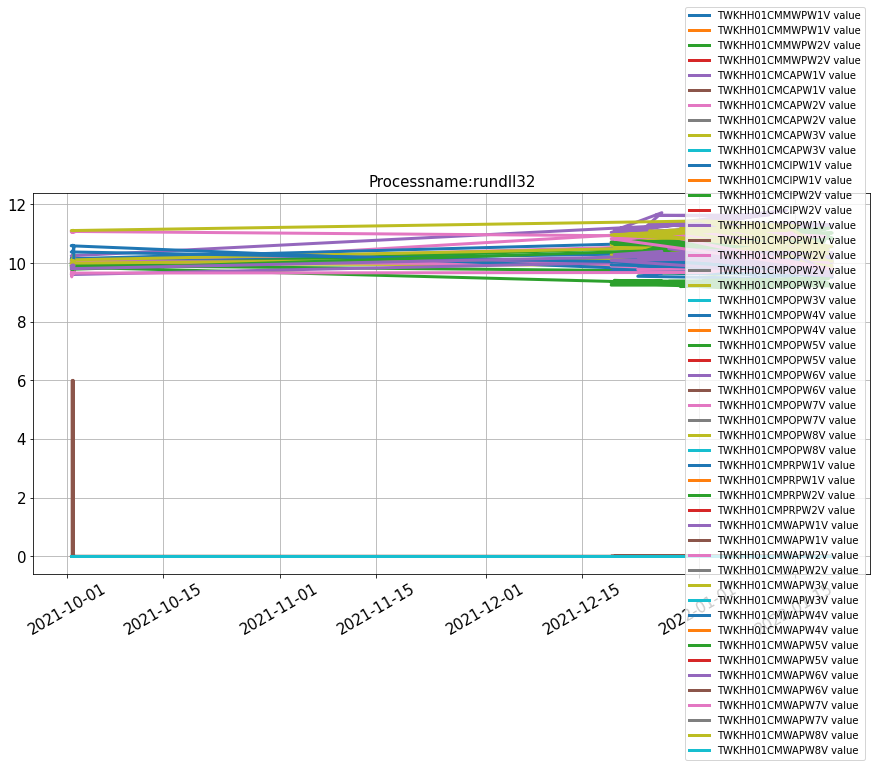

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(32,)
(32,)


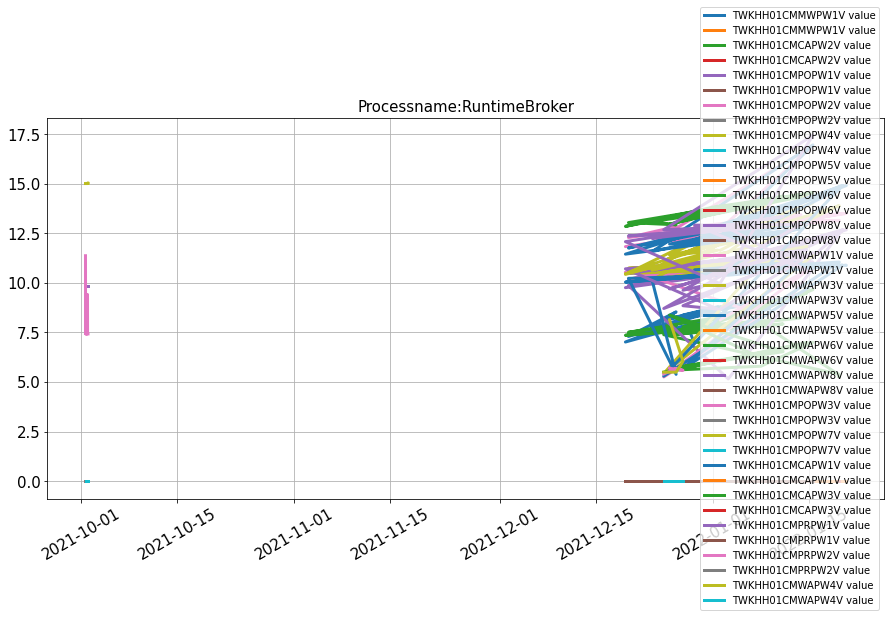

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(33,)
(32,)


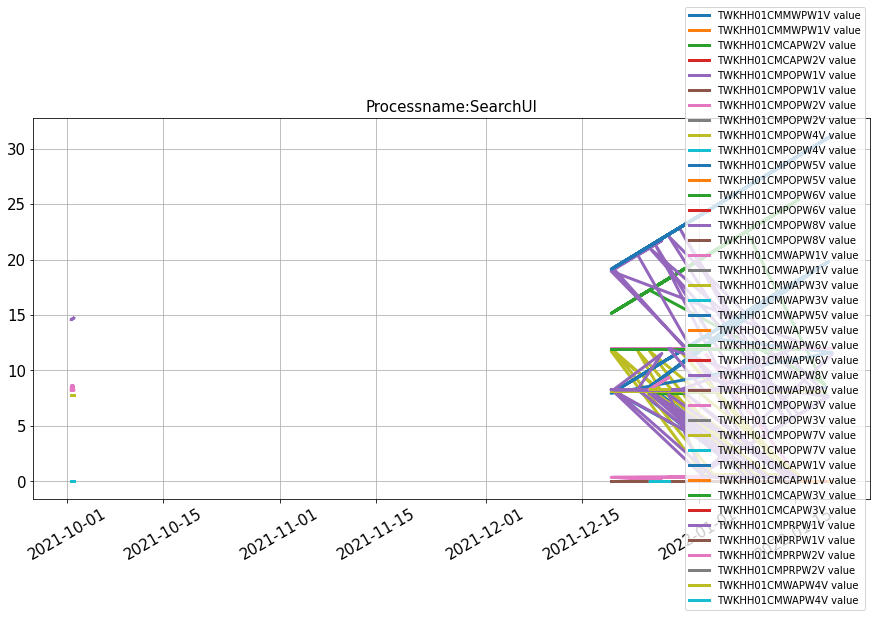

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


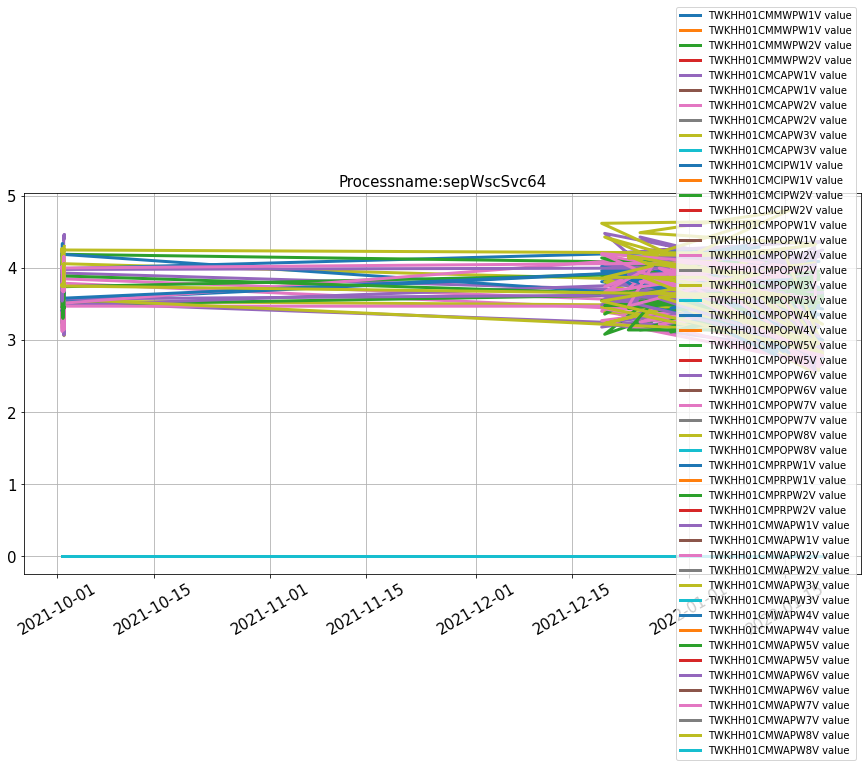

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(32,)
(32,)


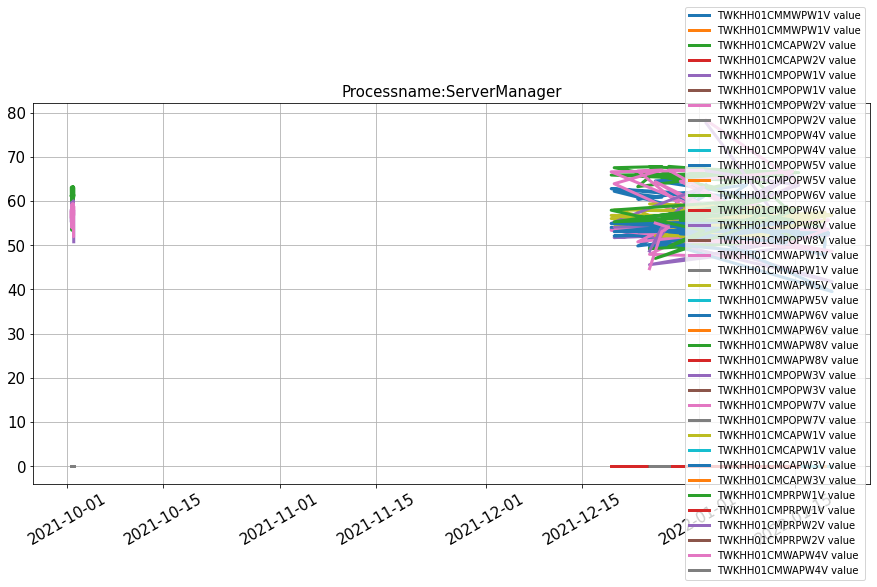

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


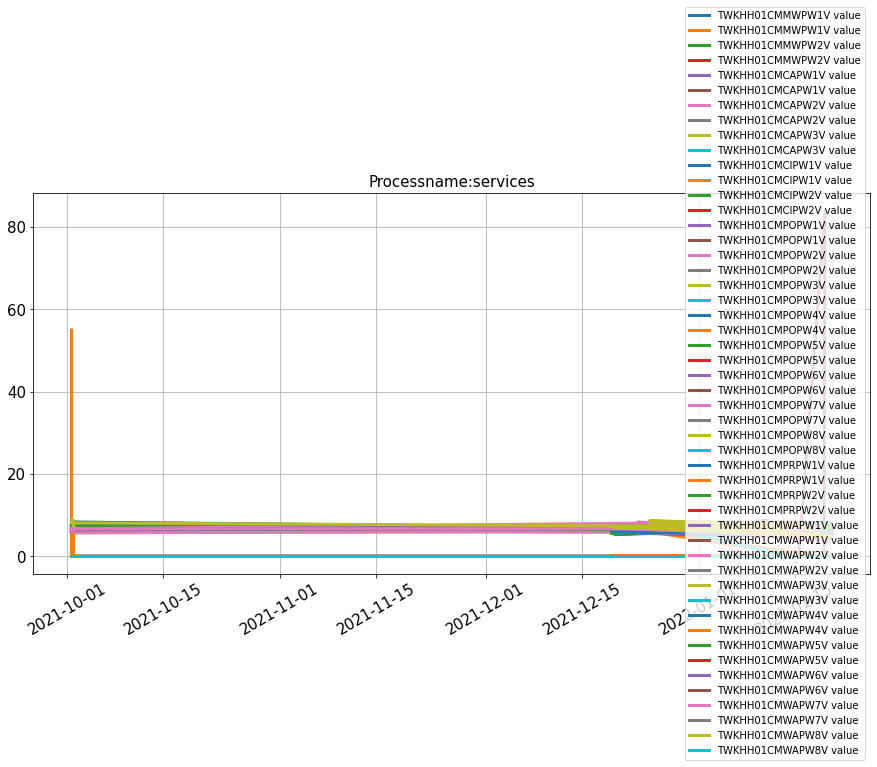

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(32,)
(32,)


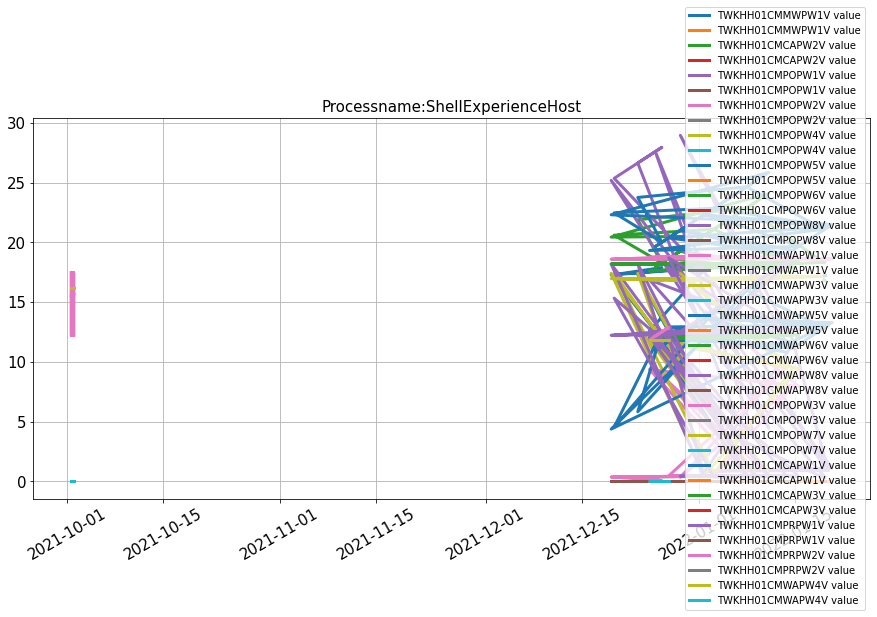

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(32,)
(32,)


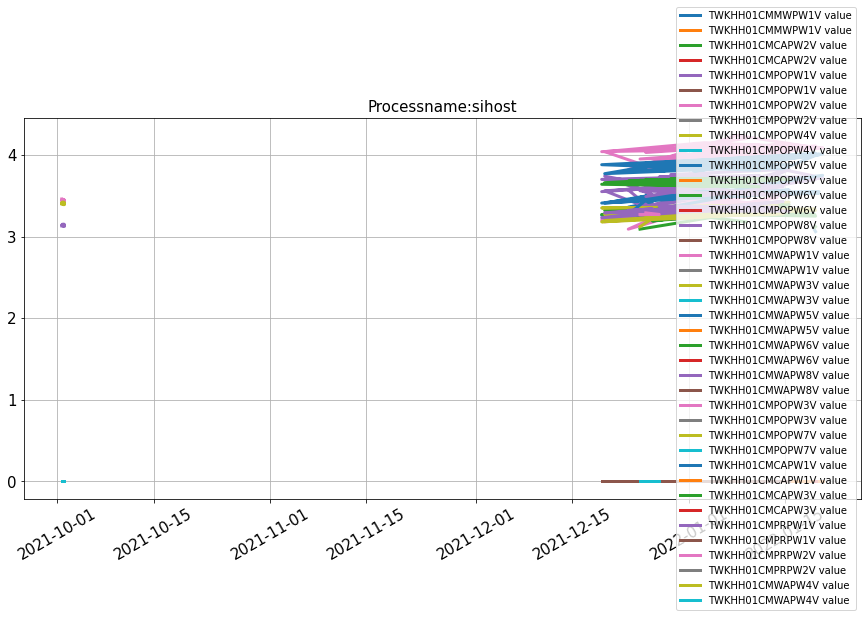

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


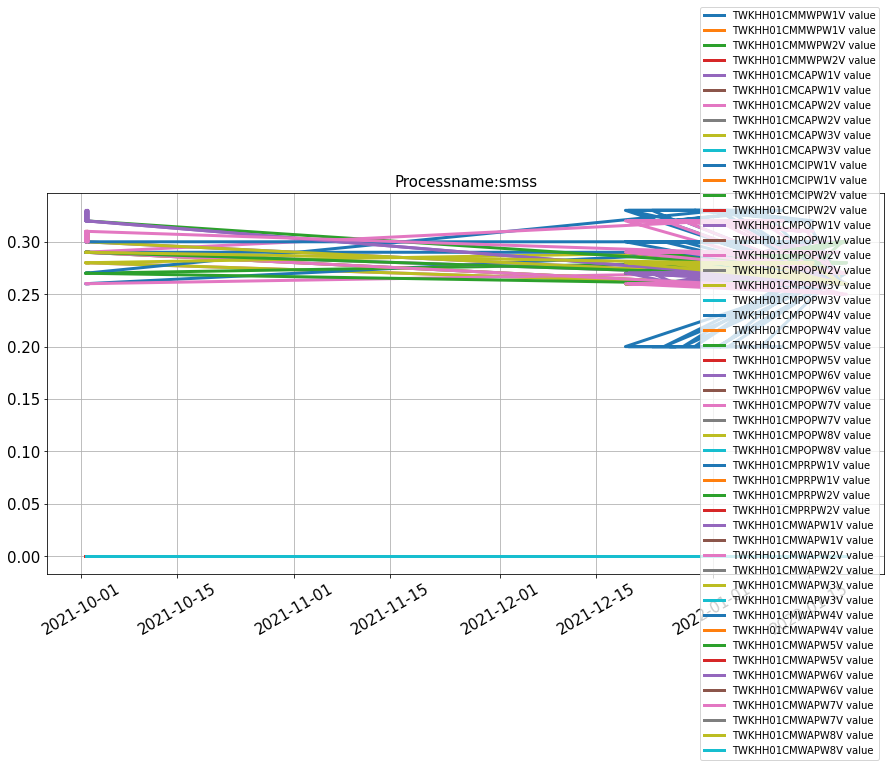

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


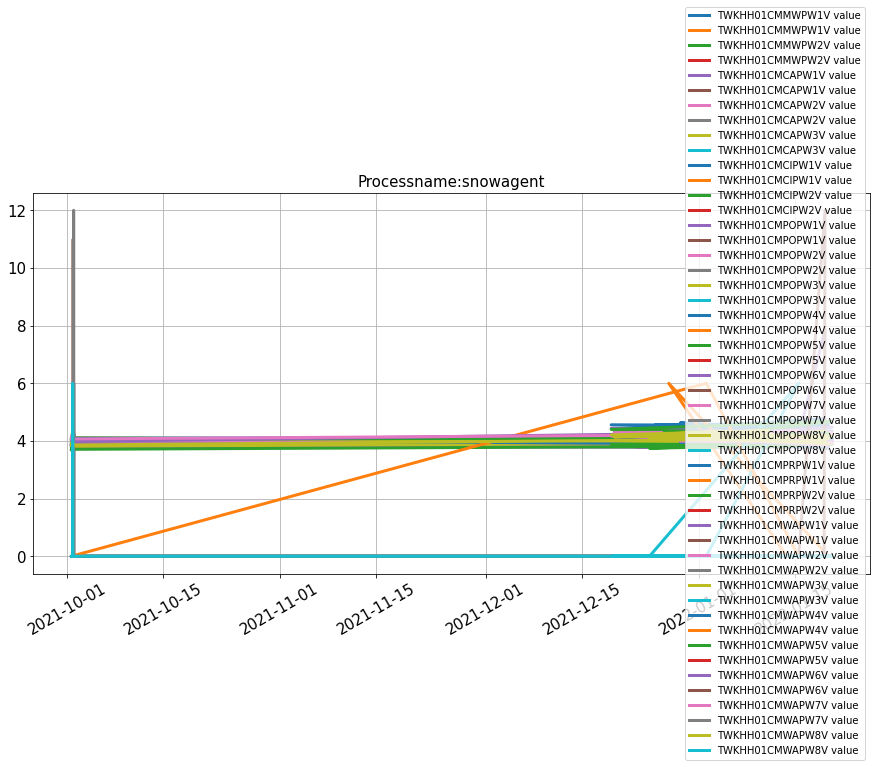

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


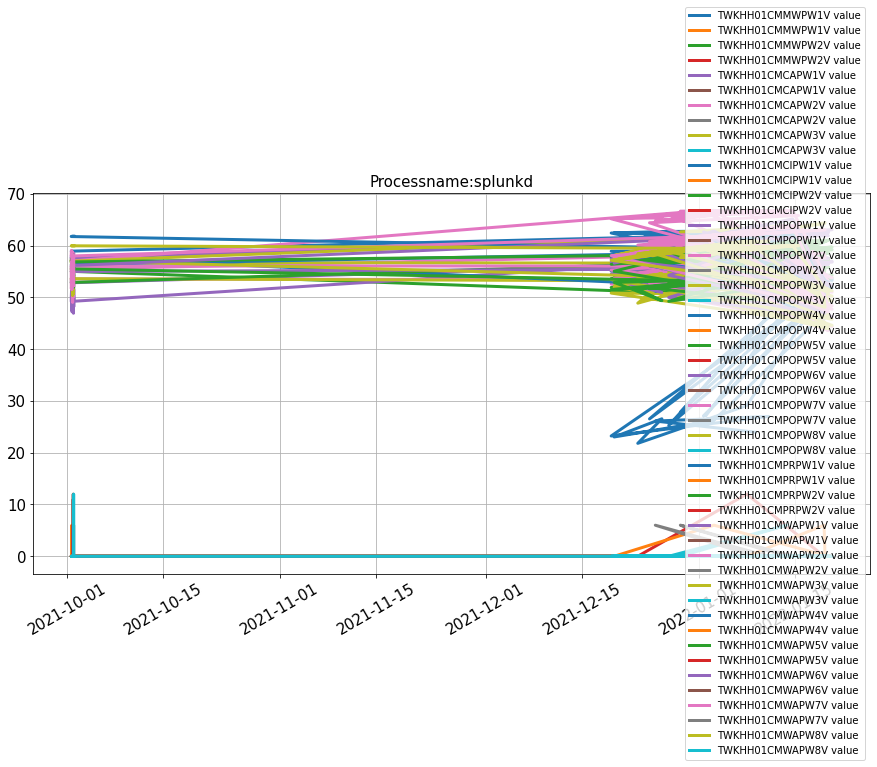

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


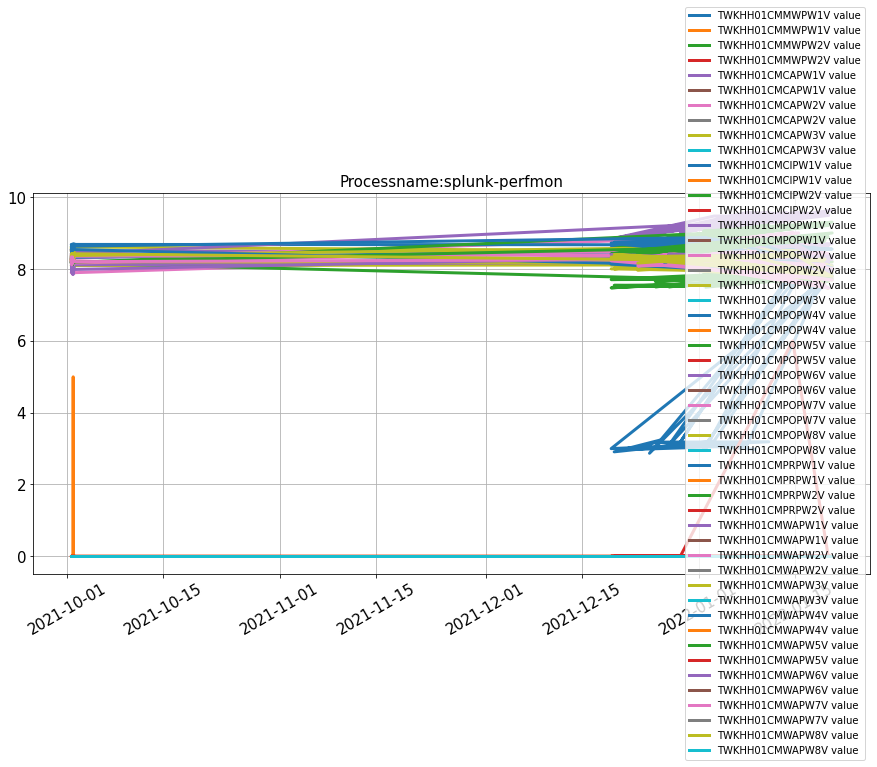

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


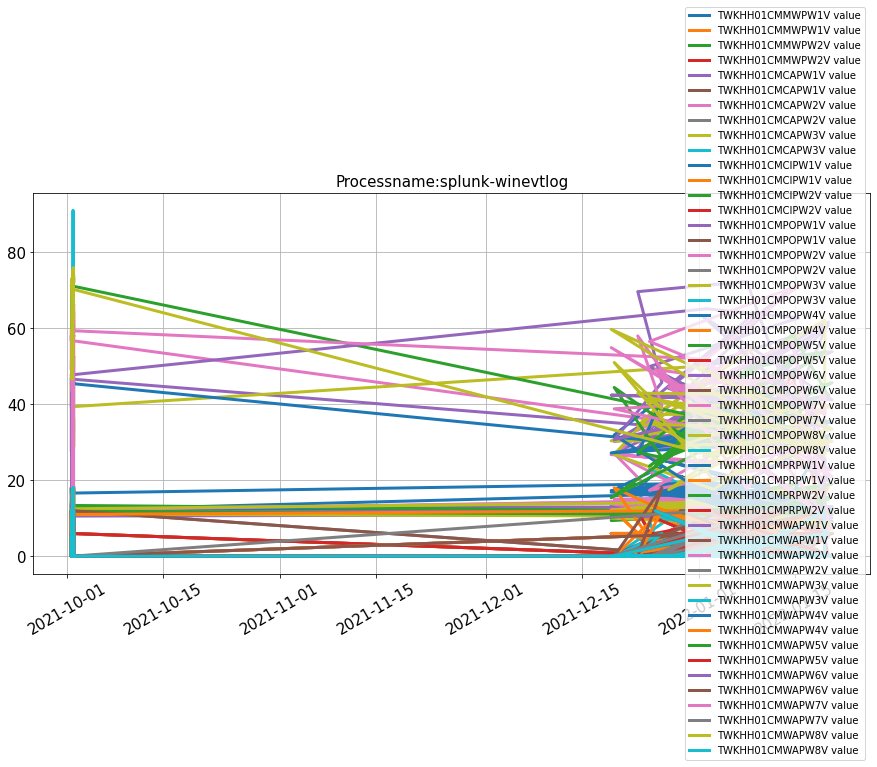

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


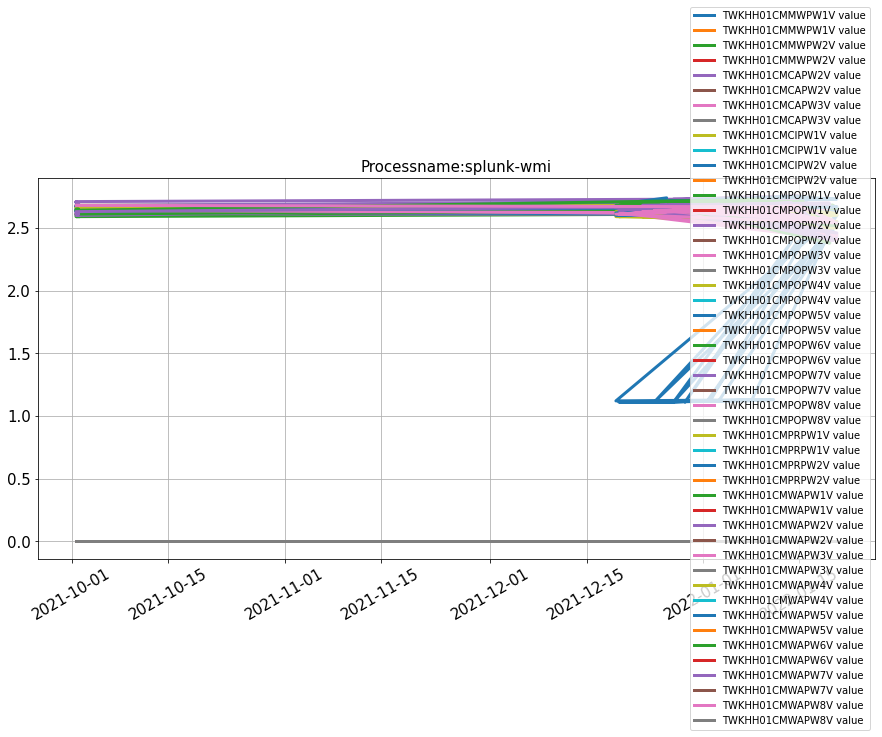

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


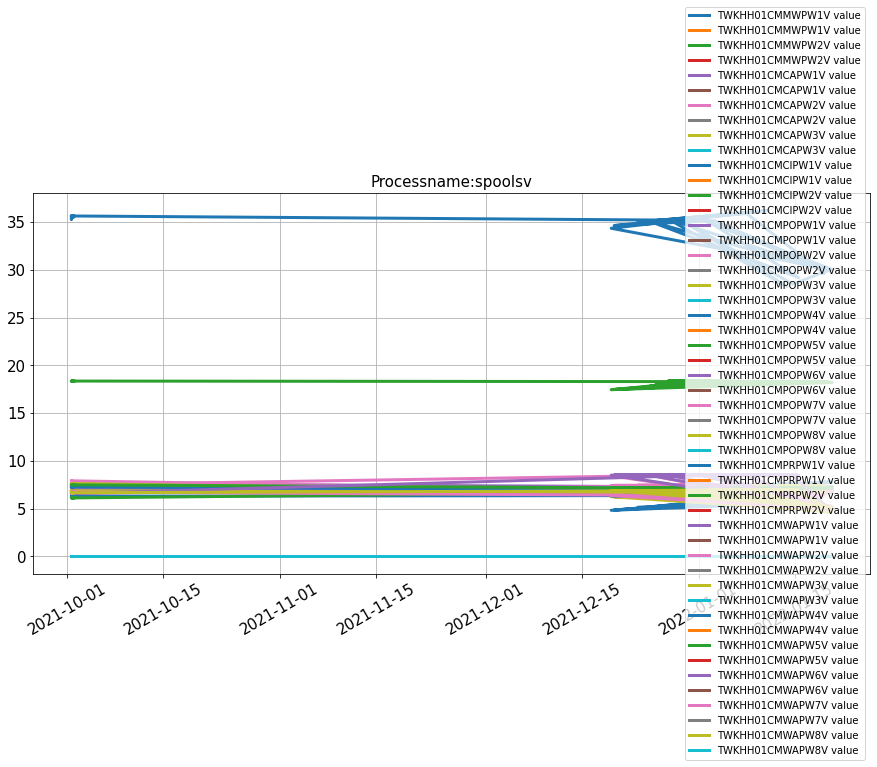

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


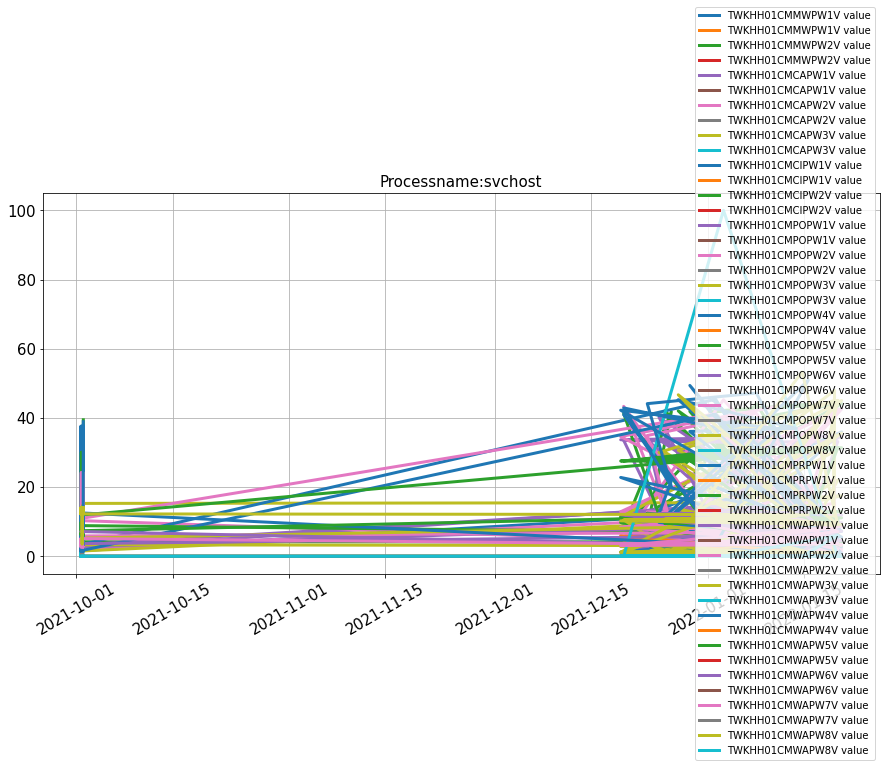

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


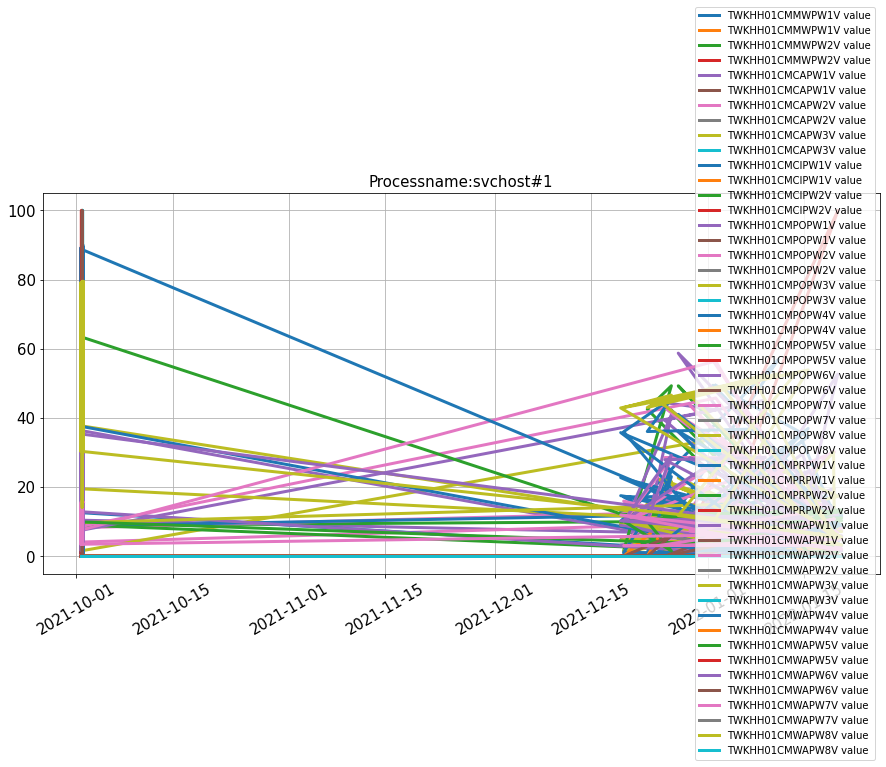

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


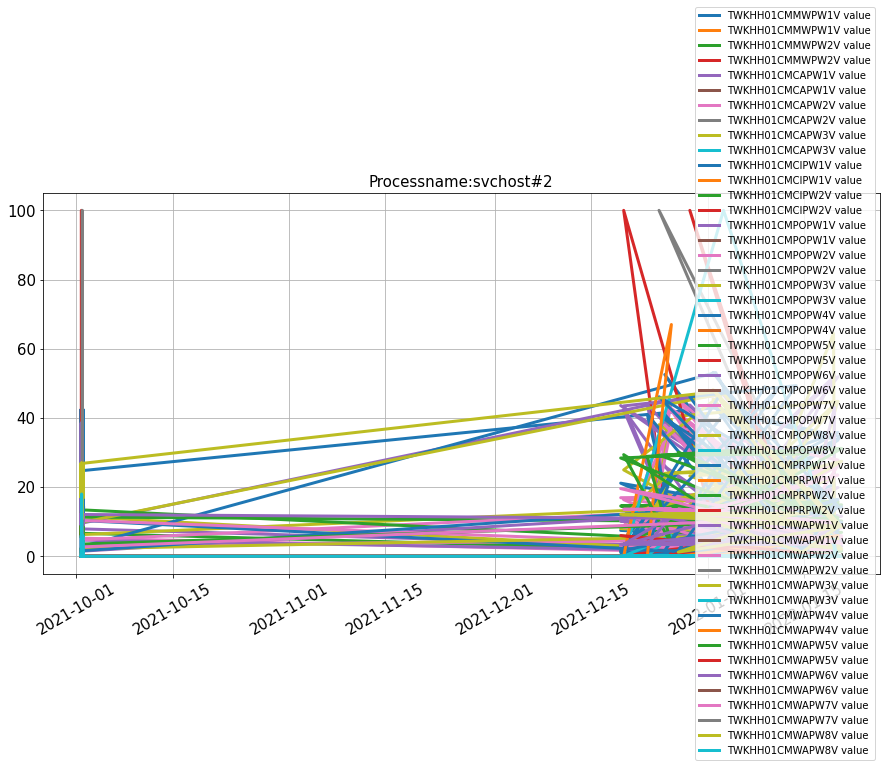

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


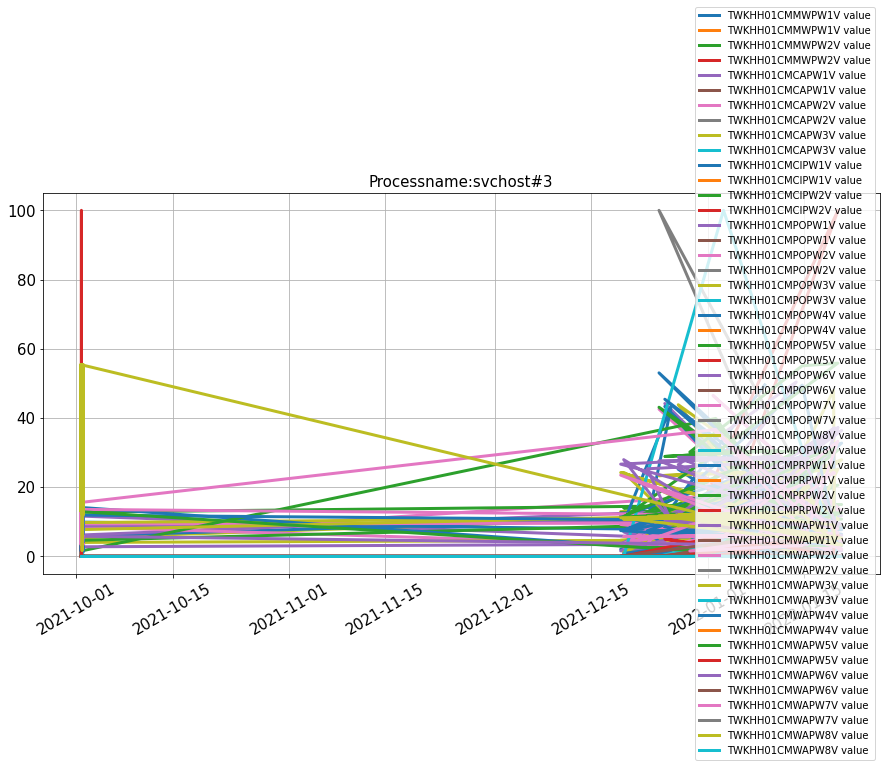

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


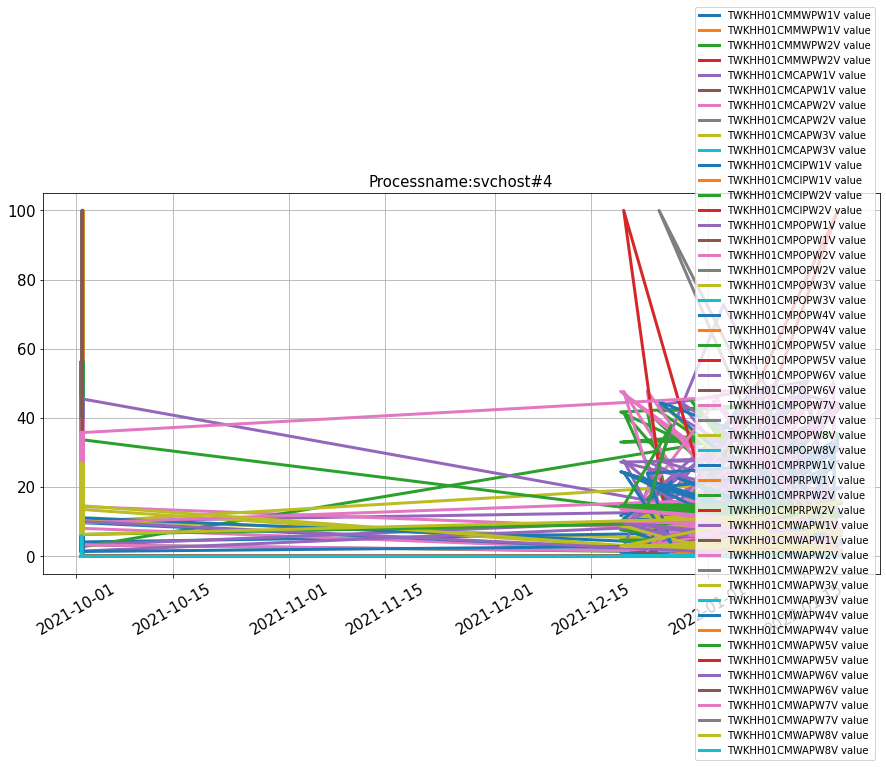

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


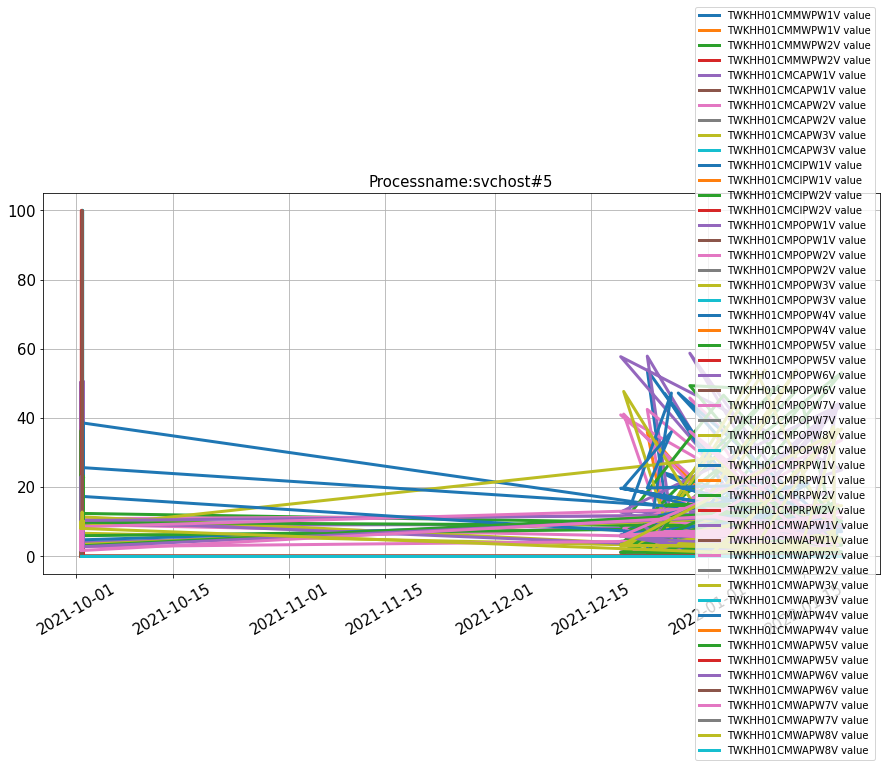

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


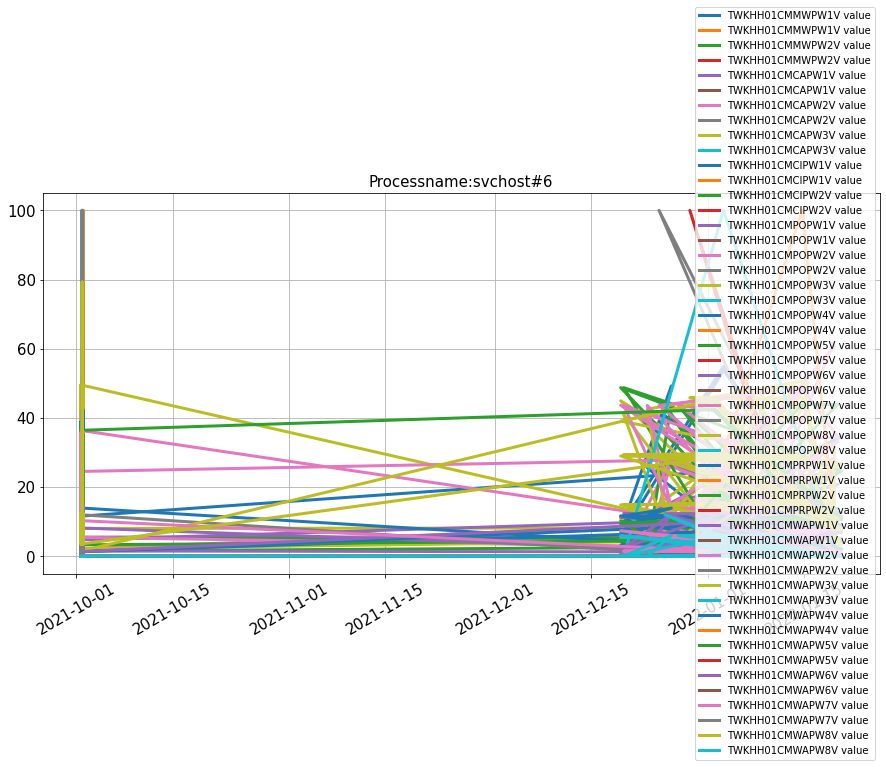

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


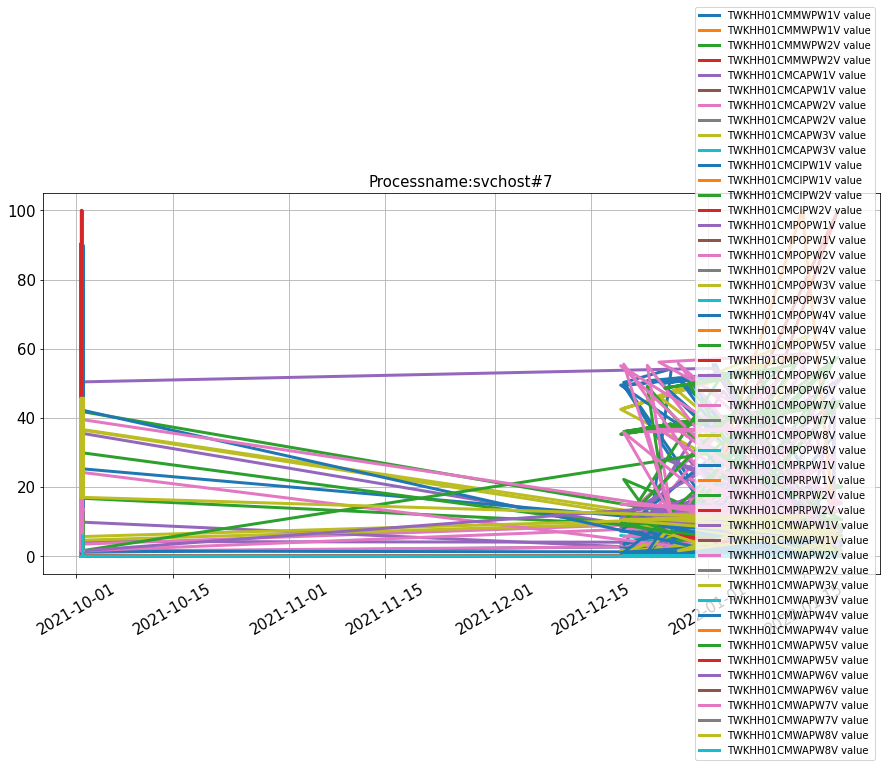

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


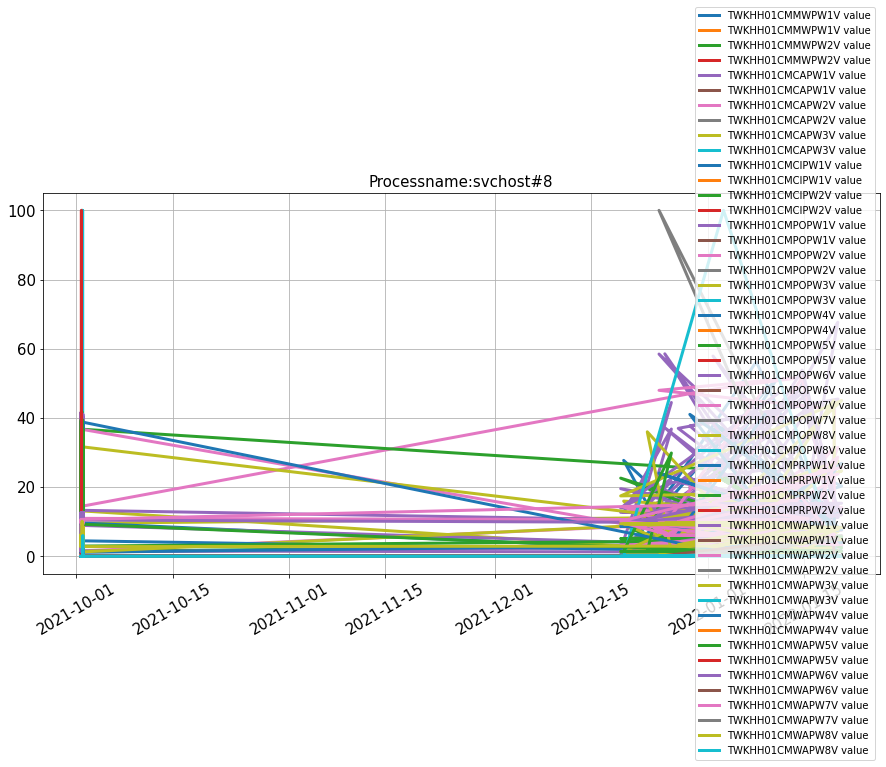

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


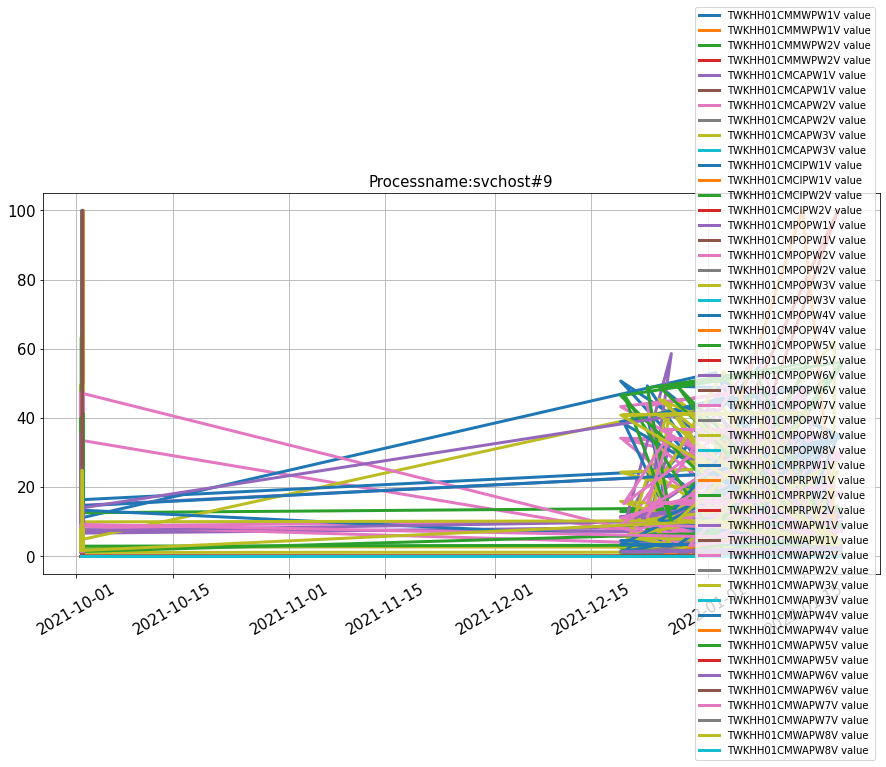

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


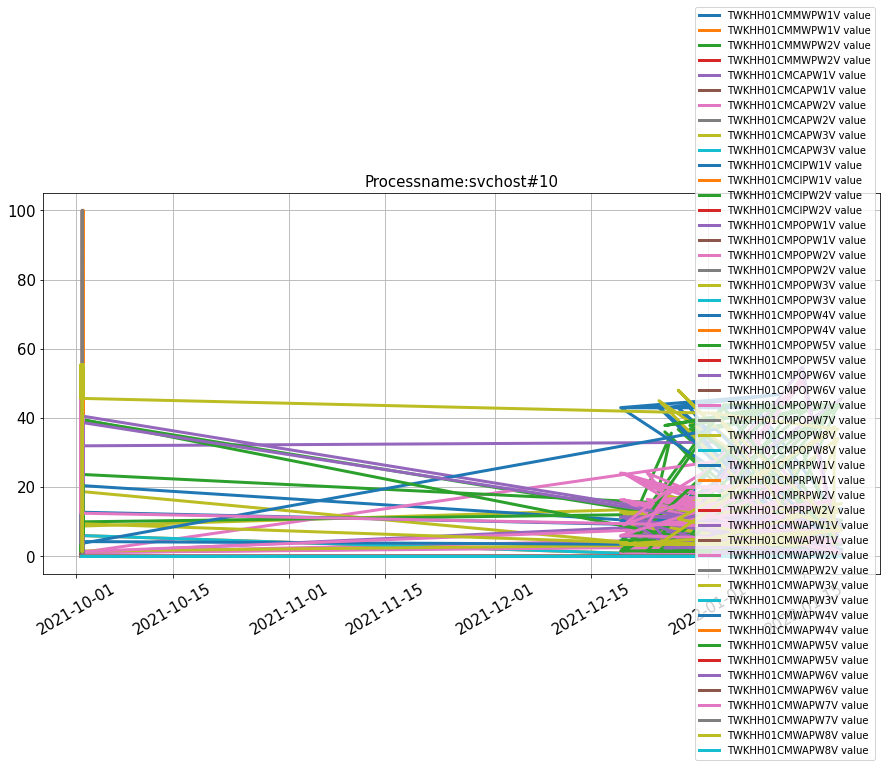

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


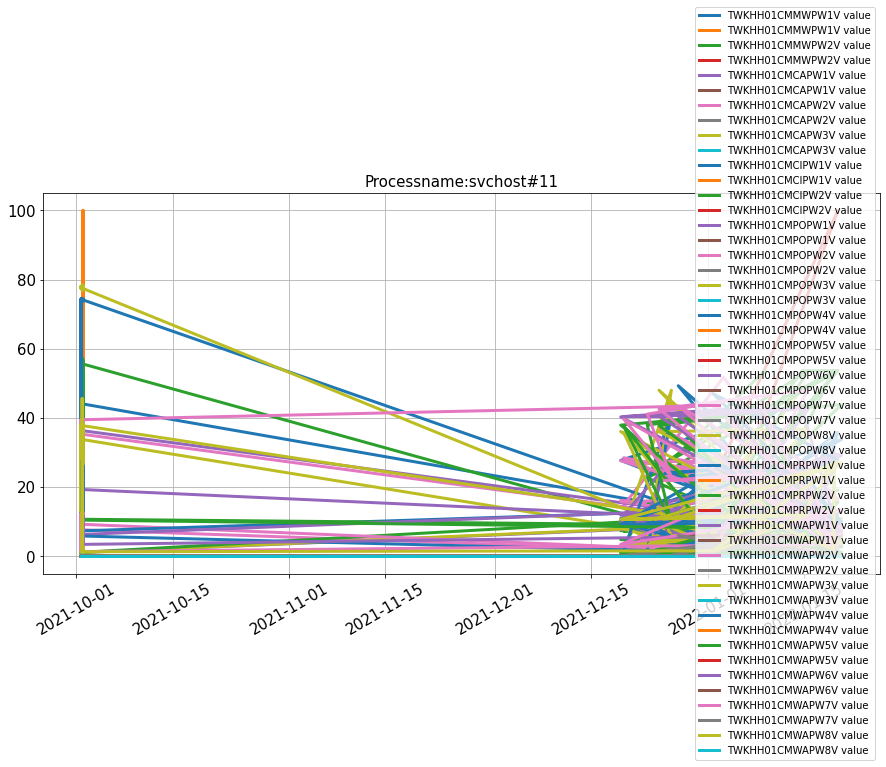

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


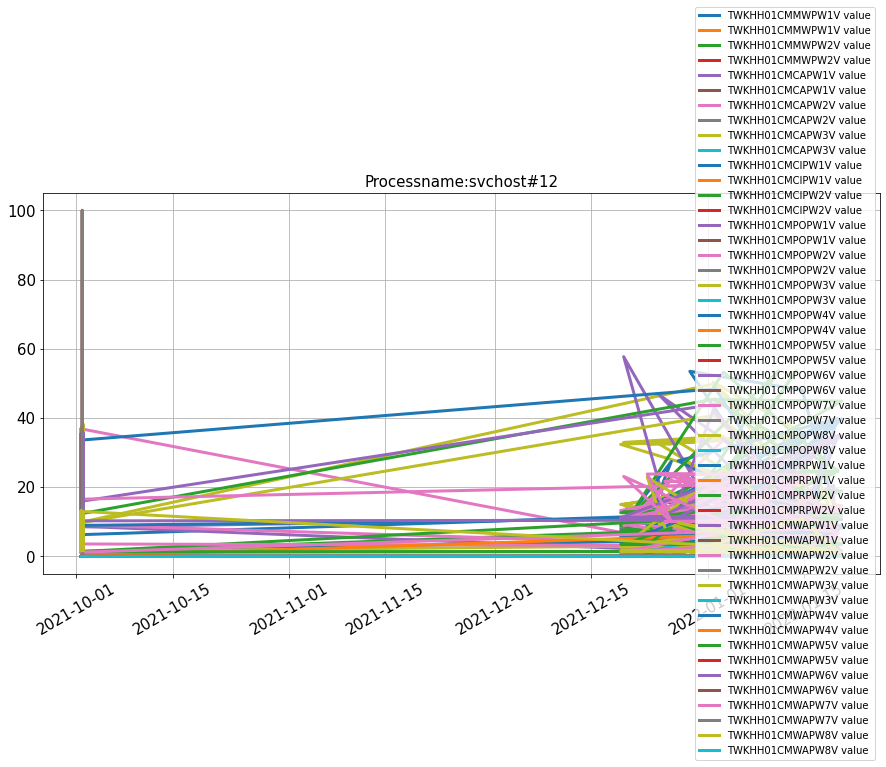

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


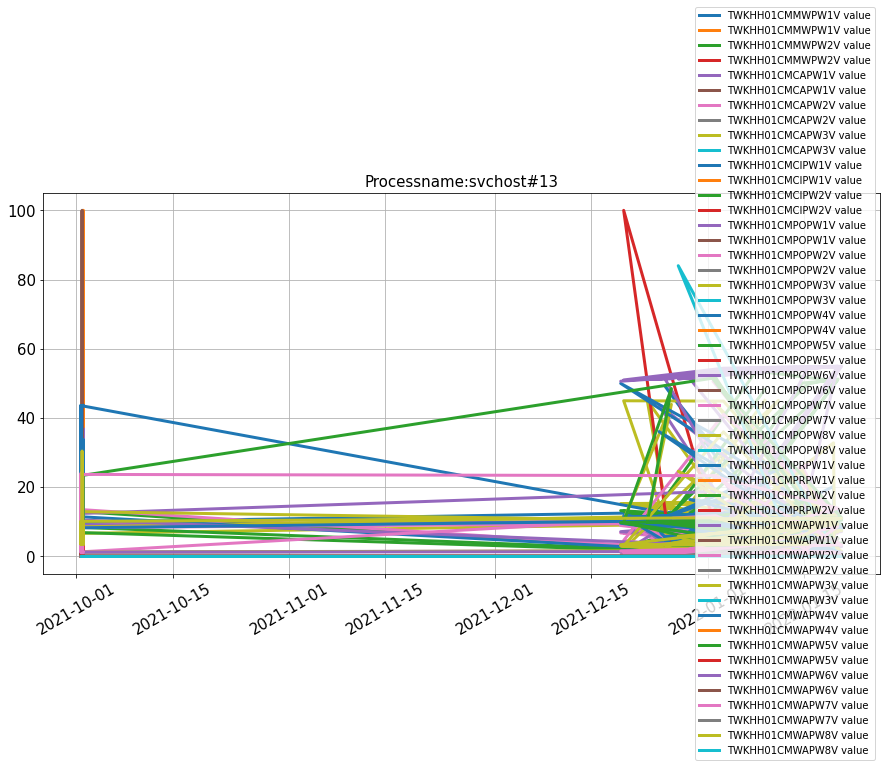

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


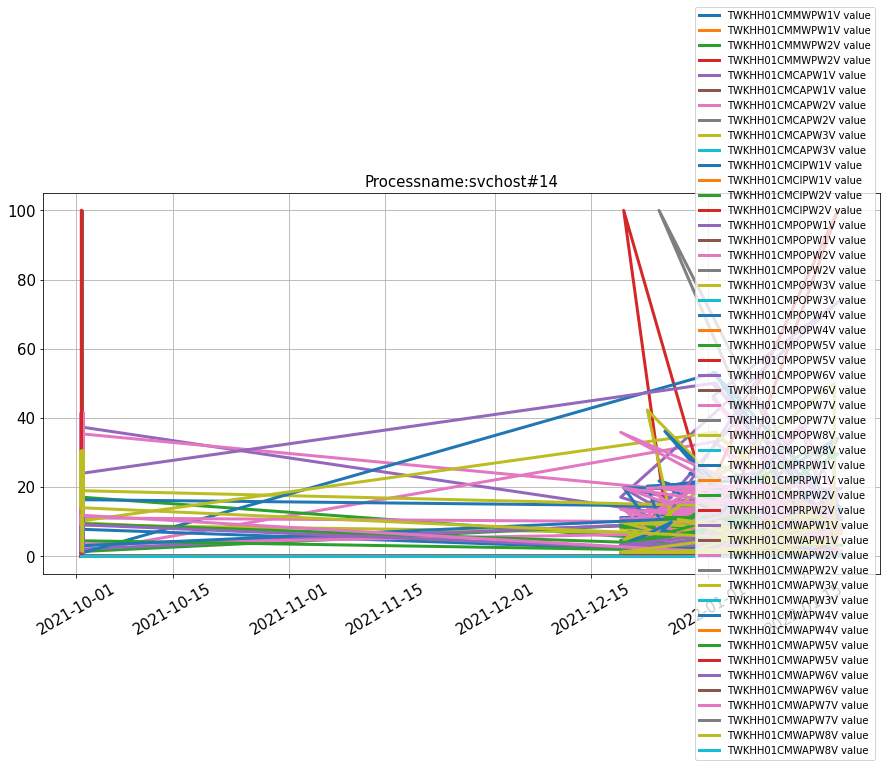

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


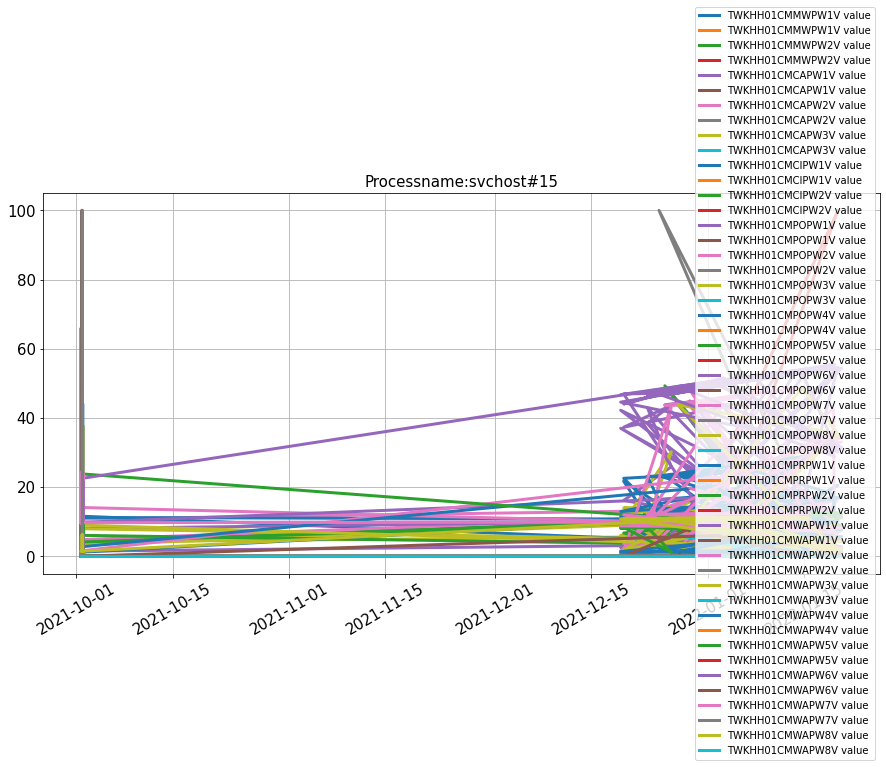

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


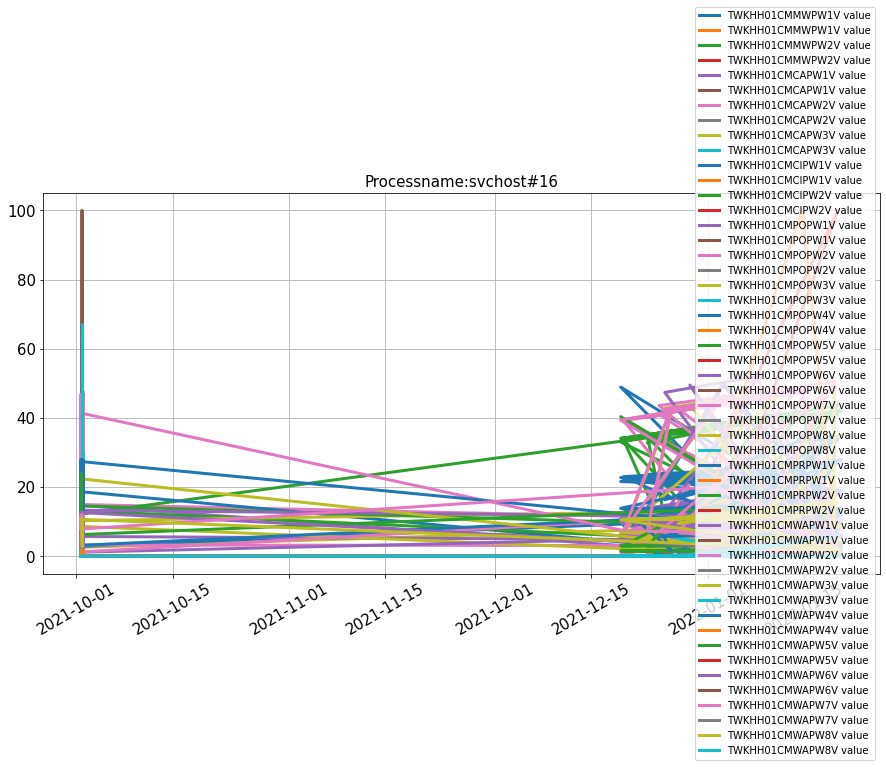

(22,)
(55,)
(55,)
(19,)
(12,)
(55,)
(22,)
(55,)
(50,)
(55,)
(55,)
(55,)
(50,)
(55,)
(54,)
(54,)
(54,)
(51,)
(49,)
(54,)
(49,)
(49,)
(35,)
(33,)


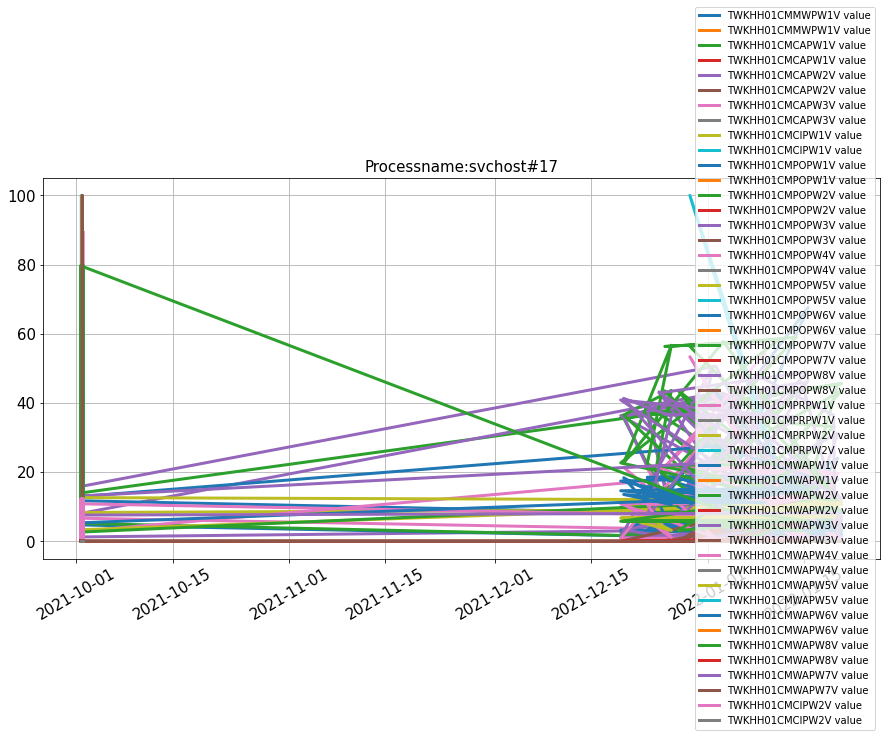

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(55,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(32,)
(32,)


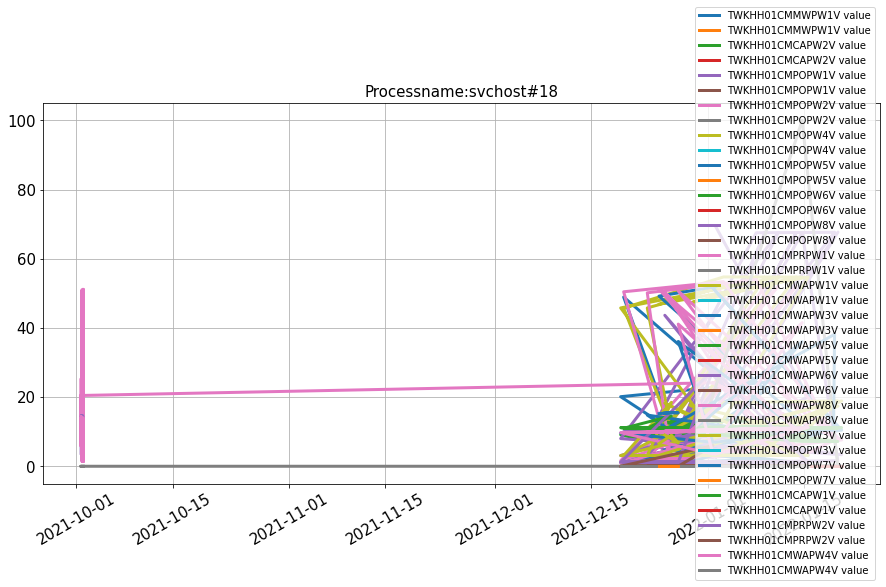

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


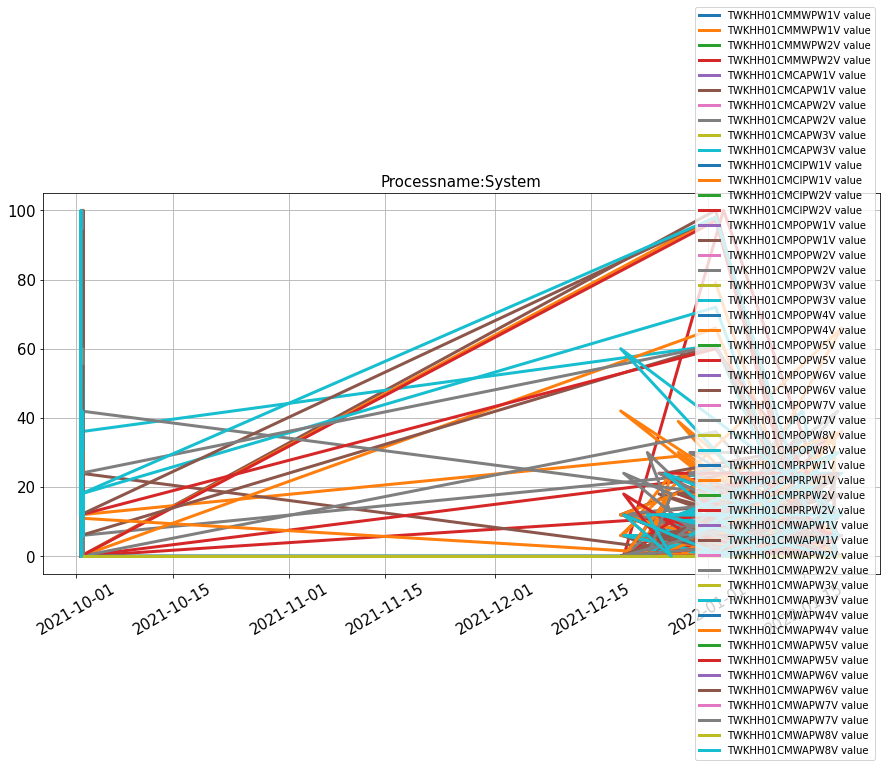

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(1,)
(2,)
(2,)
(33,)
(32,)
(32,)


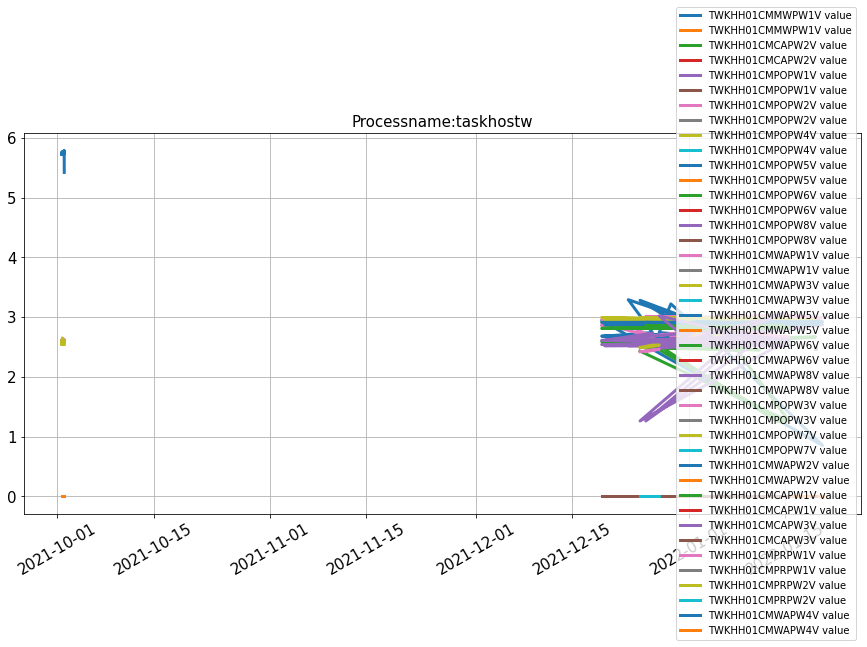

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


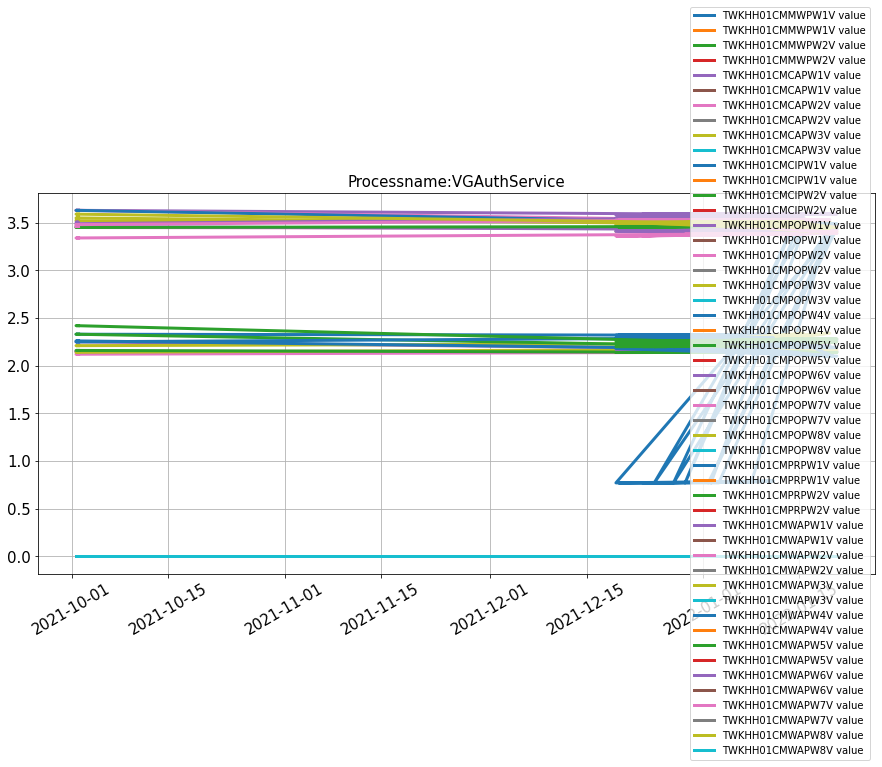

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


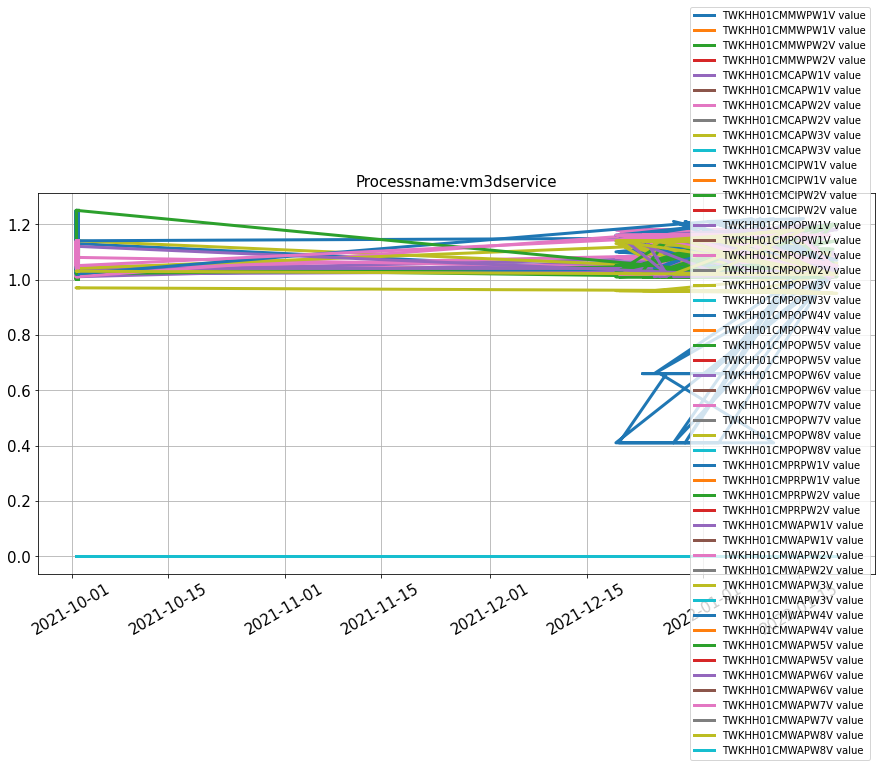

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(38,)
(2,)


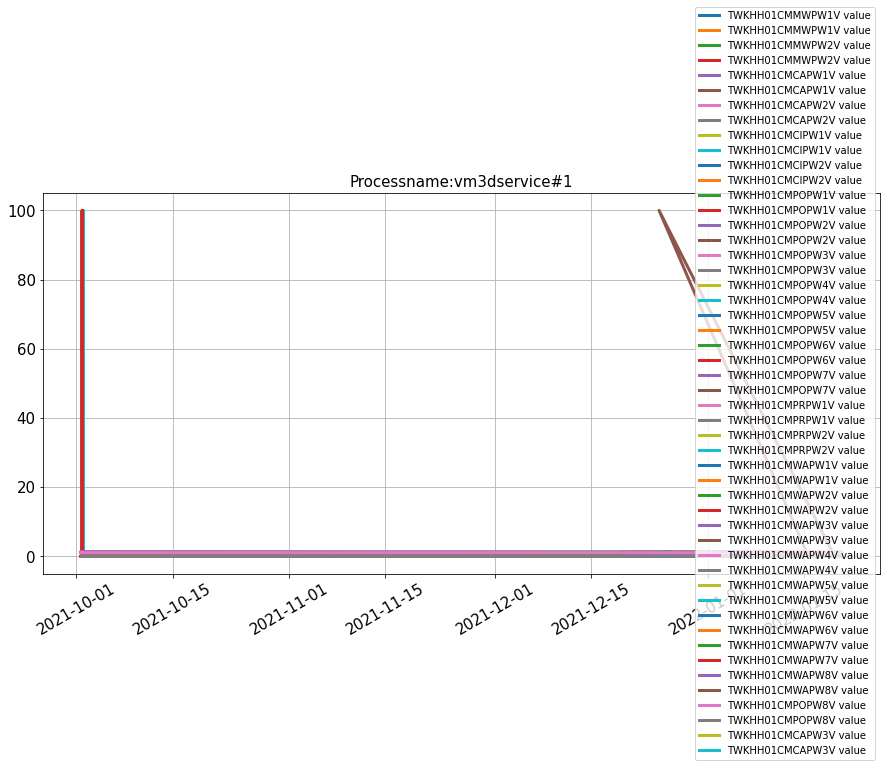

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


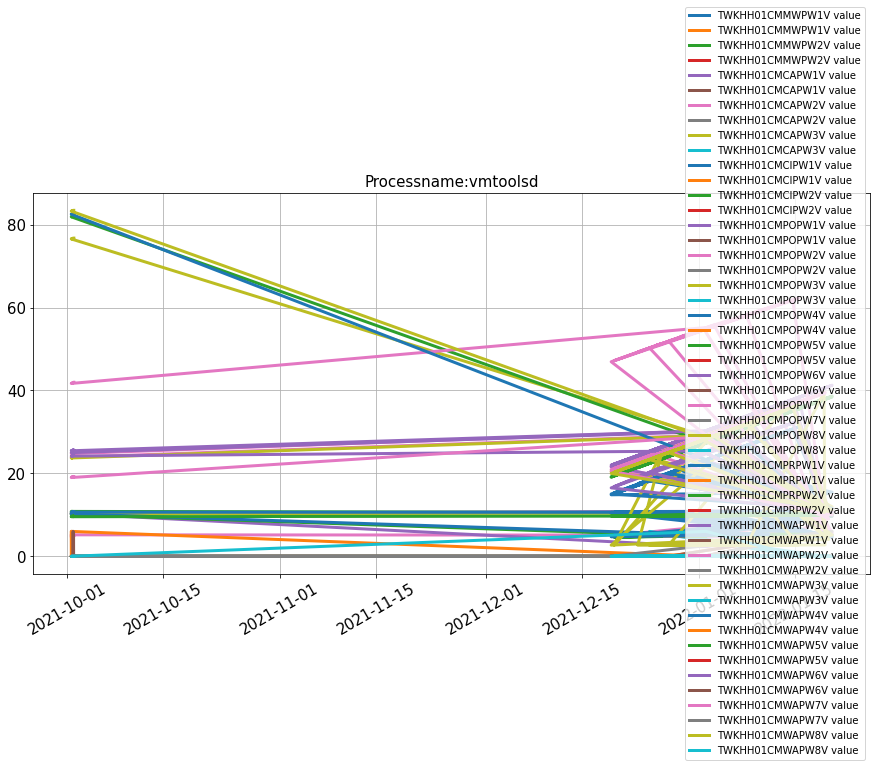

(20,)
(55,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(20,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(1,)


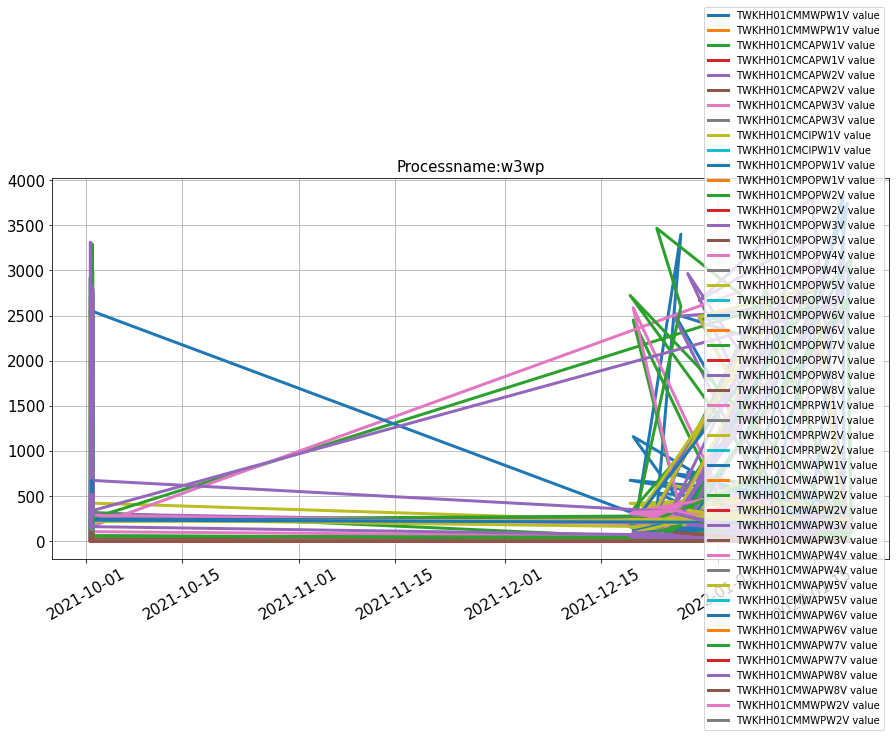

(20,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(1,)
(1,)
(1,)
(1,)
(1,)


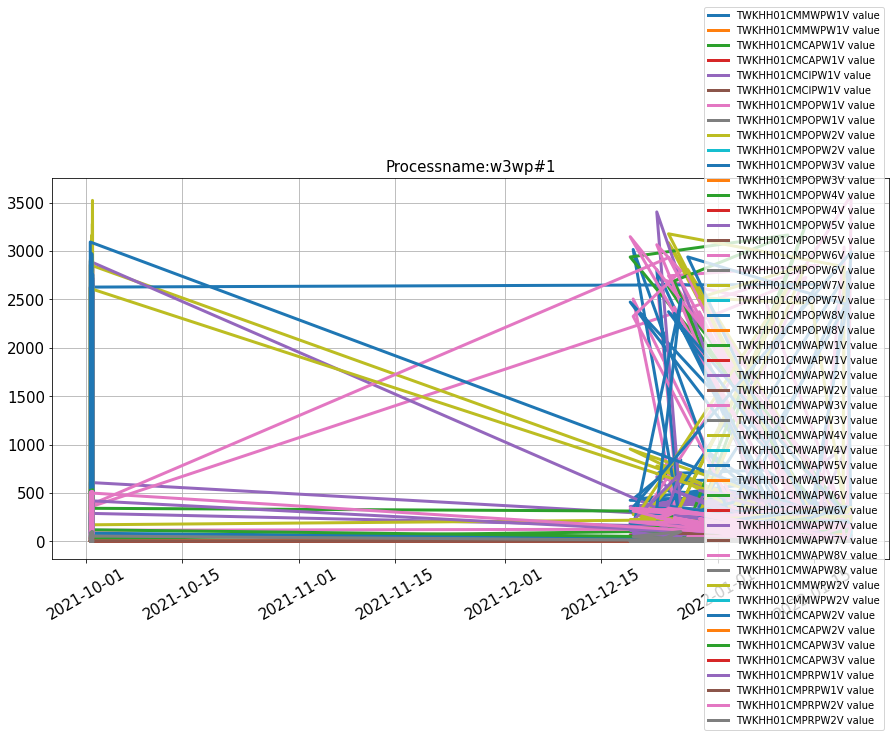

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


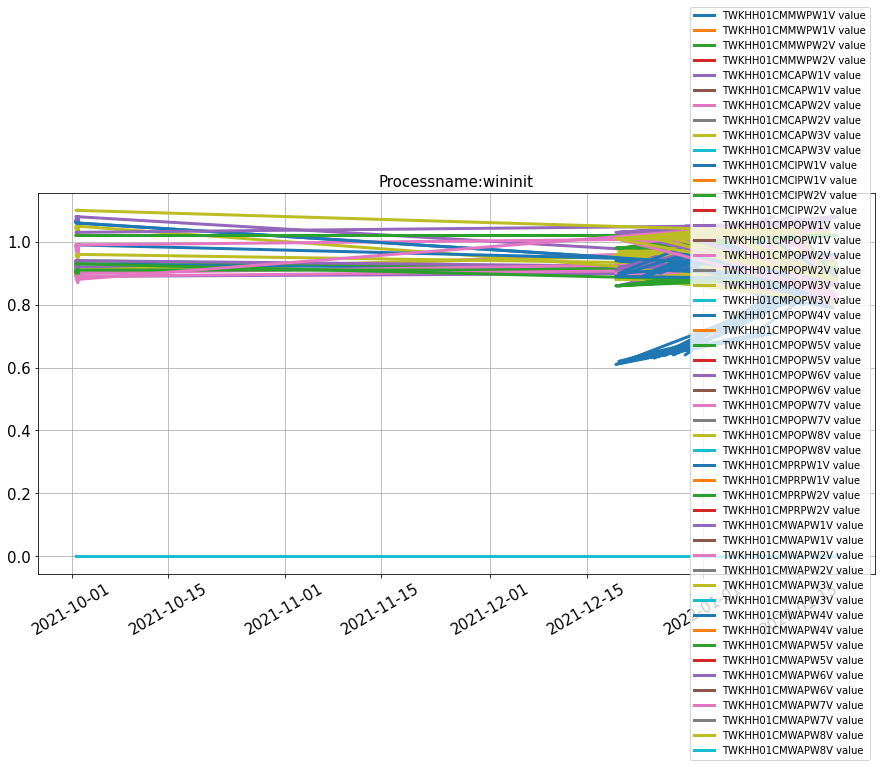

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


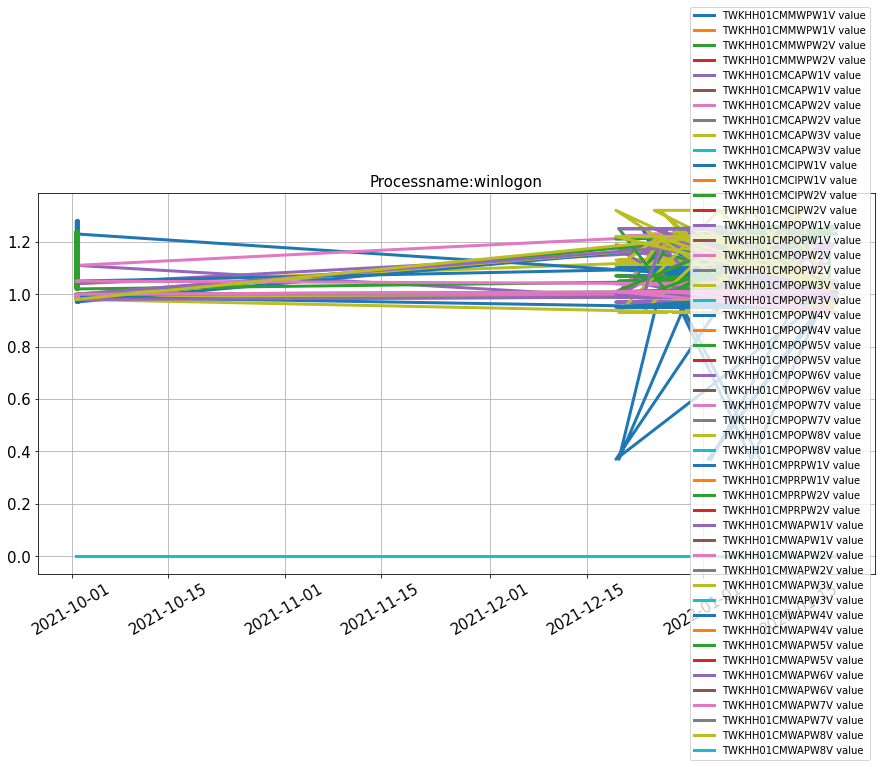

(14,)
(19,)
(22,)
(17,)
(17,)
(22,)
(10,)
(17,)
(22,)
(19,)
(22,)
(17,)
(17,)
(4,)
(4,)
(2,)
(2,)
(33,)
(32,)
(32,)


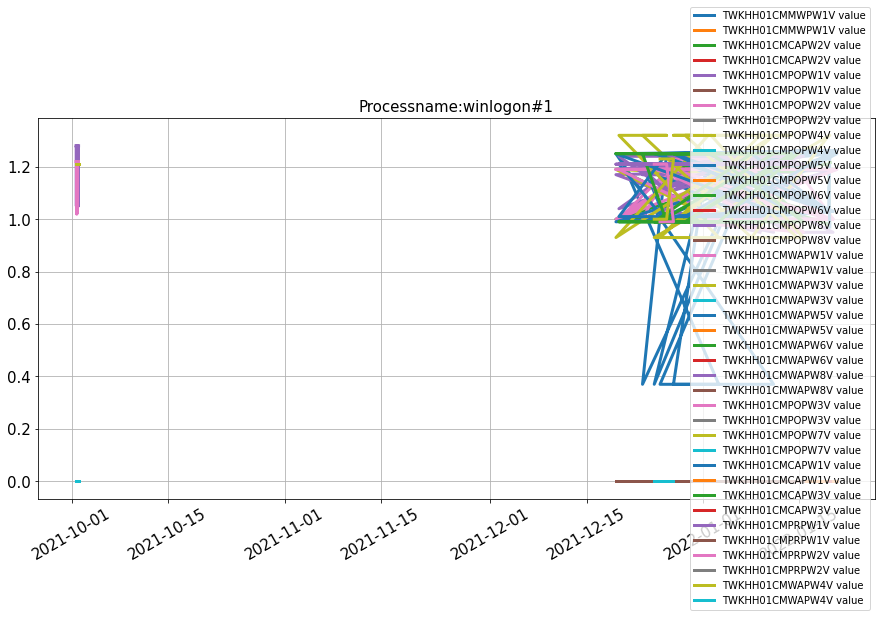

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


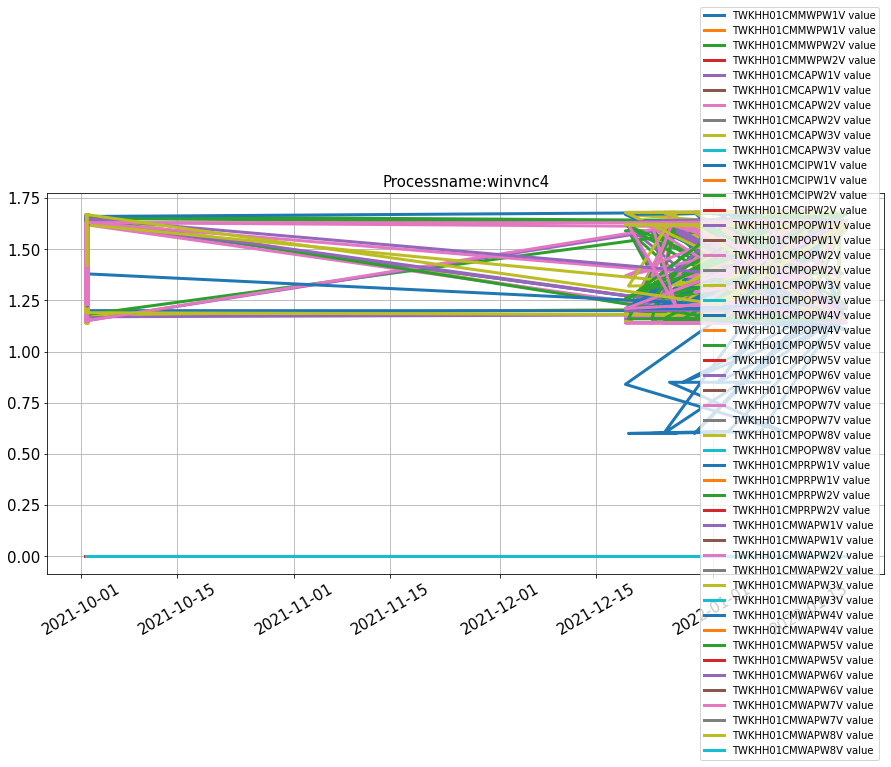

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


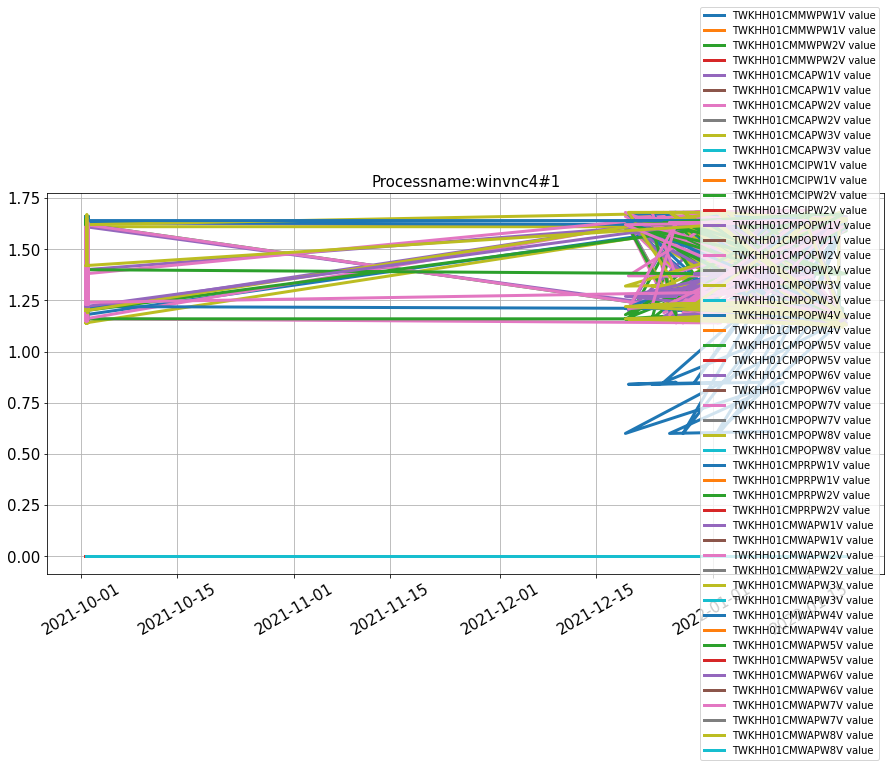

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


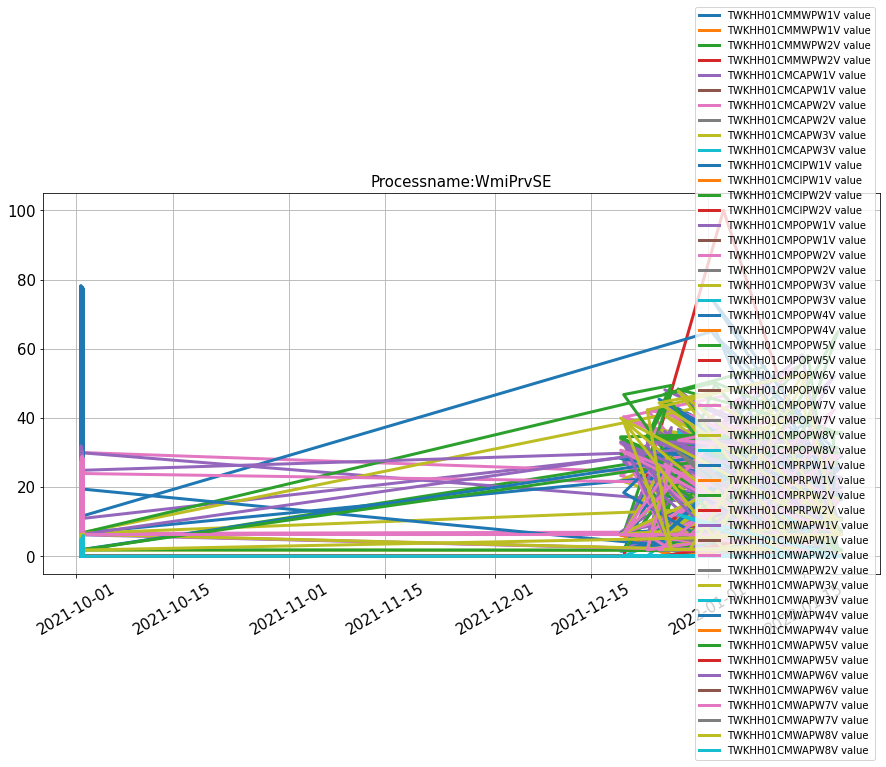

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


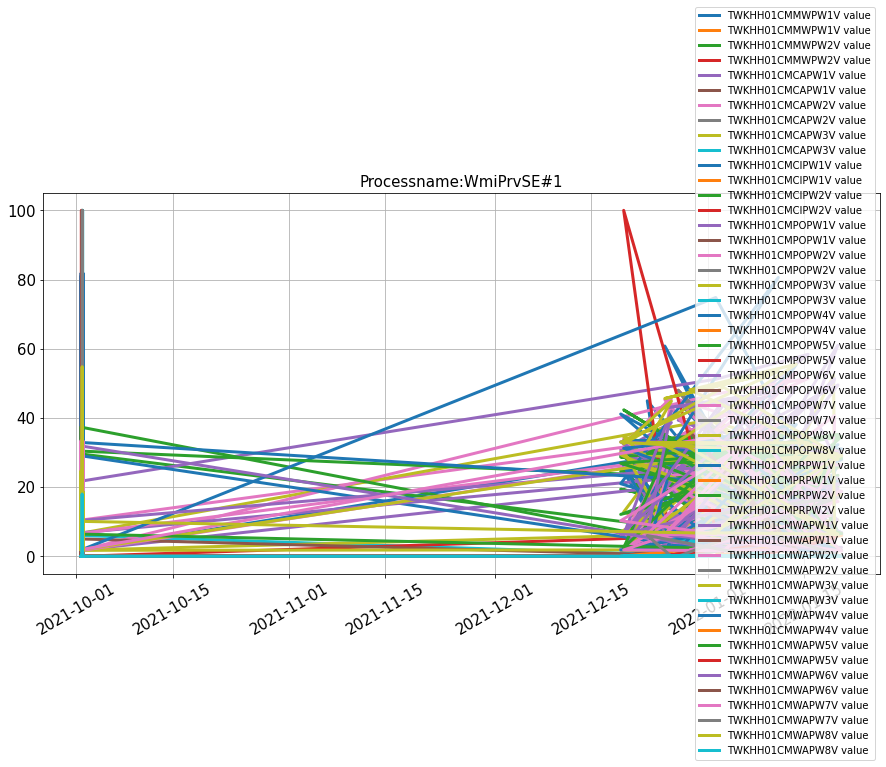

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


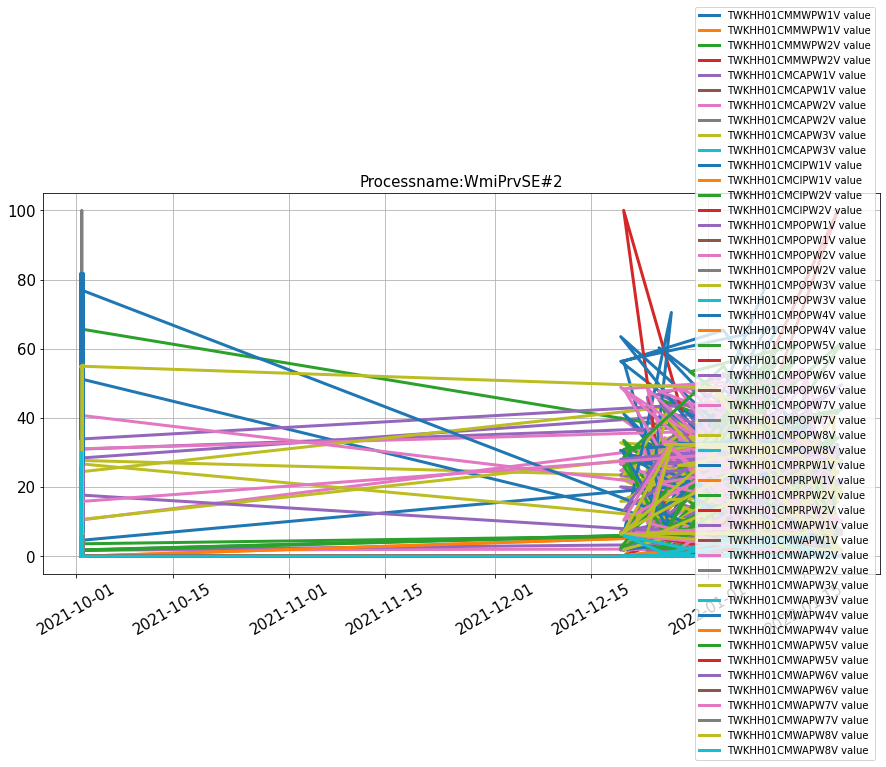

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


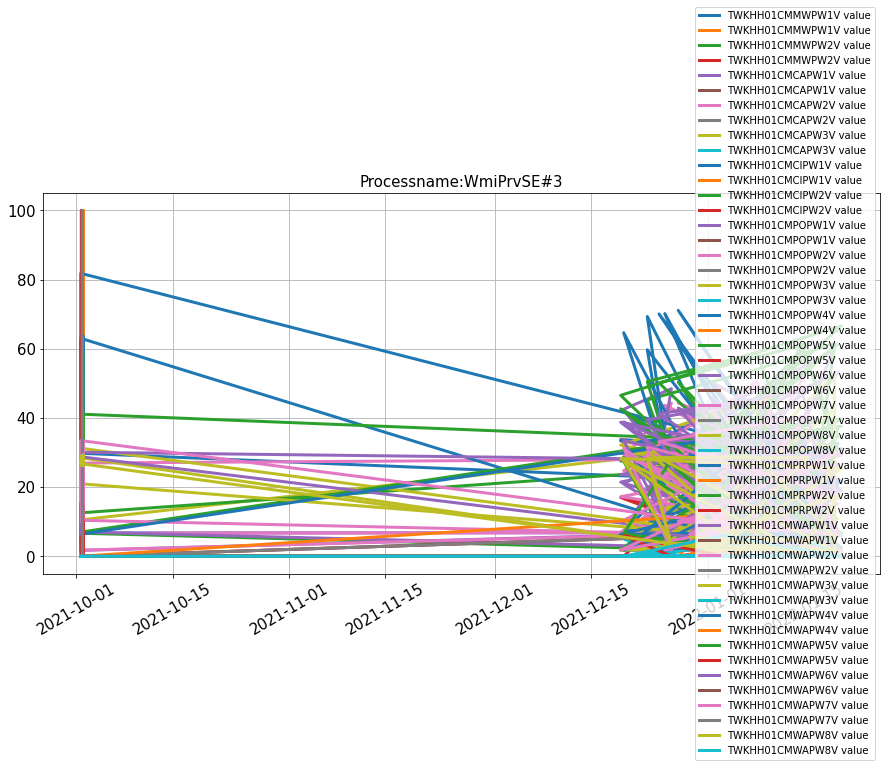

(22,)
(22,)
(55,)
(55,)
(52,)
(55,)
(55,)
(55,)
(52,)
(55,)
(55,)
(55,)
(52,)
(55,)
(55,)
(39,)
(54,)
(54,)
(52,)
(54,)
(54,)
(54,)
(51,)
(54,)


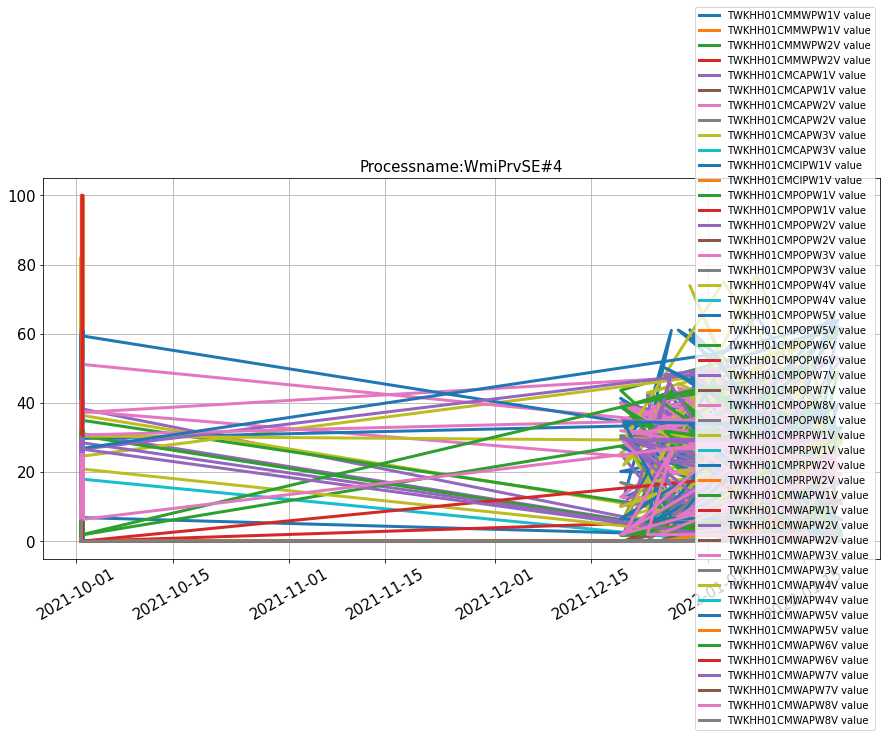

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


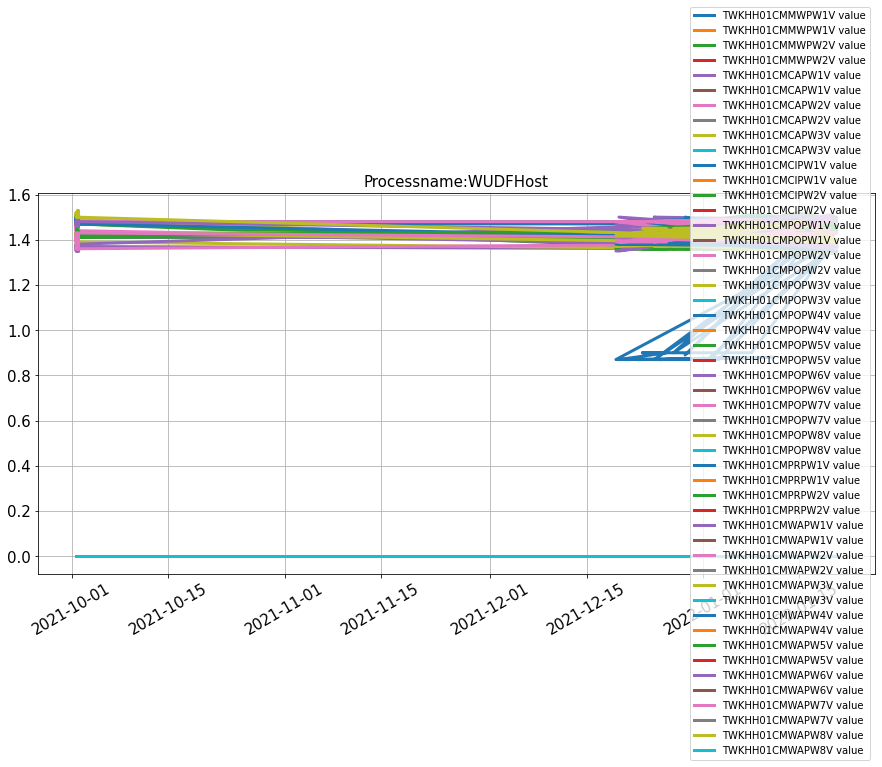

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


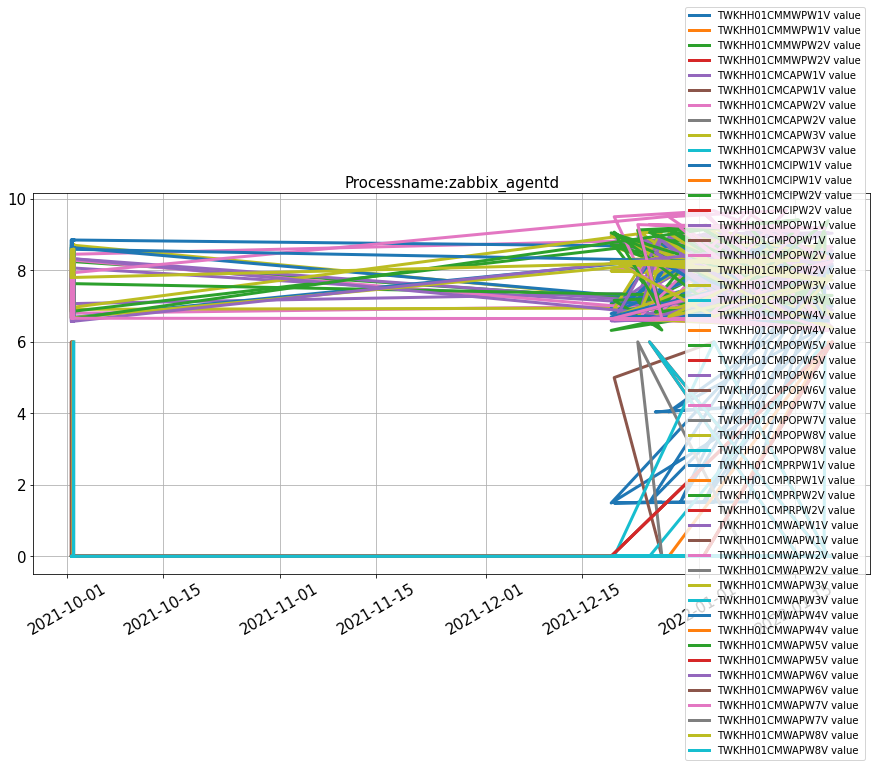

(22,)
(22,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


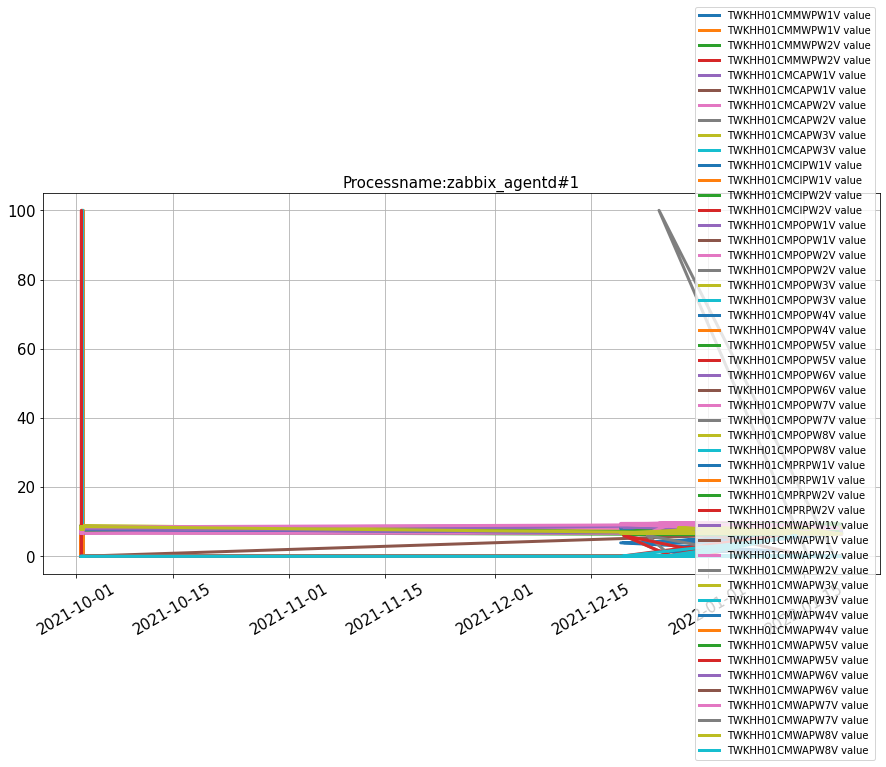

(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)


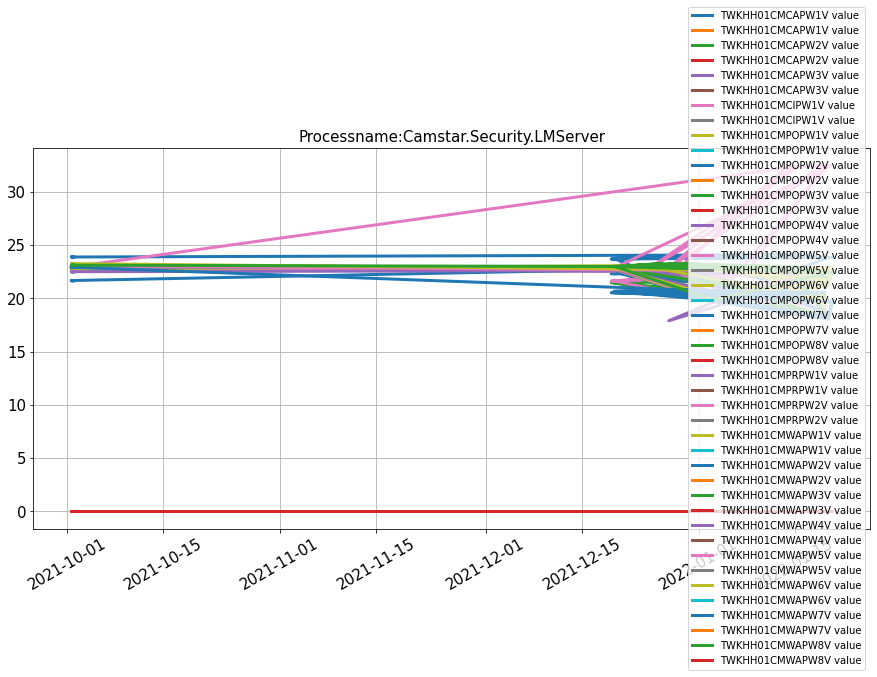

(53,)
(53,)
(53,)


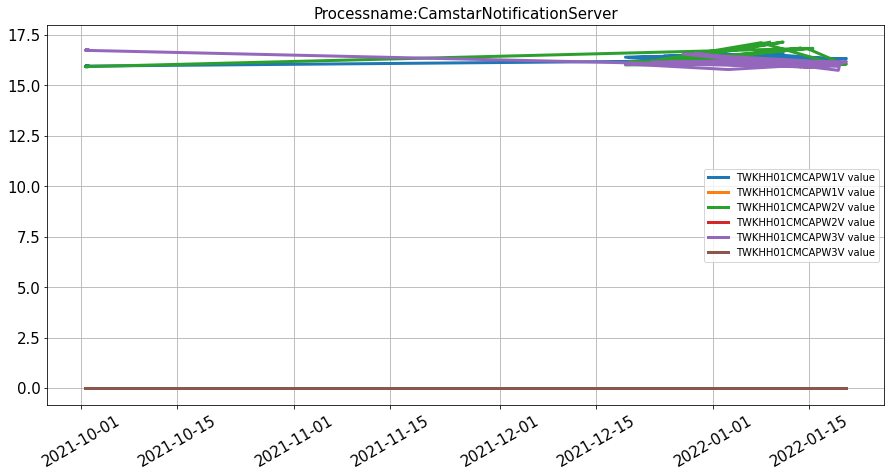

(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)


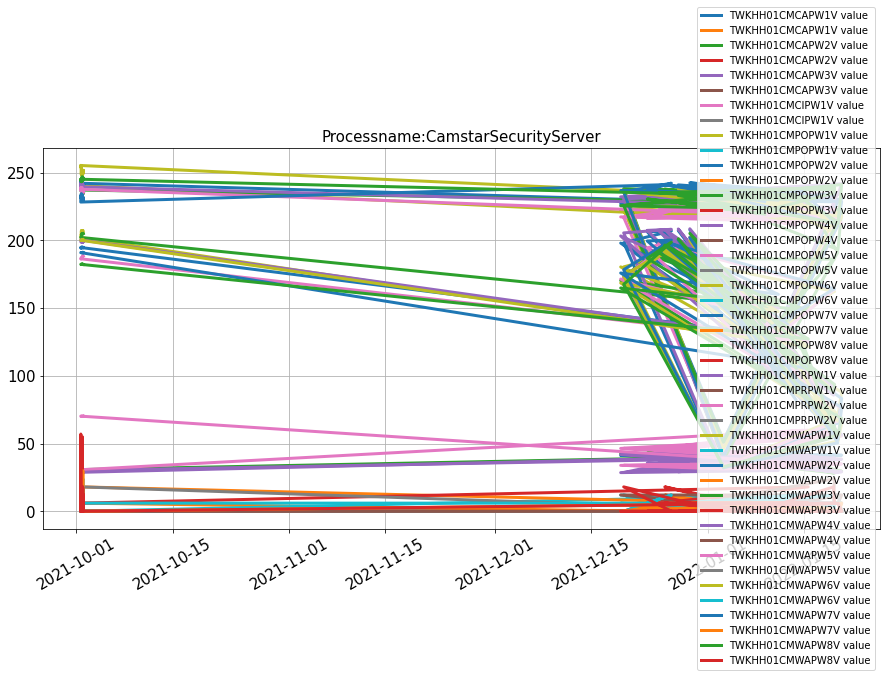

(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


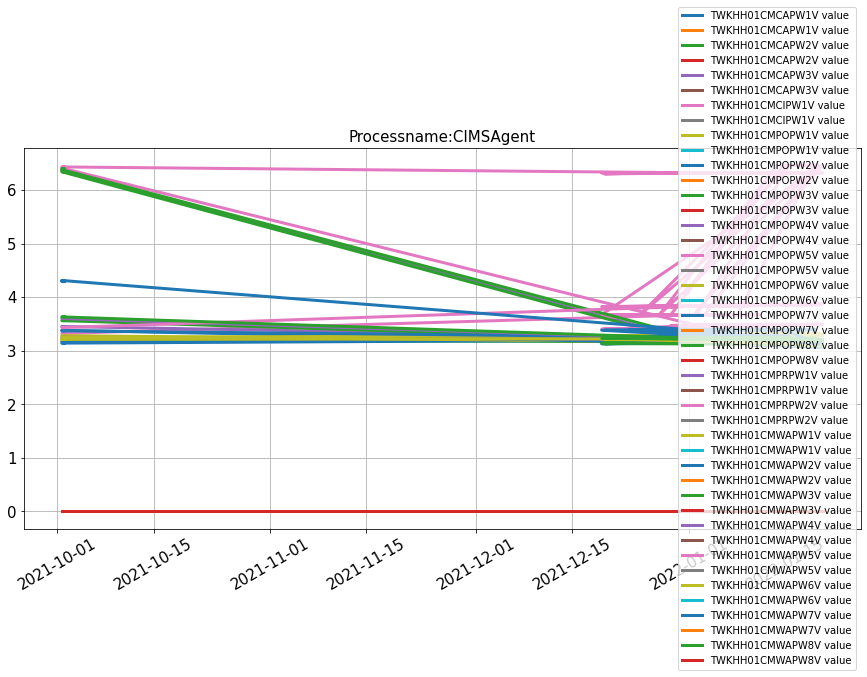

(55,)
(55,)
(55,)
(55,)
(55,)


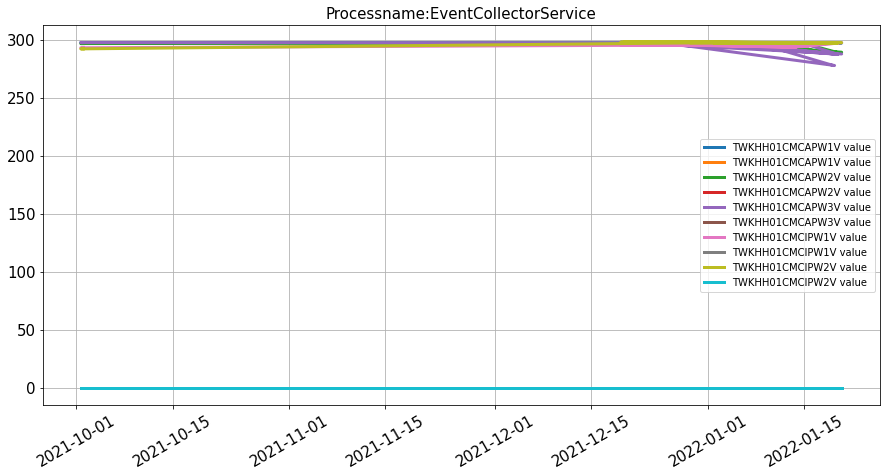

(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)


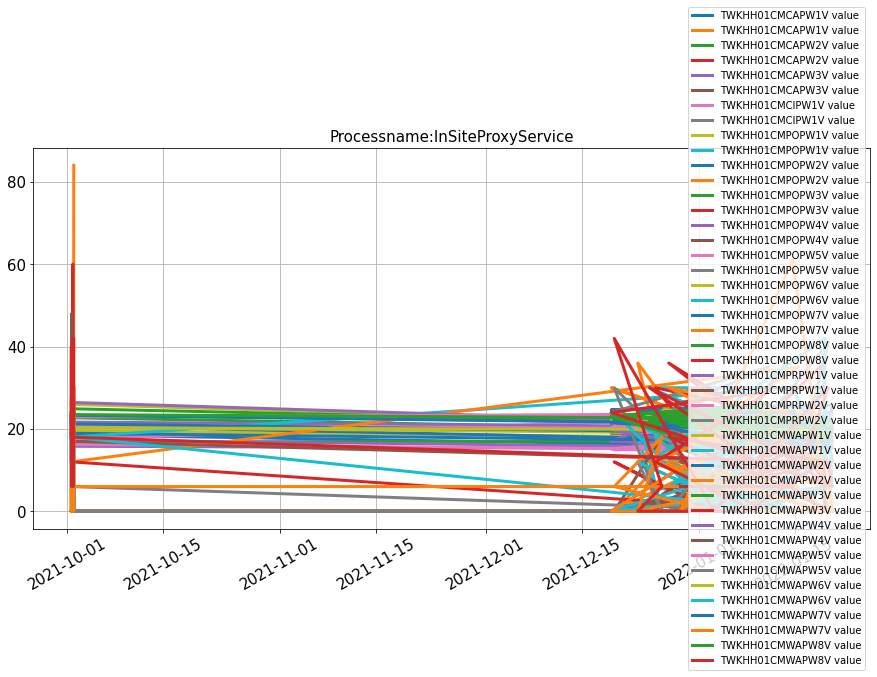

(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(53,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)


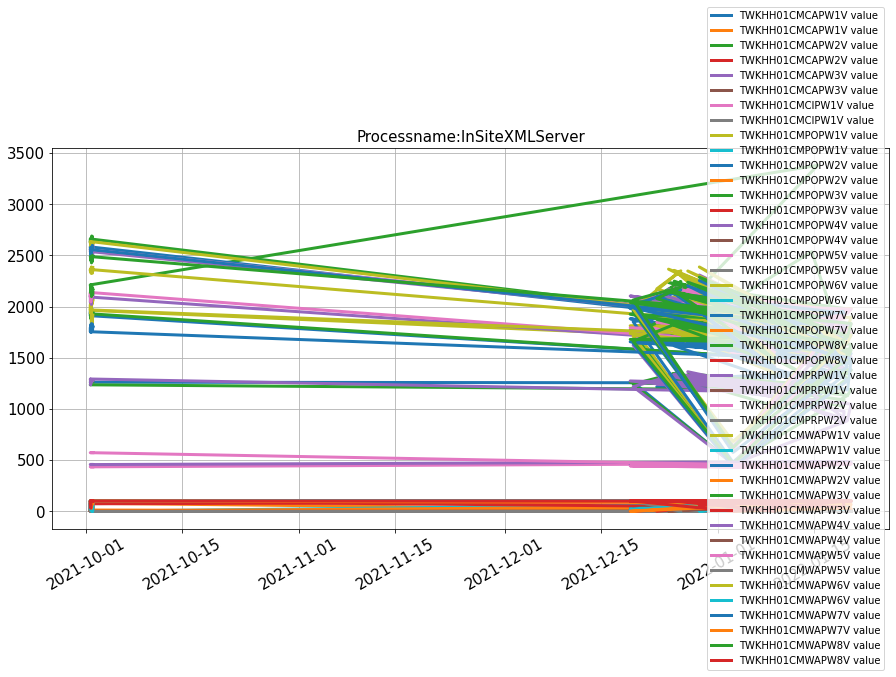

(55,)
(55,)
(55,)


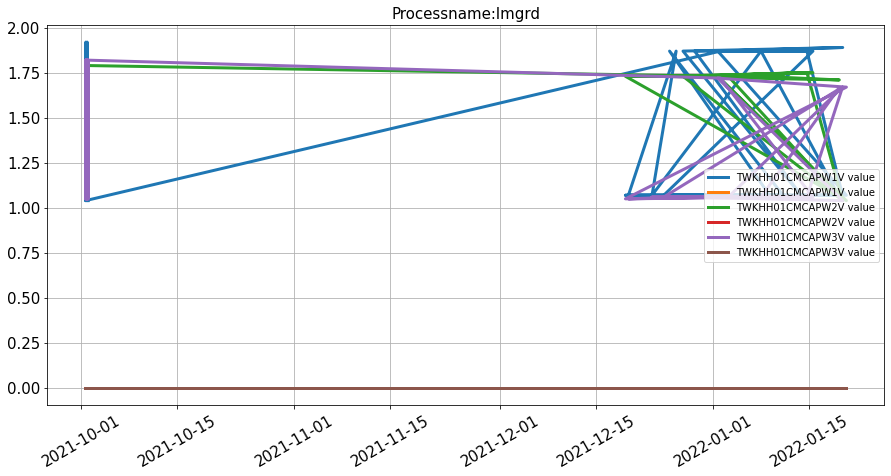

(55,)
(55,)
(55,)


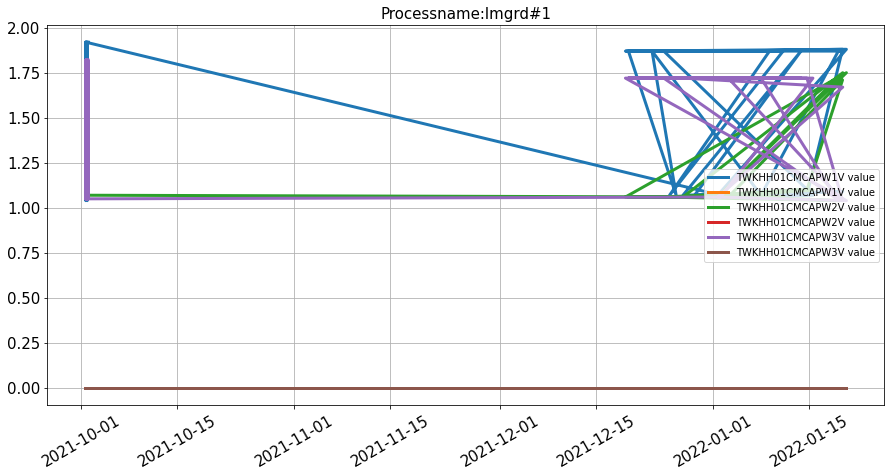

(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(55,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


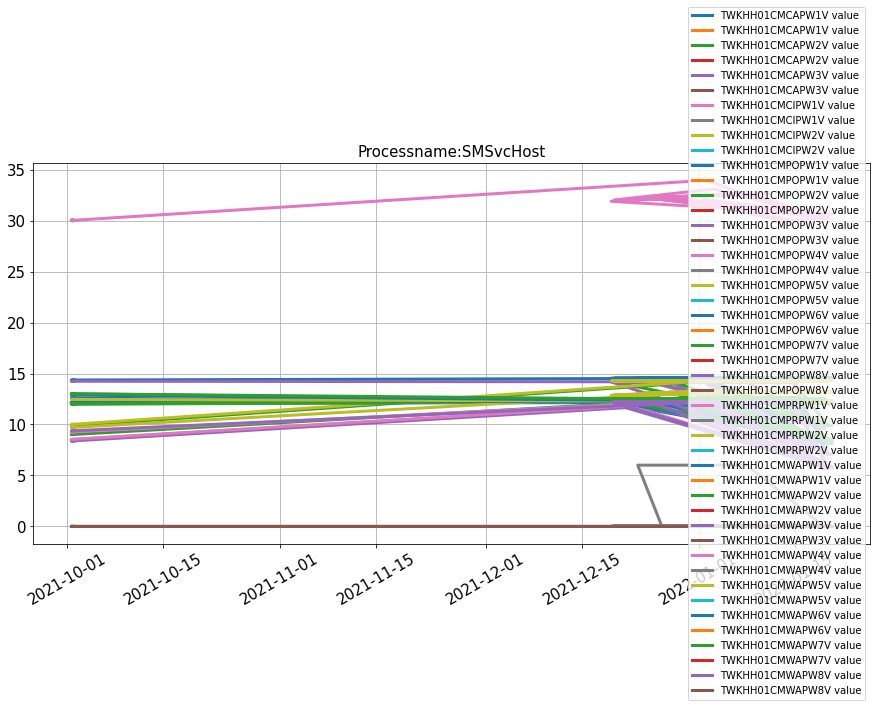

(55,)
(55,)
(55,)


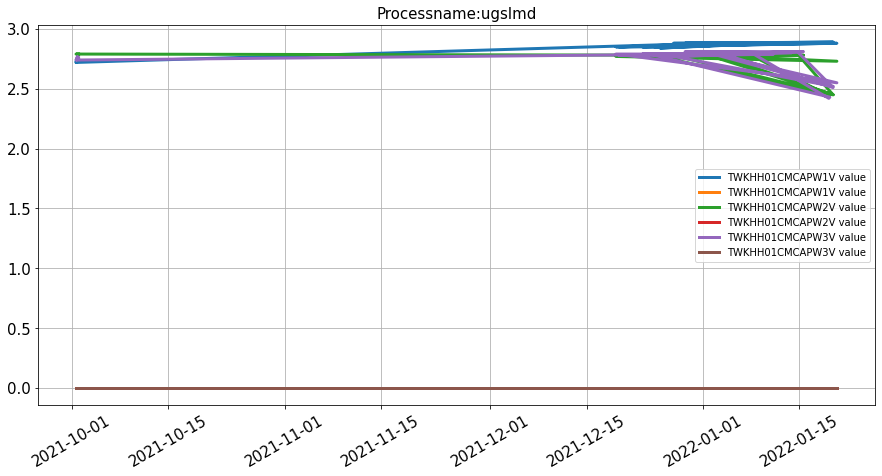

(55,)
(55,)
(55,)
(55,)
(55,)


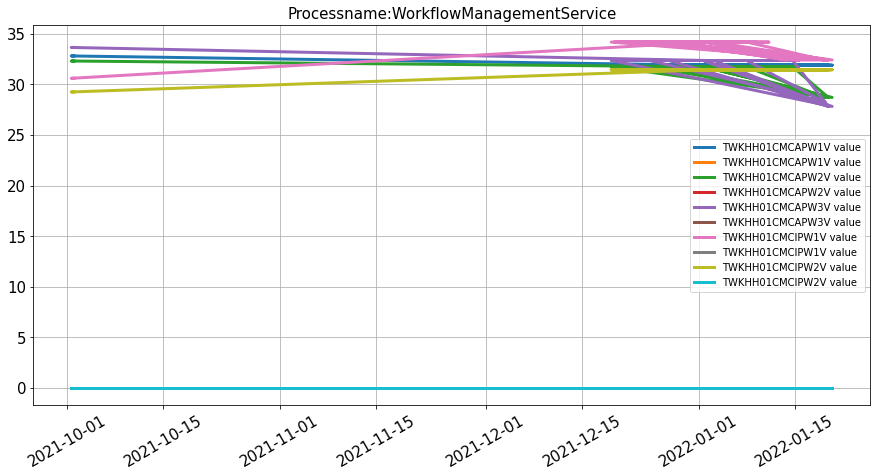

(53,)


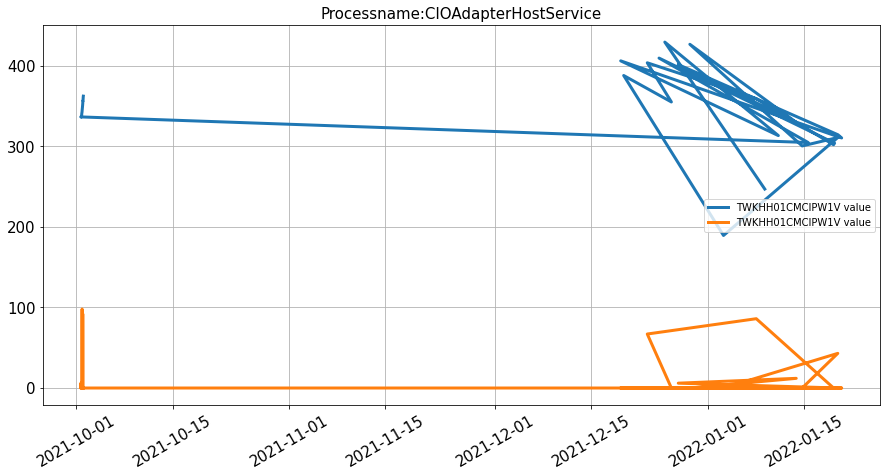

(55,)


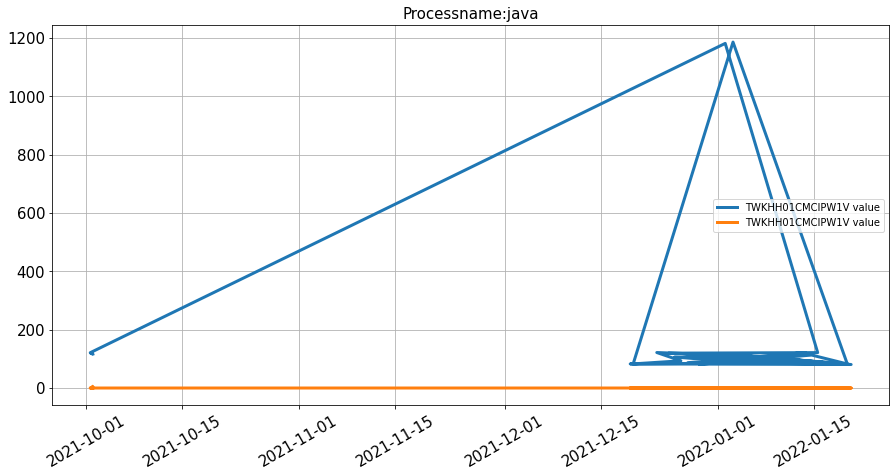

(55,)


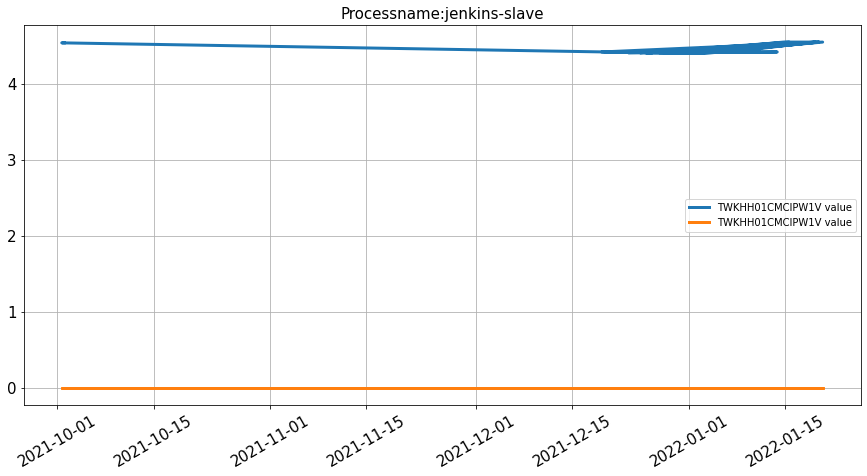

(53,)
(52,)
(52,)
(52,)
(53,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)


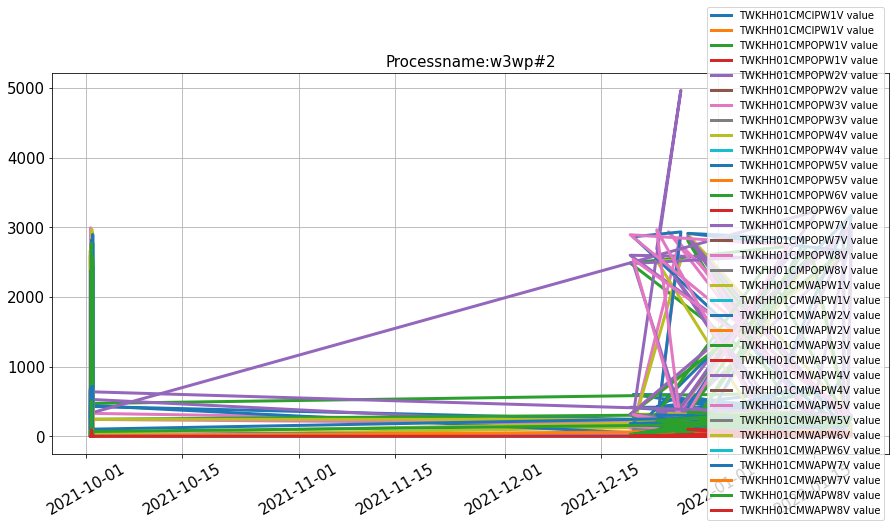

(53,)
(26,)
(11,)
(17,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(28,)
(11,)
(41,)
(12,)
(7,)


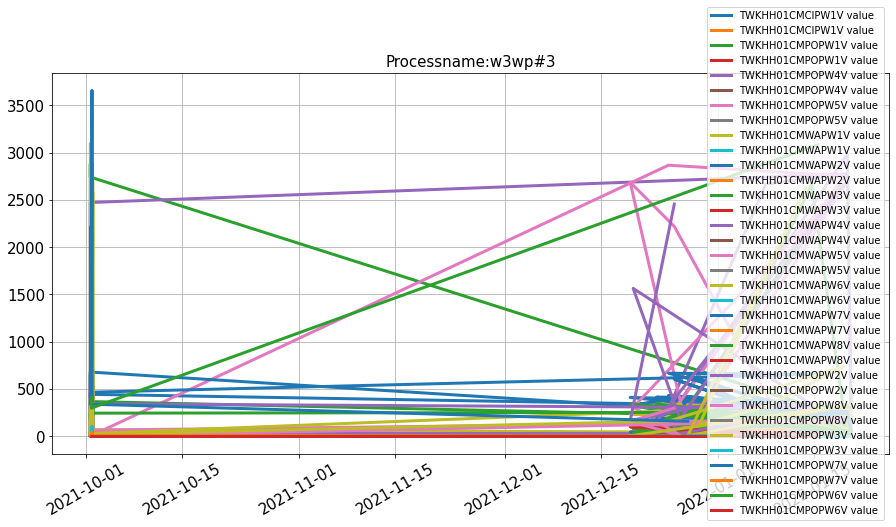

(53,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(4,)
(10,)
(8,)


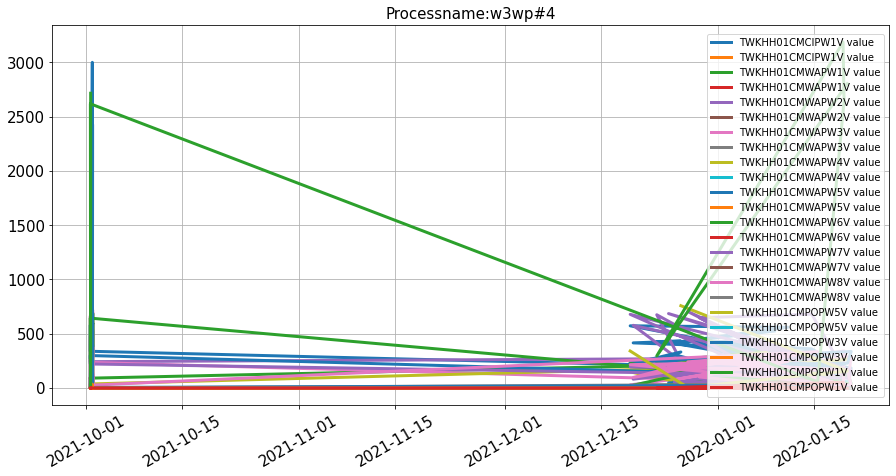

(53,)
(53,)
(53,)
(53,)
(45,)
(53,)
(53,)
(53,)


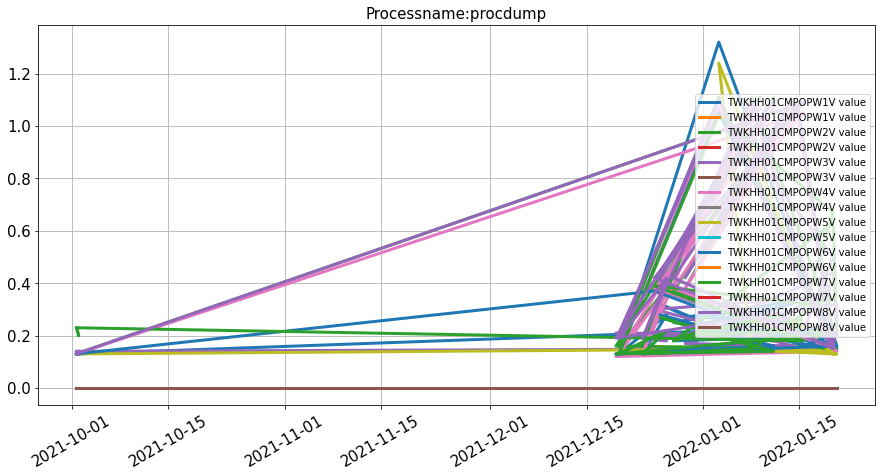

(53,)
(53,)
(53,)
(53,)
(45,)
(53,)
(53,)
(53,)


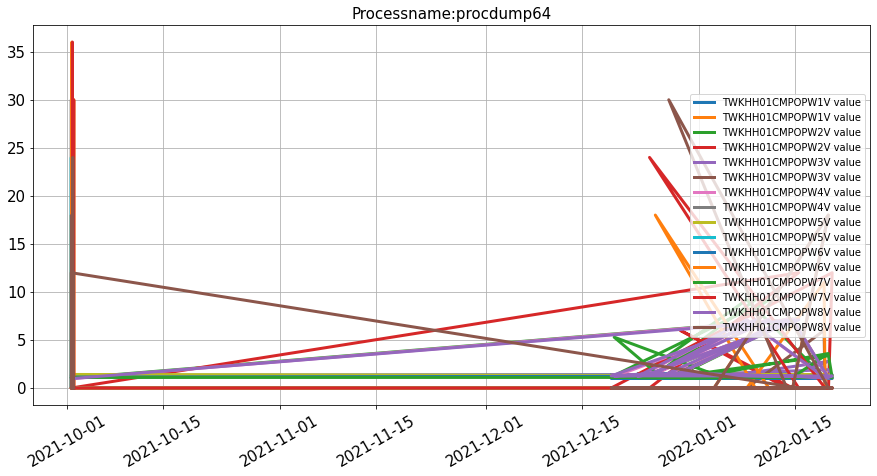

(17,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(33,)


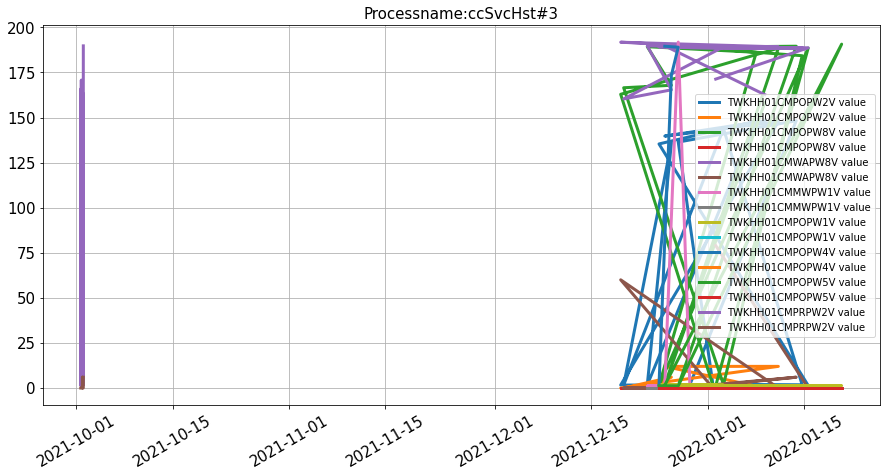

(17,)
(17,)
(17,)
(6,)
(6,)
(4,)
(5,)
(33,)


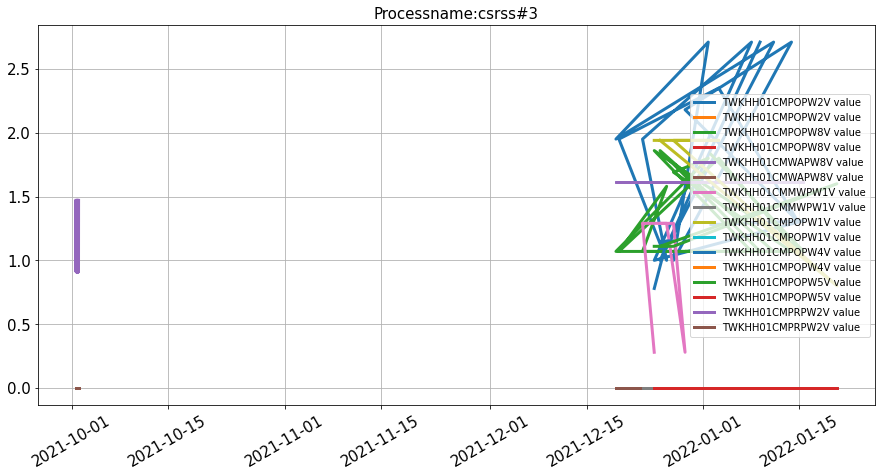

(17,)
(17,)
(17,)
(6,)
(6,)
(4,)
(5,)
(33,)


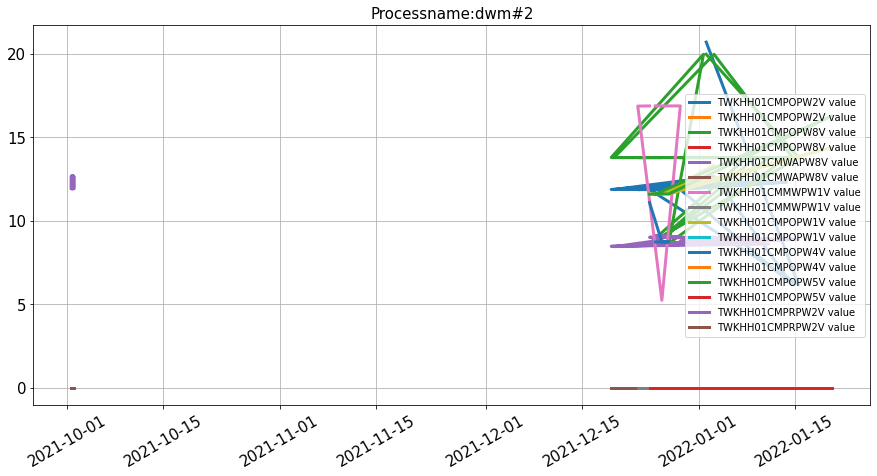

(17,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(33,)


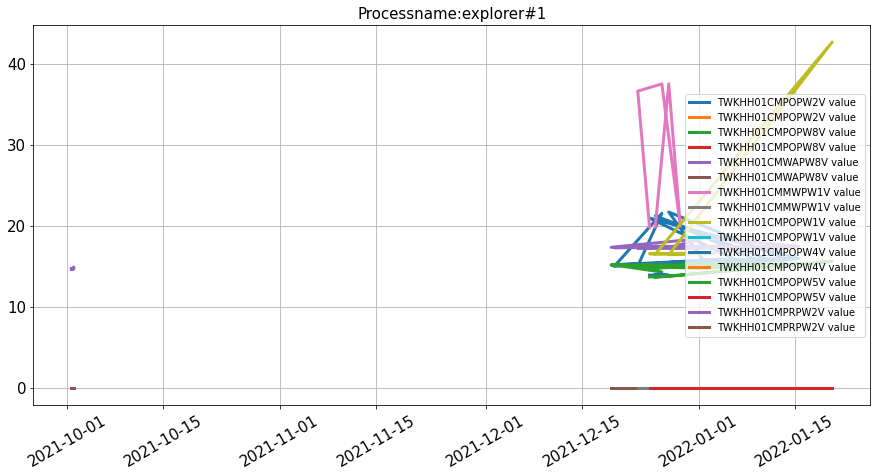

(17,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(33,)


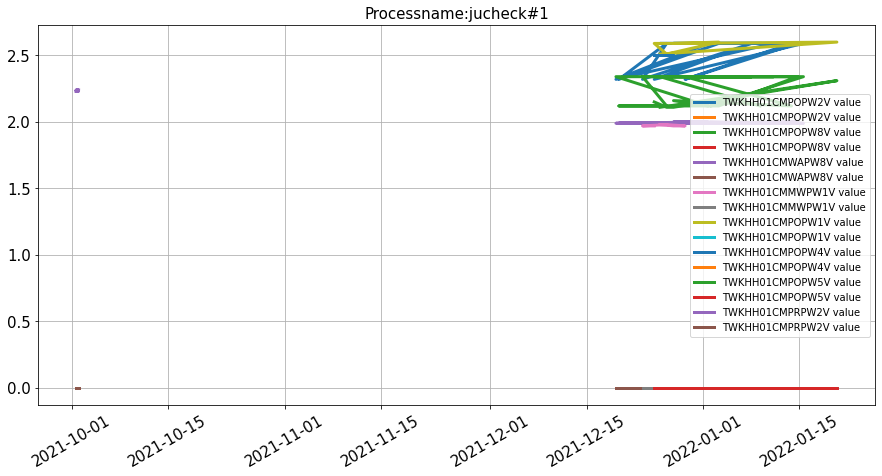

(17,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(33,)


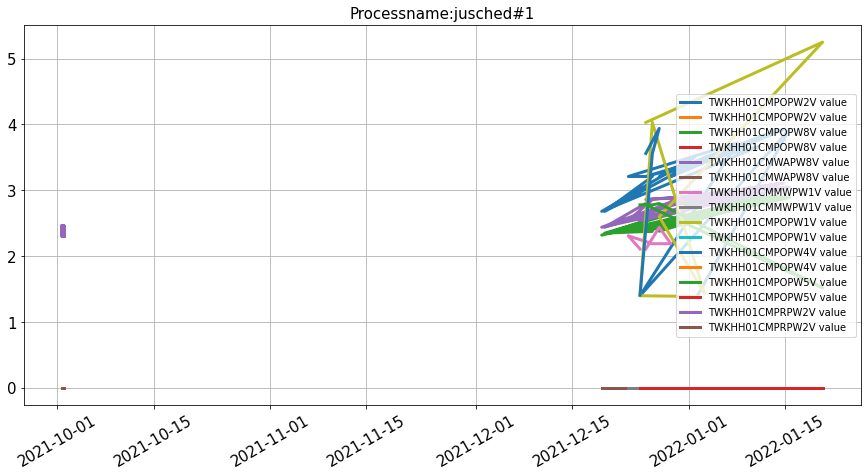

(17,)
(17,)
(6,)
(4,)
(4,)
(2,)
(33,)


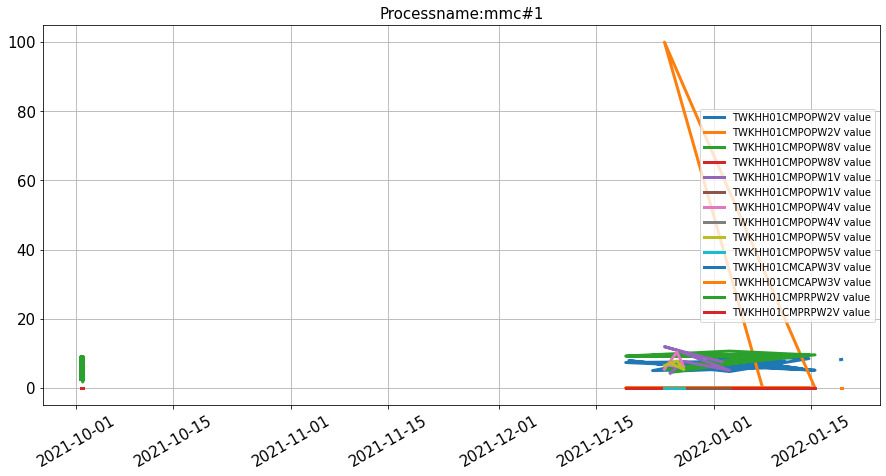

(17,)
(17,)
(17,)
(6,)
(6,)
(4,)
(5,)
(32,)


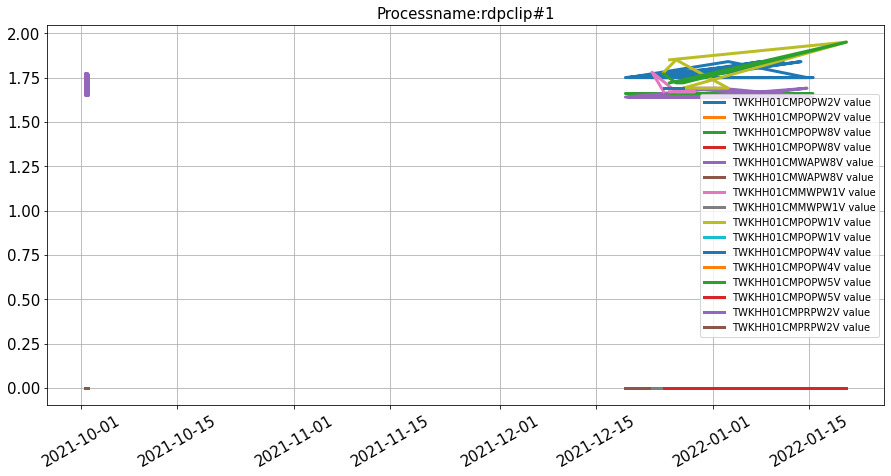

(17,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(32,)


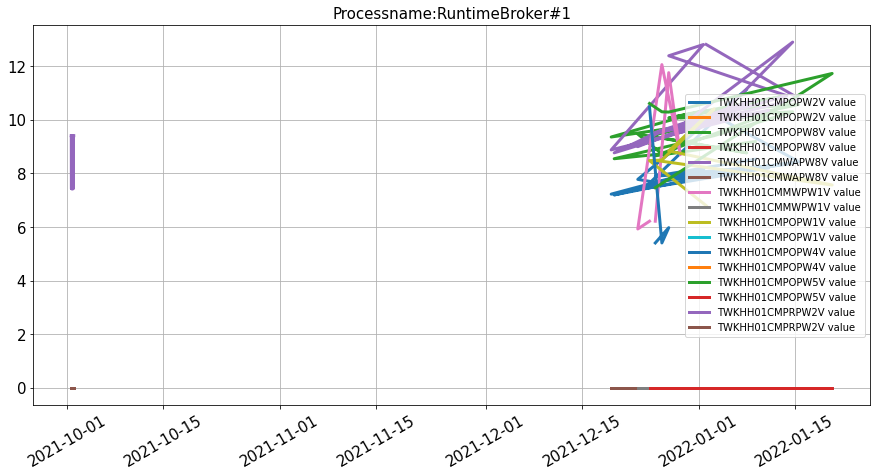

(17,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(33,)


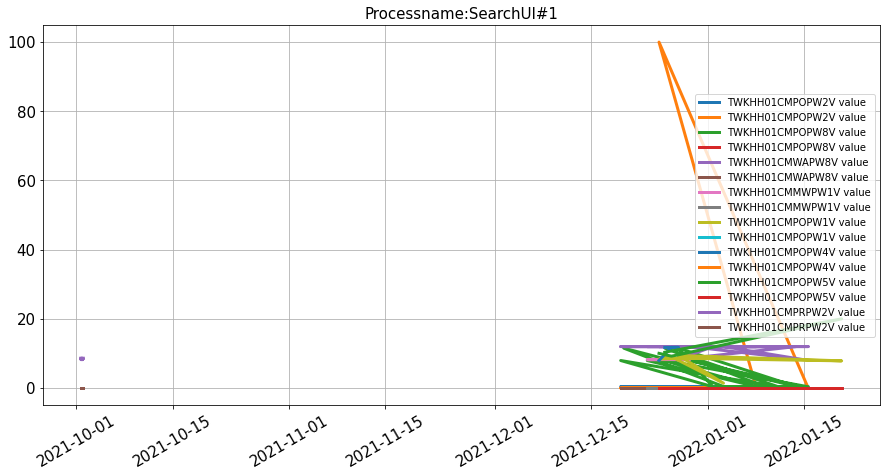

(17,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(32,)


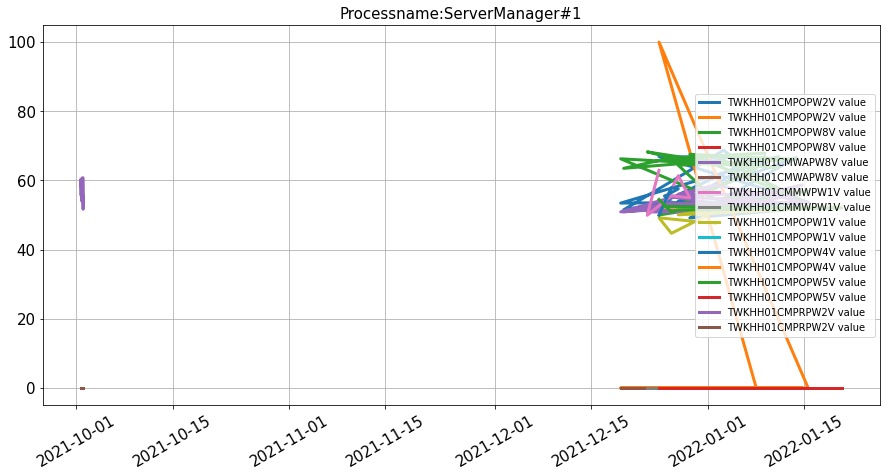

(17,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(32,)


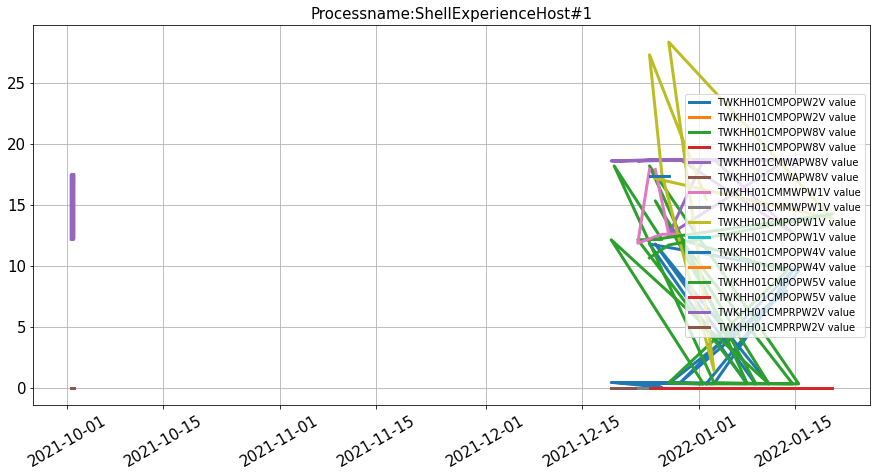

(17,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(32,)


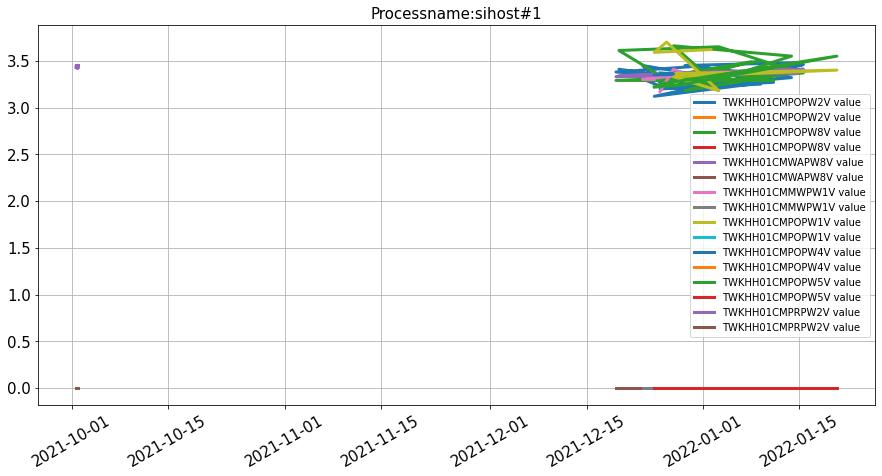

(17,)
(17,)
(55,)
(6,)
(7,)
(4,)
(5,)
(32,)


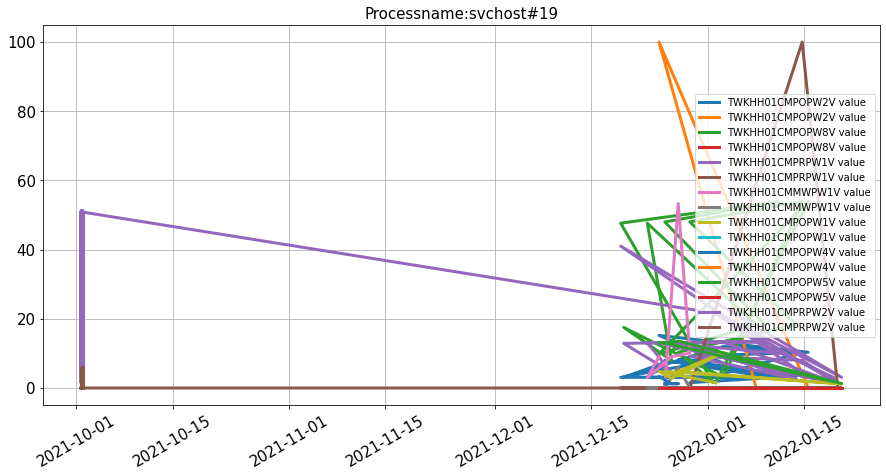

(17,)
(6,)
(17,)
(17,)
(6,)
(7,)
(4,)
(5,)
(1,)
(32,)
(32,)


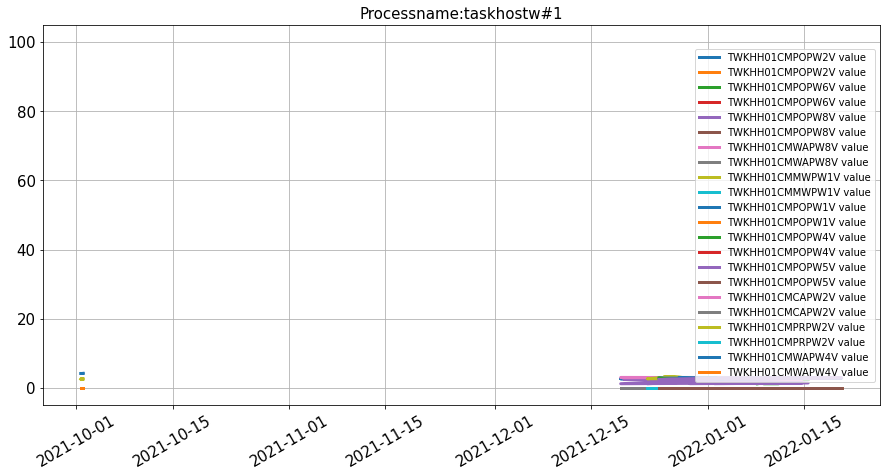

(17,)
(17,)
(17,)
(6,)
(6,)
(4,)
(5,)
(32,)


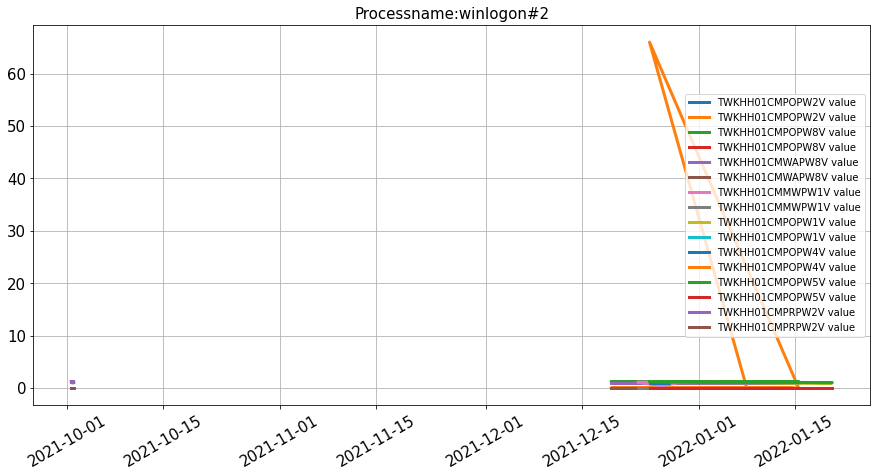

(17,)
(5,)


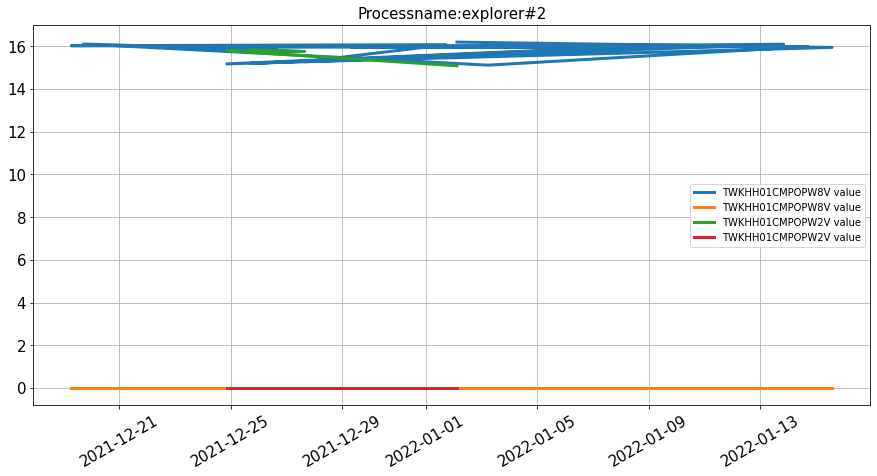

(17,)
(5,)


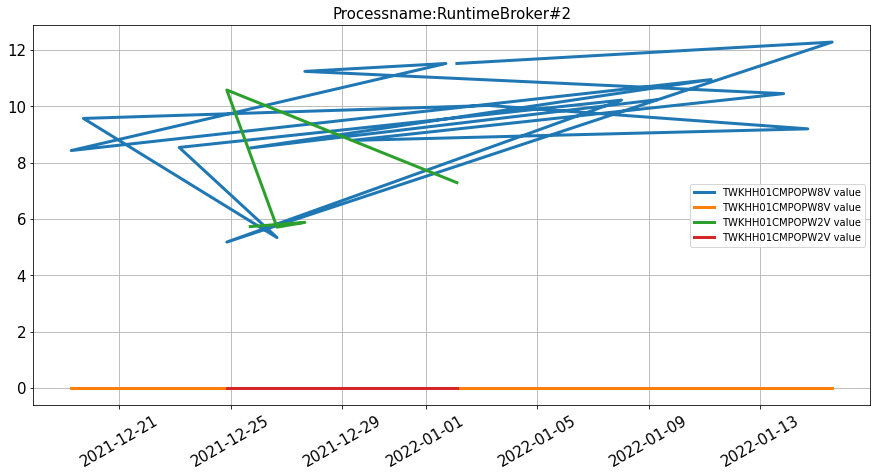

(17,)
(5,)


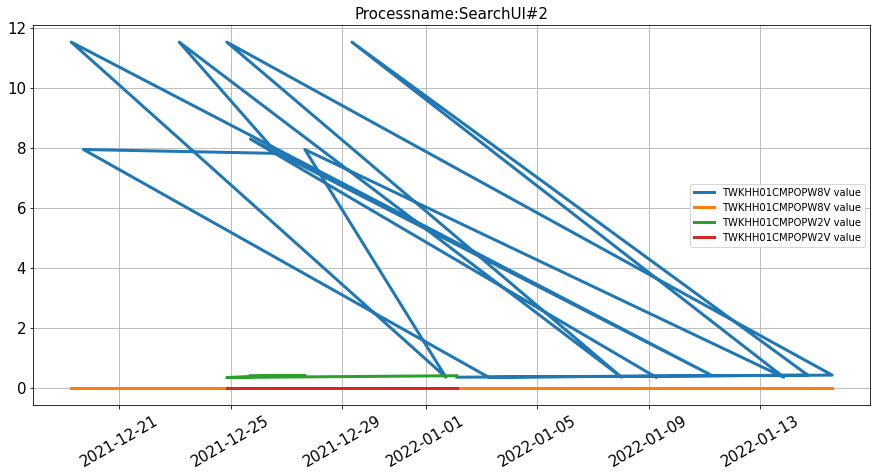

(17,)
(5,)


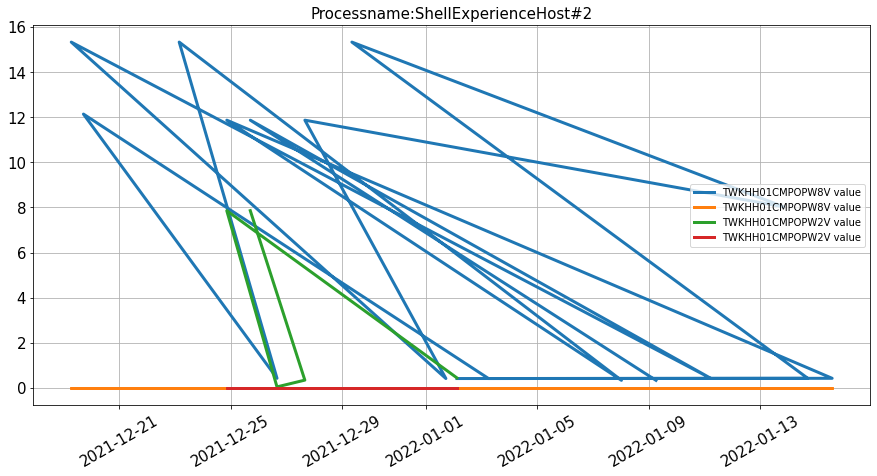

(17,)
(17,)


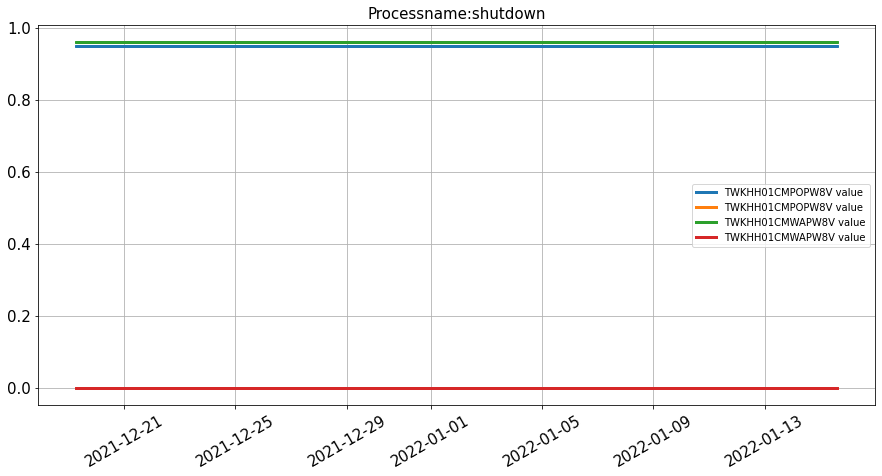

(17,)
(5,)


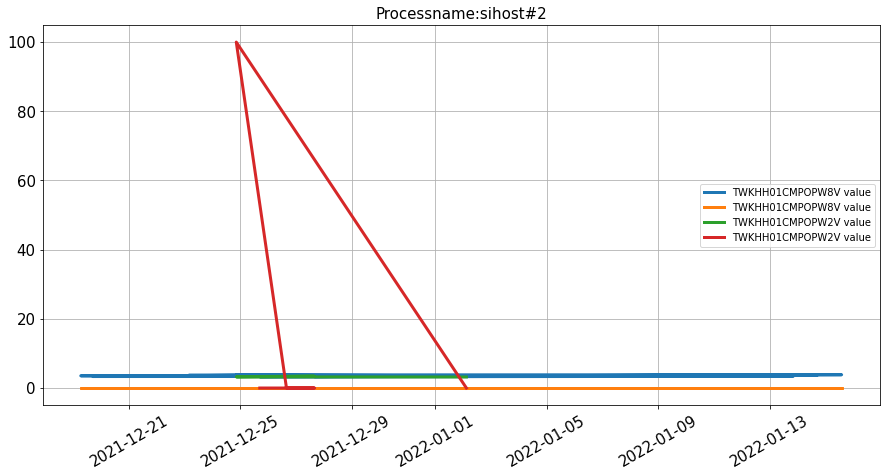

(17,)
(47,)
(5,)
(1,)
(32,)


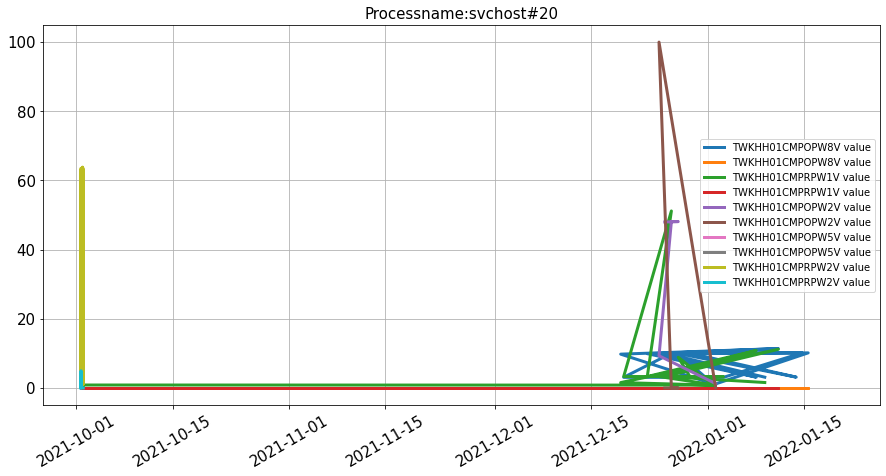

(17,)
(5,)
(1,)


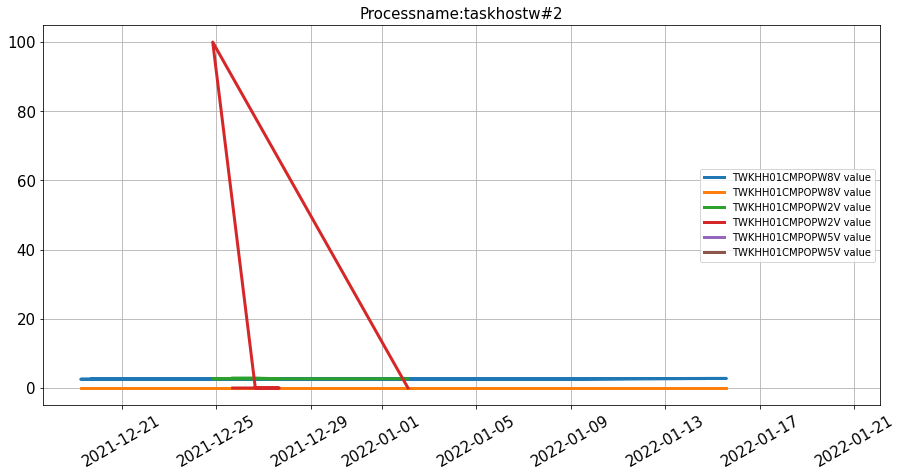

(17,)


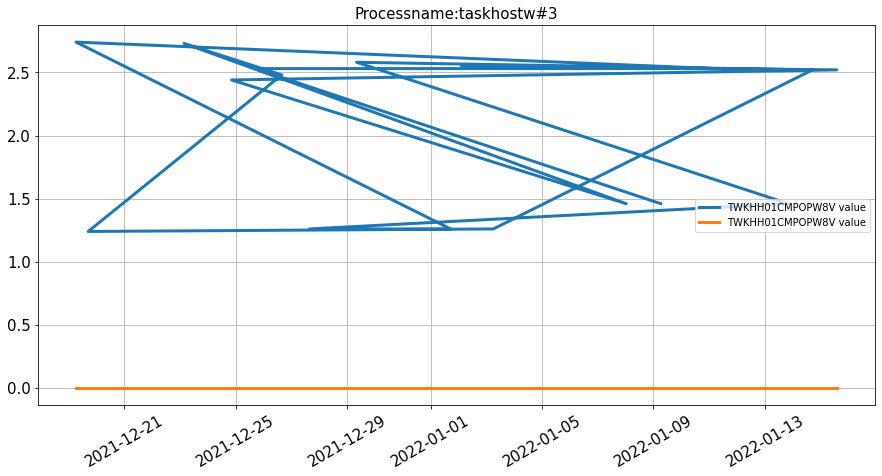

(17,)
(17,)
(2,)


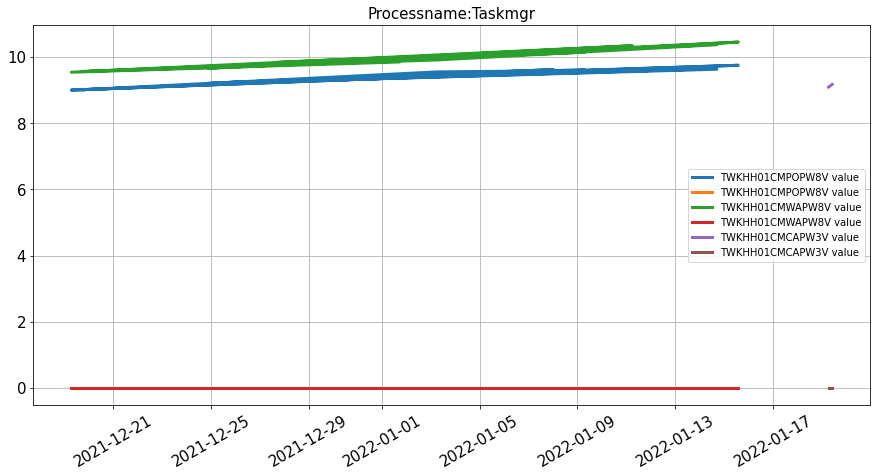

(55,)


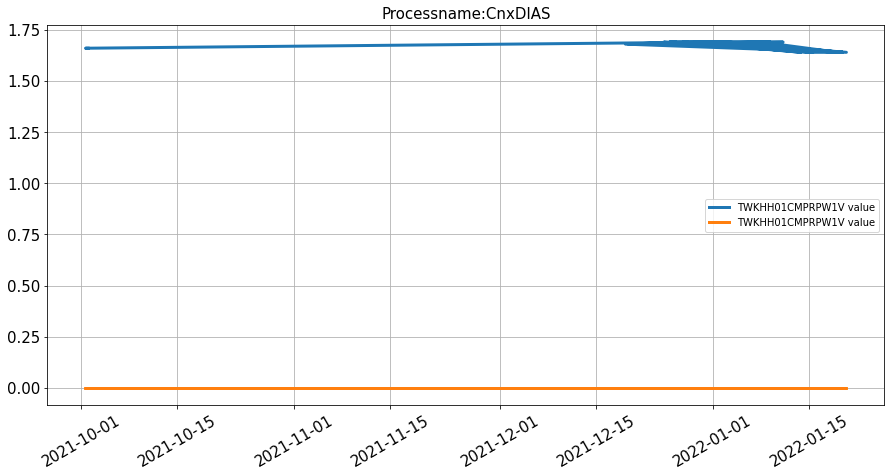

(55,)
(55,)


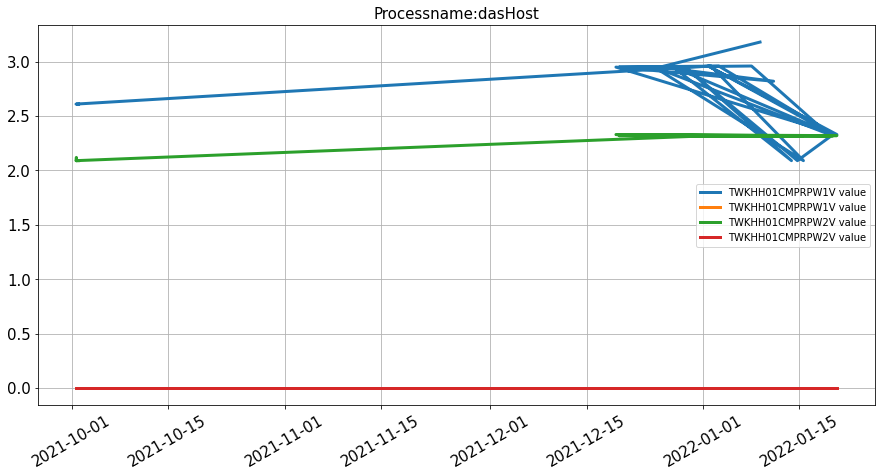

(55,)


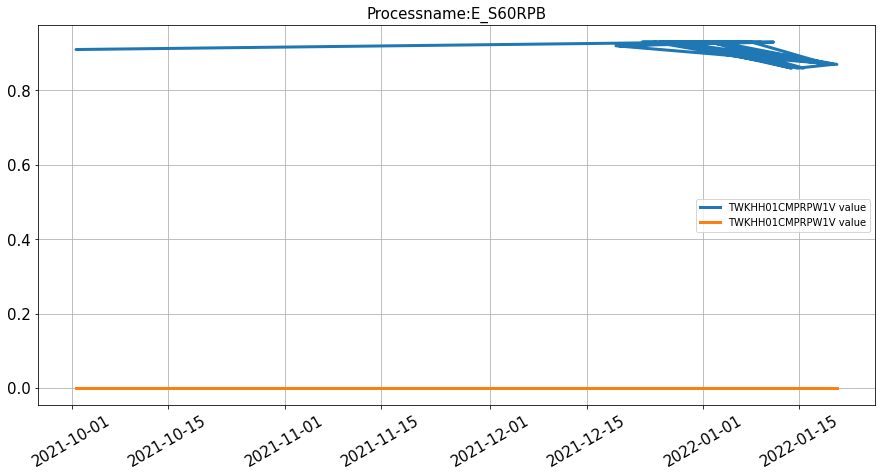

(55,)


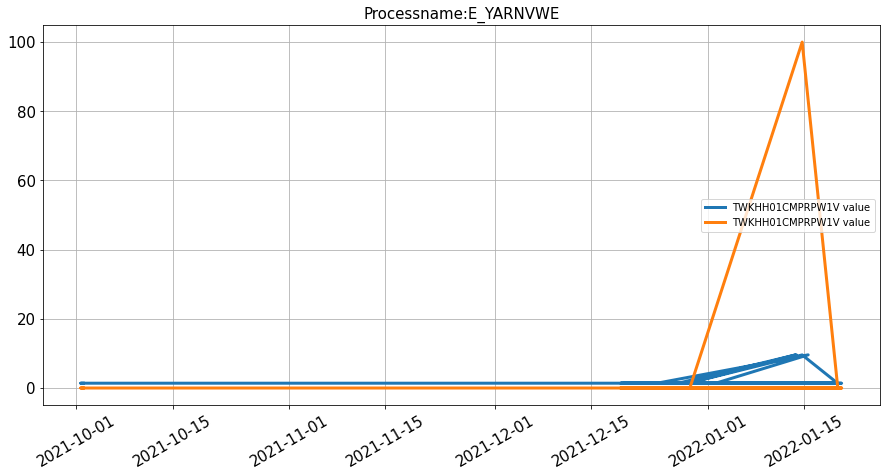

(55,)


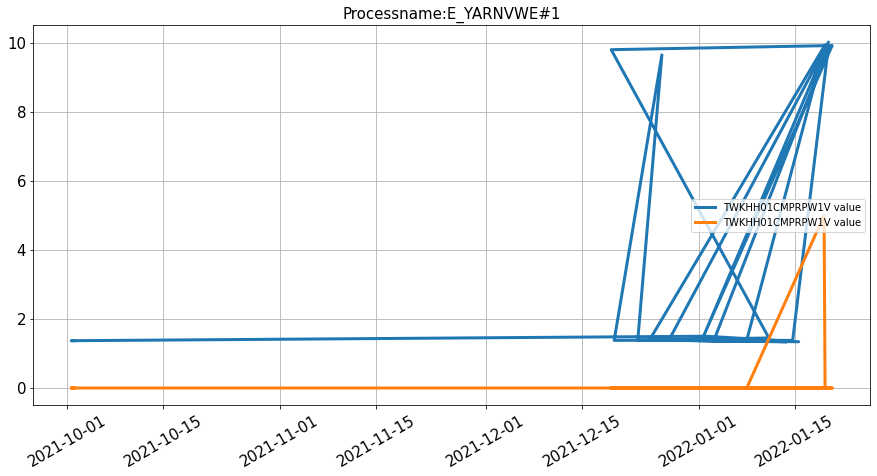

(55,)


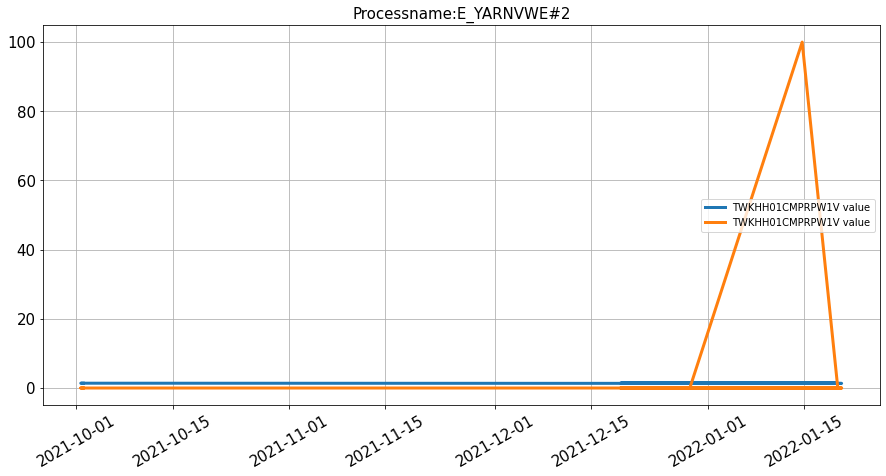

(52,)


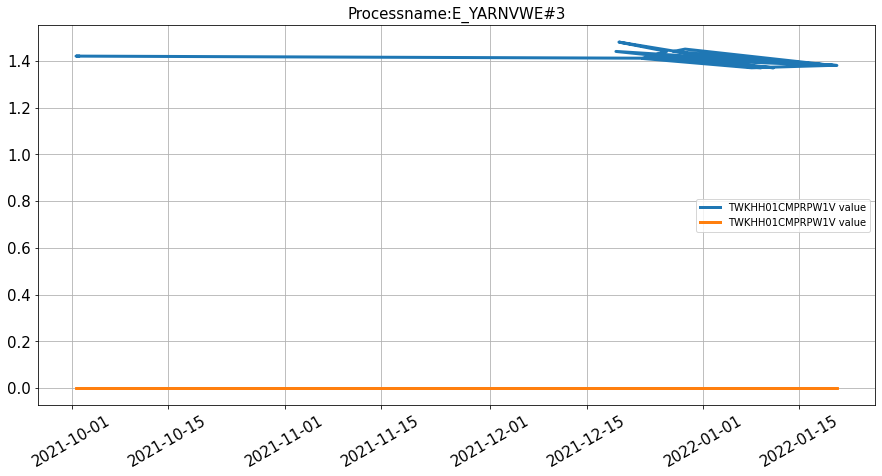

(47,)


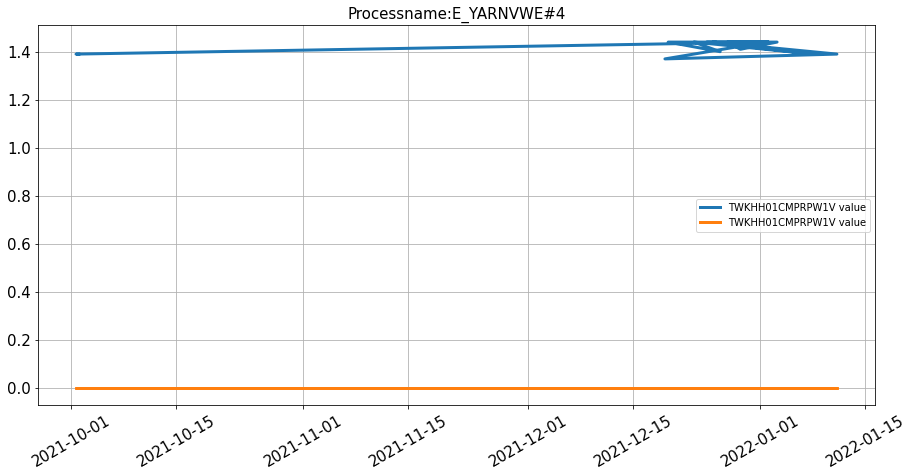

(47,)


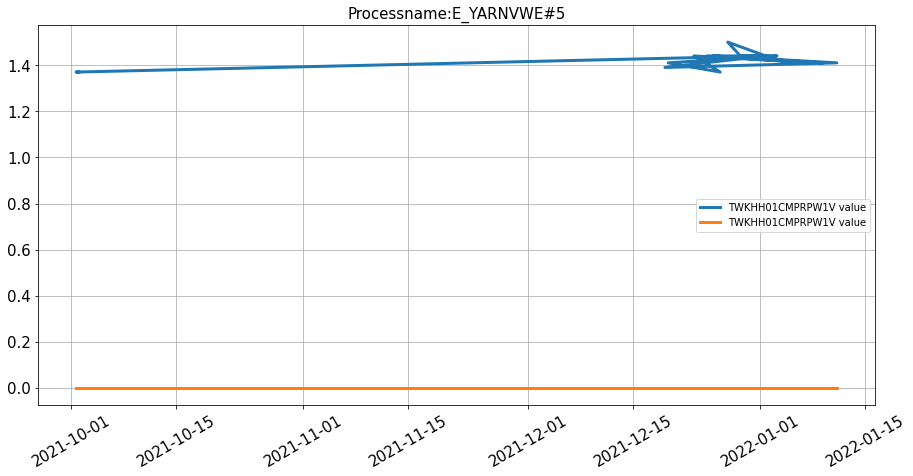

(47,)


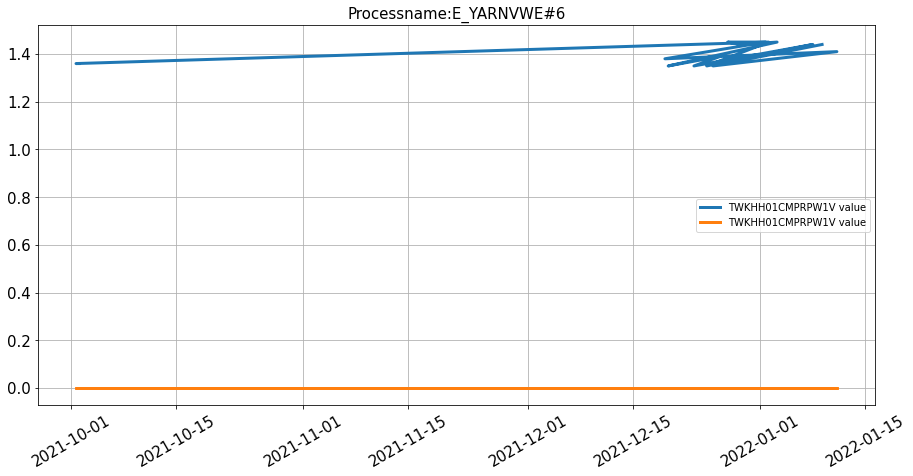

(47,)


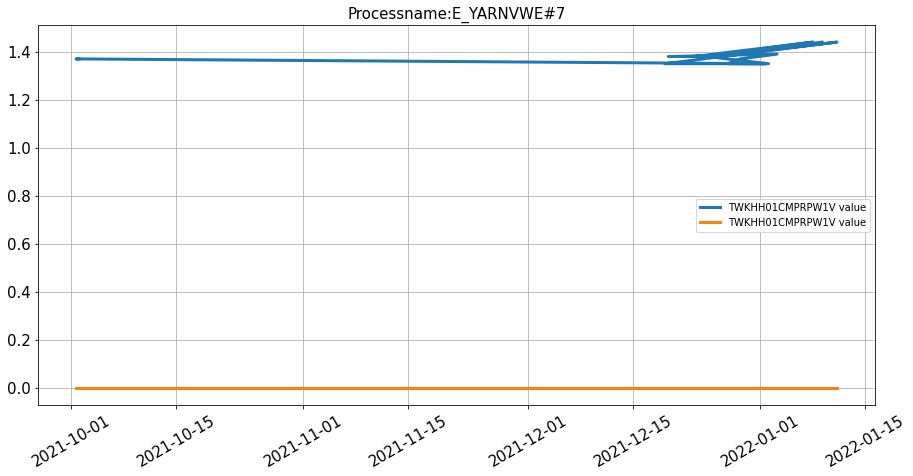

(47,)


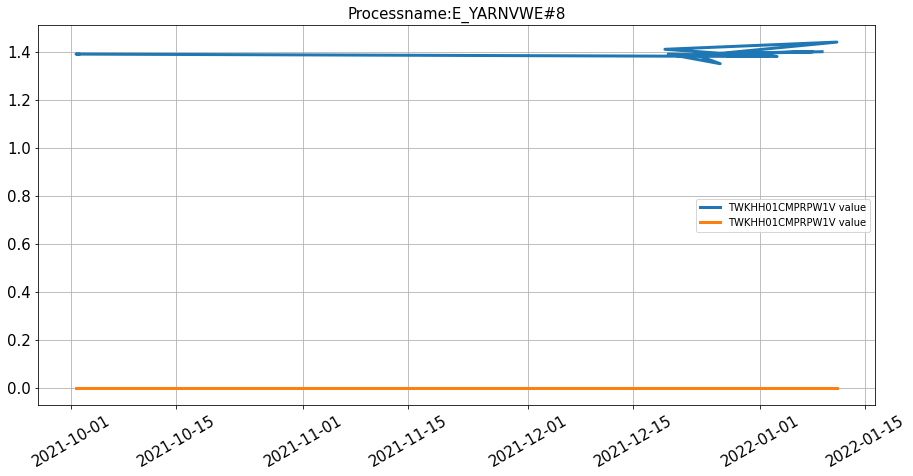

(47,)


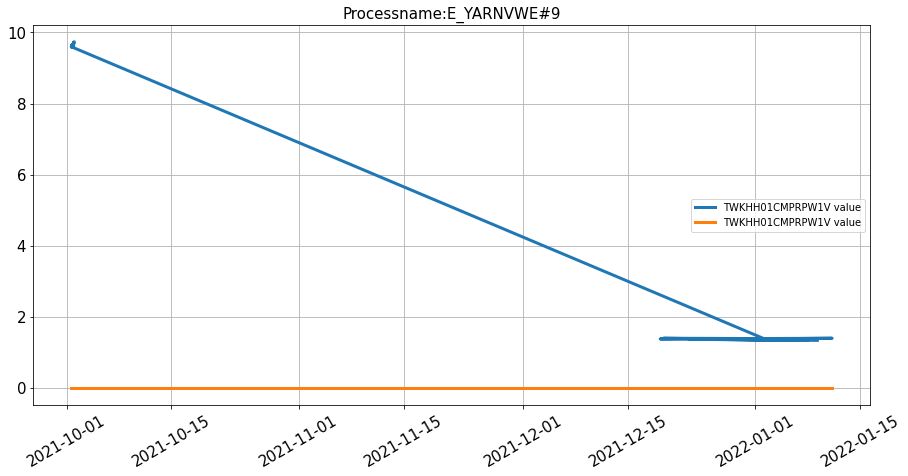

(47,)


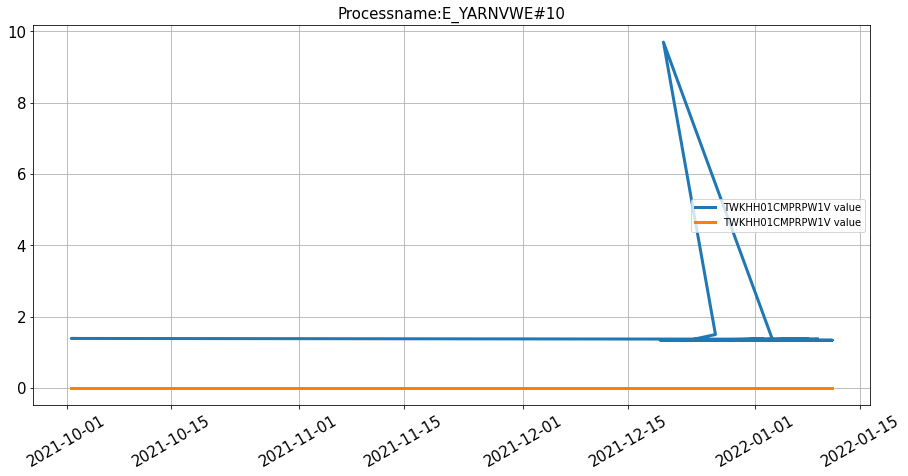

(47,)


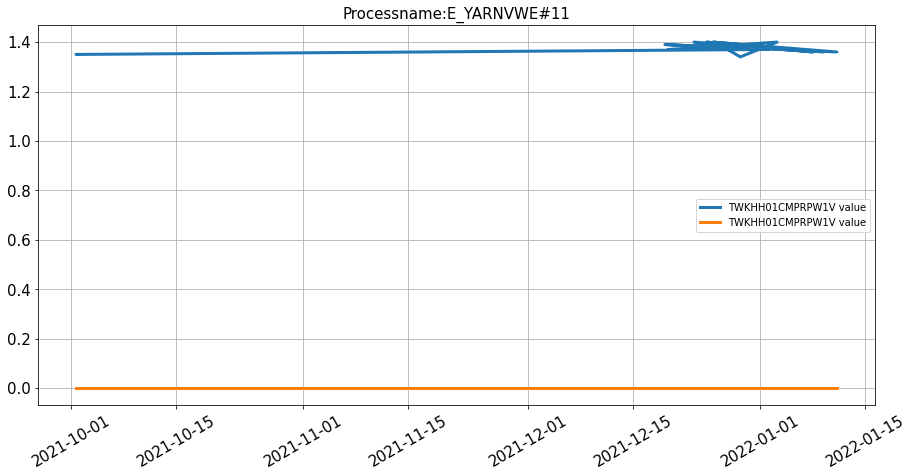

(14,)


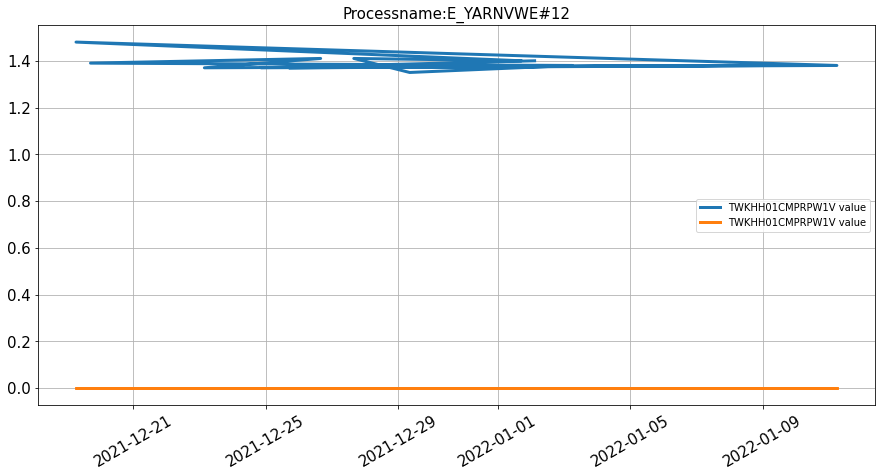

(14,)


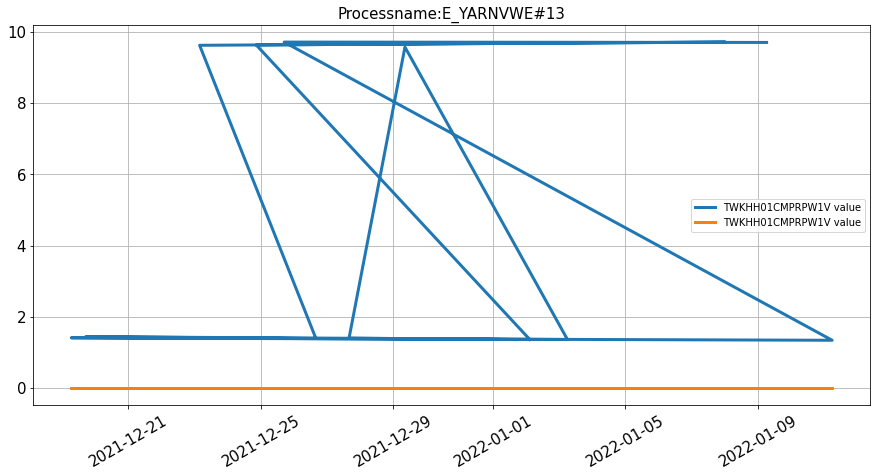

(11,)


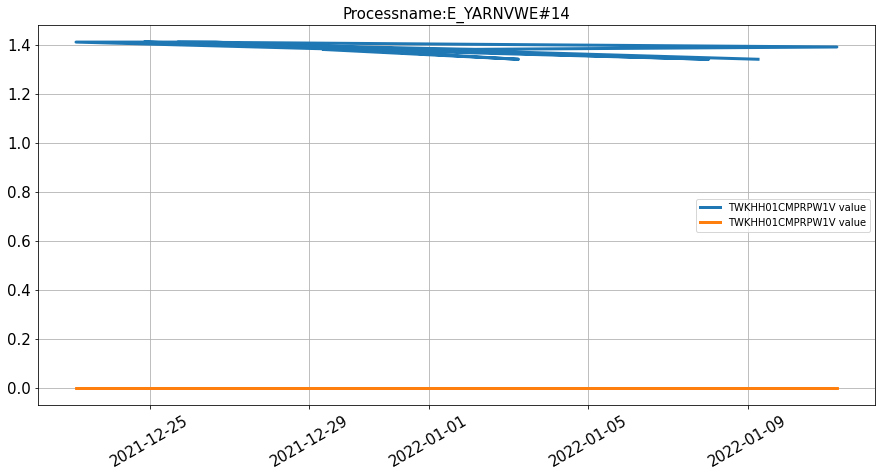

(4,)


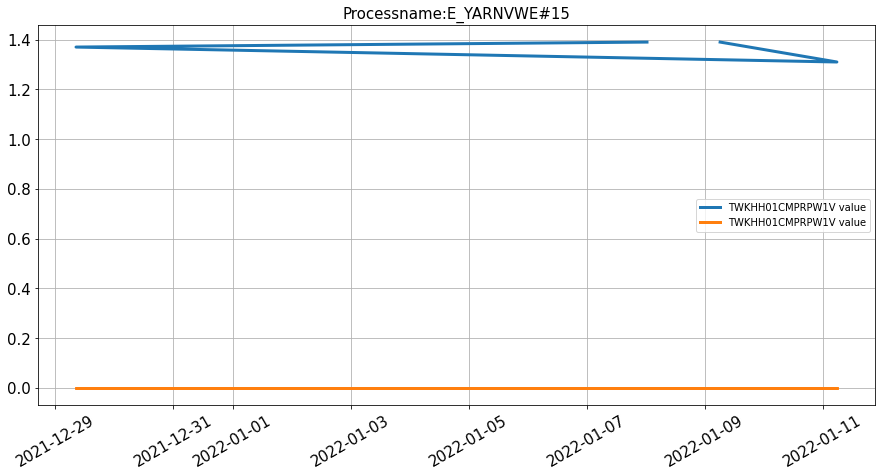

(3,)


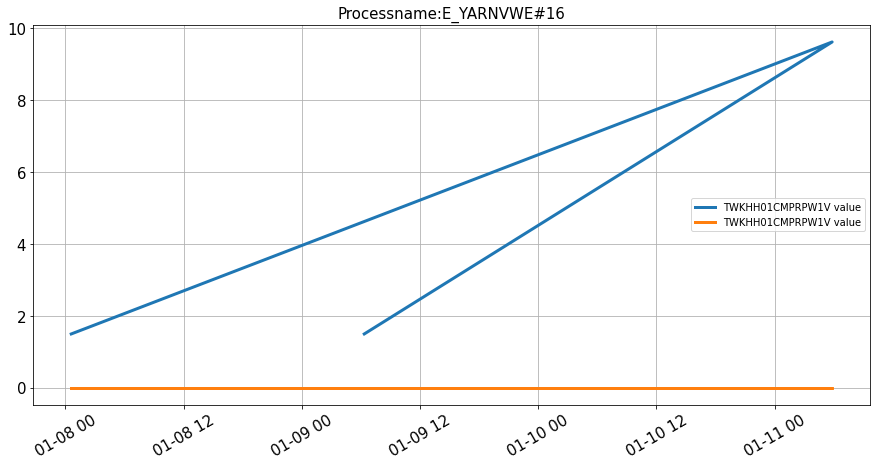

(55,)


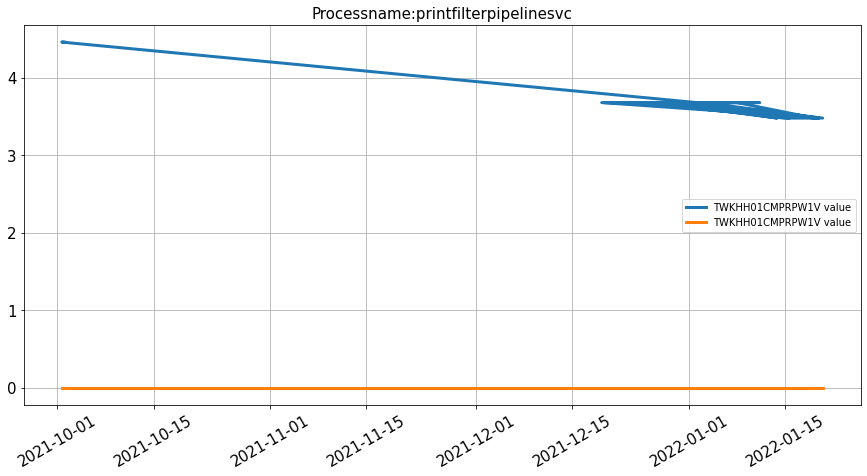

(53,)


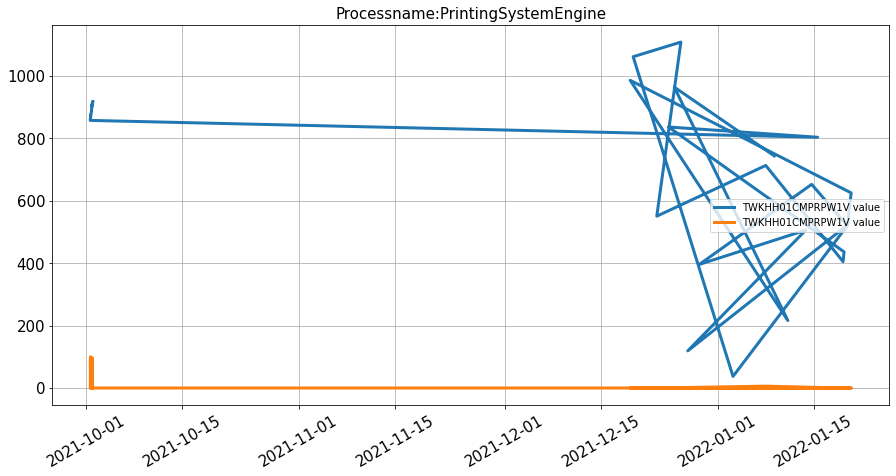

(14,)


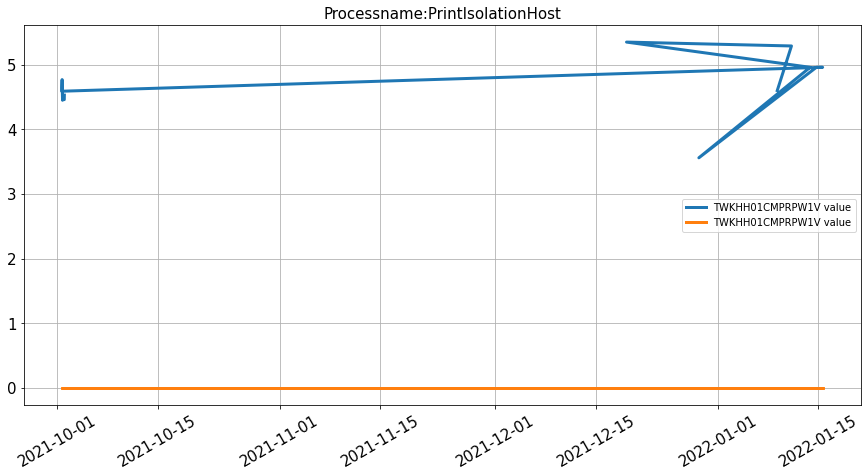

(21,)
(26,)
(12,)
(11,)
(30,)
(32,)
(27,)
(27,)
(27,)
(26,)
(27,)
(29,)
(26,)
(26,)
(27,)
(17,)
(18,)
(24,)
(20,)
(26,)
(25,)
(25,)
(27,)
(26,)
(26,)


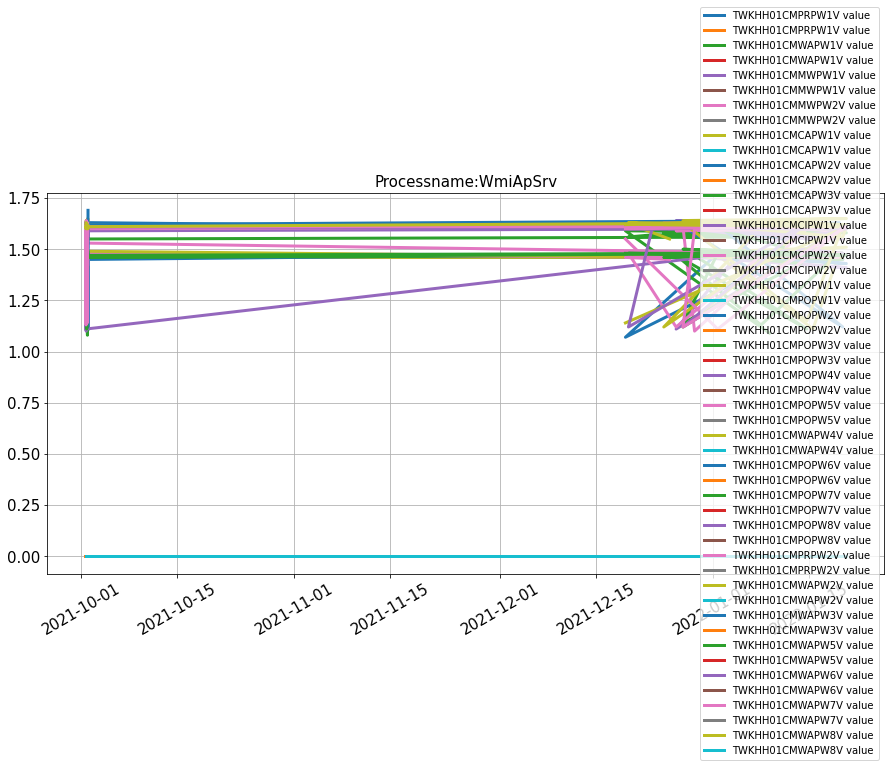

(20,)
(39,)
(10,)
(4,)
(17,)
(3,)
(8,)
(1,)
(1,)
(2,)
(1,)
(2,)
(1,)
(1,)
(32,)
(2,)
(5,)


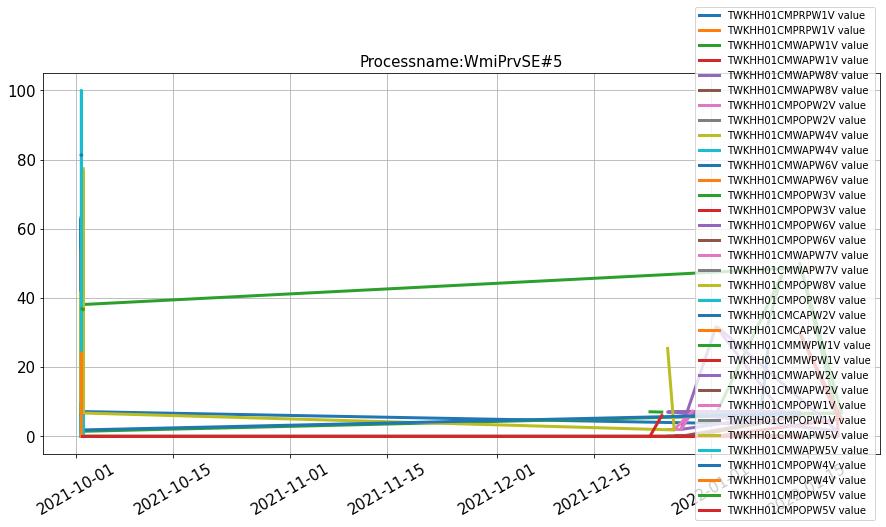

(55,)


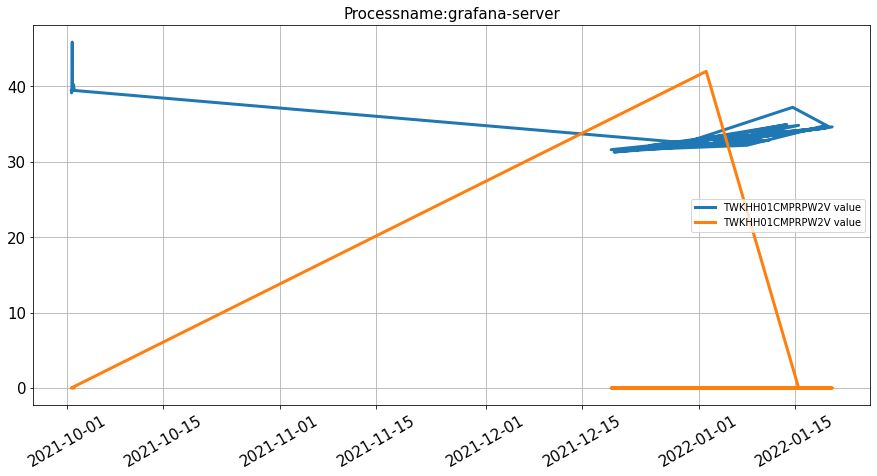

(55,)


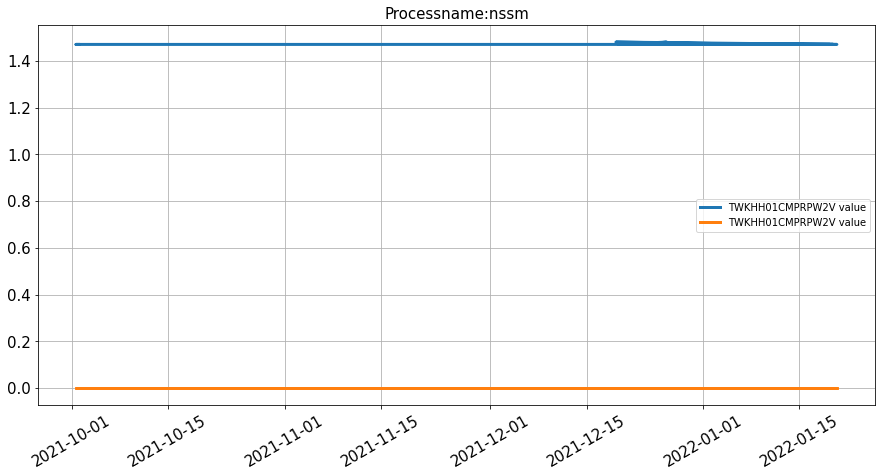

(54,)


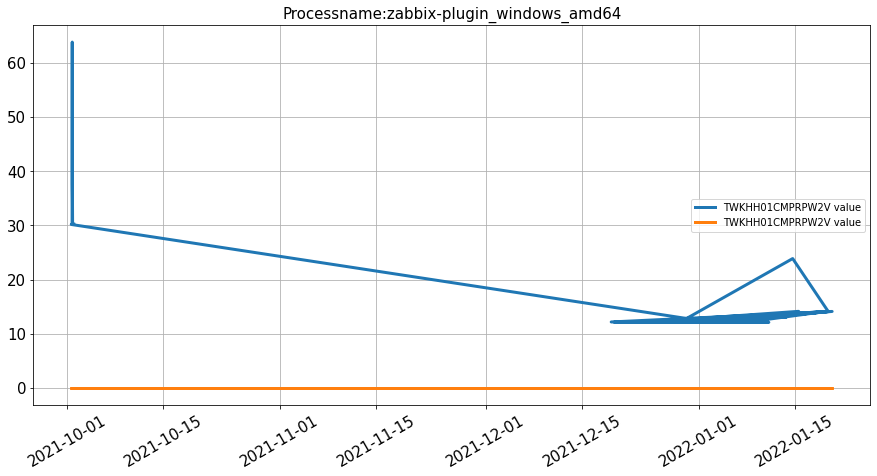

(54,)


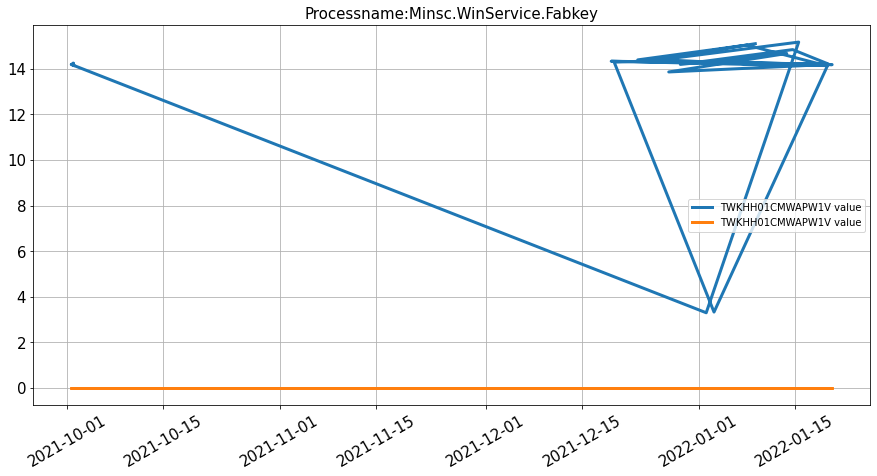

(54,)
(54,)
(54,)
(54,)
(54,)
(54,)


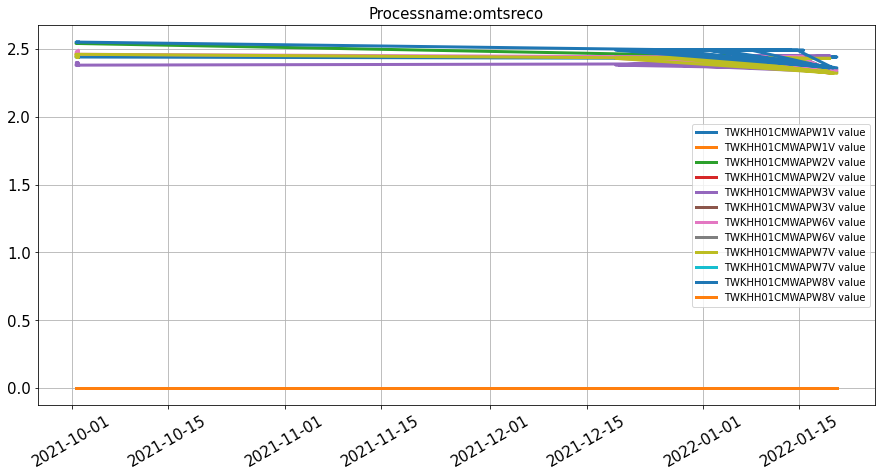

(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(52,)
(20,)
(1,)


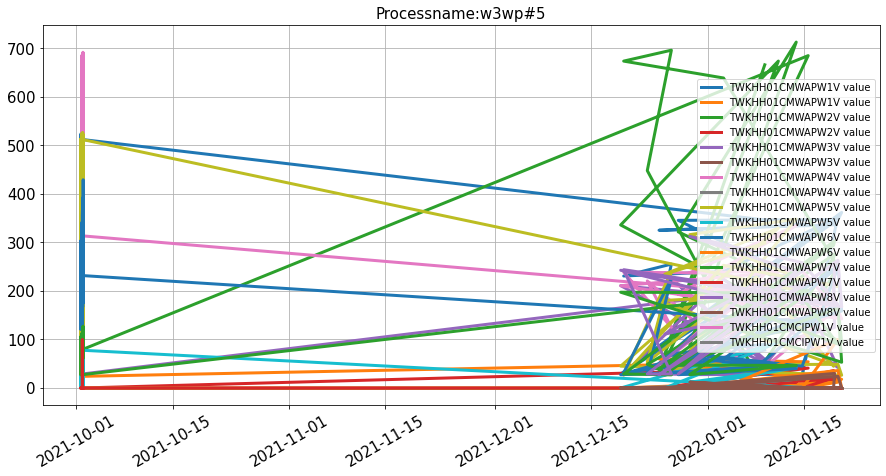

(20,)
(20,)
(20,)
(20,)
(20,)
(20,)
(20,)
(1,)


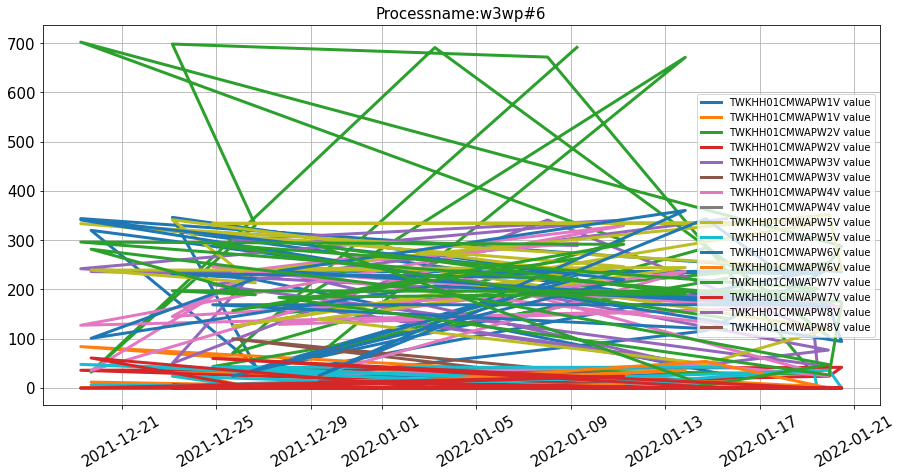

(19,)


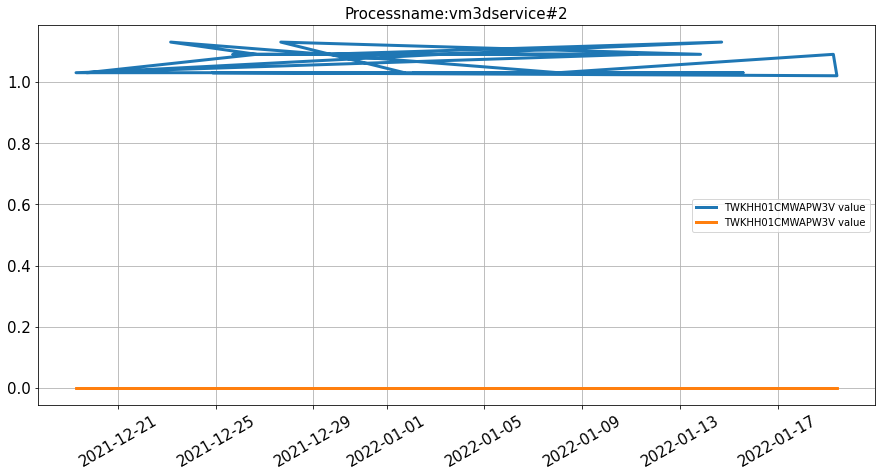

(19,)
(1,)
(1,)


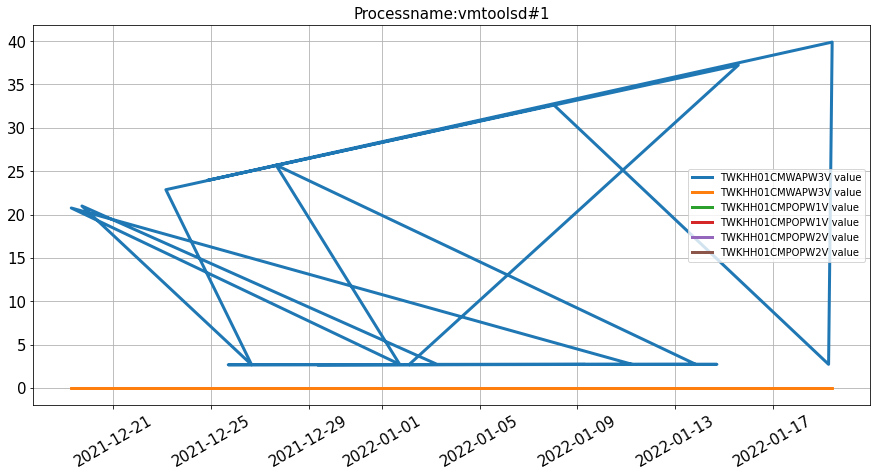

(17,)
(5,)
(1,)
(1,)
(1,)


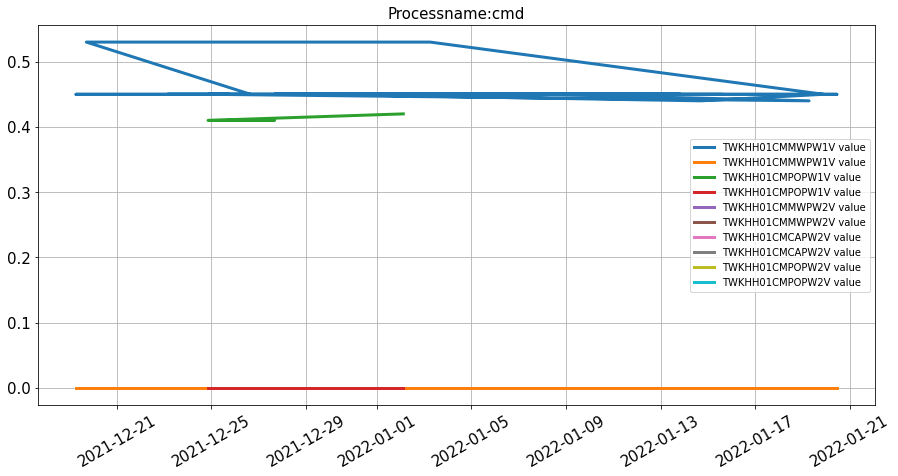

(10,)


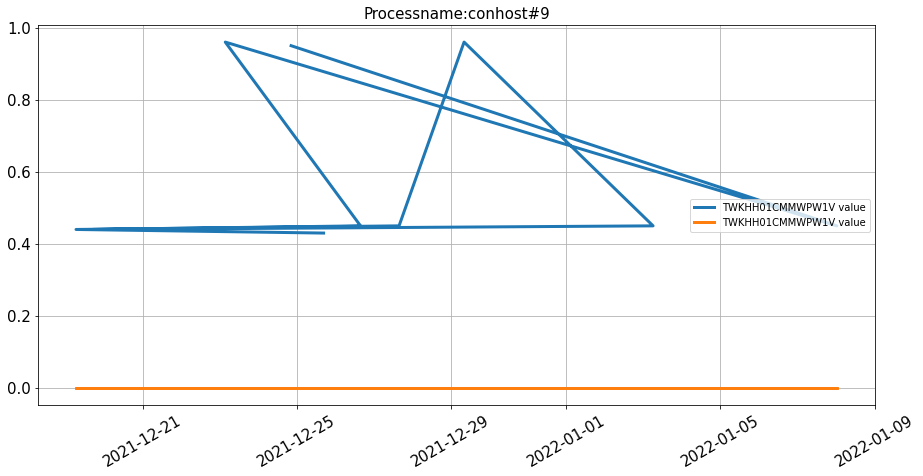

(6,)


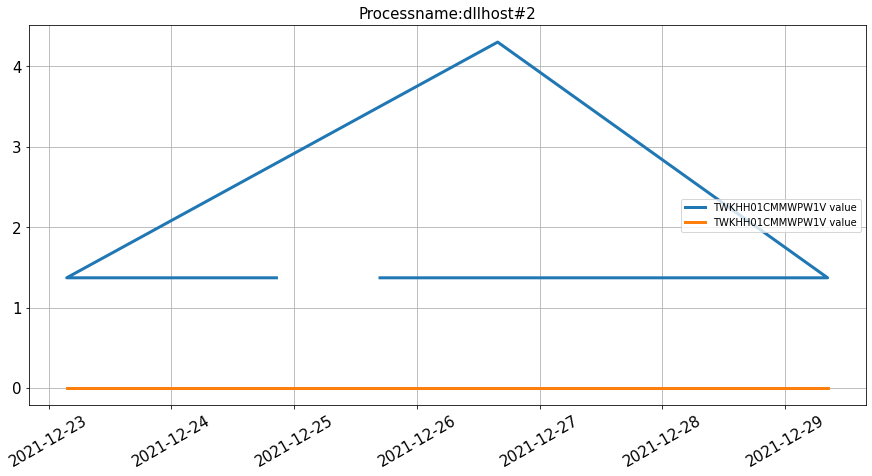

(8,)


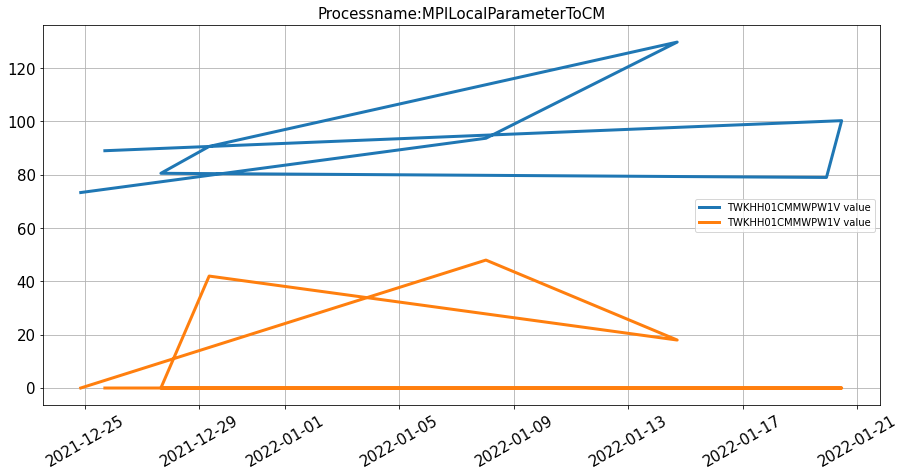

(10,)


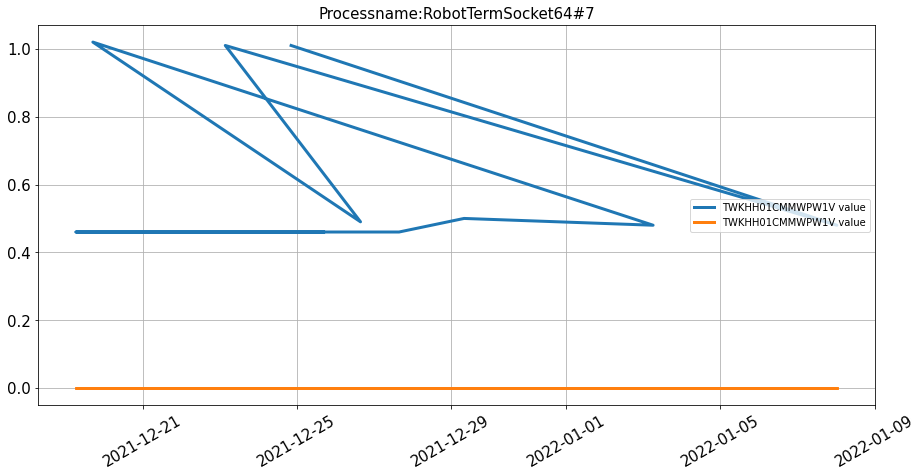

(2,)
(1,)
(1,)
(2,)
(1,)
(1,)


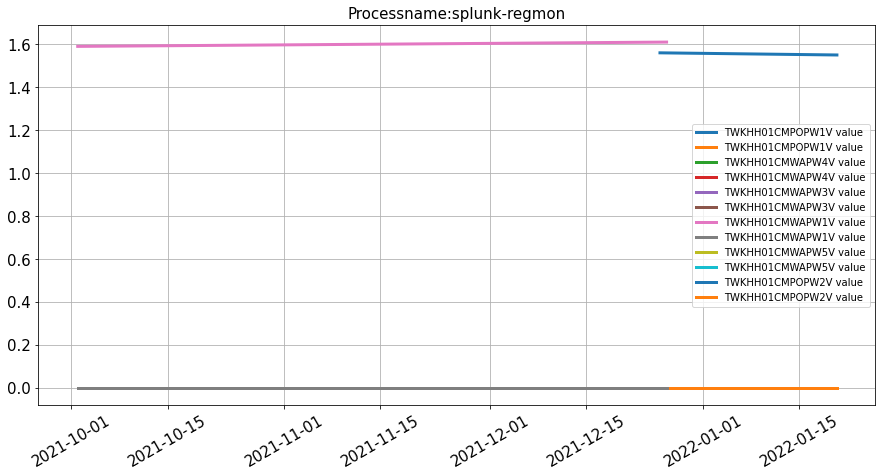

(5,)
(4,)


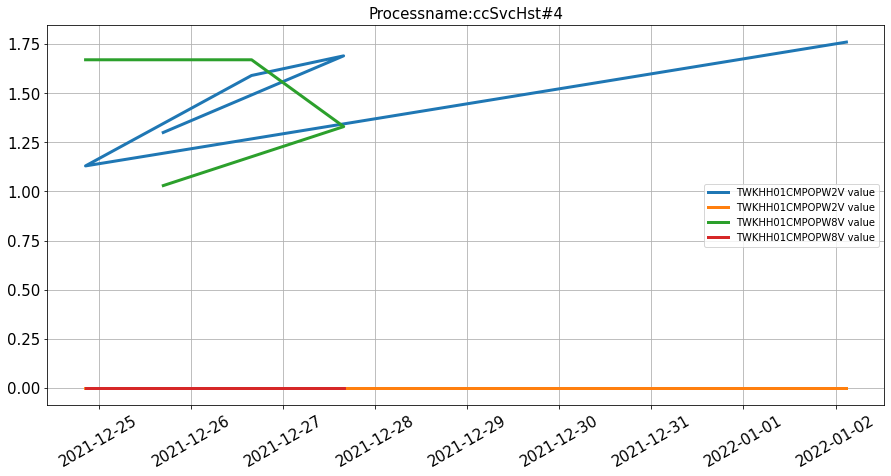

(4,)
(4,)


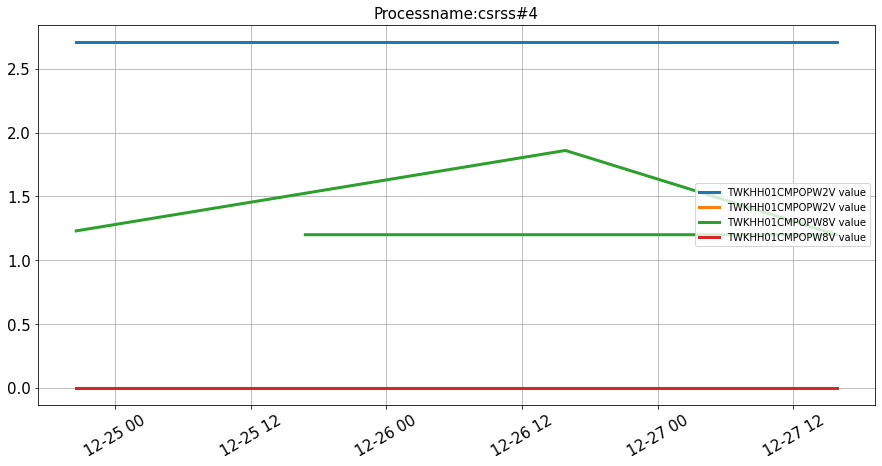

(4,)
(4,)


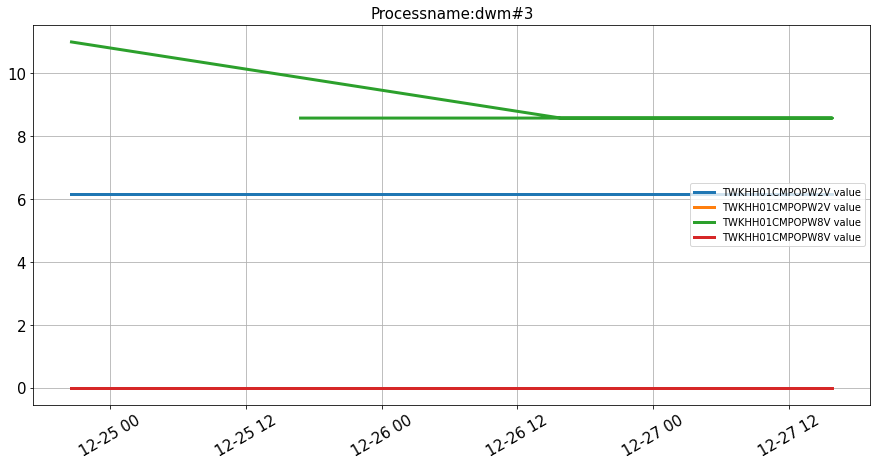

(5,)
(4,)


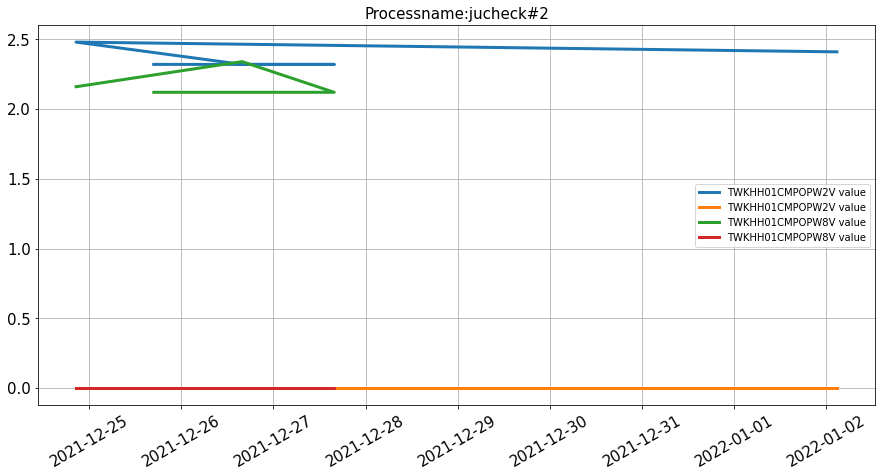

(5,)
(4,)


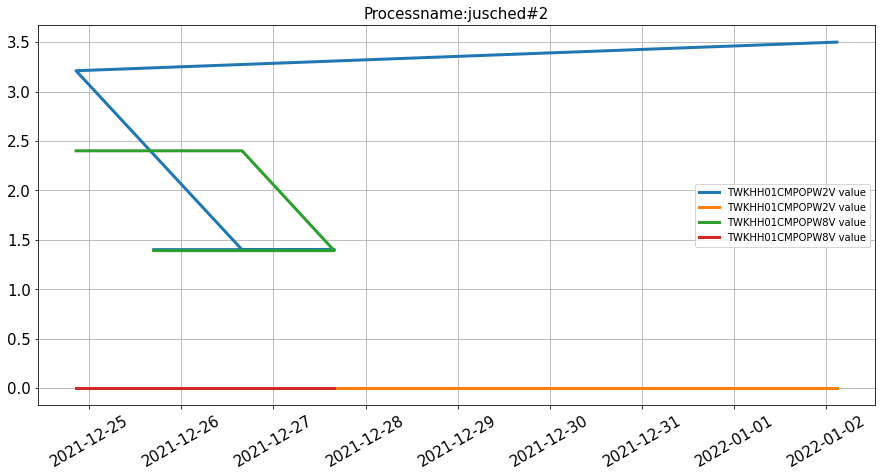

(4,)
(4,)
(2,)


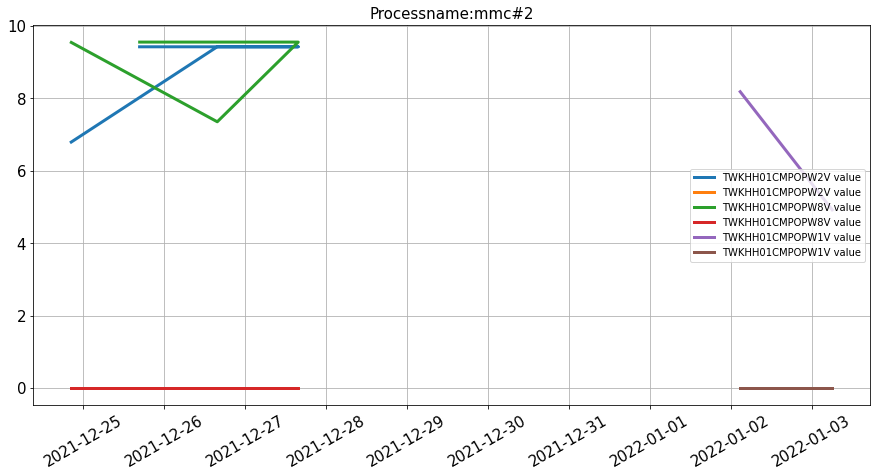

(4,)
(4,)


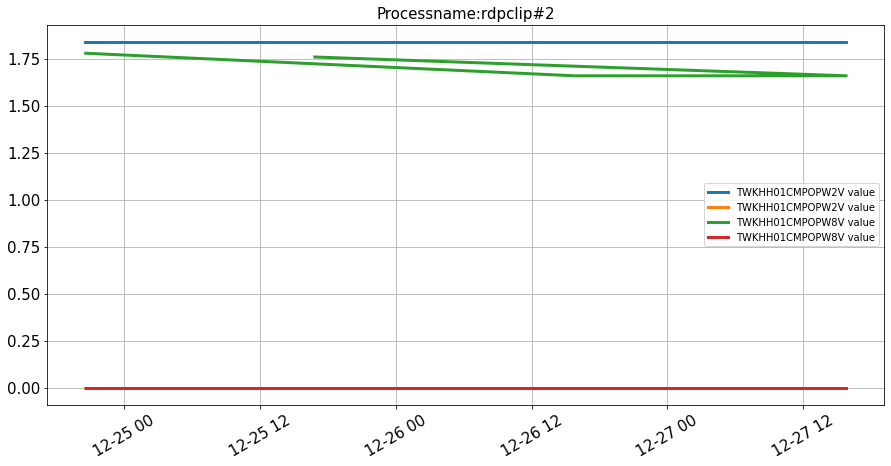

(5,)
(4,)


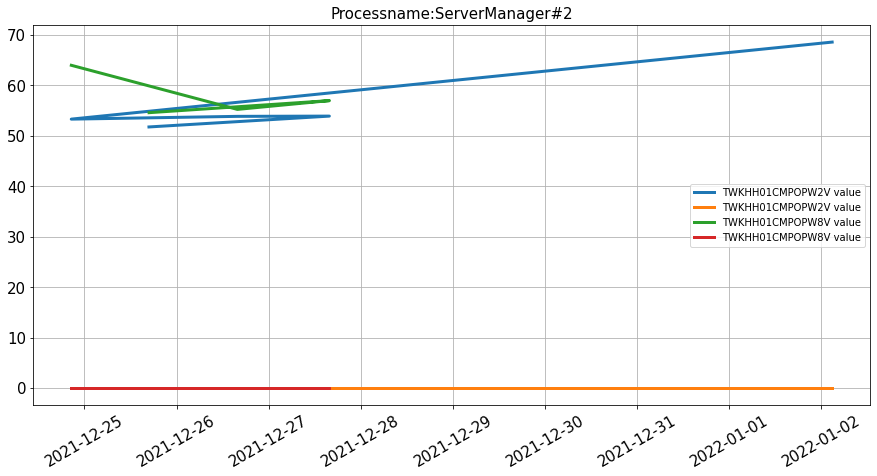

(4,)
(4,)


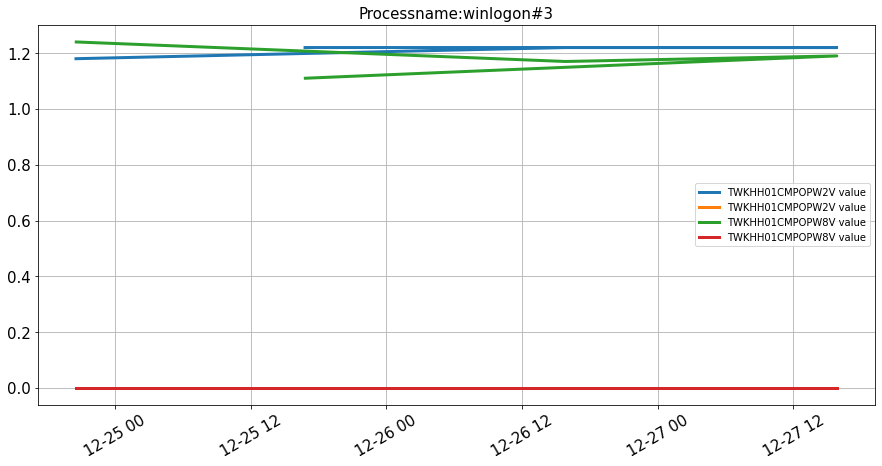

(4,)


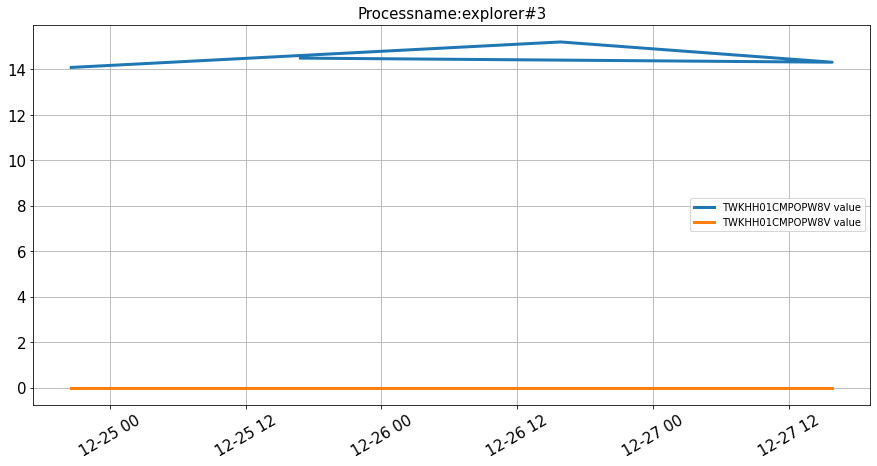

(4,)


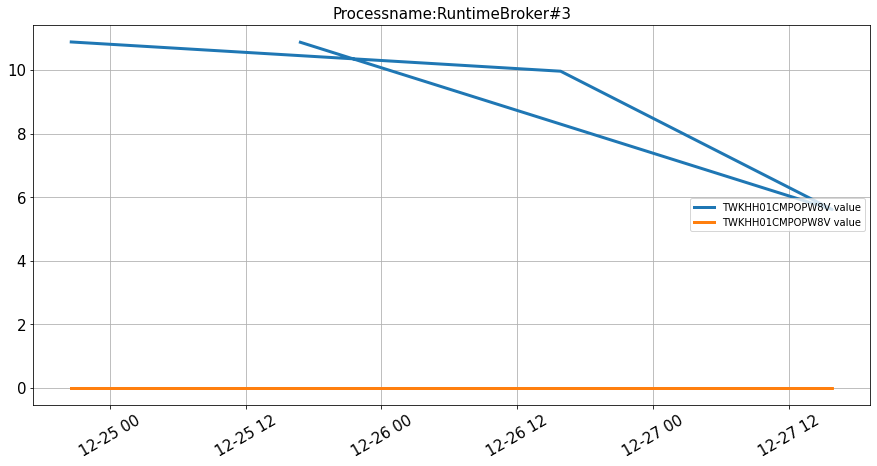

(4,)


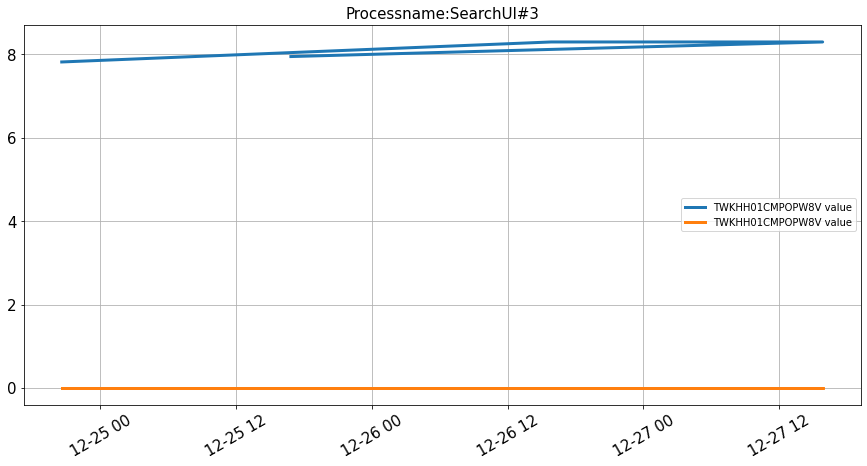

(4,)


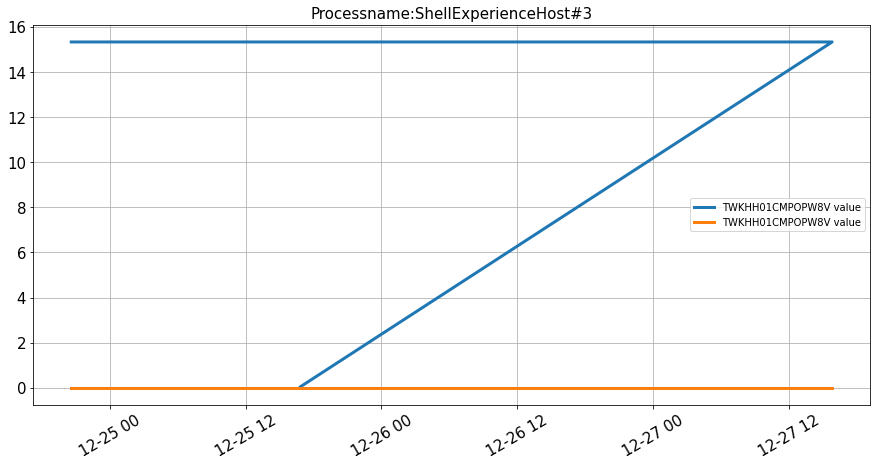

(4,)


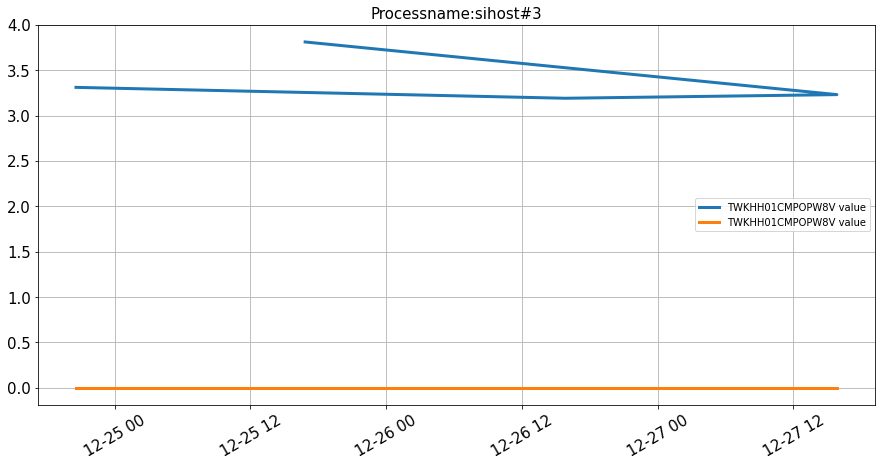

(4,)
(33,)


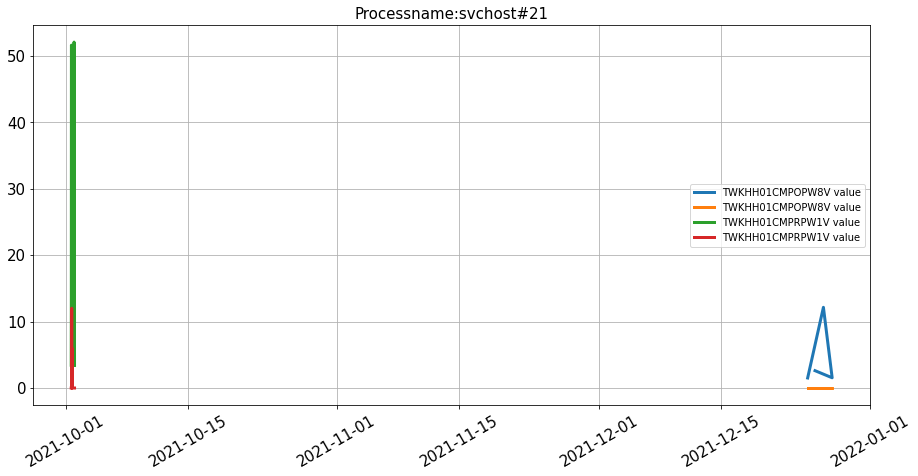

(4,)


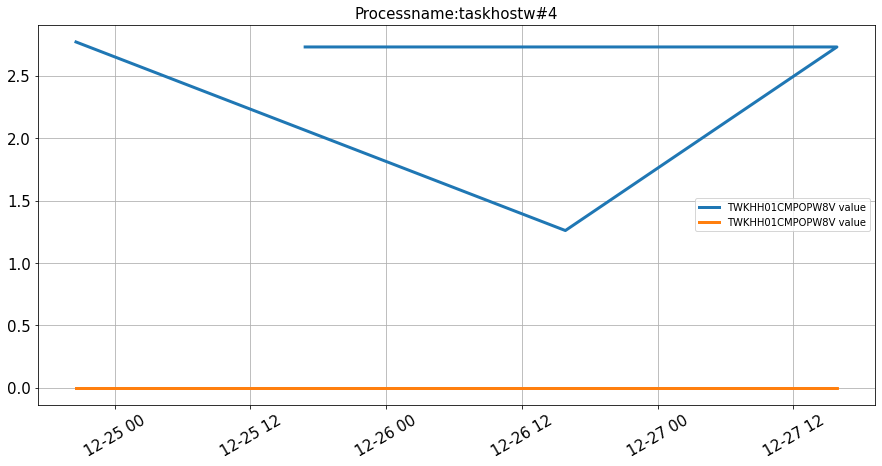

(1,)


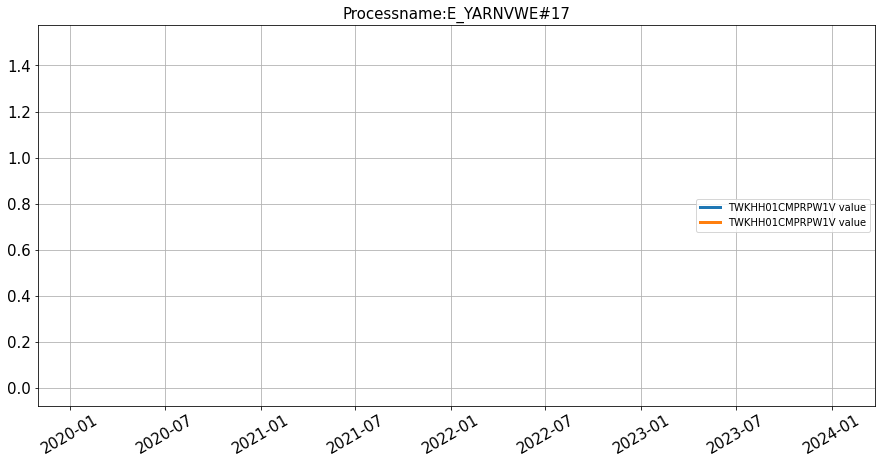

(1,)


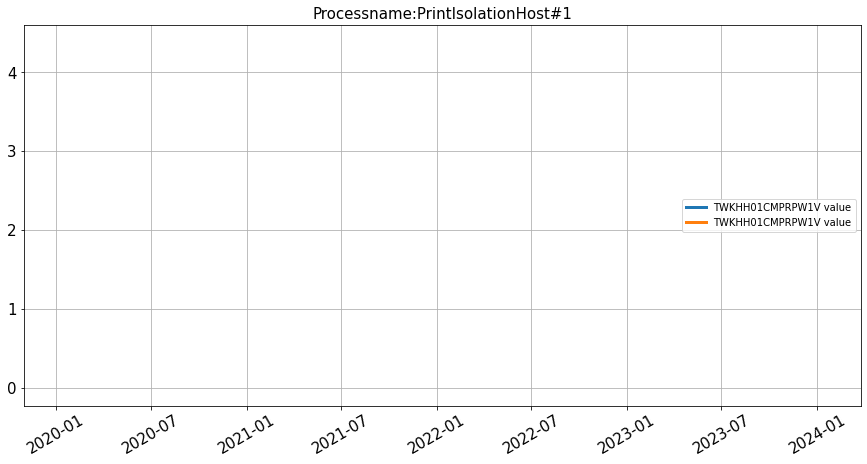

(13,)


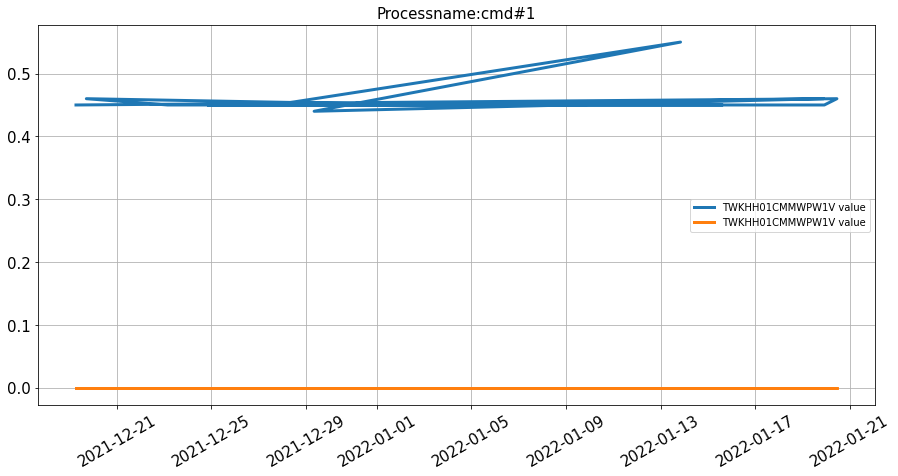

(8,)


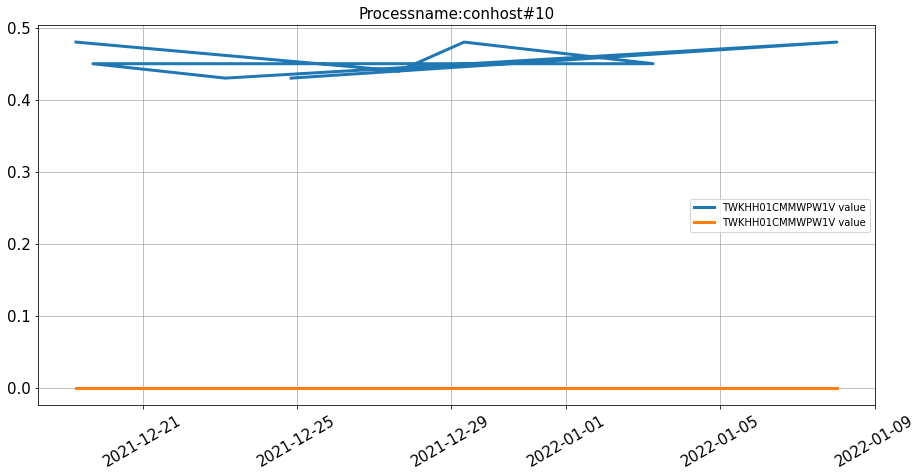

(7,)


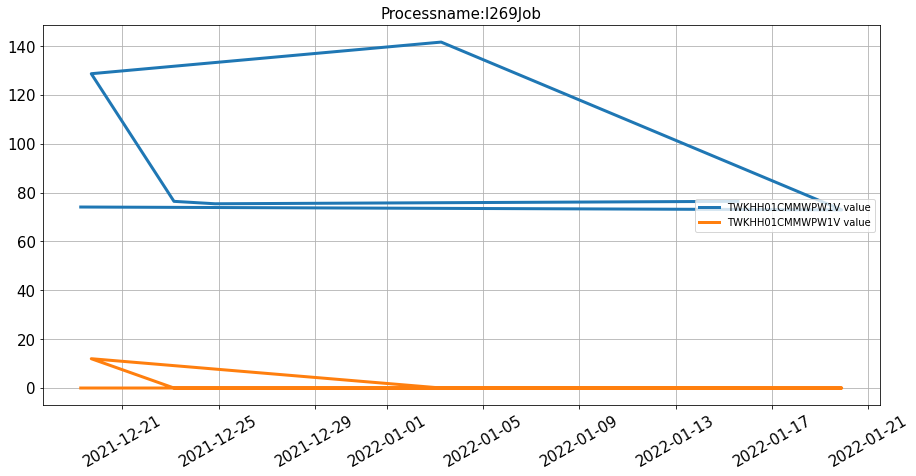

(11,)


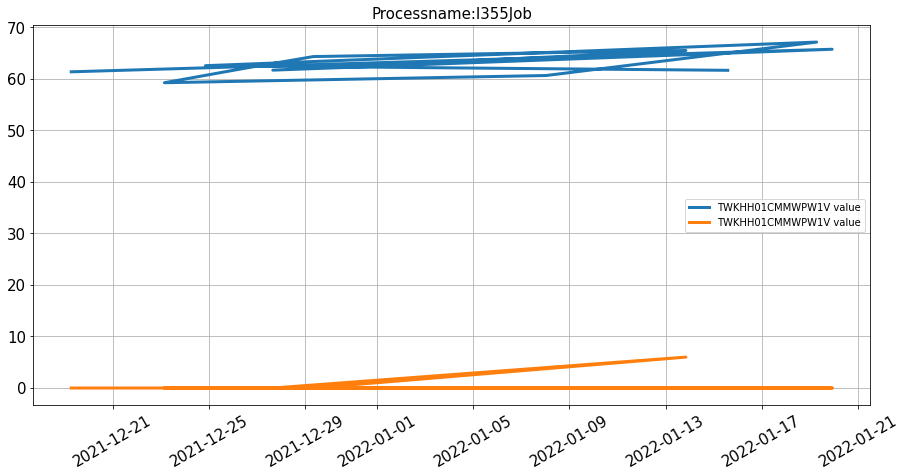

(8,)


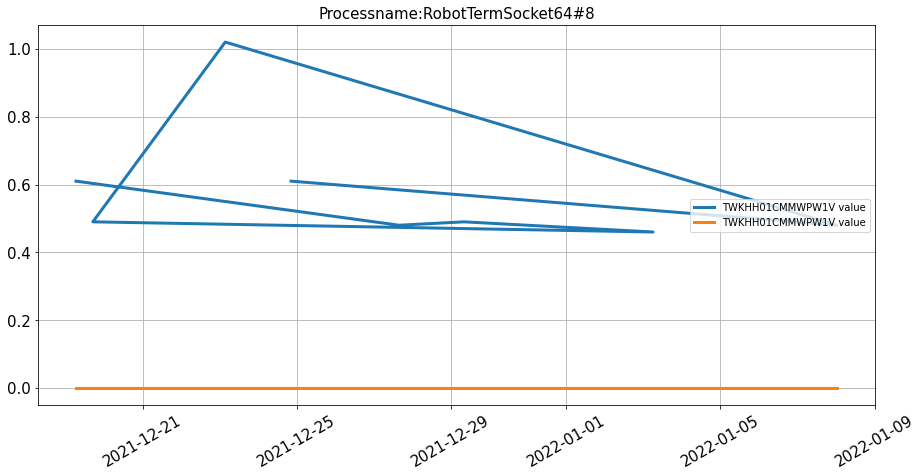

(1,)
(1,)
(1,)


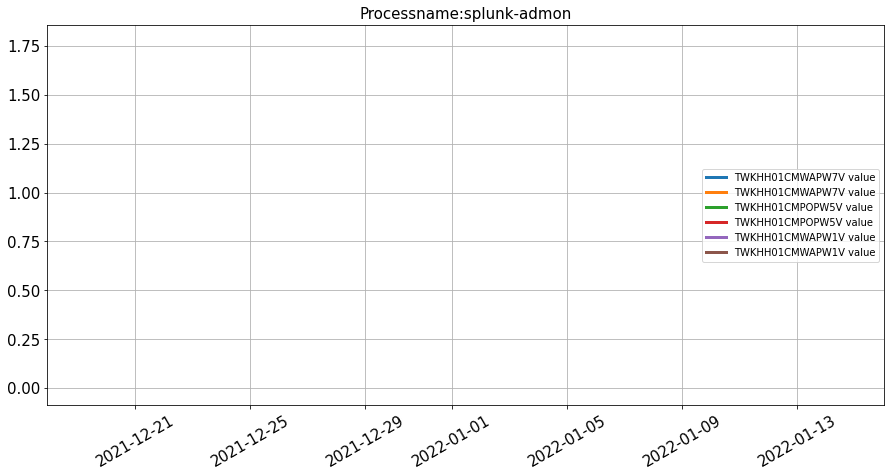

(5,)


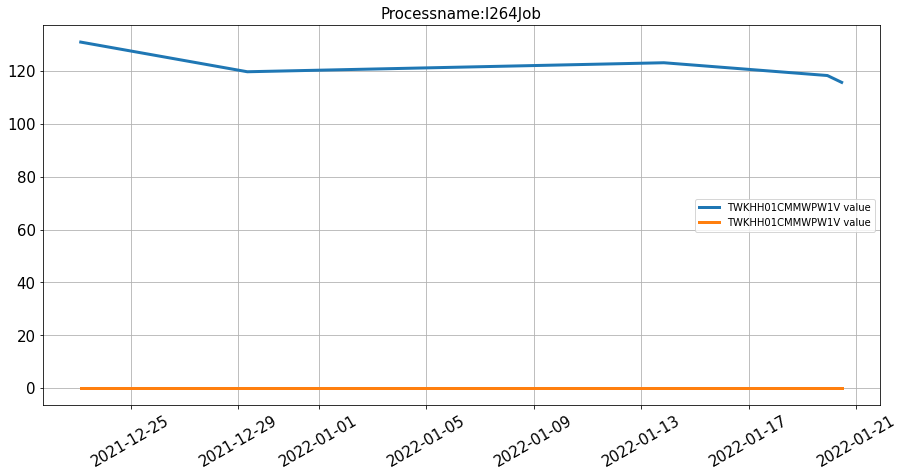

(1,)
(1,)


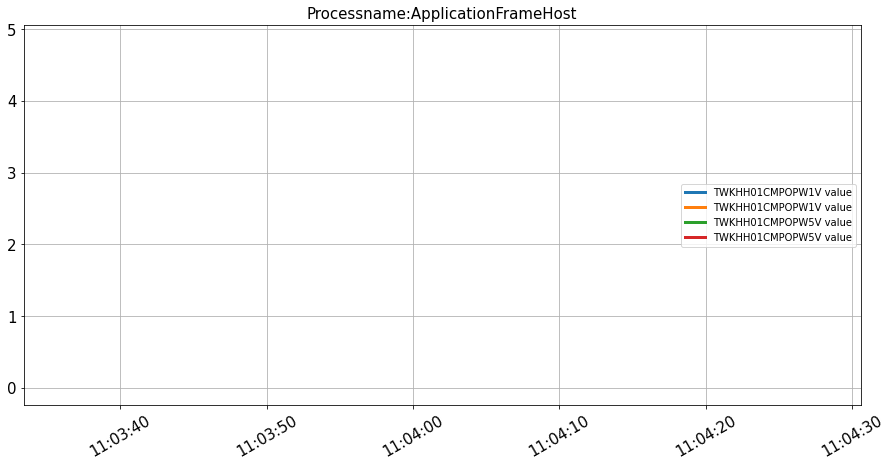

(1,)
(1,)


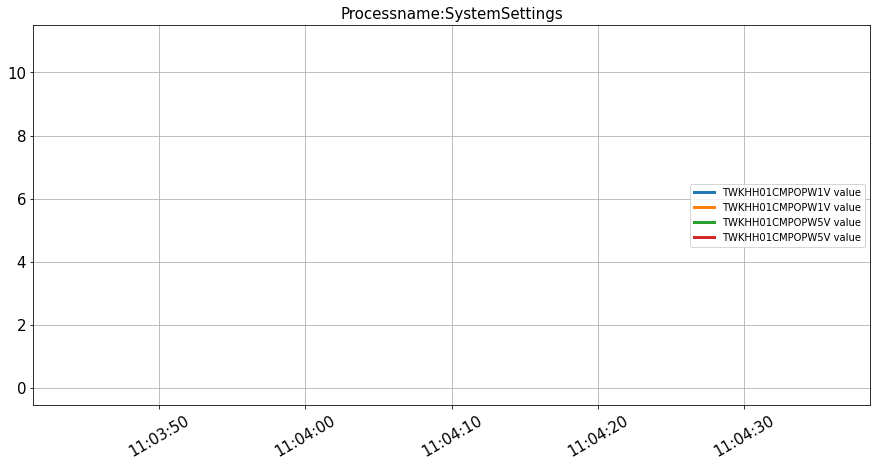

(6,)


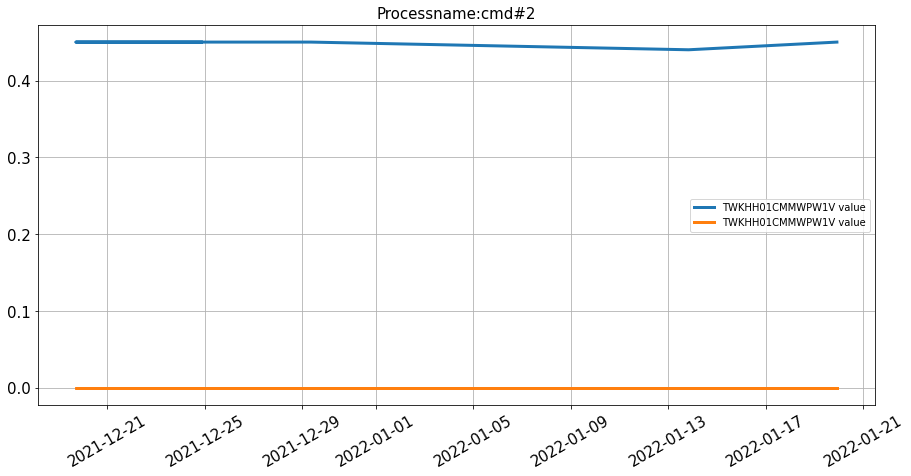

(2,)


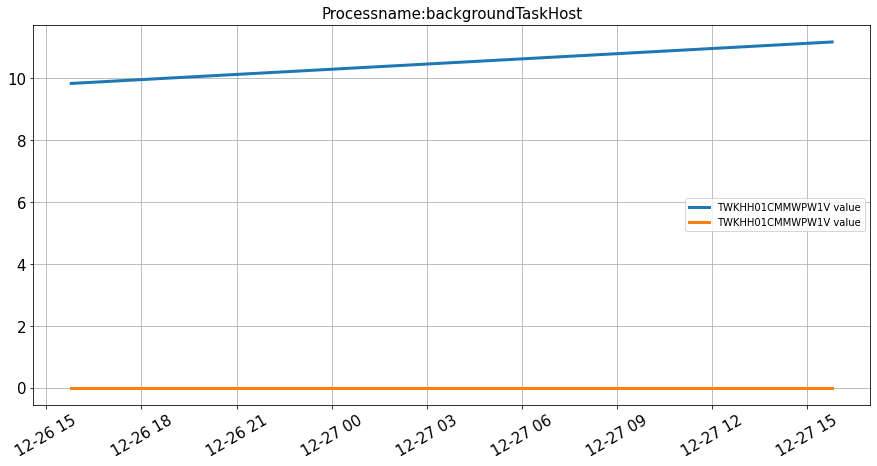

(1,)
(1,)
(1,)
(1,)


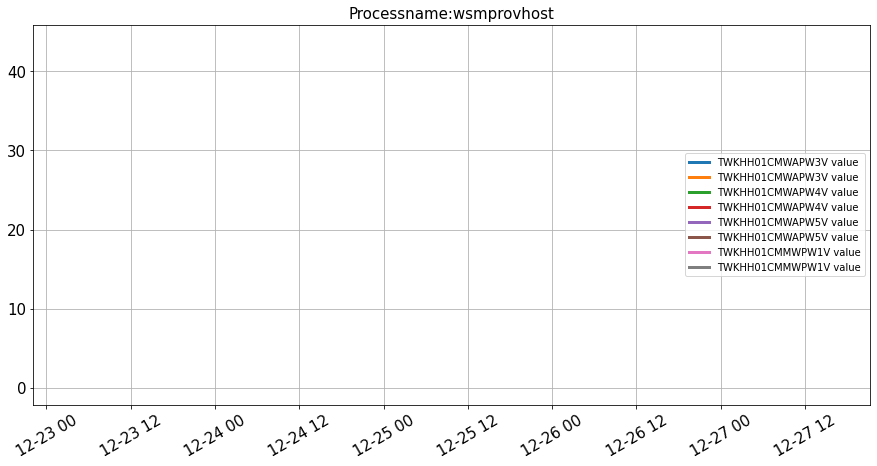

(3,)


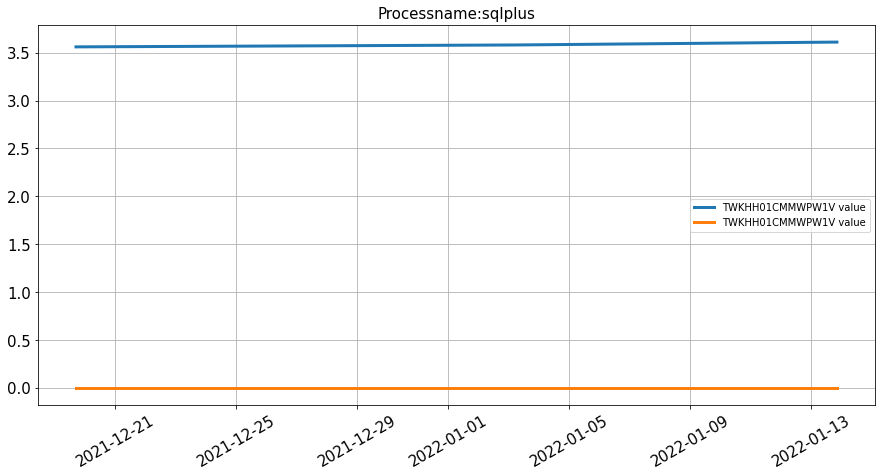

(1,)
(1,)


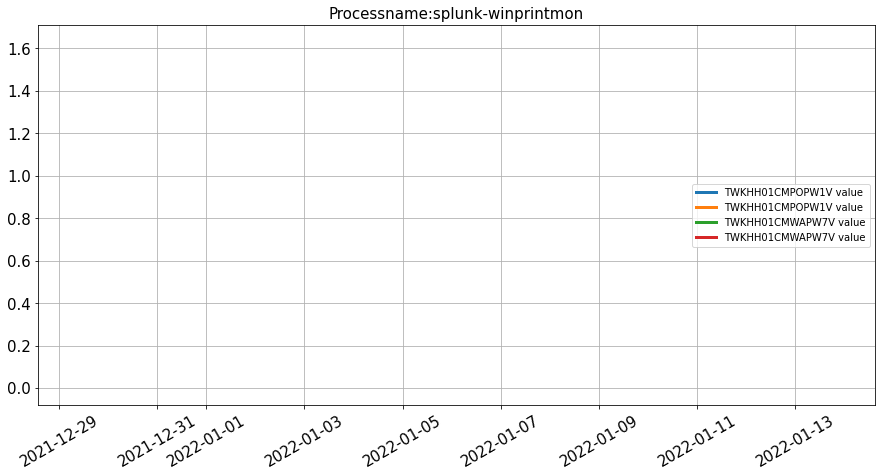

(4,)


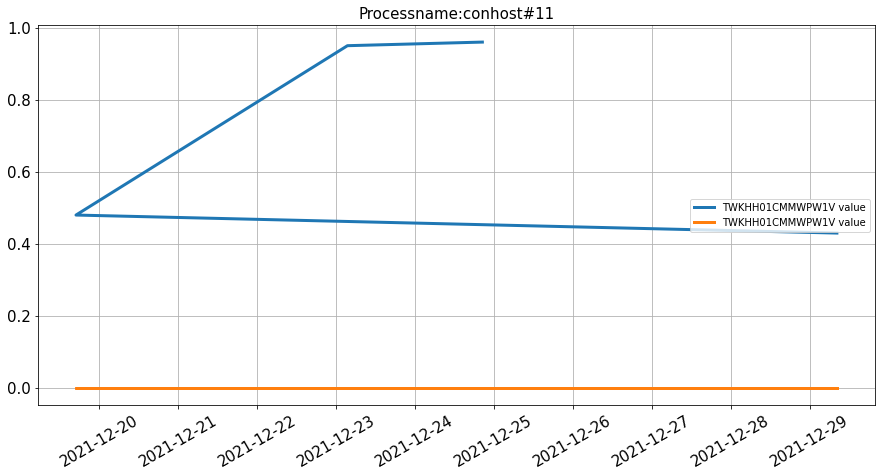

(4,)


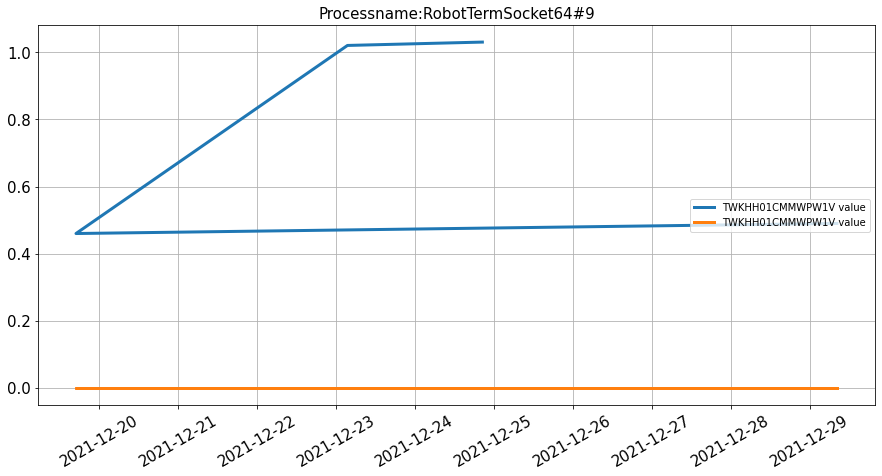

(1,)
(1,)
(1,)
(1,)
(1,)


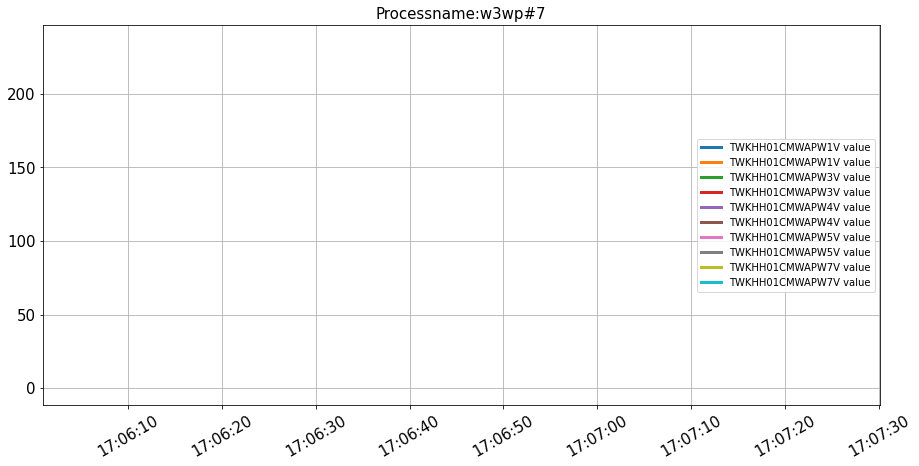

(1,)


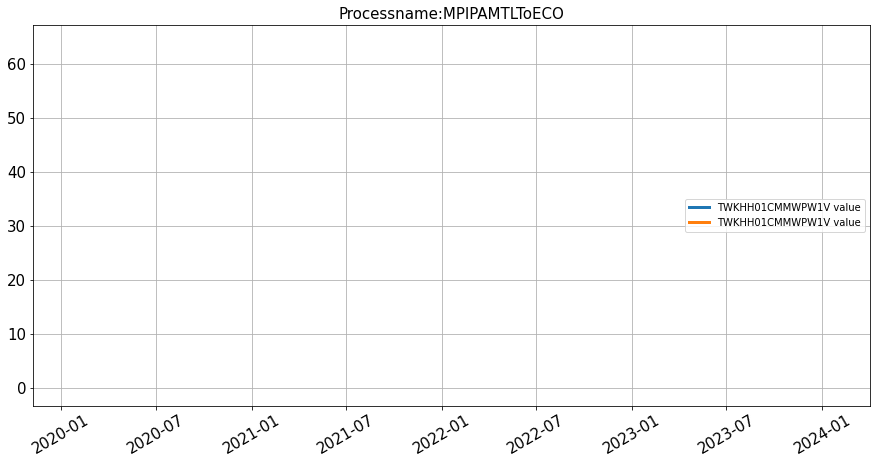

(1,)
(1,)


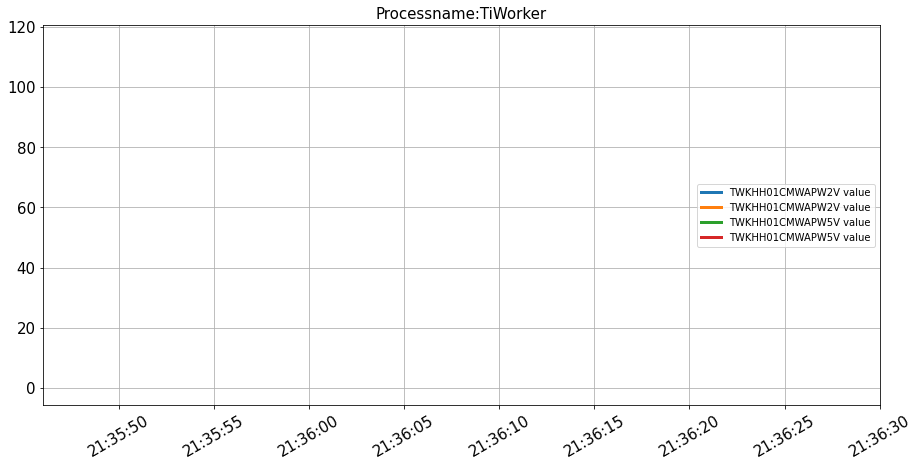

(1,)
(1,)


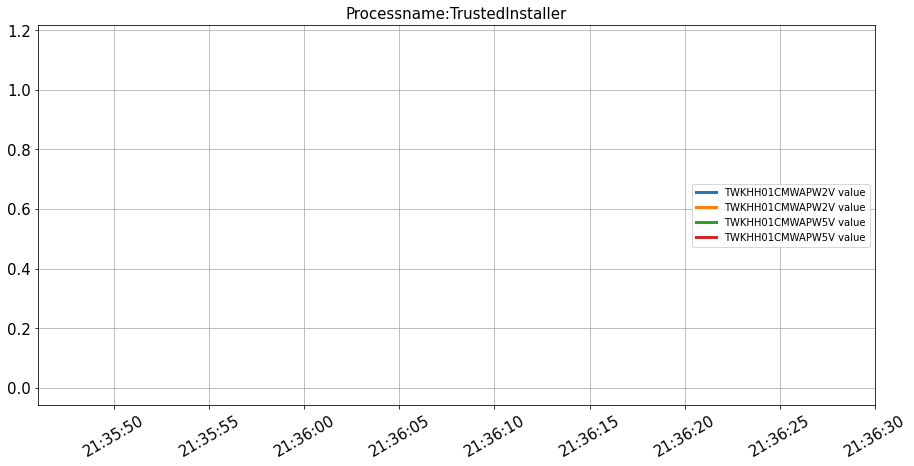

(1,)
(1,)
(11,)
(3,)
(1,)


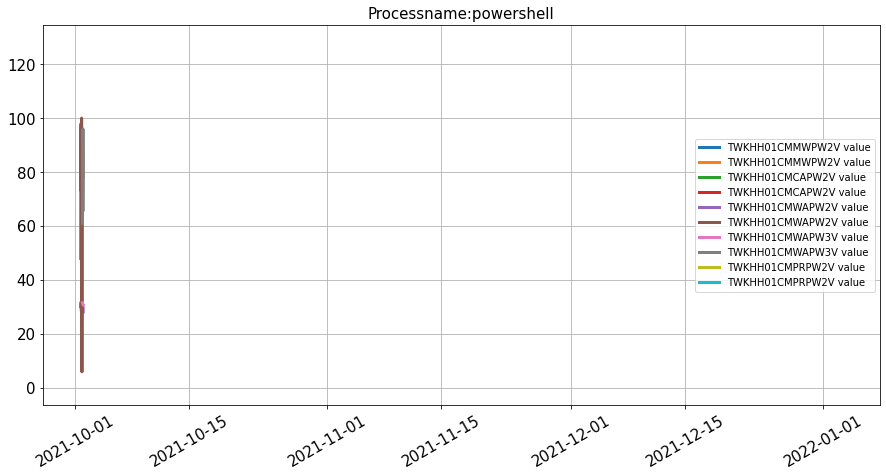

(3,)


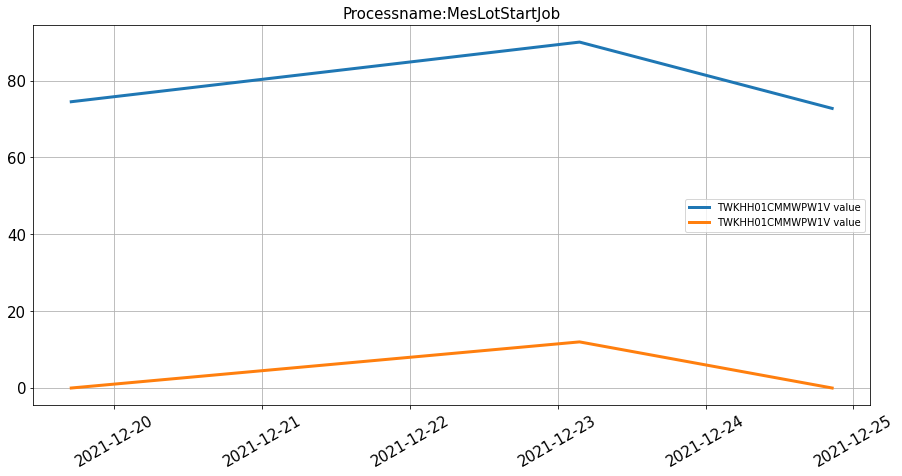

(2,)
(1,)
(2,)
(1,)
(1,)


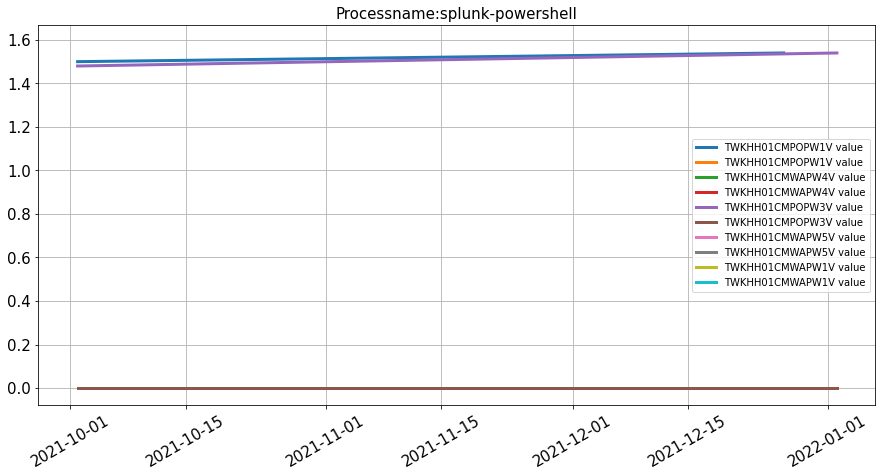

(1,)
(1,)
(1,)


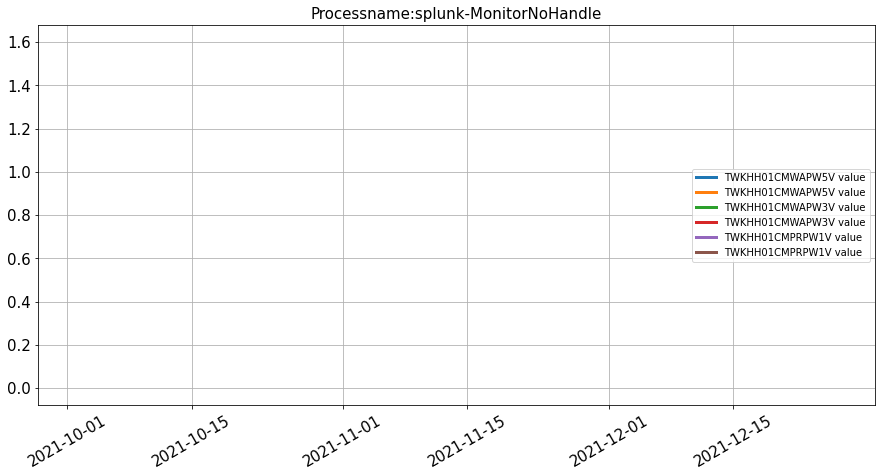

(2,)


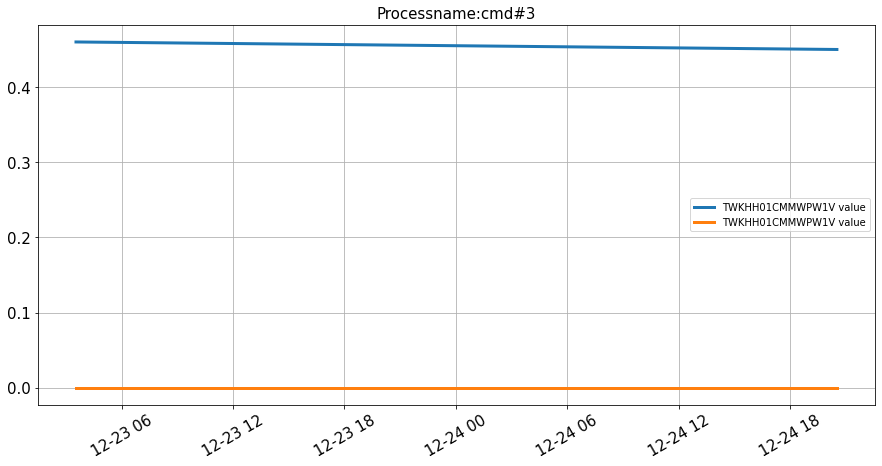

(2,)


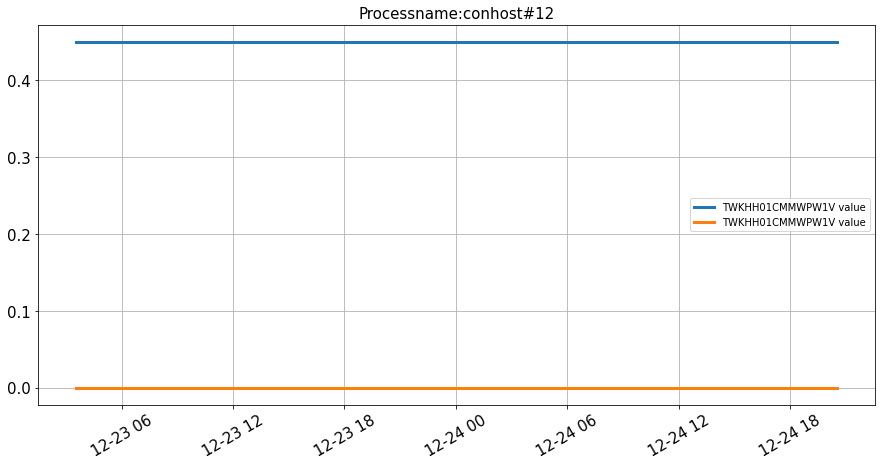

(2,)


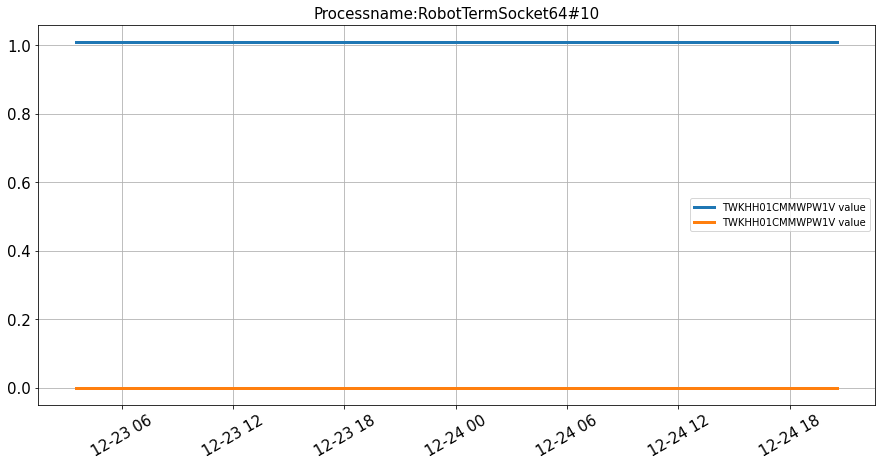

(2,)


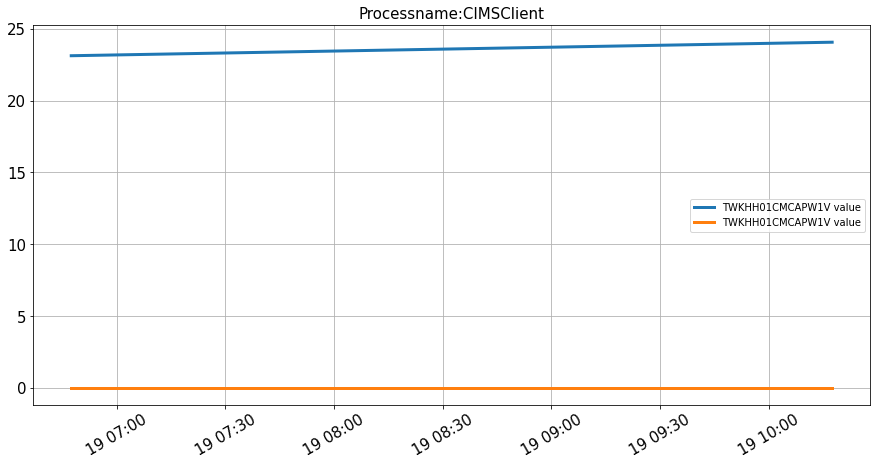

(1,)


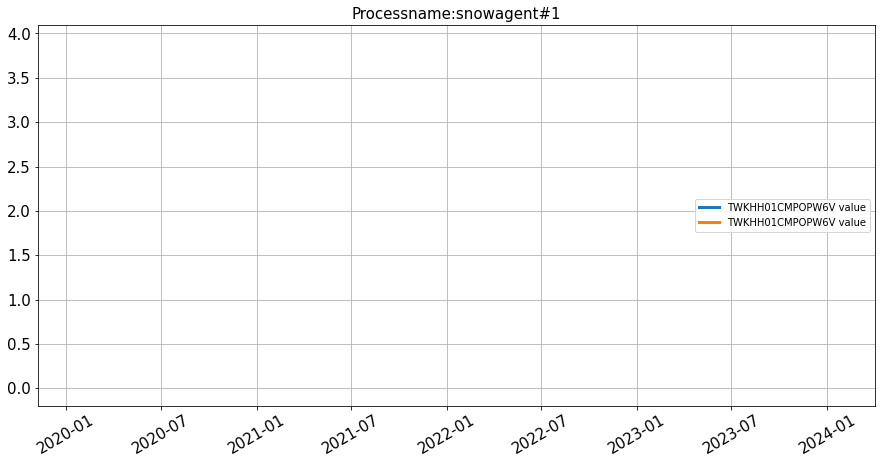

(33,)
(33,)
(33,)
(33,)
(32,)
(32,)


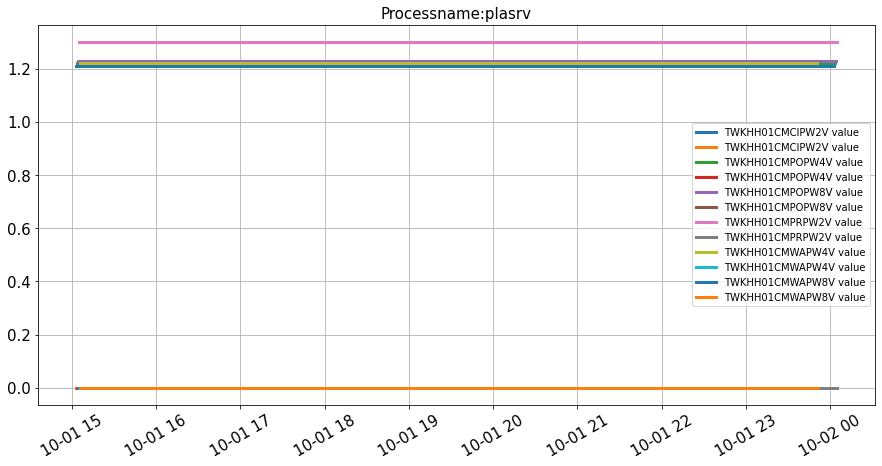

(32,)


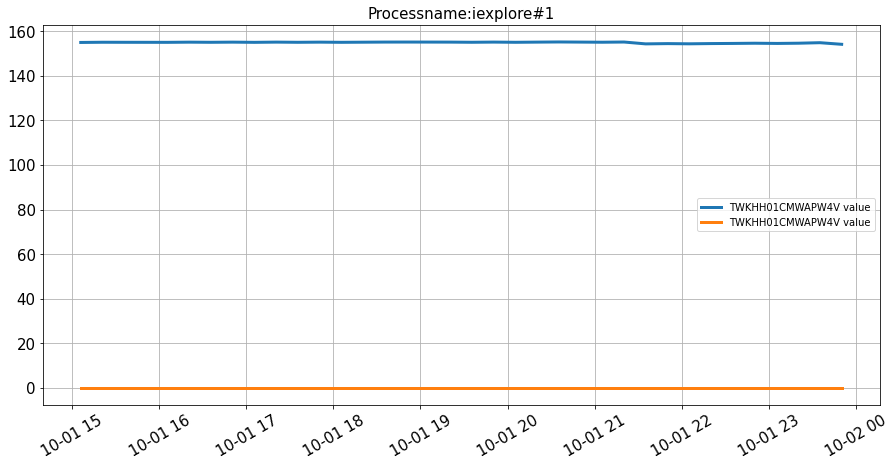

(32,)


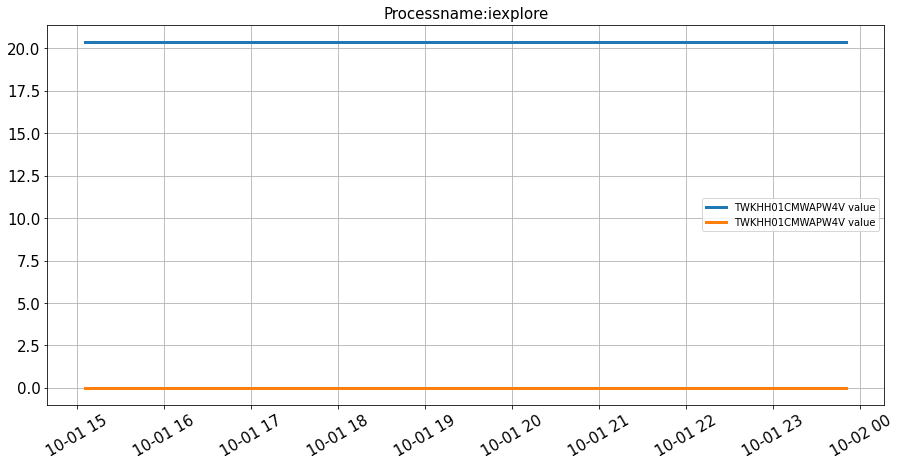

(32,)


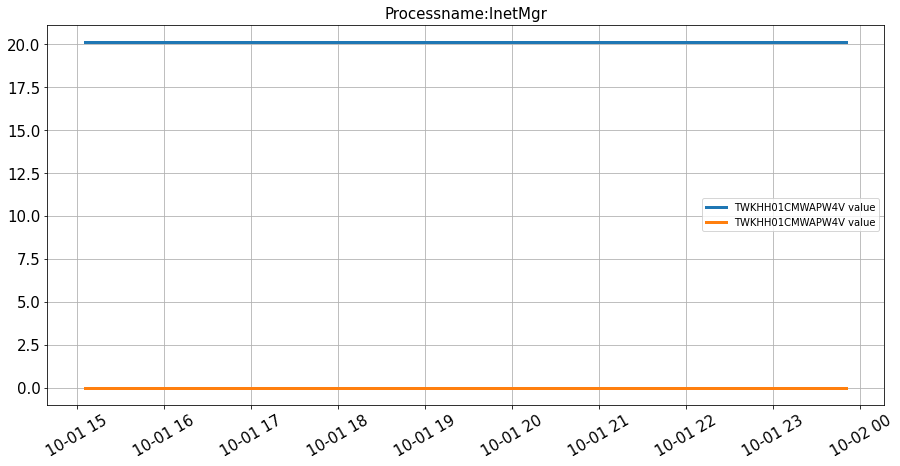

(32,)


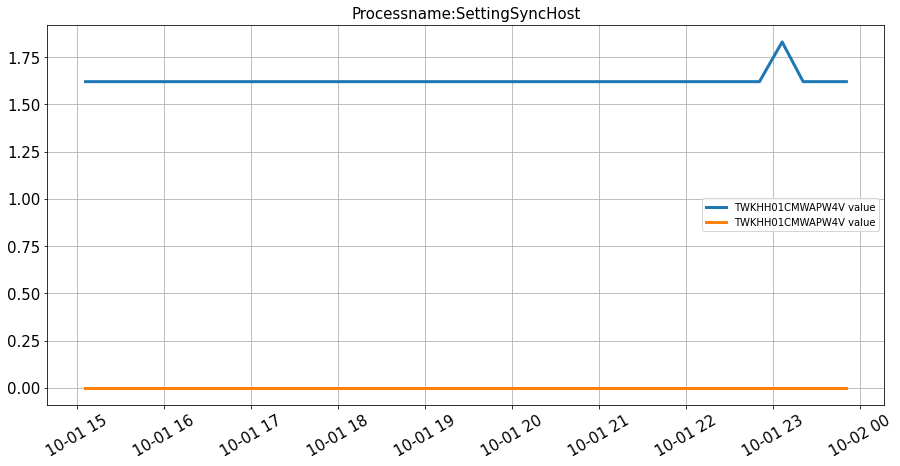

(3,)
(1,)
(2,)
(2,)
(2,)
(1,)
(2,)
(1,)
(1,)
(2,)
(2,)
(1,)
(1,)
(1,)


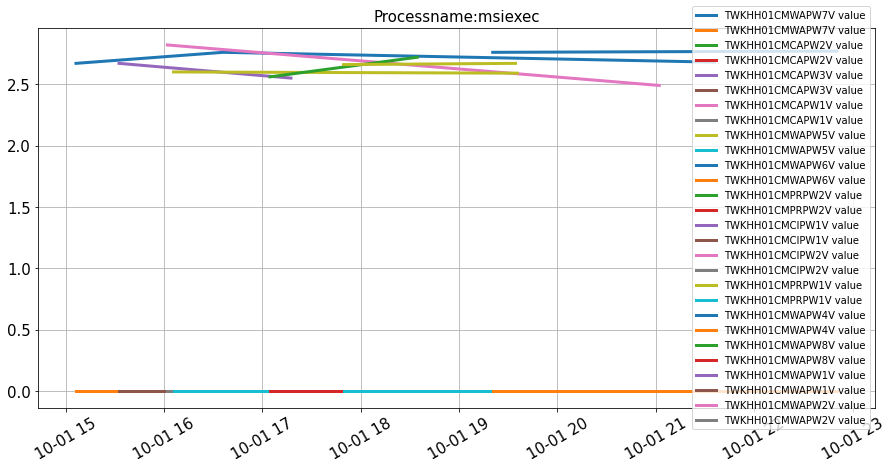

(2,)
(1,)


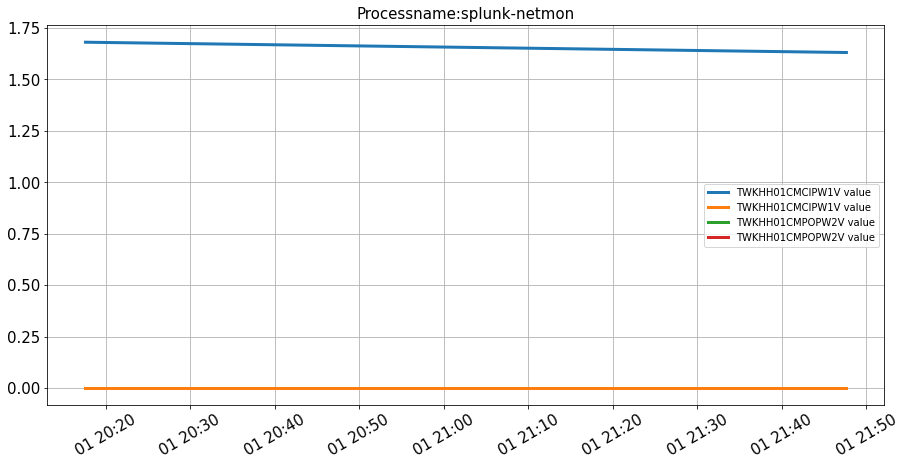

(1,)


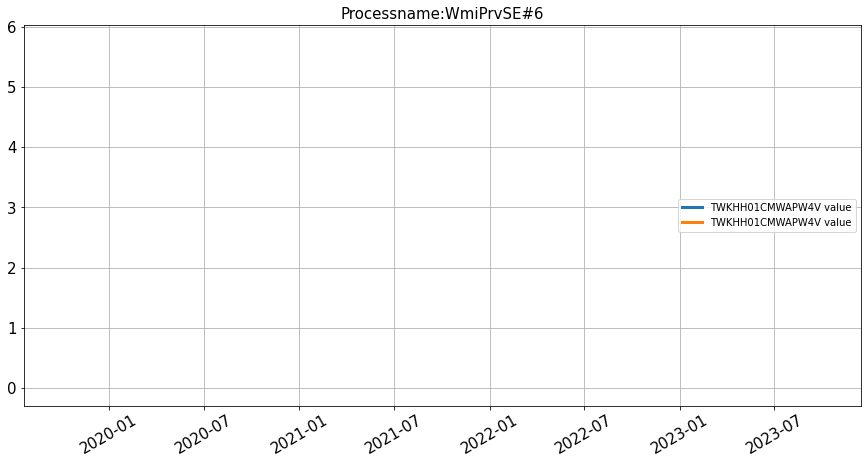

,machinename,process,mem_usage_mb,cpu_usage
dt,,,,
2022-01-09 06:17:07,TWKHH01CMMWPW1V,agentwrap,0.450000,0
2022-01-09 06:17:07,TWKHH01CMMWPW1V,Automate Schedule Agent Process,267.670013,0
2022-01-09 06:17:07,TWKHH01CMMWPW1V,Automate Schedule Agent Server,163.380005,0
2022-01-09 06:17:07,TWKHH01CMMWPW1V,CamstarRemotePurgingJob,7.880000,0
2022-01-09 06:17:08,TWKHH01CMMWPW1V,ccSvcHst,1.110000,0
...,...,...,...,...
2021-10-02 00:04:43,TWKHH01CMPRPW2V,nssm,1.470000,0
2021-10-02 00:04:43,TWKHH01CMPRPW2V,msdtc,2.340000,0
2021-10-02 00:04:43,TWKHH01CMPRPW2V,plasrv,1.300000,0


In [88]:
for pth in processmemcpu_path_list[2:3]:
    df = read_data(pth,o_dtname="recordtime",c_dtname = 'dt')
    print(pth)
    print(df.columns)
    print()
    print("Machinename",df["machinename"].unique())
    print()
    print("process",df["process"].unique())
    df_list = []
    for i,processname in enumerate(df["process"].unique()):
        
        tmp_df = df[df["process"]==processname]
        df_list.append(tmp_df)
        for machinename in tmp_df["machinename"].unique():
            print(tmp_df[tmp_df["machinename"]==machinename]["mem_usage_mb"].shape)
            plt.plot(tmp_df[tmp_df["machinename"]==machinename]["mem_usage_mb"],label="{} value".format(machinename),linewidth=3)
            plt.plot(tmp_df[tmp_df["machinename"]==machinename]["cpu_usage"],label="{} value".format(machinename),linewidth=3)
            #plt.title("Machinename:{}\nProcessname:{}".format(machinename,processname))
        plt.legend(loc="right")
        plt.title("Processname:{}".format(processname),fontsize=15)
        plt.xticks(rotation=30,fontsize=15)
        plt.yticks(fontsize=15)
        plt.grid()
        #plt.savefig("fig_{}.jpg".format(L))
        plt.savefig("./Dataset/MES_data_0126/plot/Processmemcpu_Data-fig_{}.jpg".format(i))
        figsize(15, 7) 
        
        plt.show()
        
        
    #concat_df = pd.concat(df_list,axis=1)

df

# Other

In [26]:
df["machinename"].unique()

array(['ATBKLX17', 'ATBKLX19', 'BKKAWACSSV002', 'BKKAWACSSV003',
       'BKKAWACSSV004', 'BKKAWACSSV005', 'BKKAWACSSV006', 'BKKAWACSSV007',
       'BKKMFGFSSV001', 'BKKMFGFSSV002', 'BKKMFGVM209', 'BKKMFGWBHSV001',
       'BKKMFGWBHSV002', 'BKKMFGWBHSV003', 'BKKMFGWBHSV004',
       'BKKMFGWBHSV005', 'BKKMFGWBHSV006', 'BKKMFGWBHSV007',
       'BKKMFGWBHSV008', 'BKKMFGWBHSV009', 'MFGSECGSV001',
       'MFGSQL2K8SV001', 'test'], dtype=object)

In [27]:
df["processname"].unique()

array(['Memory Used  (percentage)', 'CPU Utilization',
       'Memory Available  (percentage)', 'CPU',
       'Free disk space on C: (percentage)',
       'Free disk space on E: (percentage)',
       'Free disk space on D: (percentage)'], dtype=object)

In [5]:
for i,name in enumerate(col):
    if "Free disk space" in name:
        print("{}: {}".format(i,name))

NameError: name 'col' is not defined

CPU utilization (%)
                     CPU utilization (%)
dt                                      
2022-01-06 10:56:40              77.2632
2022-01-06 10:53:40              77.5085
2022-01-06 10:50:40              77.0757
2022-01-06 10:47:40              75.4245
2022-01-06 10:44:40              76.6730


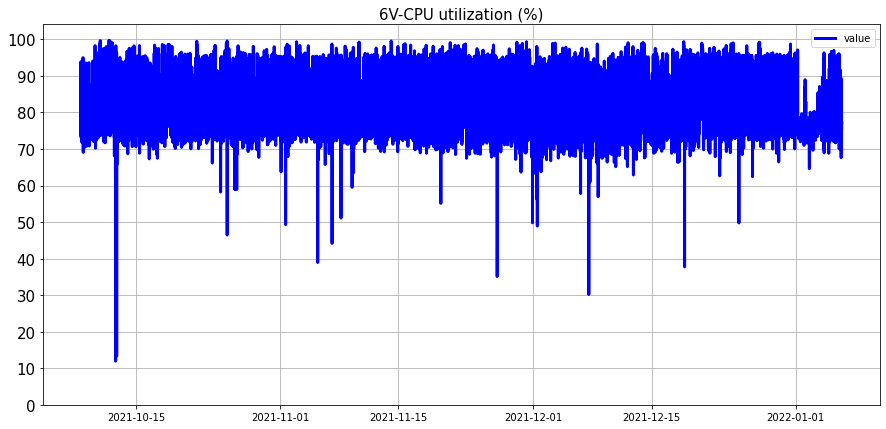

Disk (0 C:) - % Disk saturation
                     Disk (0 C:) - % Disk saturation
dt                                                  
2022-01-06 10:55:22                           0.7233
2022-01-06 10:50:22                           0.4089
2022-01-06 10:45:22                           0.0064
2022-01-06 10:40:22                           0.3766
2022-01-06 10:35:22                           0.0902


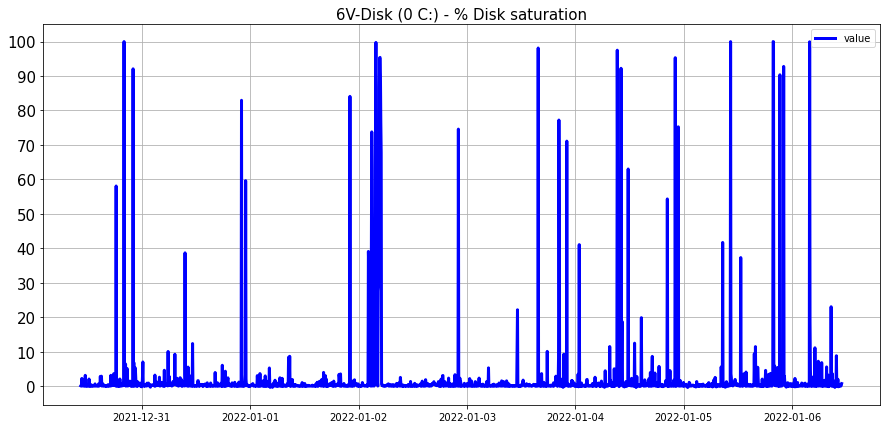

Disk (0 C:) - % Idle Time
                     Disk (0 C:) - % Idle Time
dt                                            
2022-01-06 10:53:33                    99.2767
2022-01-06 10:48:33                    99.5911
2022-01-06 10:43:33                    99.9936
2022-01-06 10:38:33                    99.6234
2022-01-06 10:33:32                    99.9098


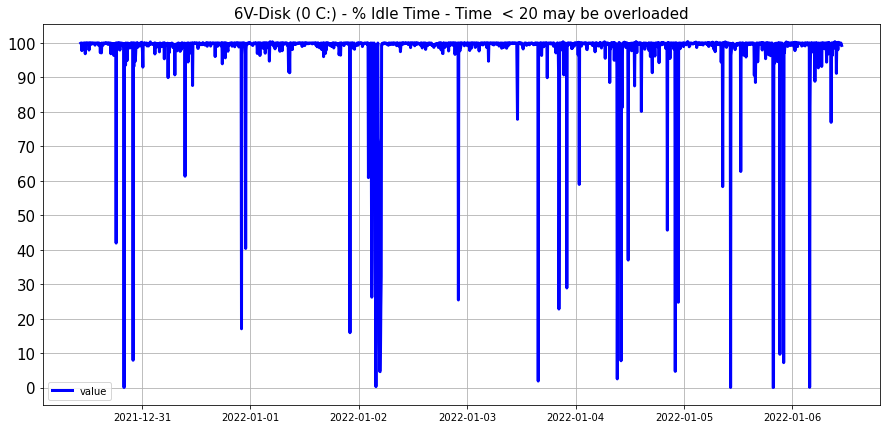

Disk (0 C:) - Average Disk Bytes Read
                     Disk (0 C:) - Average Disk Bytes Read
dt                                                        
2022-01-06 10:53:54                                    0.0
2022-01-06 10:48:53                                    0.0
2022-01-06 10:43:54                                    0.0
2022-01-06 10:38:54                                    0.0
2022-01-06 10:33:54                                    0.0


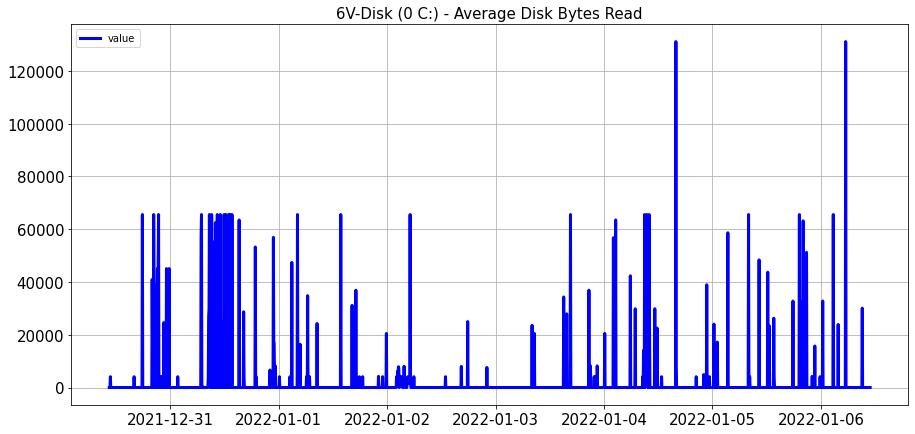

Disk (0 C:) - Average Disk Bytes Total
                     Disk (0 C:) - Average Disk Bytes Total
dt                                                         
2022-01-06 10:55:20                               4096.0000
2022-01-06 10:50:20                               4022.8571
2022-01-06 10:45:20                                  0.0000
2022-01-06 10:40:20                               8192.0000
2022-01-06 10:35:20                                  0.0000


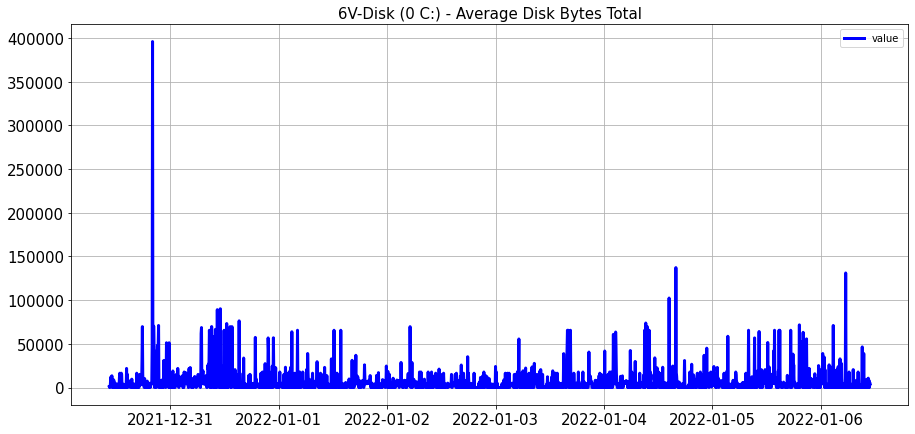

Disk (0 C:) - Average Disk Bytes Write
                     Disk (0 C:) - Average Disk Bytes Write
dt                                                         
2022-01-06 10:53:54                               4096.0000
2022-01-06 10:48:53                               4022.8571
2022-01-06 10:43:54                                  0.0000
2022-01-06 10:38:54                               8192.0000
2022-01-06 10:33:54                                  0.0000


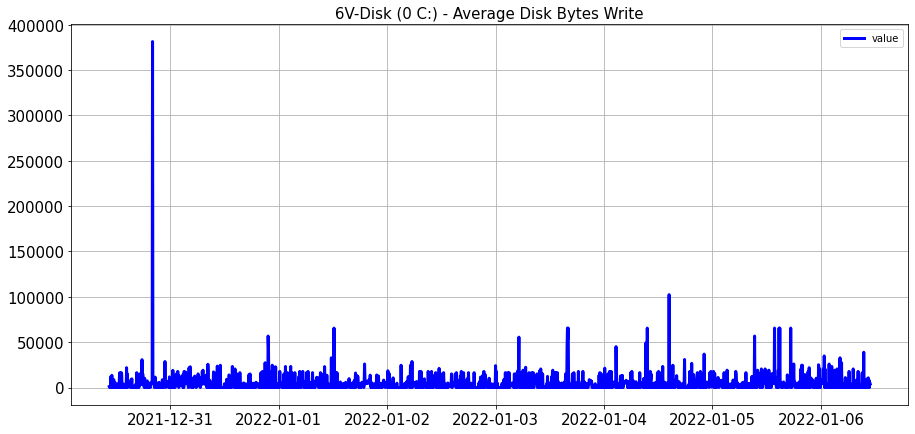

Disk (0 C:) - Avg. Disk Queue Length
                     Disk (0 C:) - Avg. Disk Queue Length
dt                                                       
2022-01-06 10:52:59                                0.0029
2022-01-06 10:48:00                                0.0014
2022-01-06 10:42:59                                0.0000
2022-01-06 10:38:00                                0.0030
2022-01-06 10:32:59                                0.0158


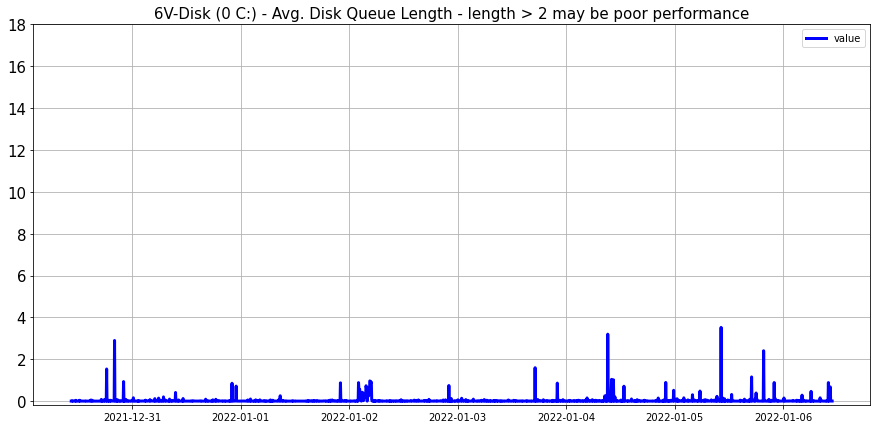

Disk (0 C:) - Avg. Disk sec/Read (Latency)
                     Disk (0 C:) - Avg. Disk sec/Read (Latency)
dt                                                             
2022-01-06 10:53:54                                         0.0
2022-01-06 10:48:53                                         0.0
2022-01-06 10:43:54                                         0.0
2022-01-06 10:38:54                                         0.0
2022-01-06 10:33:54                                         0.0


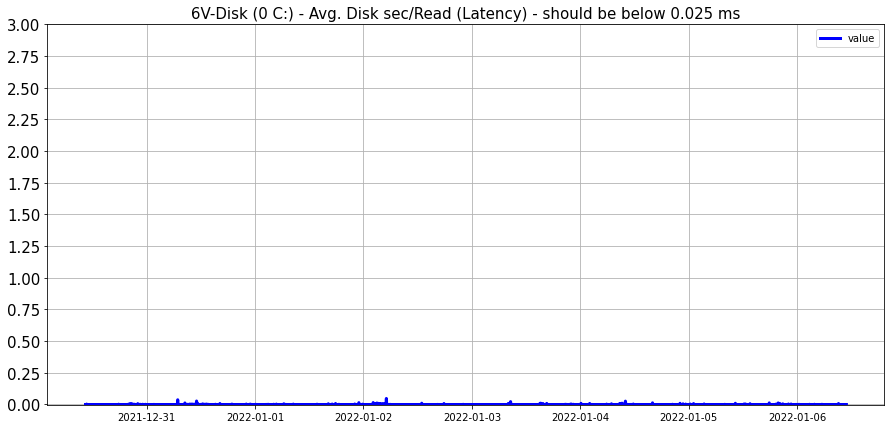

Disk (0 C:) - Avg. Disk sec/Transfer (Latency)
                     Disk (0 C:) - Avg. Disk sec/Transfer (Latency)
dt                                                                 
2022-01-06 10:53:54                                          0.0030
2022-01-06 10:48:53                                          0.0069
2022-01-06 10:43:54                                          0.0000
2022-01-06 10:38:54                                          0.0020
2022-01-06 10:33:54                                          0.0000


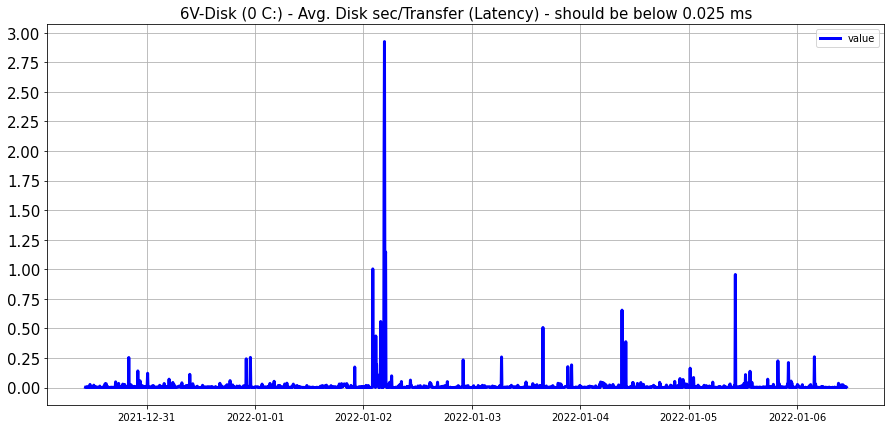

Disk (0 C:) - Avg. Disk sec/Write (Latency)
                     Disk (0 C:) - Avg. Disk sec/Write (Latency)
dt                                                              
2022-01-06 10:53:54                                       0.0012
2022-01-06 10:48:53                                       0.0008
2022-01-06 10:43:54                                       0.0000
2022-01-06 10:38:54                                       0.0019
2022-01-06 10:33:54                                       0.0000


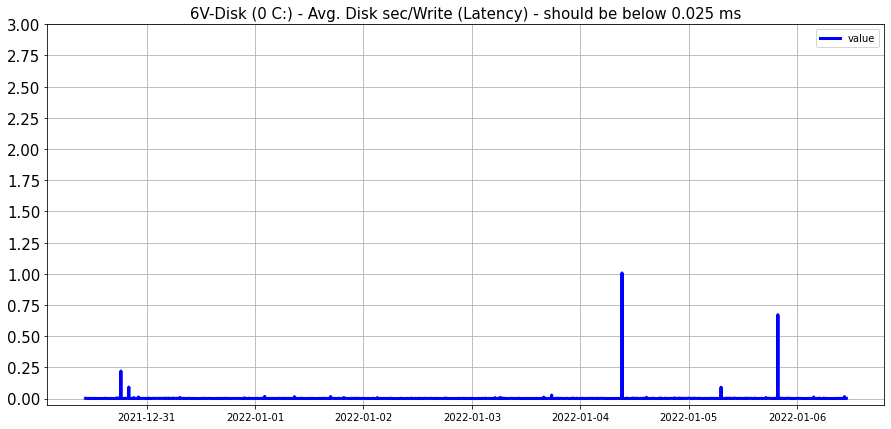

Disk (0 C:) - Current Disk Queue Length
                     Disk (0 C:) - Current Disk Queue Length
dt                                                          
2022-01-06 10:53:54                                      0.0
2022-01-06 10:48:53                                      0.0
2022-01-06 10:43:54                                      0.0
2022-01-06 10:38:54                                      0.0
2022-01-06 10:33:54                                      0.0


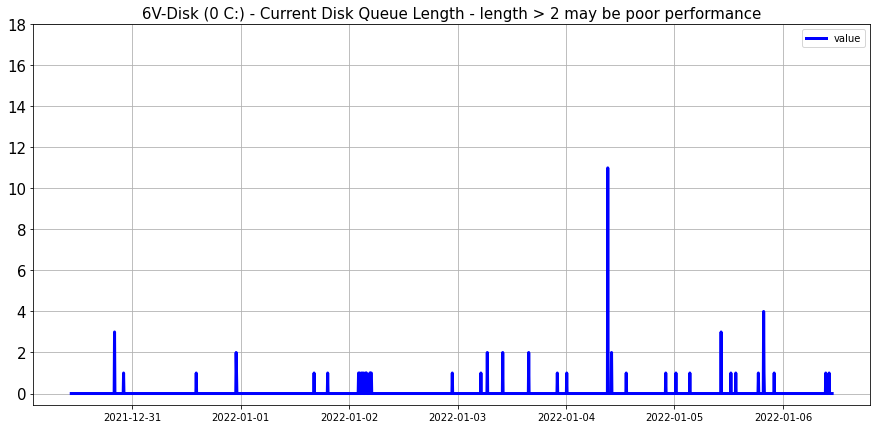

Disk (1 D:) - % Disk saturation
                     Disk (1 D:) - % Disk saturation
dt                                                  
2022-01-06 10:55:23                           0.5132
2022-01-06 10:50:24                           0.2454
2022-01-06 10:45:23                           0.2145
2022-01-06 10:40:23                           0.2230
2022-01-06 10:35:23                           0.0009


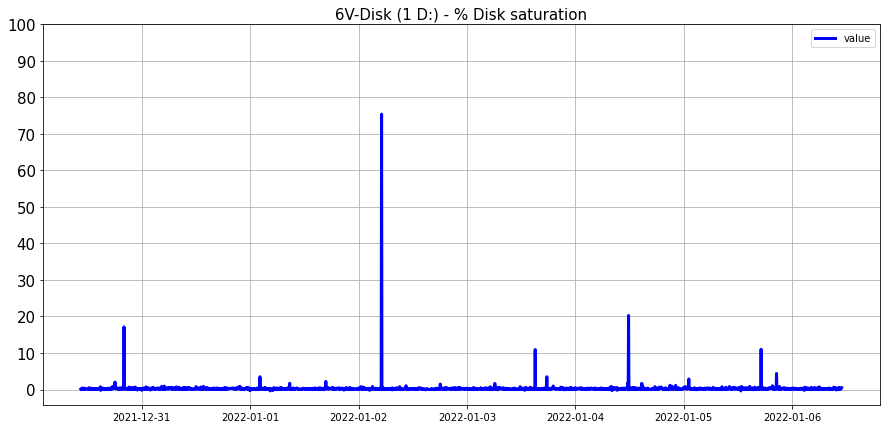

Disk (1 D:) - % Idle Time
                     Disk (1 D:) - % Idle Time
dt                                            
2022-01-06 10:53:54                    99.4868
2022-01-06 10:48:53                    99.7546
2022-01-06 10:43:54                    99.7855
2022-01-06 10:38:54                    99.7770
2022-01-06 10:33:54                    99.9991


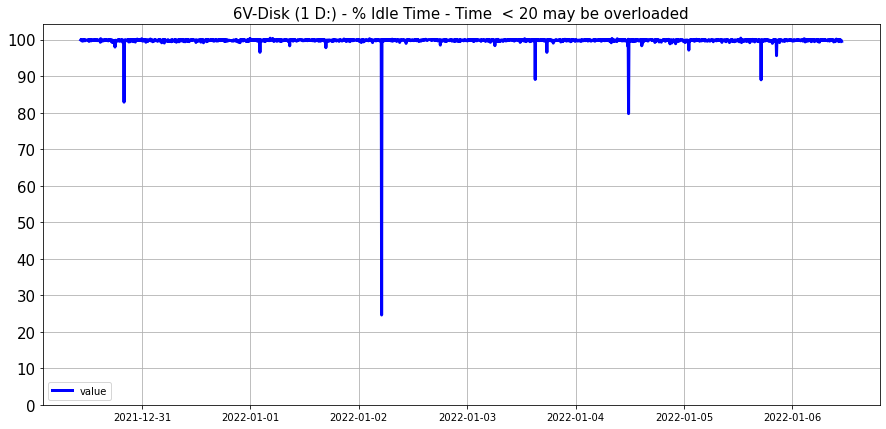

Disk (1 D:) - Average Disk Bytes Read
                     Disk (1 D:) - Average Disk Bytes Read
dt                                                        
2022-01-06 10:53:54                                    0.0
2022-01-06 10:48:53                                    0.0
2022-01-06 10:43:54                                    0.0
2022-01-06 10:38:54                                    0.0
2022-01-06 10:33:54                                    0.0


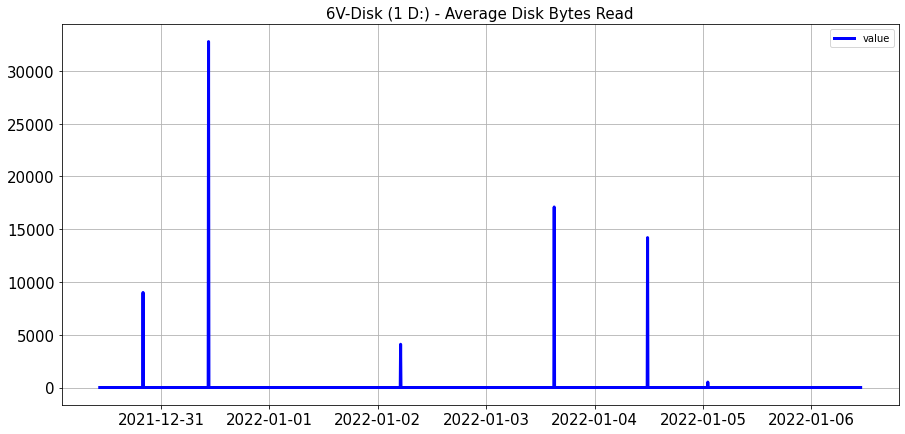

Disk (1 D:) - Average Disk Bytes Total
                     Disk (1 D:) - Average Disk Bytes Total
dt                                                         
2022-01-06 10:55:21                                  4096.0
2022-01-06 10:50:21                                  6656.0
2022-01-06 10:45:21                                  5120.0
2022-01-06 10:40:21                                  7680.0
2022-01-06 10:35:21                                     0.0


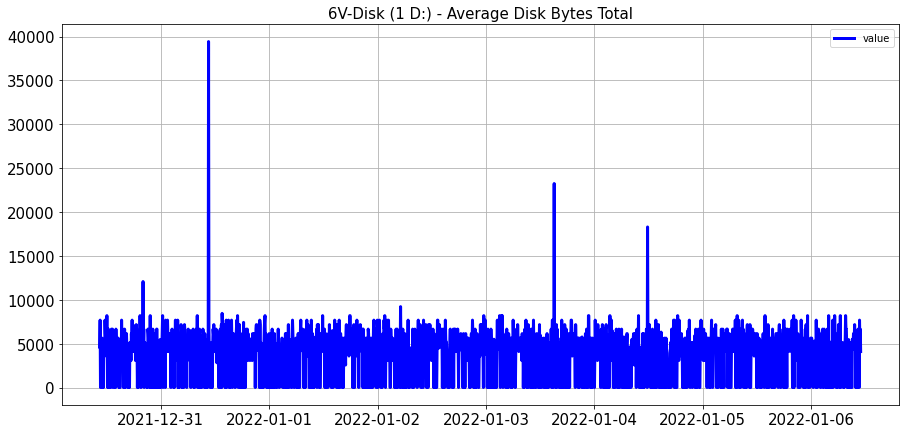

Disk (1 D:) - Average Disk Bytes Write
                     Disk (1 D:) - Average Disk Bytes Write
dt                                                         
2022-01-06 10:53:54                                  4096.0
2022-01-06 10:48:53                                  6656.0
2022-01-06 10:43:54                                  5120.0
2022-01-06 10:38:54                                  7680.0
2022-01-06 10:33:54                                     0.0


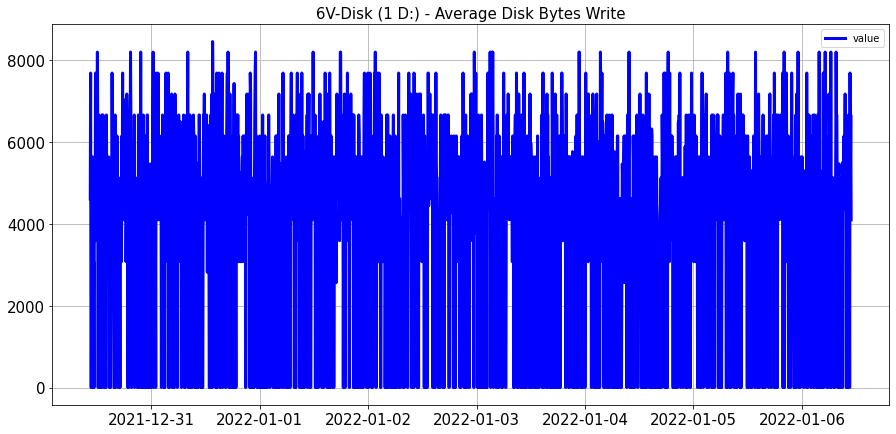

Disk (1 D:) - Avg. Disk Queue Length
                     Disk (1 D:) - Avg. Disk Queue Length
dt                                                       
2022-01-06 10:53:54                                0.0051
2022-01-06 10:48:53                                0.0022
2022-01-06 10:43:54                                0.0021
2022-01-06 10:38:54                                0.0022
2022-01-06 10:33:54                                0.0000


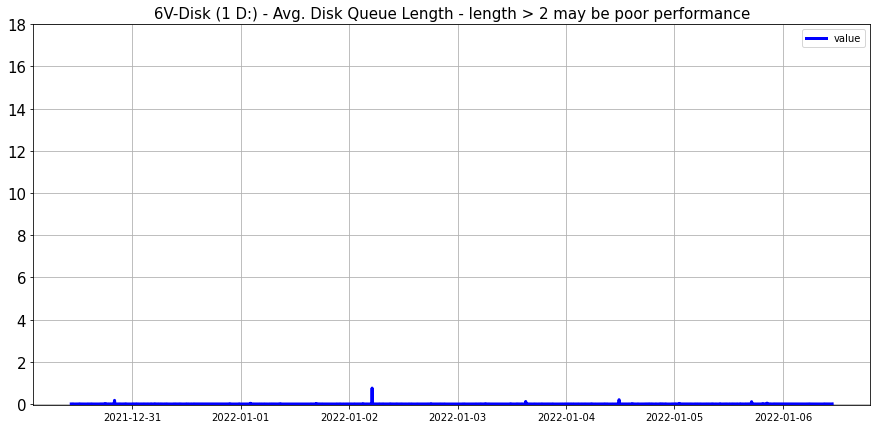

Disk (1 D:) - Avg. Disk sec/Read (Latency)
                     Disk (1 D:) - Avg. Disk sec/Read (Latency)
dt                                                             
2022-01-06 10:53:54                                         0.0
2022-01-06 10:48:53                                         0.0
2022-01-06 10:43:54                                         0.0
2022-01-06 10:38:54                                         0.0
2022-01-06 10:33:54                                         0.0


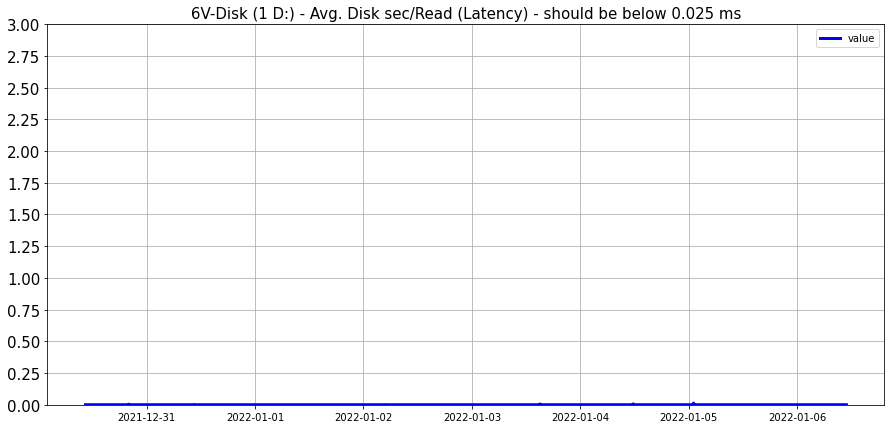

Disk (1 D:) - Avg. Disk sec/Transfer (Latency)
                     Disk (1 D:) - Avg. Disk sec/Transfer (Latency)
dt                                                                 
2022-01-06 10:53:54                                           0.004
2022-01-06 10:48:53                                           0.001
2022-01-06 10:43:54                                           0.001
2022-01-06 10:38:54                                           0.001
2022-01-06 10:33:54                                           0.000


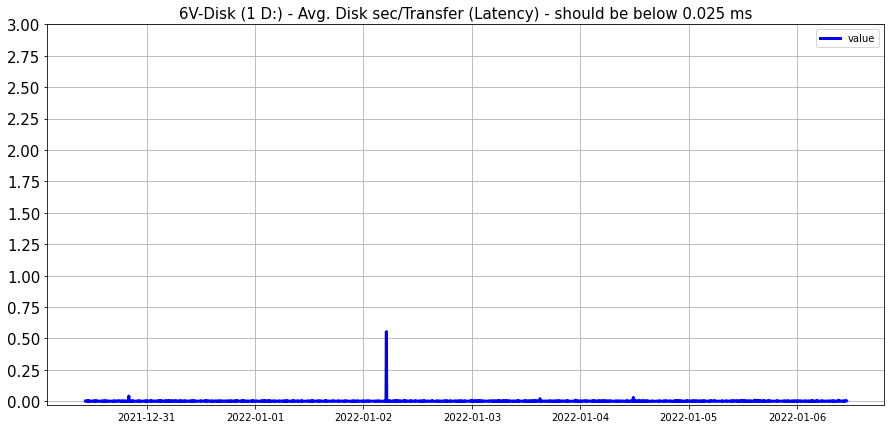

Disk (1 D:) - Avg. Disk sec/Write (Latency)
                     Disk (1 D:) - Avg. Disk sec/Write (Latency)
dt                                                              
2022-01-06 10:53:54                                       0.0013
2022-01-06 10:48:53                                       0.0022
2022-01-06 10:43:54                                       0.0021
2022-01-06 10:38:54                                       0.0022
2022-01-06 10:33:54                                       0.0000


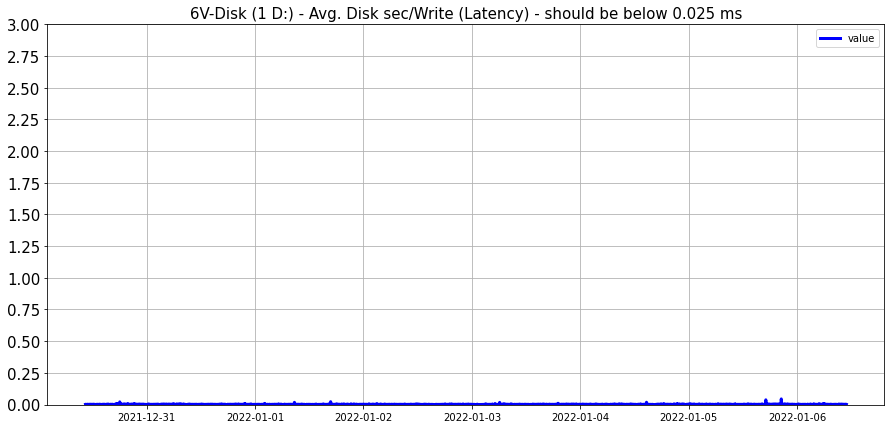

Disk (1 D:) - Current Disk Queue Length
                     Disk (1 D:) - Current Disk Queue Length
dt                                                          
2022-01-06 10:53:54                                      0.0
2022-01-06 10:48:53                                      0.0
2022-01-06 10:43:54                                      0.0
2022-01-06 10:38:54                                      0.0
2022-01-06 10:33:54                                      0.0


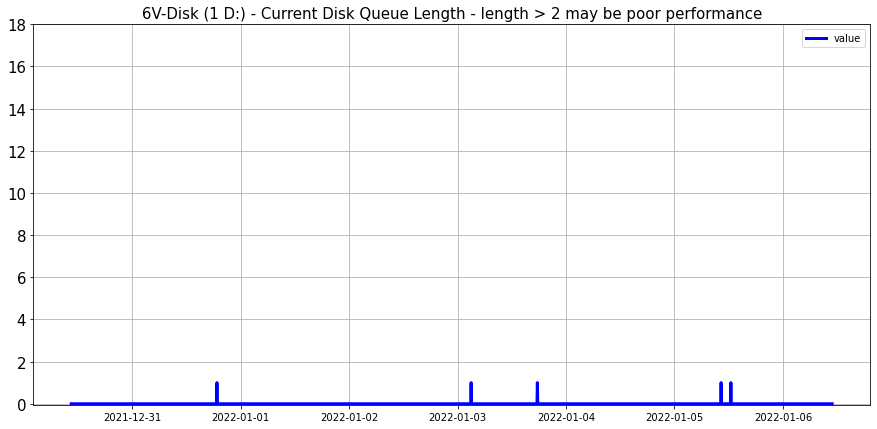

Free disk space on C: (%)
Free disk space on D: (%)
Memory used  (%)
                     Memory used  (%)
dt                                   
2022-01-06 10:56:45           75.7994
2022-01-06 10:53:45           75.7108
2022-01-06 10:50:45           75.6819
2022-01-06 10:47:45           76.7359
2022-01-06 10:44:45           75.6065


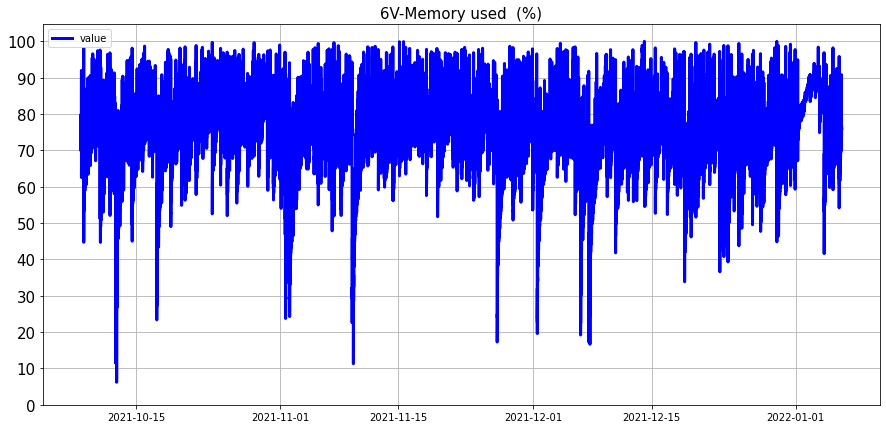

In [ ]:
from IPython.display import clear_output

col = np.unique(df.name.values)
i=1
df_list = []
notice = ""
for col_name in col:
    
    filename = col_name.replace("."," ")
    filename = filename.replace("/"," ")
    filename = filename.replace("%","percent ")
    filename = filename.replace(":"," disk")
    print(col_name)
    
    if "Free disk space" in col_name:
        continue
    
    tmp_df = df[df["name"]==col_name].drop(["host","name"],axis=1)
    tmp_df = tmp_df.rename(columns={'value':col_name })
    print(tmp_df.head())
    df_list.append(tmp_df)
    plt.plot(tmp_df.loc[:,col_name],label="value",linewidth=3,color='blue')
    
    
    if "Idle Time" in col_name:
        notice=" - Time  < 20 may be overloaded"
        
    if "Queue Length" in col_name:
        notice=" - length > 2 may be poor performance"
    
    if "Latency" in col_name:
        notice=" - should be below 0.025 ms"
        
    plt.title("6V-{}{}".format(col_name,notice),fontsize=15)
    plt.legend()
    if "%" in col_name:
        plt.yticks(range(0,110,10),fontsize=15)
    elif "Queue" in col_name:
        plt.yticks(range(0,20,2),fontsize=15)
    elif "Latency" in col_name:
        plt.yticks(np.arange(0,3.25,0.25),fontsize=15)
    else:   
        plt.xticks(fontsize=15)
        plt.yticks(fontsize=15)
    
    #Server_mantain/Zabbix_Online_detection/Dataset/OPTIdata/all_vector_analysis
    plt.grid()
    plt.savefig("./Dataset/OPTIdata/diskio_vector_analysis/new{}-6V-diskio_vector_0106.jpg".format(filename))
    notice=""
    
    plt.show()
    #clear_output(wait=True)
    
concat_df = pd.concat(df_list,axis=1)
concat_df.fillna(method='ffill', inplace=True)
concat_df.fillna(method='bfill', inplace=True)



In [14]:
concat_df.loc["2021-10-23":].to_csv("test.csv")

In [8]:
for name in concat_df.columns[0]:
    
    filename = name.replace("."," ")
    filename = filename.replace("/"," ")
    filename = filename.replace("%","percent ")
    filename = filename.replace(":"," disk")
    plt.plot(concat_df[name].loc["2021-10-23":].resample("h").mean(),label=name,linewidth=3)
    plt.title("6V-{}".format(name),fontsize=20)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.legend()
    #Server_mantain/Zabbix_Online_detection/Dataset/OPTIdata/all_vector_analysis
    plt.savefig("./Dataset/OPTIdata/diskio_vector_analysis/{}-6V-diskio.jpg".format(filename))
    clear_output(wait=True)
    plt.show()

KeyError: 'C'

In [22]:
concat_df

,CPU utilization (%),Disk (0 C:) - % Disk saturation,Disk (0 C:) - % Idle Time,Disk (0 C:) - Average Disk Bytes Read,Disk (0 C:) - Average Disk Bytes Total,Disk (0 C:) - Average Disk Bytes Write,Disk (0 C:) - Avg. Disk Queue Length,Disk (0 C:) - Avg. Disk sec/Read (Latency),Disk (0 C:) - Avg. Disk sec/Transfer (Latency),Disk (0 C:) - Avg. Disk sec/Write (Latency),...,Disk (1 D:) - % Idle Time,Disk (1 D:) - Average Disk Bytes Read,Disk (1 D:) - Average Disk Bytes Total,Disk (1 D:) - Average Disk Bytes Write,Disk (1 D:) - Avg. Disk Queue Length,Disk (1 D:) - Avg. Disk sec/Read (Latency),Disk (1 D:) - Avg. Disk sec/Transfer (Latency),Disk (1 D:) - Avg. Disk sec/Write (Latency),Disk (1 D:) - Current Disk Queue Length,Memory used (%)
dt,,,,,,,,,,,,,,,,,,,,,
2021-10-08 10:29:40,73.5222,0.0612,99.9388,0.0,1024.0,1024.0,0.0013,0.0,0.001,0.0013,...,99.8687,0.0,4608.0,4608.0,0.0028,0.0,0.002,0.0014,0.0,72.5208
2021-10-08 10:29:45,73.5222,0.0612,99.9388,0.0,1024.0,1024.0,0.0013,0.0,0.001,0.0013,...,99.8687,0.0,4608.0,4608.0,0.0028,0.0,0.002,0.0014,0.0,72.5208
2021-10-08 10:32:40,75.0077,0.0612,99.9388,0.0,1024.0,1024.0,0.0013,0.0,0.001,0.0013,...,99.8687,0.0,4608.0,4608.0,0.0028,0.0,0.002,0.0014,0.0,72.5208
2021-10-08 10:32:45,75.0077,0.0612,99.9388,0.0,1024.0,1024.0,0.0013,0.0,0.001,0.0013,...,99.8687,0.0,4608.0,4608.0,0.0028,0.0,0.002,0.0014,0.0,72.7188
2021-10-08 10:35:40,74.7972,0.0612,99.9388,0.0,1024.0,1024.0,0.0013,0.0,0.001,0.0013,...,99.8687,0.0,4608.0,4608.0,0.0028,0.0,0.002,0.0014,0.0,72.7188
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-01-06 10:55:21,77.5085,0.4089,99.2767,0.0,4096.0,4096.0,0.0029,0.0,0.003,0.0012,...,99.4868,0.0,4096.0,4096.0,0.0051,0.0,0.004,0.0013,0.0,75.7108
2022-01-06 10:55:22,77.5085,0.7233,99.2767,0.0,4096.0,4096.0,0.0029,0.0,0.003,0.0012,...,99.4868,0.0,4096.0,4096.0,0.0051,0.0,0.004,0.0013,0.0,75.7108
2022-01-06 10:55:23,77.5085,0.7233,99.2767,0.0,4096.0,4096.0,0.0029,0.0,0.003,0.0012,...,99.4868,0.0,4096.0,4096.0,0.0051,0.0,0.004,0.0013,0.0,75.7108


C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\pyts\bag_of_words\bow.py:243: FutureWarning: BagOfWords has been reworked in 0.11 in order to match its definition in the literature. To get the old BagOfWords, use pyts.bag_of_words.WordExtractor instead.
  warnings.warn("BagOfWords has been reworked in 0.11 in order to match "


(50, 150)


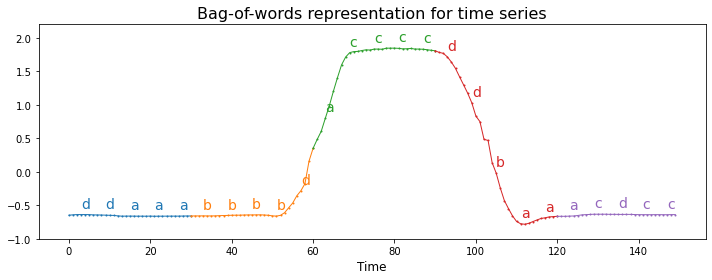

In [20]:
# Author: Johann Faouzi <johann.faouzi@gmail.com>
# License: BSD-3-Clause

import matplotlib.pyplot as plt
import numpy as np
from pyts.bag_of_words import BagOfWords
from pyts.datasets import load_gunpoint

# Load the dataset and perform the transformation
X, _, _, _ = load_gunpoint(return_X_y=True)
window_size, word_size = 30, 5
bow = BagOfWords(window_size=window_size, word_size=word_size,
                 window_step=window_size, numerosity_reduction=False)
print(X.shape)
X_bow = bow.transform(X)

# Plot the considered subseries
plt.figure(figsize=(10, 4))
splits_series = np.linspace(0, X.shape[1], 1 + X.shape[1] // window_size,
                            dtype='int64')
for start, end in zip(splits_series[:-1],
                      np.clip(splits_series[1:] + 1, 0, X.shape[1])):
    plt.plot(np.arange(start, end), X[0, start:end], 'o-', lw=1, ms=1)

# Plot the corresponding letters
splits_letters = np.linspace(0, X.shape[1],
                             1 + word_size * X.shape[1] // window_size)
splits_letters = (
    (splits_letters[:-1] + splits_letters[1:]) / 2).astype('int64')
for i, (x, text) in enumerate(zip(splits_letters, X_bow[0].replace(' ', ''))):
    plt.text(x, X[0, x] + 0.1, text, color="C{}".format(i // 5), fontsize=14)

plt.ylim((-1, 2.2))
plt.xlabel('Time', fontsize=12)
plt.title('Bag-of-words representation for time series', fontsize=16)
plt.tight_layout()
plt.show()

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\pyts\bag_of_words\bow.py:243: FutureWarning: BagOfWords has been reworked in 0.11 in order to match its definition in the literature. To get the old BagOfWords, use pyts.bag_of_words.WordExtractor instead.
  warnings.warn("BagOfWords has been reworked in 0.11 in order to match "
C:\Users\user\AppData\Local\Temp/ipykernel_160248/1467485103.py:31: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()


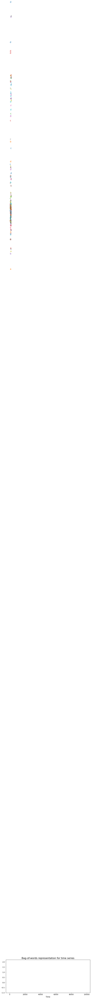

In [33]:
from pyts.bag_of_words import BagOfWords
from pyts.datasets import load_gunpoint



window_size, word_size = 50, 10
X = concat_df.iloc[:,0].values.reshape(1,-1)
bow = BagOfWords(window_size=window_size, word_size=word_size,
                 window_step=window_size, numerosity_reduction=False)
X_bow = bow.transform(concat_df.iloc[:1000,0].values.reshape(1,-1))

# Plot the considered subseries
plt.figure(figsize=(10, 4))
splits_series = np.linspace(0, X.shape[1], 1 + X.shape[1] // window_size,
                            dtype='int64')
for start, end in zip(splits_series[:-1],
                      np.clip(splits_series[1:] + 1, 0, X.shape[1])):
    plt.plot(np.arange(start, end), X[0, start:end], 'o-', lw=1, ms=1)

# Plot the corresponding letters
splits_letters = np.linspace(0, X.shape[1],
                             1 + word_size * X.shape[1] // window_size)
splits_letters = (
    (splits_letters[:-1] + splits_letters[1:]) / 2).astype('int64')
for i, (x, text) in enumerate(zip(splits_letters, X_bow[0].replace(' ', ''))):
    plt.text(x, X[0, x] + 0.1, text, color="C{}".format(i // 5), fontsize=14)

plt.ylim((-1, 2.2))
plt.xlabel('Time', fontsize=12)
plt.title('Bag-of-words representation for time series', fontsize=16)
plt.tight_layout()
plt.show()

In [26]:
concat_df.iloc[:,0].values.reshape(1,-1).shape

(1, 99269)

(50, 150)

Memory used  (%)                           0
CPU utilization (%)                        0
Disk (0 C:) - Current Disk Queue Length    0
Disk (1 D:) - Current Disk Queue Length    0
Label                                      0
dtype: int64
                     Memory used  (%)  CPU utilization (%)  \
dt                                                           
2021-06-20 09:00:00         28.566922            39.851956   
2021-06-20 10:00:00         28.828743            37.081960   
2021-06-20 11:00:00         27.201200            37.182560   
2021-06-20 12:00:00         28.462700            31.697695   
2021-06-20 13:00:00         27.996105            43.175465   

                     Disk (0 C:) - Current Disk Queue Length  \
dt                                                             
2021-06-20 09:00:00                                      0.0   
2021-06-20 10:00:00                                      0.0   
2021-06-20 11:00:00                                      0.0   
2021-06

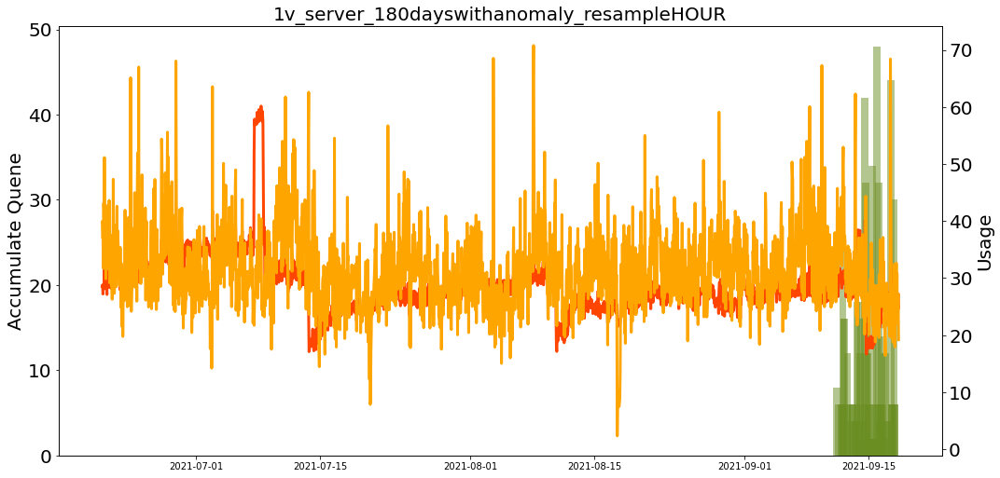

Memory used  (%)                           0
CPU utilization (%)                        0
Disk (0 C:) - Current Disk Queue Length    0
Disk (1 D:) - Current Disk Queue Length    0
Label                                      0
dtype: int64
                     Memory used  (%)  CPU utilization (%)  \
dt                                                           
2021-06-20 09:00:00         14.113606             1.207067   
2021-06-20 10:00:00         14.095523             1.461820   
2021-06-20 11:00:00         14.128880             1.280370   
2021-06-20 12:00:00         14.089222             1.241520   
2021-06-20 13:00:00         14.128913             1.258165   

                     Disk (0 C:) - Current Disk Queue Length  \
dt                                                             
2021-06-20 09:00:00                                      0.0   
2021-06-20 10:00:00                                      0.0   
2021-06-20 11:00:00                                      0.0   
2021-06

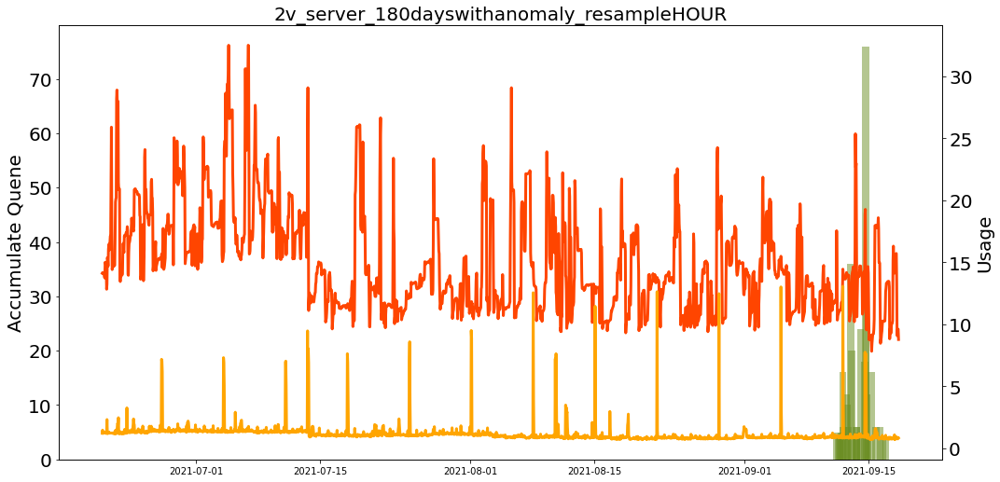

Memory used  (%)                           0
CPU utilization (%)                        0
Disk (0 C:) - Current Disk Queue Length    0
Disk (1 D:) - Current Disk Queue Length    0
Label                                      0
dtype: int64
                     Memory used  (%)  CPU utilization (%)  \
dt                                                           
2021-06-20 09:00:00         19.636733             8.287033   
2021-06-20 10:00:00         20.635300            10.620855   
2021-06-20 11:00:00         19.013268             8.150290   
2021-06-20 12:00:00         20.051527             6.334245   
2021-06-20 13:00:00         19.982570             8.900310   

                     Disk (0 C:) - Current Disk Queue Length  \
dt                                                             
2021-06-20 09:00:00                                      0.0   
2021-06-20 10:00:00                                      0.0   
2021-06-20 11:00:00                                      0.0   
2021-06

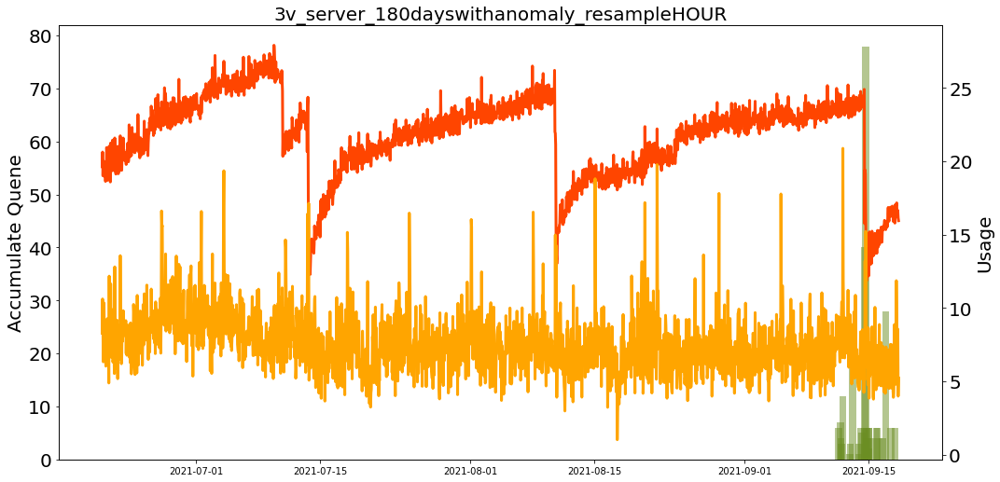

Memory used  (%)                           0
CPU utilization (%)                        0
Disk (0 C:) - Current Disk Queue Length    0
Disk (1 D:) - Current Disk Queue Length    0
Label                                      0
dtype: int64
                     Memory used  (%)  CPU utilization (%)  \
dt                                                           
2021-06-20 09:00:00         12.935383             1.118944   
2021-06-20 10:00:00         12.926137             1.078355   
2021-06-20 11:00:00         12.936700             1.078200   
2021-06-20 12:00:00         12.991245             1.120410   
2021-06-20 13:00:00         13.001953             1.094930   

                     Disk (0 C:) - Current Disk Queue Length  \
dt                                                             
2021-06-20 09:00:00                                      0.0   
2021-06-20 10:00:00                                      0.0   
2021-06-20 11:00:00                                      0.0   
2021-06

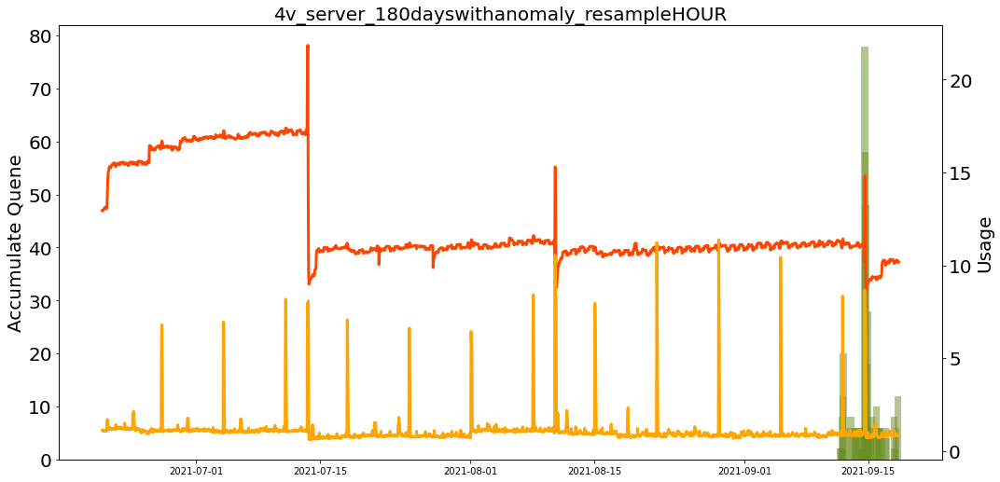

Memory used  (%)                           0
CPU utilization (%)                        0
Disk (0 C:) - Current Disk Queue Length    0
Disk (1 D:) - Current Disk Queue Length    0
Label                                      0
dtype: int64
                     Memory used  (%)  CPU utilization (%)  \
dt                                                           
2021-06-20 09:00:00         15.324467             4.633911   
2021-06-20 10:00:00         14.341952             8.398715   
2021-06-20 11:00:00         14.190687             6.687040   
2021-06-20 12:00:00         15.669625             9.170250   
2021-06-20 13:00:00         14.167898             6.942100   

                     Disk (0 C:) - Current Disk Queue Length  \
dt                                                             
2021-06-20 09:00:00                                      0.0   
2021-06-20 10:00:00                                      0.0   
2021-06-20 11:00:00                                      0.0   
2021-06

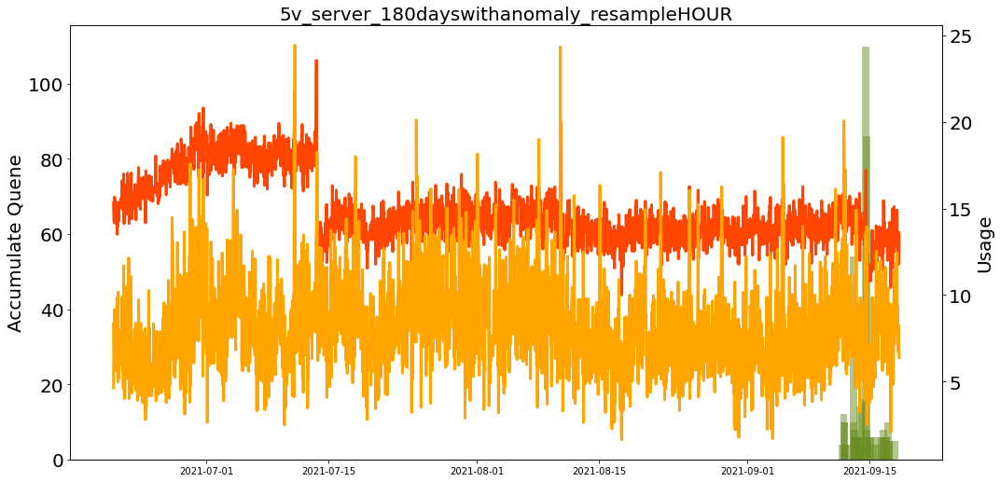

Memory used  (%)                           0
CPU utilization (%)                        0
Disk (0 C:) - Current Disk Queue Length    0
Disk (1 D:) - Current Disk Queue Length    0
Label                                      0
dtype: int64
                     Memory used  (%)  CPU utilization (%)  \
dt                                                           
2021-06-20 10:00:00         68.997344            80.346878   
2021-06-20 11:00:00         69.694937            77.582825   
2021-06-20 12:00:00         62.959915            77.360200   
2021-06-20 13:00:00         64.110505            78.613925   
2021-06-20 14:00:00         63.443767            76.853580   

                     Disk (0 C:) - Current Disk Queue Length  \
dt                                                             
2021-06-20 10:00:00                                      0.0   
2021-06-20 11:00:00                                      0.0   
2021-06-20 12:00:00                                      0.0   
2021-06

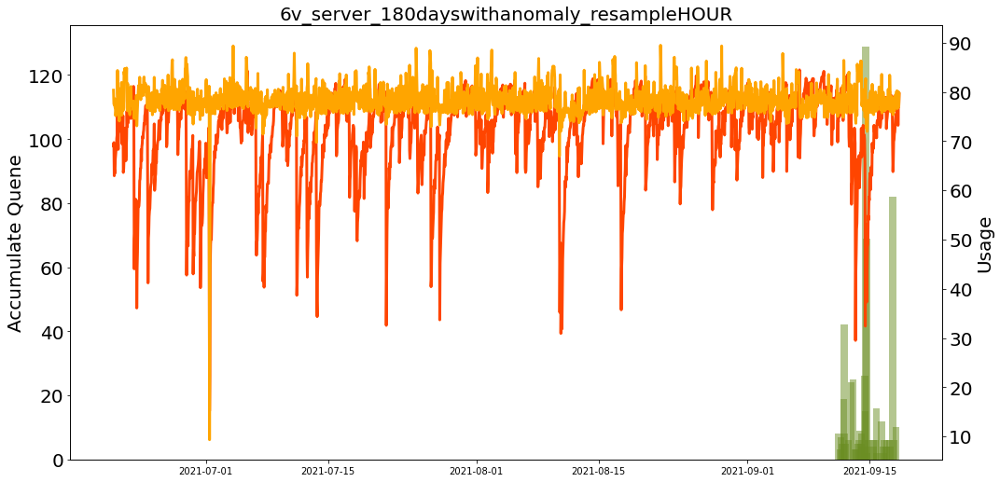

In [86]:
#Usage vs. Quene mean

for path in glob.glob("./Dataset/OPTIdata/pre_process_withlabel/*180dayswithanomaly_resampleHOUR_quene_sum.csv"):
    figsize(15,7)
    df = read_data(path,
              o_dtname="Datetime",
              c_dtname='dt')
    df = df.loc[:,:]
    server_name = path.split("\\")[-1].split("_")[0]
    print(df.head())
    fig, ax1 = plt.subplots()
    
    
    
    ax2 = ax1.twinx()
    
    
    
    ax1.set_ylabel("Accumulate Quene",fontsize=20)
    ax1.bar(df["Disk (0 C:) - Current Disk Queue Length"].index.values,
            df["Disk (0 C:) - Current Disk Queue Length"].values,
            label="Number of Accumulate Quene",
            zorder=1,
            alpha = 0.5,
            color='olivedrab'
           )
    ax1.tick_params(axis='y',labelsize=20)
    
    ax2.set_ylabel("Usage",fontsize=20)
    ax2.plot(df["Memory used  (%)"].index.values,
             df["Memory used  (%)"].values,
             label="Memory used  (%)",
             zorder=10,
            linewidth=3,
            color='orangered')
    ax2.plot(df["CPU utilization (%)"].index.values,
             df["CPU utilization (%)"].values,
             label="CPU utilization (%)",
             zorder=10,
            linewidth=3,
            color='orange')
    #ax1.legend(fontsize='xx-large')
    
    ax2.tick_params(axis='y',labelsize=20)
    ax2.tick_params(axis='x',labelsize=20)
    
    fig.tight_layout()
    plt.title("{}_server_180dayswithanomaly_resampleHOUR".format(server_name),fontsize=20)
    #plt.xtick(fontsize=20)
    plt.xlabel("Datetime",fontsize=10)
    
    plt.savefig(os.path.join(root_path,"OPTIdata","pre_process_withlabel","{}_server_180dayswithanomaly_resampleHOUR_line_and_bar.jpg".format(server_name)),bbox_inches="tight")
    plt.show()
    

In [33]:
concat_df.loc[:,concat_df.columns[1]].values.shape

(190466,)

In [ ]:
concat_df.loc[:,concat_df.columns[1]].values

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


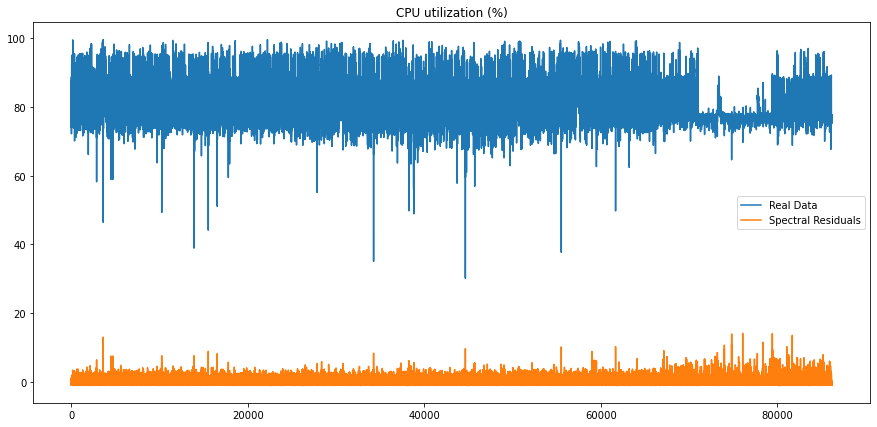

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


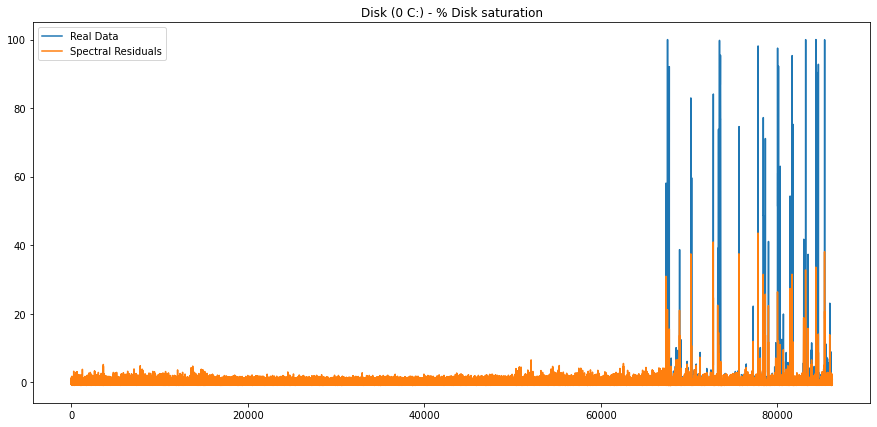

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


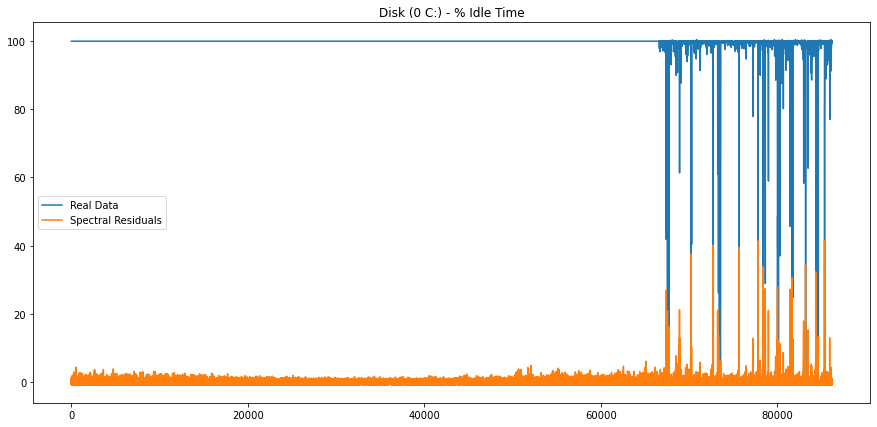

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


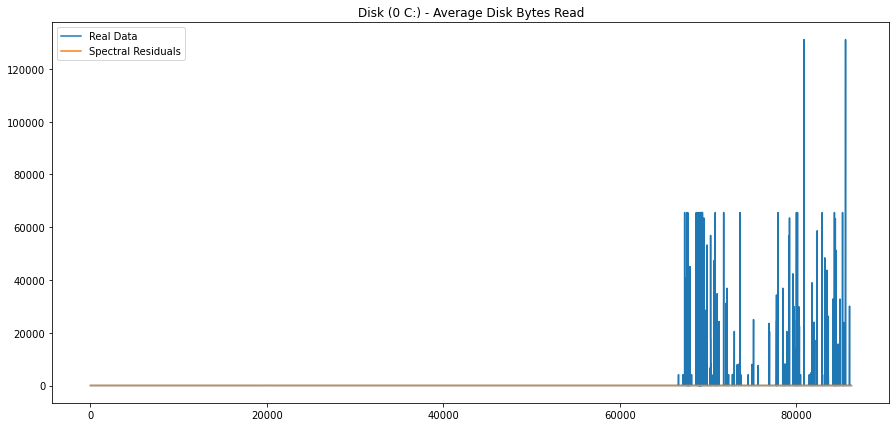

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


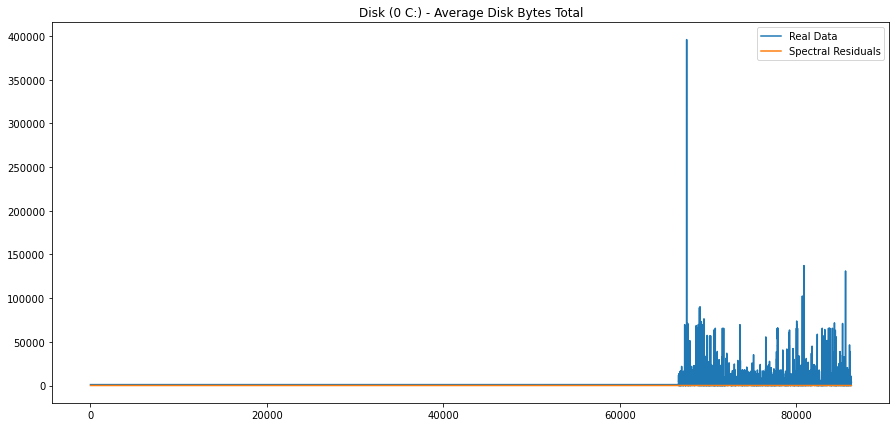

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


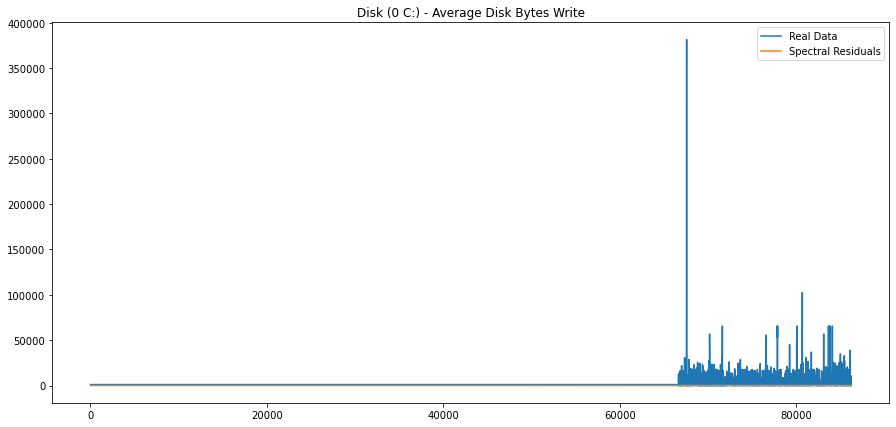

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


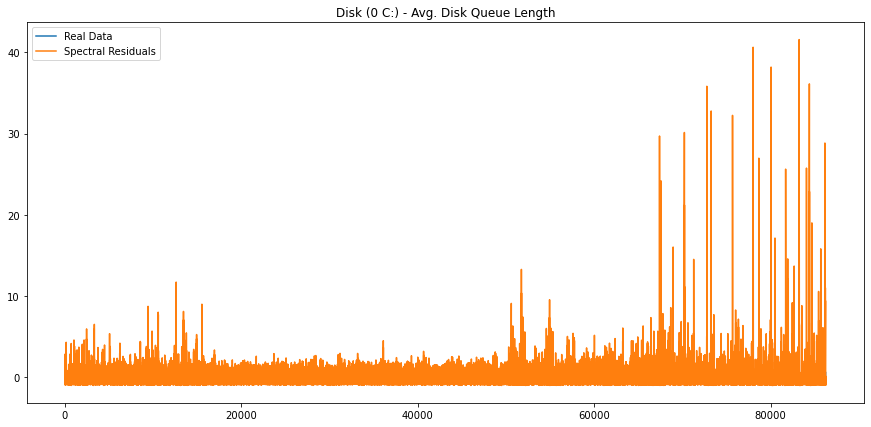

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


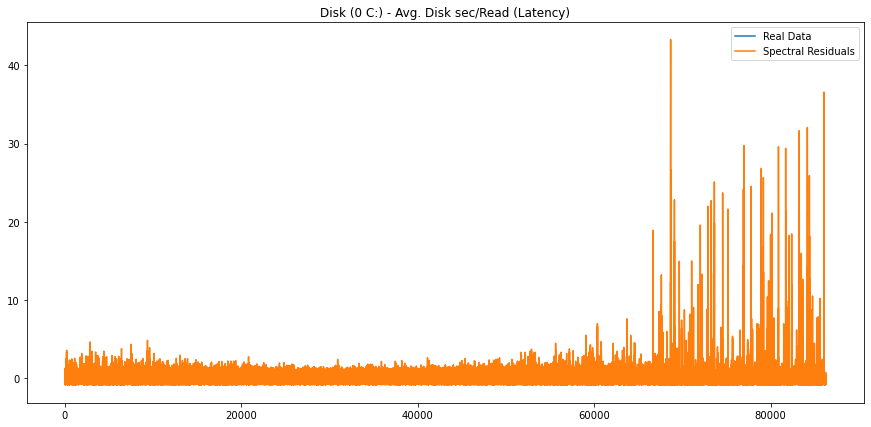

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


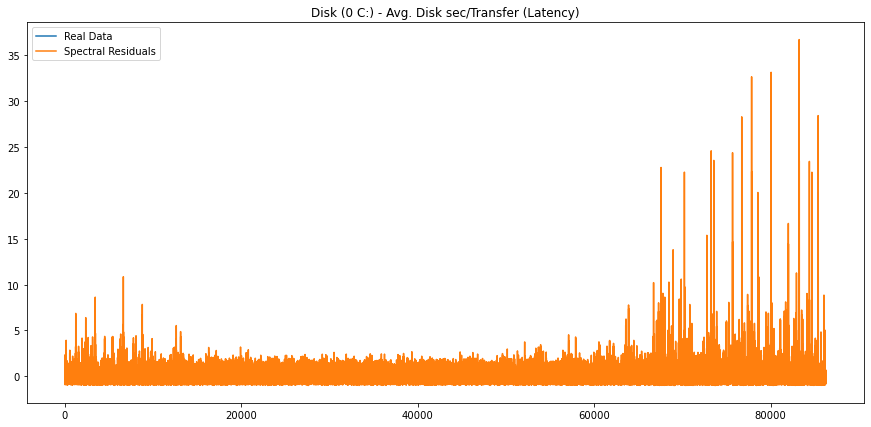

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


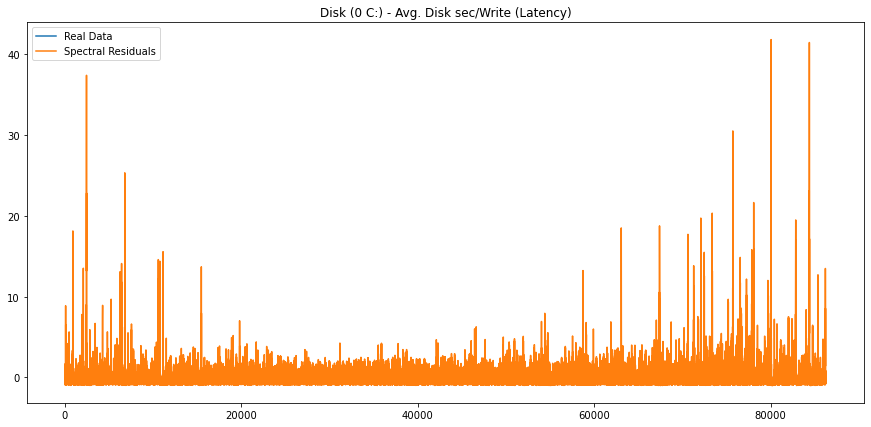

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


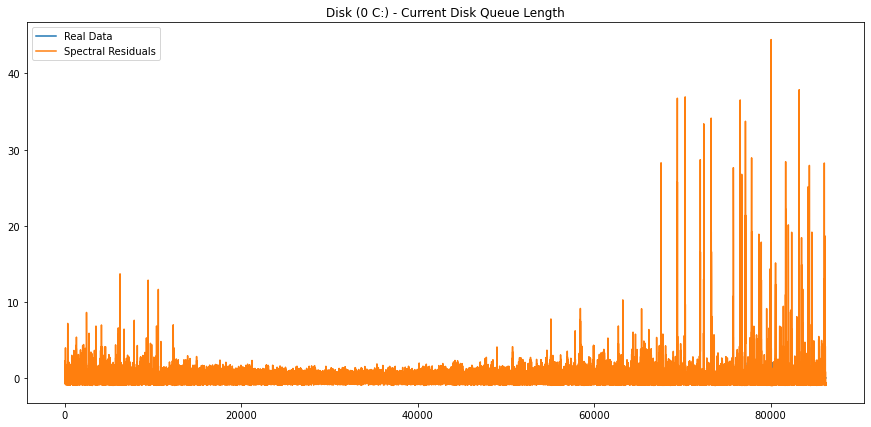

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


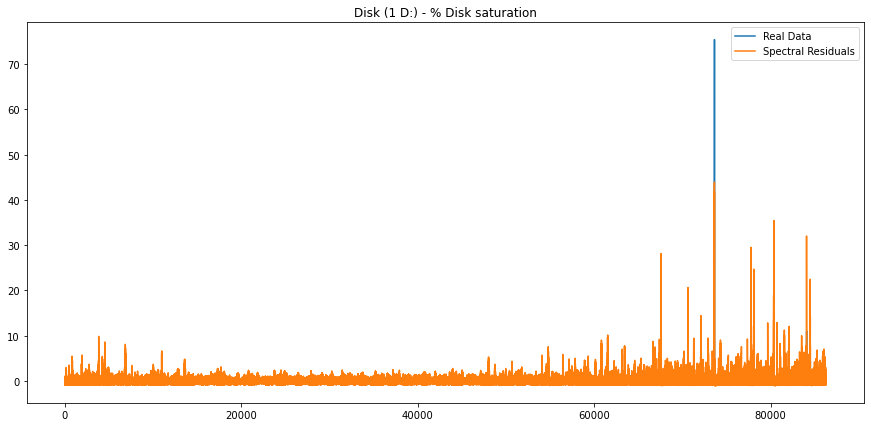

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


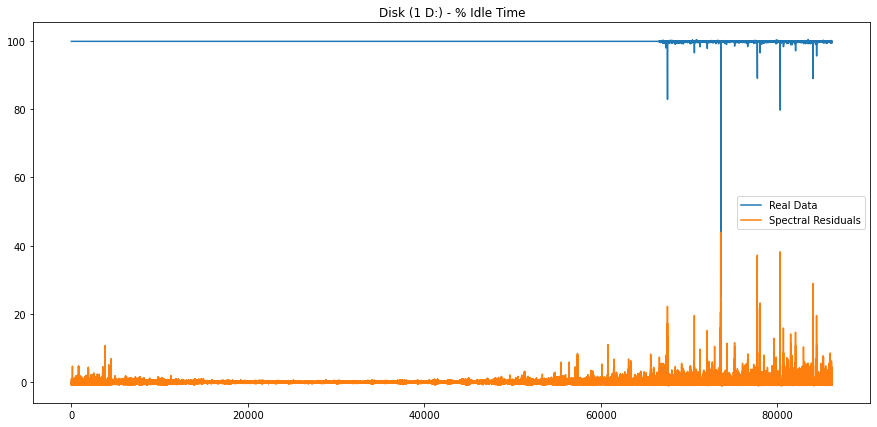

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


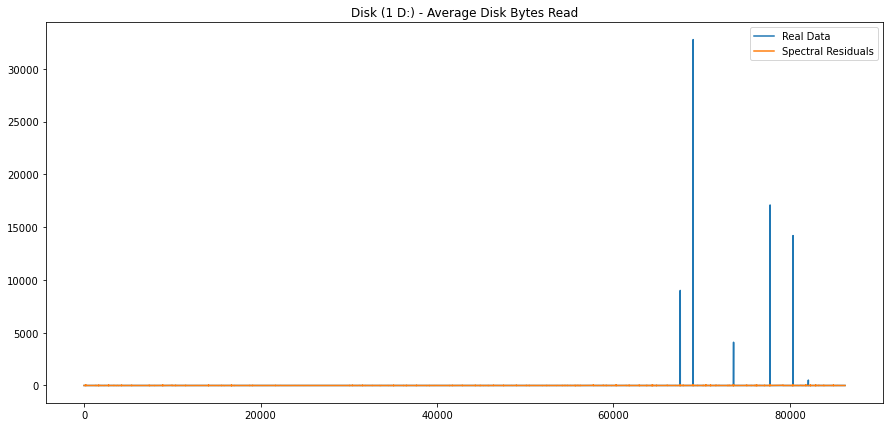

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


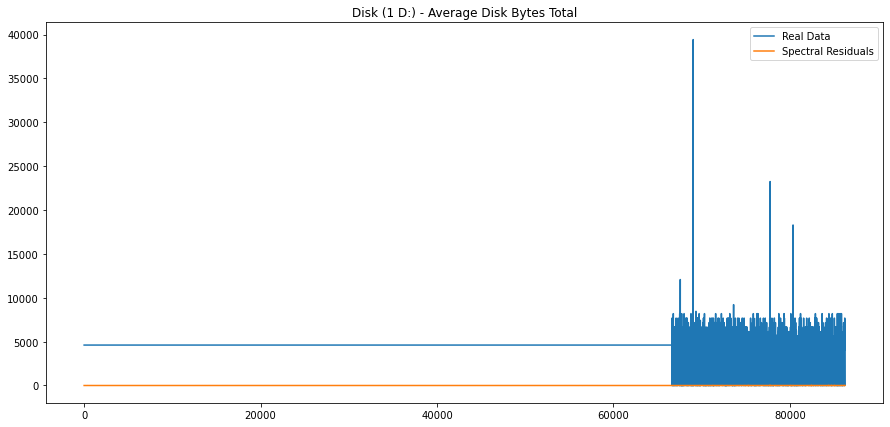

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


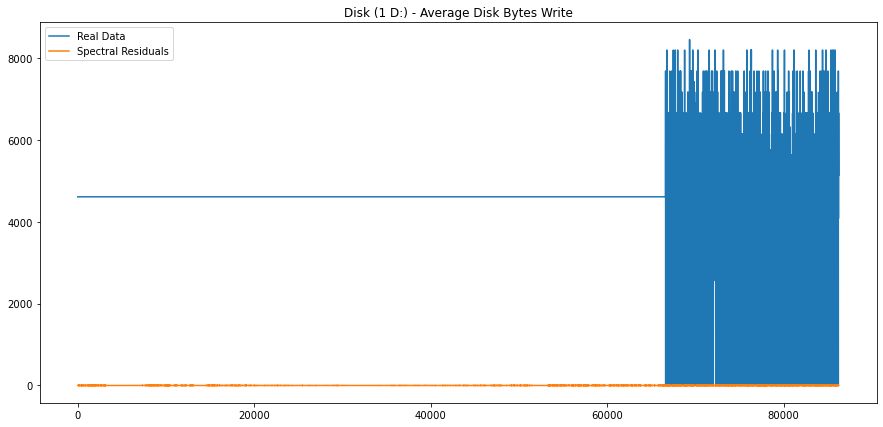

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


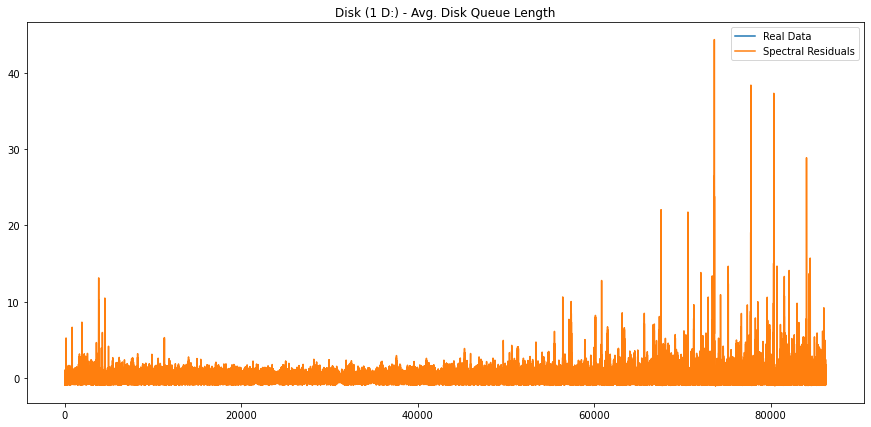

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


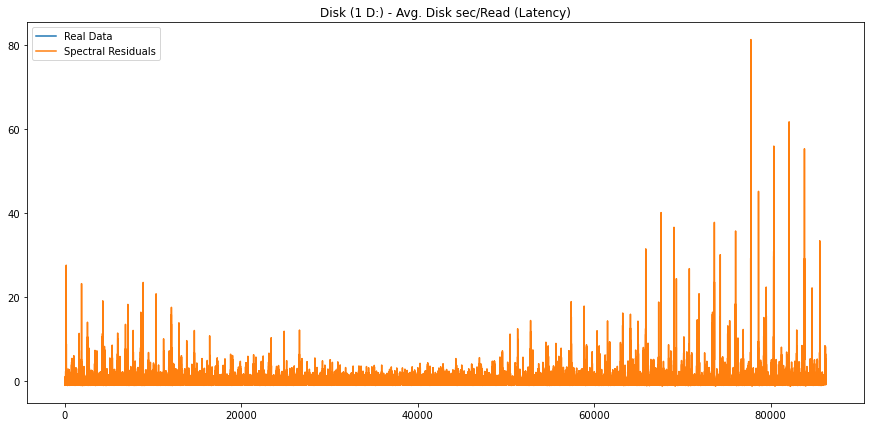

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


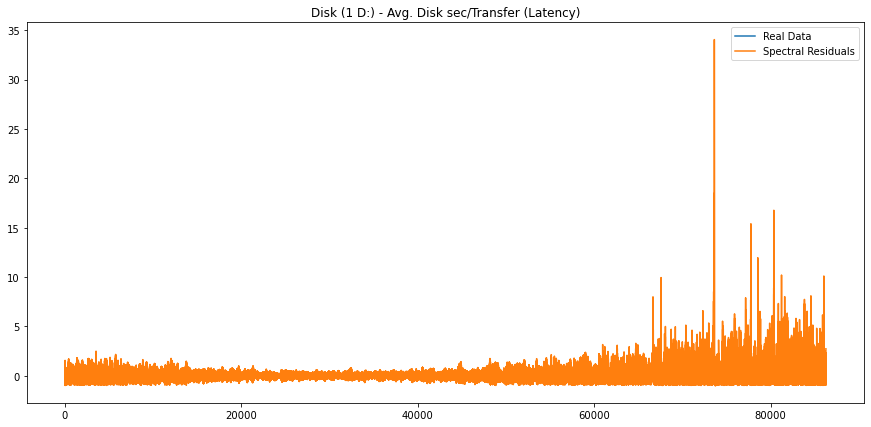

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


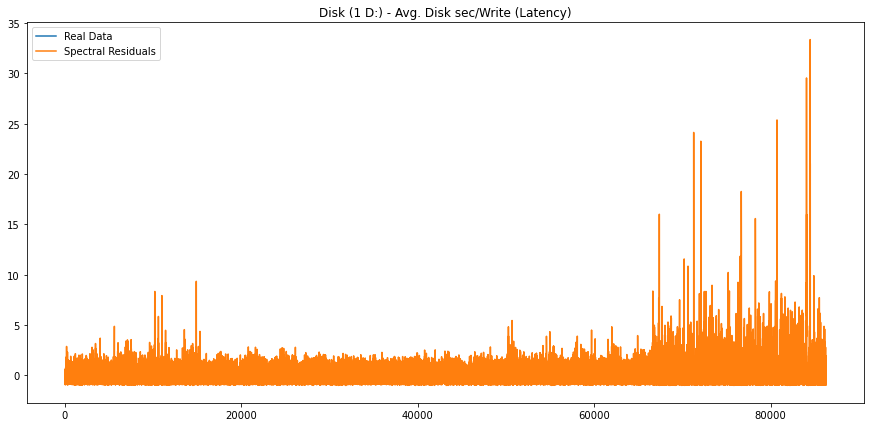

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


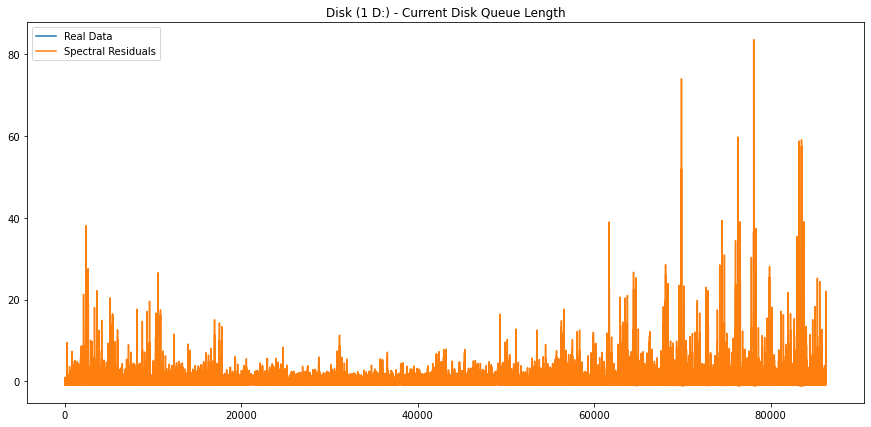

C:\Users\user\anaconda3\envs\rtx3070\lib\site-packages\sranodec\util.py:31: RuntimeWarning: invalid value encountered in double_scalars
  slope = [(last_value - v) / i for (i, v) in enumerate(values[::-1])]


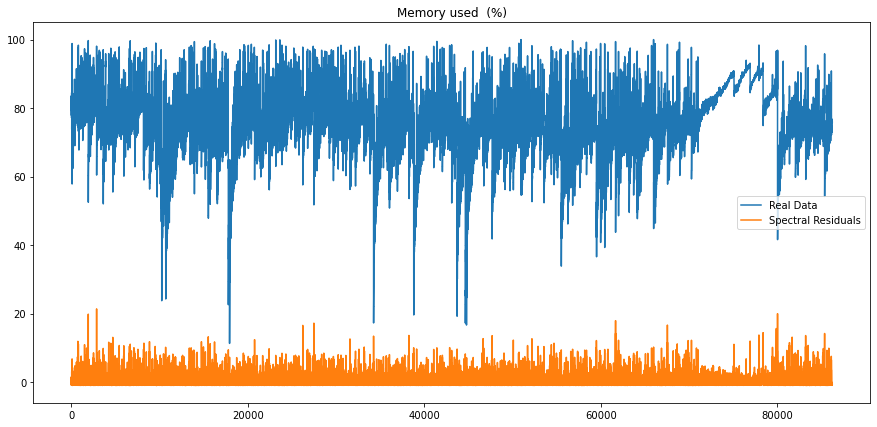

In [9]:
import sranodec as anom
# less than period
amp_window_size=24
# (maybe) as same as period
series_window_size=24
# a number enough larger than period
score_window_size=200


for i in concat_df.columns:
    test_signal = concat_df.loc["2021-10-22":,i].values
    spec = anom.Silency(amp_window_size, series_window_size, score_window_size)
    plt.plot(test_signal,label="Real Data")

    score = spec.generate_anomaly_score(test_signal)
    plt.plot(score,label="Spectral Residuals")
    plt.legend()
    plt.title(i)
    plt.show()